In [1]:
import os
import shutil
directory = '/Users/edwardkim/Desktop/Scenic_Query/nuscenes_data/experiment_results'
subject1 = 'experiment_result_JayShenoy'
subject2 = 'experiment_result_TaeSung'
subject3 = 'experiment_result_Xiangyu'
scenario_list = ['scenario1','scenario2','scenario3','scenario4','scenario5']

for scenario_name in scenario_list:
    dir1 = os.path.join(directory, subject1, scenario_name)
    dir2 = os.path.join(directory, subject2, scenario_name)
    dir3 = os.path.join(directory, subject3, scenario_name)

    files1 = set([file for file in os.listdir(dir1) if file.endswith('.jpg')])
    files2 = set([file for file in os.listdir(dir2) if file.endswith('.jpg')])
    files3 = set([file for file in os.listdir(dir3) if file.endswith('.jpg')])
    
    intersect = files1.intersection(files2.intersection(files3))
    print(len(intersect))
    
#     if not os.path.isdir(os.path.join(directory, scenario_name+'_intersection')):
#         os.mkdir(os.path.join(directory, scenario_name+'_intersection'))
    
#     for file in intersect:
#         shutil.copy(os.path.join(dir1, file), os.path.join(directory, scenario_name+'_intersection'))

42
6
0
2
0


In [2]:
from scenic.simulators.carla.nusc_query_api import NuscQueryAPI
nusc = NuscQueryAPI(version='v1.0-trainval', \
                    dataroot='/Users/edwardkim/Desktop/Scenic_Query/nuscenes_data')

/Users/edwardkim/Desktop/Scenic_Query/Scenic/src/scenic/core/errors.py:160: UserWarning: unable to install sys.excepthook to format Scenic backtraces
  warnings.warn('unable to install sys.excepthook to format Scenic backtraces')


Loading NuScenes tables for version v1.0-trainval...
Loading nuScenes-lidarseg...
32 category,
8 attribute,
4 visibility,
64386 instance,
12 sensor,
10200 calibrated_sensor,
2631083 ego_pose,
68 log,
850 scene,
34149 sample,
2631083 sample_data,
1166187 sample_annotation,
4 map,
34149 lidarseg,
Done loading in 46.996 seconds.
Reverse indexing ...
Done reverse indexing in 14.4 seconds.


In [3]:
from scenic.core.vectors import OrientedVector, Vector
import matplotlib.pyplot as plt
from scenic.core.type_support import toVector
from scenic.core.regions import PolygonalRegion, PointInRegionDistribution, SectorRegion
import os.path as path
from scenic.core.regions import SectorRegion
from scenic.core.geometry import triangulatePolygon, normalizeAngle
from shapely.geometry.polygon import Polygon
from shapely.geometry.multipolygon import MultiPolygon
from scenic.core.distributions import *
import math
import subprocess
import os


# TODO : need to handle jointly dependent objs as well
def isFeatureValid(feature, label, smt_file_path, cached_variables, featureType, debug=False, falseTesting=False):
    
    # TODO : need to handle jointly dependent objs as well
    if os.path.isfile(smt_file_path):
        os.remove(smt_file_path)
    
    open(smt_file_path, 'w').close()
    writeSMTtoFile(smt_file_path, '(set-logic QF_NRA)')

    # Instantiate cached_variables dictionary
    x, y, label_feature = None,None,None
    
    if not falseTesting:
        if featureType == 'position':
            label_feature = (str(label.x), str(label.y))
        if featureType == 'heading':
            label_feature = str(label)
    else:
        x = 1144.11438466291
        y = 1085.6681557273737
        heading = -0.293950447126917
        if featureType == 'position':
            label_feature = (str(x), str(y))
        
        
    # Encode object's position to SMT formula
    smt_var = feature.encodeToSMT(smt_file_path, cached_variables, debug = debug)
    
    if featureType == 'position':
        (x_cond, y_cond) = vector_operation_smt(label_feature, "equal", smt_var)
        writeSMTtoFile(smt_file_path, smt_assert(None, smt_and(x_cond, y_cond)))
    else:
        writeSMTtoFile(smt_file_path, smt_assert(None, smt_equal(label_feature, smt_var)))
    writeSMTtoFile(smt_file_path, "(check-sat)")
    writeSMTtoFile(smt_file_path, "(exit)")

    if not debug:
        if subprocess.call("./run_smt_encoding.sh") == 1:
            return True
        else:
            return False
    else:
        print("DEBUG MODE: NO OUTPUT WILL BE RETURNED")
            
    return None

def validateLabelTesting(scenario, debug=False, falseTesting=False):
    ego_visibleDistance = 10 #meters
    ego_viewAngle = 135 #deg
    smt_file_path = './test_smt_encoding.smt2'
    
    resetScenarioDependency(scenario)
    
    if not falseTesting:
        sample = scenario.generate()
        scene = sample[0]
        label_ego_pos = scene.objects[0].position
        label_ego_heading = scene.objects[0].heading
    else:
        x = 1144.11438466291
        y = 1085.6681557273737
        label_ego_pos = Vector(x,y)
        label_ego_heading = -0.293950447126917
    
    # Create Ego's VisibleRegion
    cached_variables = {}
    cached_variables['variables'] = []
    egoVisibleRegion = SectorRegion(label_ego_pos, ego_visibleDistance, label_ego_heading, \
                                    math.radians(ego_viewAngle))
    cached_variables['egoVisibleRegion'] = egoVisibleRegion

    for i in range(len(scenario.objects)):
        print("i: ",i)
        obj = scenario.objects[i]
        label_feature = scene.objects[i].position
        print("position: ", label_feature)
        feature = obj.position
        if isFeatureValid(feature, label_feature, smt_file_path,cached_variables, featureType='position', \
                          debug=debug, falseTesting=falseTesting):
            print("position is valid")
            # condition the validated feature with the label's feature
            feature.conditionTo(label_feature)
        else:
            print("NOT VALID: POSITION")
            return False

        label_feature = scene.objects[i].heading
        print("heading: ", label_feature)
        feature = obj.heading
        if isFeatureValid(feature, label_feature, smt_file_path, cached_variables, featureType='heading', \
                          debug=debug, falseTesting=falseTesting): 
            print("heading is valid")
            # condition the validated feature with the label's feature
            feature.conditionTo(Constant(label_feature))
        else:
            print("NOT VALID: HEADING")
            return False
        
    ## Check Hard Constraint Satisfaction
    if not scenario.checkRequirements():
        return False
    
    return True 


def validateLabel(scenario, img_name, debug=False, falseTesting=False, scenic_testing=False):
    ego_visibleDistance = 100 #meters
    ego_viewAngle = 120 #deg
    smt_file_path = './test_smt_encoding.smt2'
    
    resetScenarioDependency(scenario)
    
    label, ego_label, vehicles_label, pedestrians_label = None, None, None, None
    if not scenic_testing:
        label = nusc.get_img_data(img_name)
        ego_label = label['EgoCar']
        vehicles_label = label['Vehicles']
        pedestrians_label = label['Pedestrians']
        (x_ego, y_ego) = ego_label['position']
        label_ego_pos = Vector(x_ego, y_ego)
#         label_ego_heading = normalizeAngle(math.radians(label['EgoCar']['heading']+90))
        label_ego_heading = math.radians(label['EgoCar']['heading']+90)
        
    else:
        if not falseTesting:
            sample = scenario.generate()
            label = sample[0]
            ego_label = label.objects[0]
            vehicles_label = [label.objects[i+1] for i in range(len(label.objects)-1)]
            label_ego_pos = ego_label.position
            label_ego_heading = ego_label.heading
        else:
            x = 1144.11438466291
            y = 1085.6681557273737
            label_ego_pos = Vector(x,y)
            label_ego_heading = -0.293950447126917
    
    # Create Ego's VisibleRegion
    cached_variables = {}
    cached_variables['variables'] = []
    egoVisibleRegion = SectorRegion(label_ego_pos, ego_visibleDistance, label_ego_heading, \
                                    math.radians(ego_viewAngle))
    cached_variables['egoVisibleRegion'] = egoVisibleRegion
    
    ## Validate EgoCar label
    if not checkPosHeading(scenario.objects[0], ego_label, smt_file_path, cached_variables, \
                           debug, falseTesting, scenic_testing):
        return False
    
    ## Validate Other agents' labels
    # create a permutation of all label's Vehicles
    permutation = permutedIndexSet(vehicles_label)
    feasible_permutation = permutation
    
    # try permutations of label matching
    for p in permutation:
        if p not in feasible_permutation:
            continue
            
        (boolean, failed_permutation) = tryPermutation(p, vehicles_label, scenario, smt_file_path, \
                                                       cached_variables, debug, falseTesting, scenic_testing)
        if not boolean:
            feasible_permuation = removeInfeasiblePermutation(failed_permutation, permutation)
            # Need reset conditioned objects with wrong permutation of labels
            resetScenarioDependency(scenario)
            # reset cached_variables dictionary
            resetDictionary(cached_variables, egoVisibleRegion)
            # Ego's label is valid so keep that conditioned obj
            checkPosHeading(scenario.objects[0], label['EgoCar'], smt_file_path, cached_variables, \
                           debug, falseTesting)
        else:
            break
            
    ## Check Hard Constraint Satisfaction
    if not scenario.checkRequirements():
        return False
    return True 

def tryPermutation(permutation_tuple, label_objs, scenario, smt_file_path, cached_variables, \
                           debug=False, falseTesting=False, scenic_testing=False):
    failed_index_sequence = []
    for i in range(len(scenario.objects)-1):
        index = permutation_tuple[i]
        label_obj = label_objs[index]
        scenic_obj= scenario.objects[i+1]
        if checkPosHeading(scenic_obj, label_obj, smt_file_path, cached_variables, \
                           debug, falseTesting, scenic_testing):
            failed_index_sequence.append(index)
        else:
            failed_index_sequence.append(index)
            return (False, failed_index_sequence)
    return (True, None)
    
def checkPosHeading(scenic_obj, label_obj, smt_file_path, cached_variables, debug=False, falseTesting=False,\
                   scenic_testing=False):
    if not scenic_testing:
        (x,y) = label_obj['position']
    else:
        (x,y) = label_obj.position
        
    label_feature = Vector(x,y)
    print("position: ", label_feature)
    feature = scenic_obj.position
    if isFeatureValid(feature, label_feature, smt_file_path, cached_variables, \
                      featureType='position', \
                      debug=debug, falseTesting=falseTesting):
        print("position is valid")
        # condition the validated feature with the label's feature
        feature.conditionTo(label_feature)
    else:
        print("NOT VALID: POSITION")
        return False

    if not scenic_testing:
        heading = label_obj['heading'] + 90
#         label_feature = normalizeAngle(math.radians(heading))
        label_feature = math.radians(heading)
    else:
        heading = label_obj.heading
        label_feature = heading
    print("heading: ", label_feature)
    feature = scenic_obj.heading
    if isFeatureValid(feature, label_feature, smt_file_path, cached_variables, \
                      featureType='heading', \
                      debug=debug, falseTesting=falseTesting): 
        print("heading is valid")
        # condition the validated feature with the label's feature
        feature.conditionTo(Constant(label_feature))
    else:
        print("NOT VALID: HEADING")
        return False
    return True

def permutedIndexSet(label_objs):
    index_list = [i for i in range(len(label_objs))]
    return set(itertools.permutations(index_list))

def permutedIndexSetTesting(index_list):
#     index_list = [i for i in range(len(label['Vehicles']))]
    return set(itertools.permutations(index_list))

def removeInfeasiblePermutation(failed_list, permutation_set):
    infeasible_permutation = set()
    for p_tuple in permutation_set:
        if tupleStartsWith(failed_list, p_tuple):
            infeasible_permutation.add(p_tuple)
    return permutation_set.difference(infeasible_permutation)
            
def tupleStartsWith(failed_list, permutation_tuple):
    for i in range(len(failed_list)):
        if failed_list[i] != permutation_tuple[i]:
            return False
    return True

def resetDictionary(cached_variables, egoVisibleRegion):
    cached_variables = {}
    cached_variables['variables'] = []
    cached_variables['egoVisibleRegion'] = egoVisibleRegion
        
def resetScenarioDependency(scenario):
    for obj in scenario.objects:
        resetConditionedVar(obj.position)
        resetConditionedVar(obj.heading)

def resetConditionedVar(obj):
    obj._conditioned = obj
    if (obj._dependencies is None):
        return None
    for dep in obj._dependencies:
        resetConditionedVar(dep)
    return None

# directory = '/Users/edwardkim/Desktop/Scenic_Query/nuscenes_data/experiment_folder/experiment'
# filenames = os.listdir(directory)
# print("label validity: ", validateLabel(scenario, filenames[0] ,debug=False, falseTesting=False, scenic_testing=True))


In [4]:
import os
import scenic
scenic_script = "./examples/carla/experiment5.scenic"
scenario = scenic.scenarioFromFile(scenic_script)

711
position:  (1316.9486451760638 @ 1037.9575936034432)


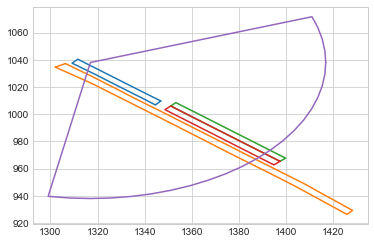

in Options class, polygonalRegions:  [<shapely.geometry.polygon.Polygon object at 0x2c4a4ceb0>, <shapely.geometry.polygon.Polygon object at 0x2c506e2b0>, <shapely.geometry.polygon.Polygon object at 0x2c5a697f0>, <shapely.geometry.polygon.Polygon object at 0x2c5a744c0>]


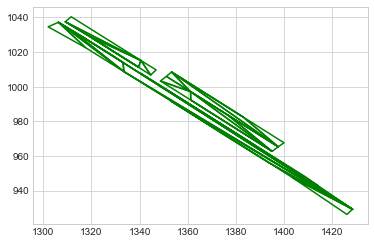

NOT VALID: POSITION
VALID:  False
position:  (1006.1963328358183 @ 1261.8950026539942)


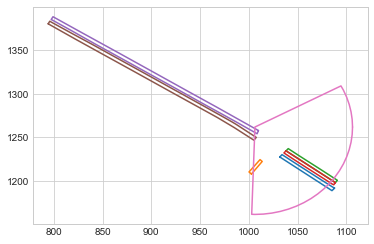

in Options class, polygonalRegions:  [<shapely.geometry.polygon.Polygon object at 0x247e11bb0>, <shapely.geometry.polygon.Polygon object at 0x248fc9d90>, <shapely.geometry.polygon.Polygon object at 0x2c3ccb3a0>, <shapely.geometry.polygon.Polygon object at 0x2c3ccbfd0>, <shapely.geometry.polygon.Polygon object at 0x2c4931940>, <shapely.geometry.polygon.Polygon object at 0x2c49a84f0>]


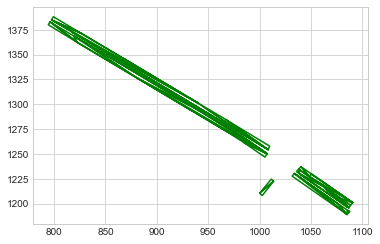

NOT VALID: POSITION
VALID:  False
position:  (770.0659171415182 @ 421.2352666163001)


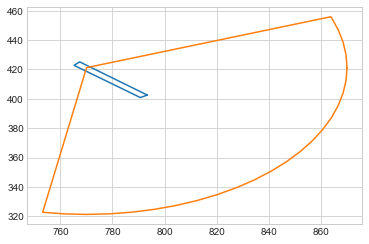

in Options class, polygonalRegions:  [<shapely.geometry.polygon.Polygon object at 0x248241550>]


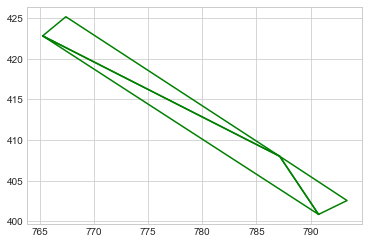

position is valid
heading:  4.019434680828833
within get_traffic_flow
point:  (770.0659171415182 @ 421.2352666163001)
heading output =  3.998104439752686
heading is valid
position:  (761.777 @ 434.252)
NOT VALID: POSITION
position:  (770.0659171415182 @ 421.2352666163001)
NOT VALID: POSITION
position:  (744.979 @ 441.731)
NOT VALID: POSITION
position:  (770.0659171415182 @ 421.2352666163001)
NOT VALID: POSITION
within get_traffic_flow
point:  (863.0428755319017 @ 1429.8662015832194)
heading output =  4.001683003453396
within get_traffic_flow
point:  (849.8550362070803 @ 1446.9529567968082)
heading output =  4.00295814305648
VALID:  True


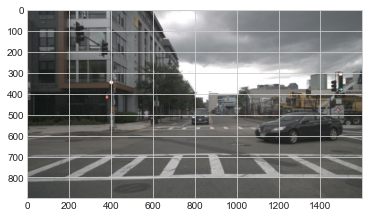

position:  (2132.568686693625 @ 897.8183453758336)


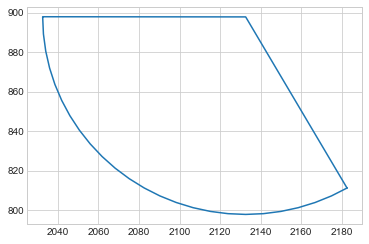

NOT VALID: POSITION
VALID:  False
position:  (1869.0260373207707 @ 785.4157500240271)


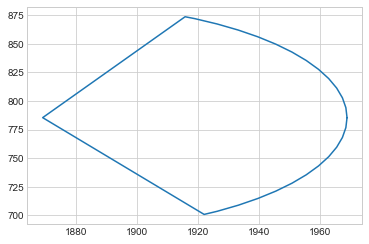

NOT VALID: POSITION
VALID:  False
position:  (1185.1335359003983 @ 1134.8982167353256)


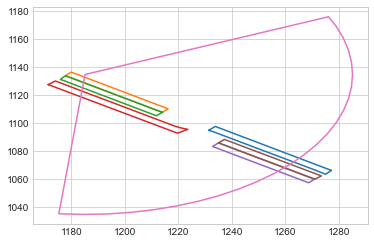

in Options class, polygonalRegions:  [<shapely.geometry.polygon.Polygon object at 0x248f88eb0>, <shapely.geometry.polygon.Polygon object at 0x263654640>, <shapely.geometry.polygon.Polygon object at 0x26365a250>, <shapely.geometry.polygon.Polygon object at 0x2c48e5c40>, <shapely.geometry.polygon.Polygon object at 0x2c5251070>, <shapely.geometry.polygon.Polygon object at 0x2c5251a60>]


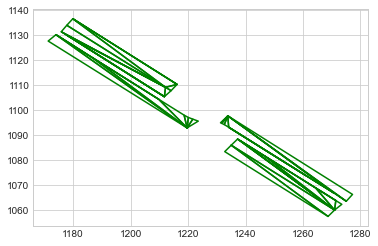

NOT VALID: POSITION
VALID:  False
position:  (1488.105592954214 @ 1367.5406947523186)


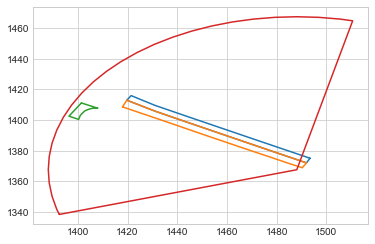

in Options class, polygonalRegions:  [<shapely.geometry.polygon.Polygon object at 0x2c58f6370>, <shapely.geometry.polygon.Polygon object at 0x2c5904040>, <shapely.geometry.polygon.Polygon object at 0x2c669fa90>]


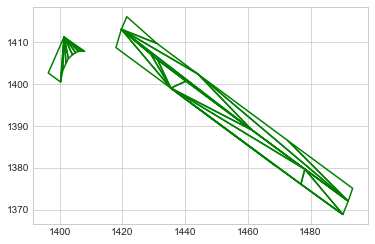

NOT VALID: POSITION
VALID:  False
position:  (456.4160686739376 @ 810.1089609354069)


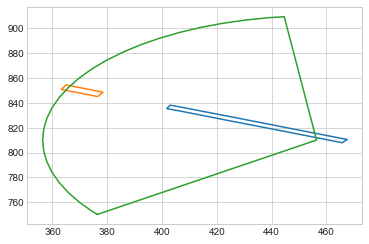

in Options class, polygonalRegions:  [<shapely.geometry.polygon.Polygon object at 0x2495d0400>, <shapely.geometry.polygon.Polygon object at 0x264439d60>]


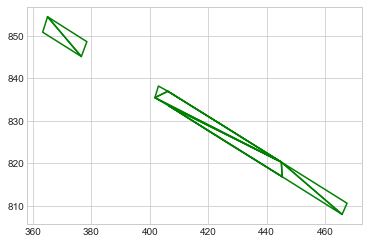

NOT VALID: POSITION
VALID:  False
position:  (527.9398856403934 @ 1687.020558369616)


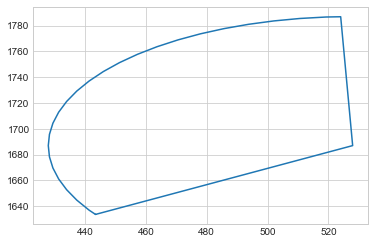

NOT VALID: POSITION
VALID:  False
position:  (2188.7205342395423 @ 791.6347178701818)


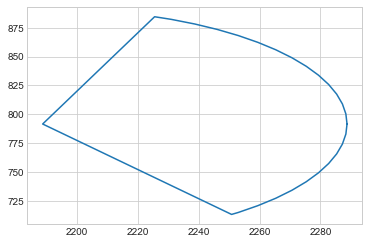

NOT VALID: POSITION
VALID:  False
position:  (1917.357693367985 @ 1059.005429878575)


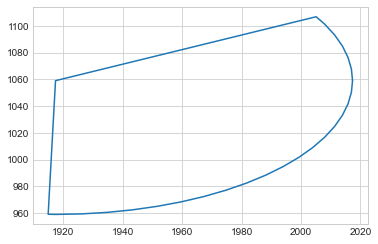

NOT VALID: POSITION
VALID:  False
position:  (1197.0562191399388 @ 1390.497990643683)


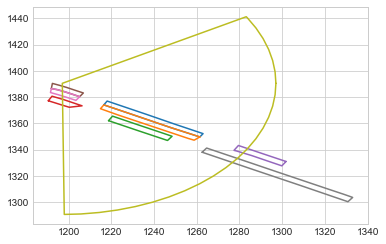

in Options class, polygonalRegions:  [<shapely.geometry.polygon.Polygon object at 0x248daa6d0>, <shapely.geometry.polygon.Polygon object at 0x248db33a0>, <shapely.geometry.polygon.Polygon object at 0x24941ee20>, <shapely.geometry.polygon.Polygon object at 0x2638910a0>, <shapely.geometry.polygon.Polygon object at 0x2640214c0>, <shapely.geometry.polygon.Polygon object at 0x2c4b24a00>, <shapely.geometry.polygon.Polygon object at 0x2c4b31670>, <shapely.geometry.polygon.Polygon object at 0x2c55fe0d0>]


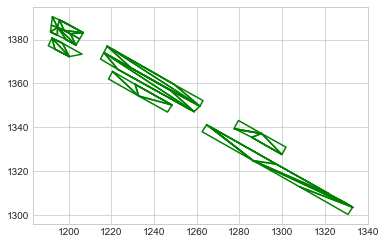

NOT VALID: POSITION
VALID:  False
position:  (1866.915051802043 @ 1064.1207021443893)


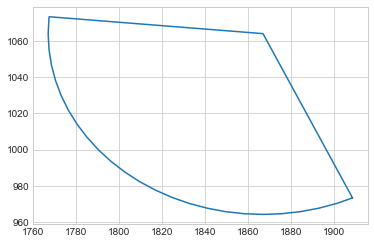

NOT VALID: POSITION
VALID:  False
position:  (530.8184781885457 @ 1558.0398695842593)


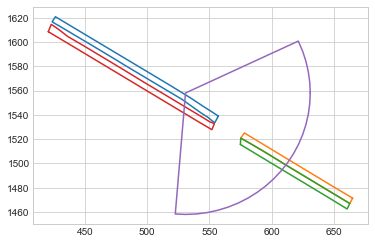

in Options class, polygonalRegions:  [<shapely.geometry.polygon.Polygon object at 0x24945ae20>, <shapely.geometry.polygon.Polygon object at 0x2c4f71be0>, <shapely.geometry.polygon.Polygon object at 0x2c4f7d910>, <shapely.geometry.polygon.Polygon object at 0x2c5cff4c0>]


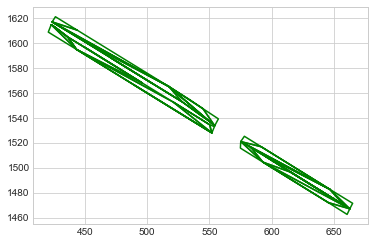

NOT VALID: POSITION
VALID:  False
position:  (1669.4248019444874 @ 945.3035165750474)


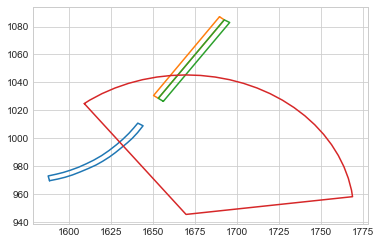

in Options class, polygonalRegions:  [<shapely.geometry.polygon.Polygon object at 0x248064730>, <shapely.geometry.polygon.Polygon object at 0x2494924c0>, <shapely.geometry.polygon.Polygon object at 0x249492e50>]


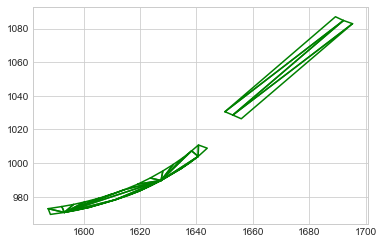

NOT VALID: POSITION
VALID:  False
position:  (1185.1334687124815 @ 1134.8981261609415)


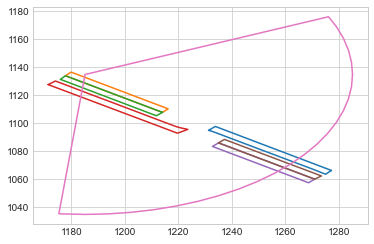

in Options class, polygonalRegions:  [<shapely.geometry.polygon.Polygon object at 0x248f88eb0>, <shapely.geometry.polygon.Polygon object at 0x263654640>, <shapely.geometry.polygon.Polygon object at 0x26365a250>, <shapely.geometry.polygon.Polygon object at 0x2c48e5c40>, <shapely.geometry.polygon.Polygon object at 0x2c5251070>, <shapely.geometry.polygon.Polygon object at 0x2c5251a60>]


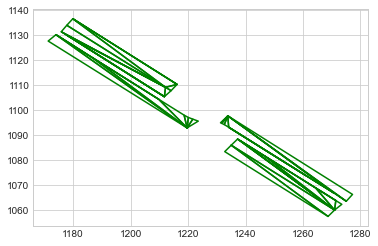

NOT VALID: POSITION
VALID:  False
position:  (1831.4816272437092 @ 1233.0397437858283)


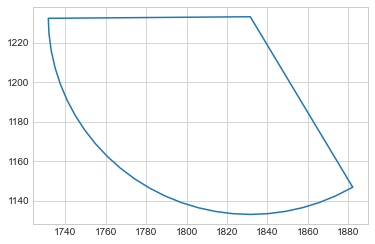

NOT VALID: POSITION
VALID:  False
position:  (301.5902459711847 @ 673.8966498029648)


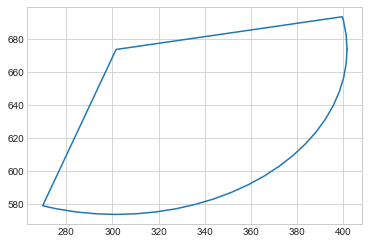

NOT VALID: POSITION
VALID:  False
position:  (1381.8193296076975 @ 1275.2172793126556)


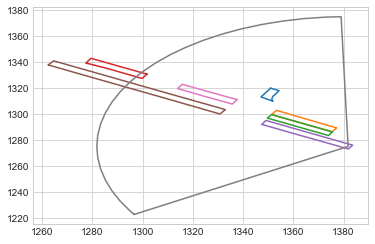

in Options class, polygonalRegions:  [<shapely.geometry.polygon.Polygon object at 0x2450fa160>, <shapely.geometry.polygon.Polygon object at 0x2452b2d90>, <shapely.geometry.polygon.Polygon object at 0x2452b97c0>, <shapely.geometry.polygon.Polygon object at 0x2640214c0>, <shapely.geometry.polygon.Polygon object at 0x2c53ac730>, <shapely.geometry.polygon.Polygon object at 0x2c55fe0d0>, <shapely.geometry.polygon.Polygon object at 0x2c5896580>]


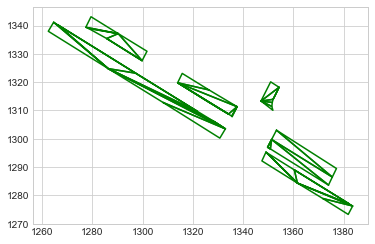

position is valid
heading:  1.0749745168538436
within get_traffic_flow
point:  (1381.8193296076975 @ 1275.2172793126556)
heading output =  1.0673574736979434
heading is valid
position:  (1393.783 @ 1257.169)
NOT VALID: POSITION
position:  (1381.8193296076975 @ 1275.2172793126556)
NOT VALID: POSITION
position:  (1408.17 @ 1278.231)
NOT VALID: POSITION
position:  (1381.8193296076975 @ 1275.2172793126556)
NOT VALID: POSITION
within get_traffic_flow
point:  (774.5747635410954 @ 415.762218142837)
heading output =  3.998104439752686
within get_traffic_flow
point:  (793.9461859810203 @ 406.03778886942274)
heading output =  3.9763259194330223
VALID:  True


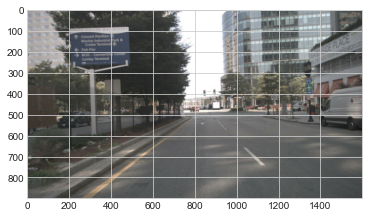

position:  (2095.657316362514 @ 941.3083709382939)


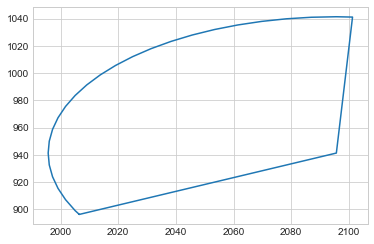

NOT VALID: POSITION
VALID:  False
position:  (1240.3375942851424 @ 959.8987555926758)


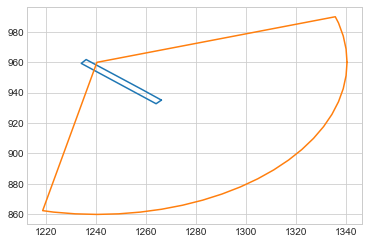

in Options class, polygonalRegions:  [<shapely.geometry.polygon.Polygon object at 0x2c5b37a90>]


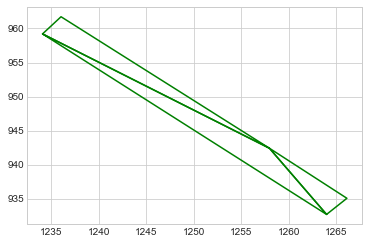

NOT VALID: POSITION
VALID:  False
position:  (298.1492136474717 @ 675.5443664338193)


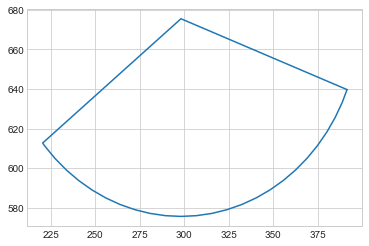

NOT VALID: POSITION
VALID:  False
position:  (678.841883814383 @ 1344.031878012494)


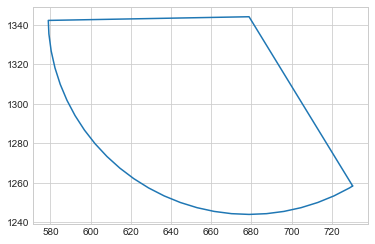

NOT VALID: POSITION
VALID:  False
position:  (1917.848104640854 @ 870.1550895740043)


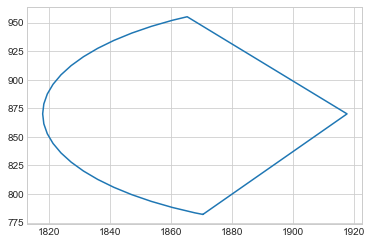

NOT VALID: POSITION
VALID:  False
position:  (1878.5849026732635 @ 1073.7770254916222)


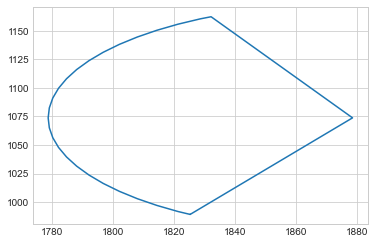

NOT VALID: POSITION
VALID:  False
position:  (764.1268251312213 @ 425.8799481053204)


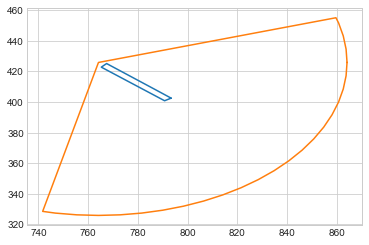

in Options class, polygonalRegions:  [<shapely.geometry.polygon.Polygon object at 0x248241550>]


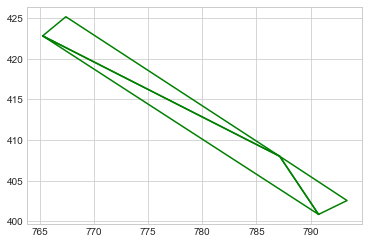

NOT VALID: POSITION
VALID:  False
position:  (510.2006519617162 @ 1696.407722380829)


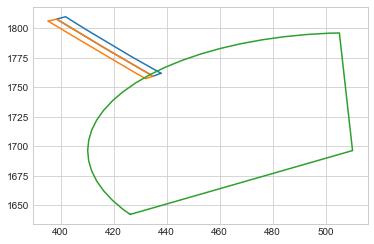

in Options class, polygonalRegions:  [<shapely.geometry.polygon.Polygon object at 0x248102ca0>, <shapely.geometry.polygon.Polygon object at 0x24810f910>]


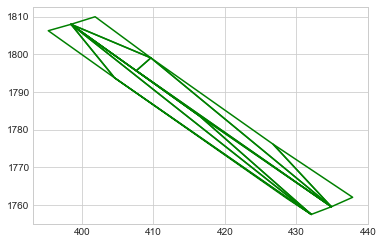

NOT VALID: POSITION
VALID:  False
position:  (2002.5276117201365 @ 1236.8532031395848)


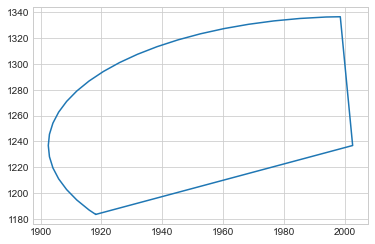

NOT VALID: POSITION
VALID:  False
position:  (805.9177049048471 @ 517.5589227673242)


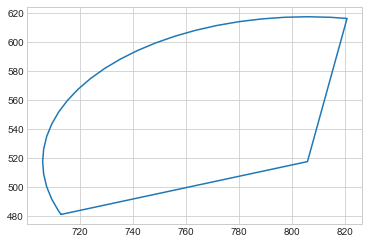

NOT VALID: POSITION
VALID:  False
position:  (1911.9117203755814 @ 869.5948537479844)


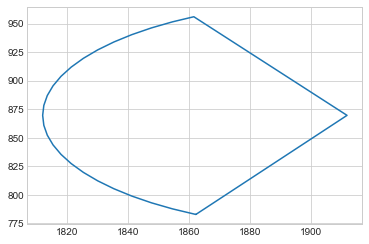

NOT VALID: POSITION
VALID:  False
position:  (1036.7419977104414 @ 497.3839847521367)


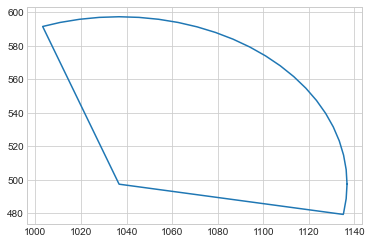

NOT VALID: POSITION
VALID:  False
position:  (1243.127730898757 @ 949.0912332451152)


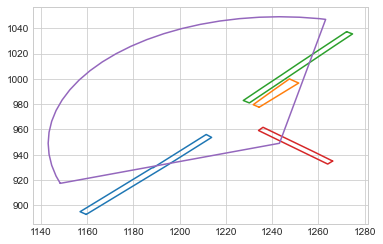

in Options class, polygonalRegions:  [<shapely.geometry.polygon.Polygon object at 0x24566e610>, <shapely.geometry.polygon.Polygon object at 0x263856160>, <shapely.geometry.polygon.Polygon object at 0x2c594c370>, <shapely.geometry.polygon.Polygon object at 0x2c5b37a90>]


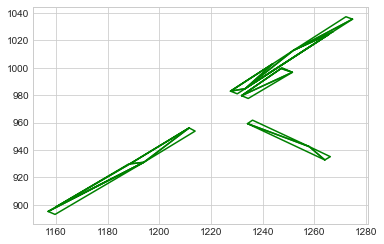

NOT VALID: POSITION
VALID:  False
position:  (759.9239850726565 @ 1515.029304414374)


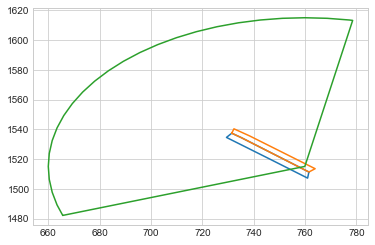

in Options class, polygonalRegions:  [<shapely.geometry.polygon.Polygon object at 0x2454b9a60>, <shapely.geometry.polygon.Polygon object at 0x2454c2670>]


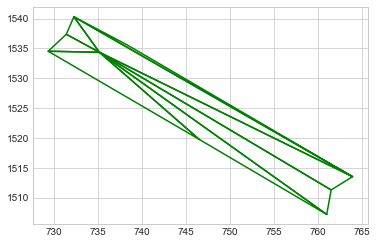

position is valid
heading:  0.8595325210960433
within get_traffic_flow
point:  (759.9239850726565 @ 1515.029304414374)
heading output =  0.8619605002069616
heading is valid
position:  (761.545 @ 1508.955)
NOT VALID: POSITION
position:  (759.9239850726565 @ 1515.029304414374)
NOT VALID: POSITION
position:  (793.527 @ 1503.259)
NOT VALID: POSITION
position:  (759.9239850726565 @ 1515.029304414374)
NOT VALID: POSITION
within get_traffic_flow
point:  (987.0006853523453 @ 1379.9904736115477)
heading output =  1.4102544540870579
within get_traffic_flow
point:  (967.3296121602799 @ 1378.8434027221288)
heading output =  1.4049049593302882
VALID:  True


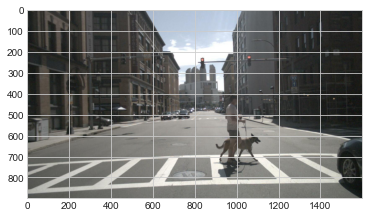

position:  (1827.4218654460087 @ 1156.4252250316913)


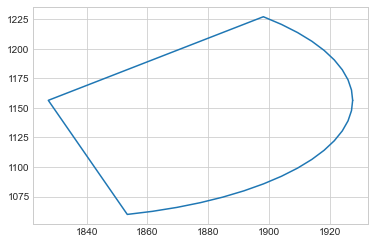

NOT VALID: POSITION
VALID:  False
position:  (1301.203353145971 @ 896.0731321279693)


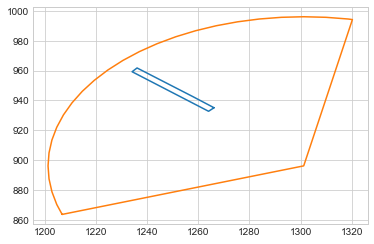

in Options class, polygonalRegions:  [<shapely.geometry.polygon.Polygon object at 0x2c5b37a90>]


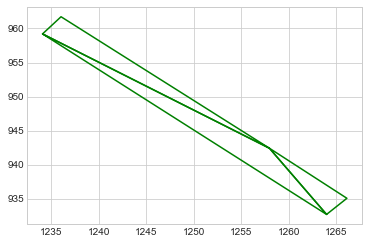

NOT VALID: POSITION
VALID:  False
position:  (457.5530521870435 @ 1718.280832319858)


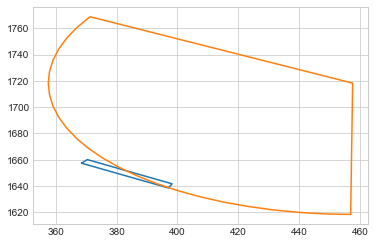

in Options class, polygonalRegions:  [<shapely.geometry.polygon.Polygon object at 0x248d0baf0>]


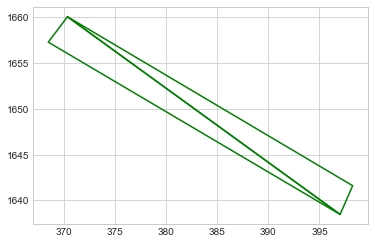

NOT VALID: POSITION
VALID:  False
position:  (2111.4264993312195 @ 931.607514581534)


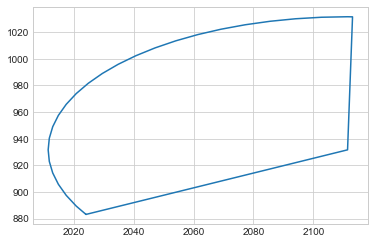

NOT VALID: POSITION
VALID:  False
position:  (524.224046948978 @ 638.1449511139724)


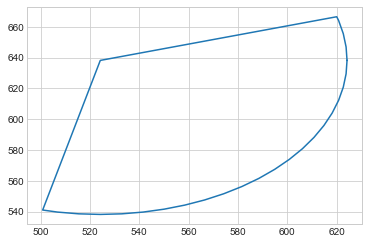

NOT VALID: POSITION
VALID:  False
position:  (1598.3867633642485 @ 863.8240325555025)


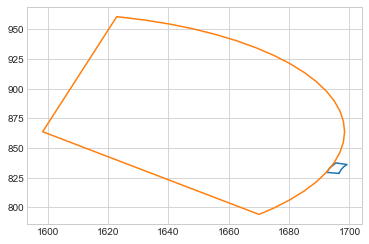

in Options class, polygonalRegions:  [<shapely.geometry.polygon.Polygon object at 0x2494b9a00>]


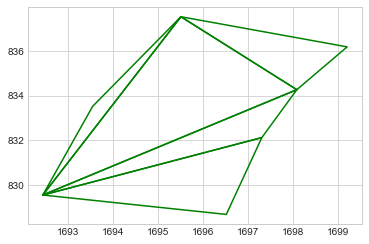

NOT VALID: POSITION
VALID:  False
position:  (1158.9935206322982 @ 1153.730970425514)


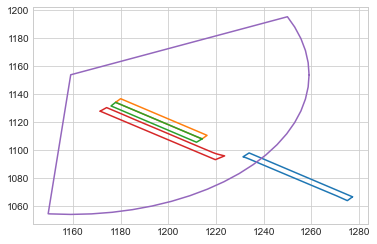

in Options class, polygonalRegions:  [<shapely.geometry.polygon.Polygon object at 0x248f88eb0>, <shapely.geometry.polygon.Polygon object at 0x263654640>, <shapely.geometry.polygon.Polygon object at 0x26365a250>, <shapely.geometry.polygon.Polygon object at 0x2c48e5c40>]


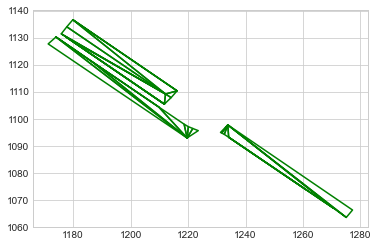

NOT VALID: POSITION
VALID:  False
position:  (1869.0874643807138 @ 1098.1785155588454)


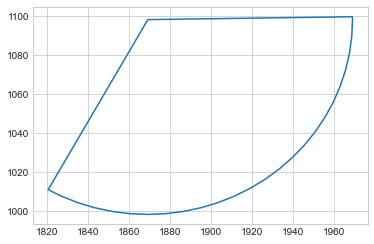

NOT VALID: POSITION
VALID:  False
position:  (418.56410236275497 @ 894.4394521905328)


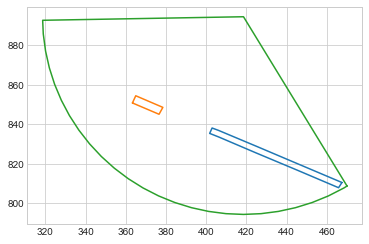

in Options class, polygonalRegions:  [<shapely.geometry.polygon.Polygon object at 0x2495d0400>, <shapely.geometry.polygon.Polygon object at 0x264439d60>]


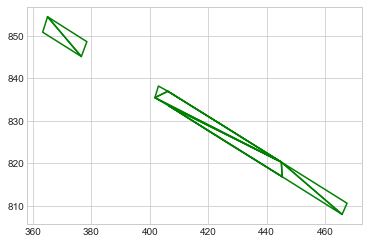

NOT VALID: POSITION
VALID:  False
position:  (738.4784094541362 @ 581.0319179919321)


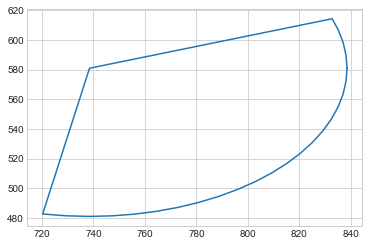

NOT VALID: POSITION
VALID:  False
position:  (1301.203360737541 @ 896.0731255318626)


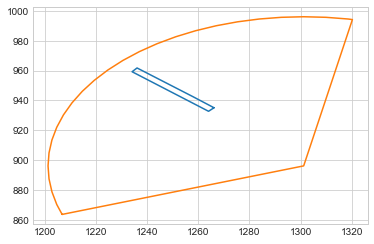

in Options class, polygonalRegions:  [<shapely.geometry.polygon.Polygon object at 0x2c5b37a90>]


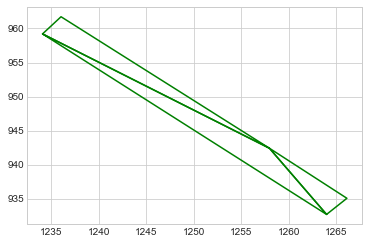

NOT VALID: POSITION
VALID:  False
position:  (1183.7486594071815 @ 1135.9017959765818)


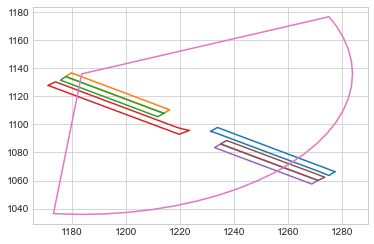

in Options class, polygonalRegions:  [<shapely.geometry.polygon.Polygon object at 0x248f88eb0>, <shapely.geometry.polygon.Polygon object at 0x263654640>, <shapely.geometry.polygon.Polygon object at 0x26365a250>, <shapely.geometry.polygon.Polygon object at 0x2c48e5c40>, <shapely.geometry.polygon.Polygon object at 0x2c5251070>, <shapely.geometry.polygon.Polygon object at 0x2c5251a60>]


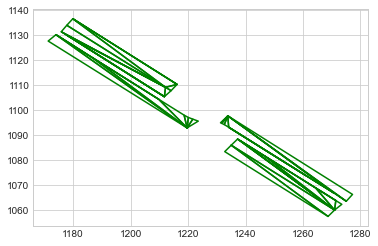

NOT VALID: POSITION
VALID:  False
position:  (2497.8374993335715 @ 881.72889102227)


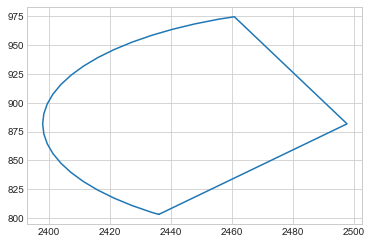

NOT VALID: POSITION
VALID:  False
position:  (782.4627220019963 @ 410.4685902810983)


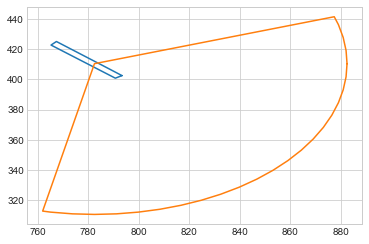

in Options class, polygonalRegions:  [<shapely.geometry.polygon.Polygon object at 0x248241550>]


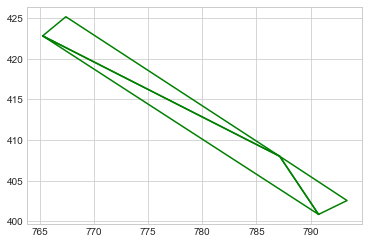

position is valid
heading:  3.9820919396129306
within get_traffic_flow
point:  (782.4627220019963 @ 410.4685902810983)
heading output =  3.998104439752686
heading is valid
position:  (725.753 @ 462.445)
NOT VALID: POSITION
position:  (782.4627220019963 @ 410.4685902810983)
NOT VALID: POSITION
within get_traffic_flow
point:  (1125.823427020599 @ 856.5266469499776)
heading output =  2.422956878877681
within get_traffic_flow
point:  (1101.1099792289235 @ 823.0278458418106)
heading output =  2.4239609594531064
VALID:  True


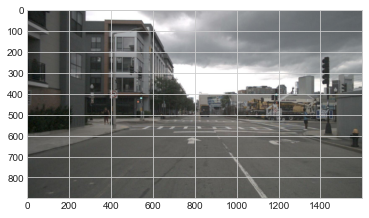

position:  (1951.897606308235 @ 1042.991907626068)


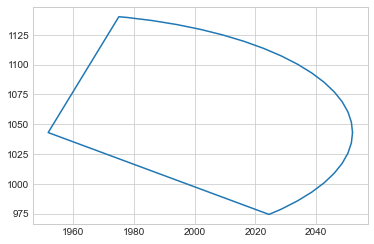

NOT VALID: POSITION
VALID:  False
position:  (1929.6639126624204 @ 869.5101821819424)


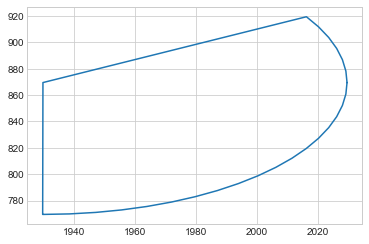

NOT VALID: POSITION
VALID:  False
position:  (806.5619017670506 @ 517.0248181312127)


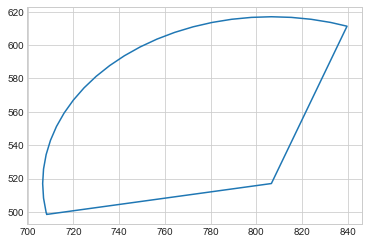

NOT VALID: POSITION
VALID:  False
position:  (1556.3319154672758 @ 838.2527372808744)


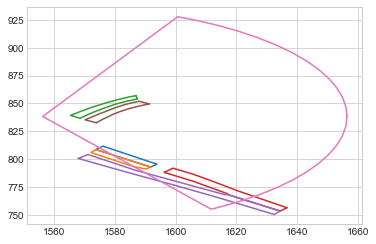

in Options class, polygonalRegions:  [<shapely.geometry.polygon.Polygon object at 0x248e2e5b0>, <shapely.geometry.polygon.Polygon object at 0x248e2efa0>, <shapely.geometry.polygon.Polygon object at 0x2496d36d0>, <shapely.geometry.polygon.Polygon object at 0x26449dd60>, <shapely.geometry.polygon.Polygon object at 0x2644a6a30>, <shapely.geometry.polygon.Polygon object at 0x2c569f490>]


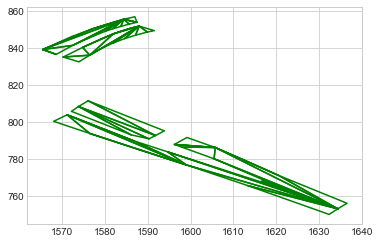

NOT VALID: POSITION
VALID:  False
position:  (605.4555299217541 @ 698.3468783379551)


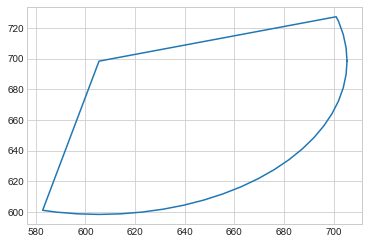

NOT VALID: POSITION
VALID:  False
position:  (695.758556052182 @ 618.3216097030273)


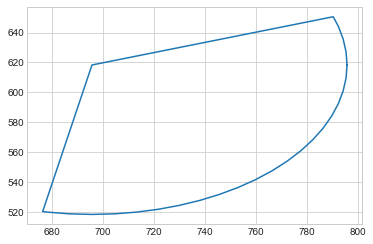

NOT VALID: POSITION
VALID:  False
position:  (649.3767155934095 @ 658.917535394883)


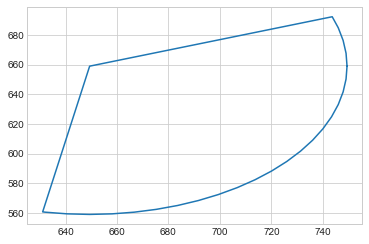

NOT VALID: POSITION
VALID:  False
position:  (752.3710173749919 @ 563.347101371691)


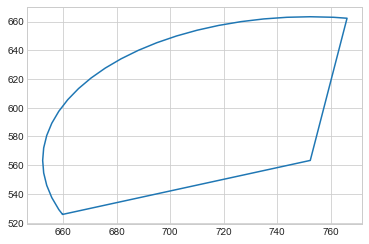

NOT VALID: POSITION
VALID:  False
position:  (2058.8048276600152 @ 789.7315125754859)


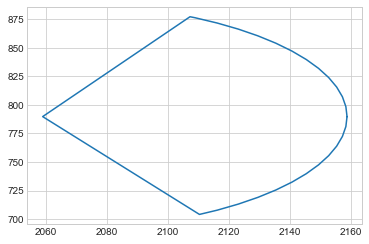

NOT VALID: POSITION
VALID:  False
position:  (1185.1007474950593 @ 1134.924152182949)


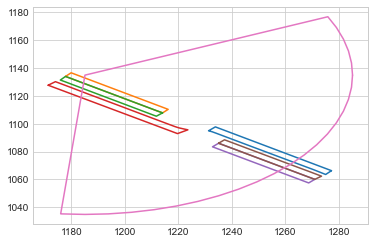

in Options class, polygonalRegions:  [<shapely.geometry.polygon.Polygon object at 0x248f88eb0>, <shapely.geometry.polygon.Polygon object at 0x263654640>, <shapely.geometry.polygon.Polygon object at 0x26365a250>, <shapely.geometry.polygon.Polygon object at 0x2c48e5c40>, <shapely.geometry.polygon.Polygon object at 0x2c5251070>, <shapely.geometry.polygon.Polygon object at 0x2c5251a60>]


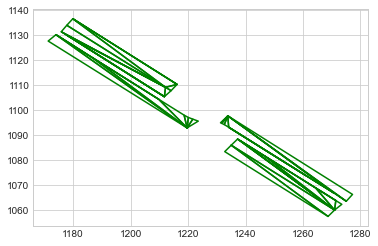

NOT VALID: POSITION
VALID:  False
position:  (309.18765462326337 @ 668.6675164690571)


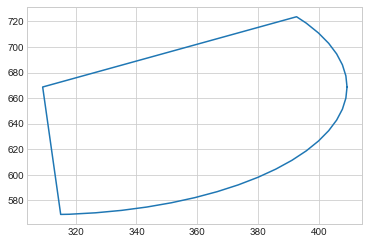

NOT VALID: POSITION
VALID:  False
position:  (1869.1864623513297 @ 1067.9828473768175)


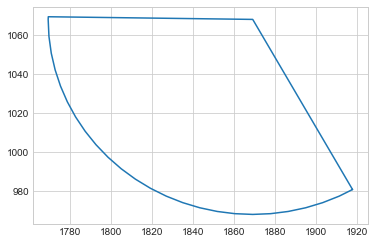

NOT VALID: POSITION
VALID:  False
position:  (759.9259785902154 @ 1515.0316191042834)


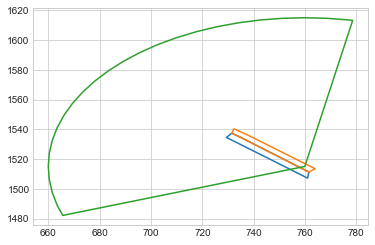

in Options class, polygonalRegions:  [<shapely.geometry.polygon.Polygon object at 0x2454b9a60>, <shapely.geometry.polygon.Polygon object at 0x2454c2670>]


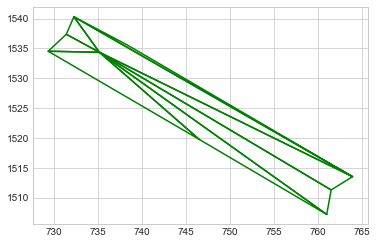

position is valid
heading:  0.8594073207672396
within get_traffic_flow
point:  (759.9259785902154 @ 1515.0316191042834)
heading output =  0.8619605002069616
heading is valid
position:  (761.545 @ 1508.955)
NOT VALID: POSITION
position:  (759.9259785902154 @ 1515.0316191042834)
NOT VALID: POSITION
position:  (793.527 @ 1503.259)
NOT VALID: POSITION
position:  (759.9259785902154 @ 1515.0316191042834)
NOT VALID: POSITION
within get_traffic_flow
point:  (936.955600538109 @ 1391.8300406778576)
heading output =  4.352295891914635
within get_traffic_flow
point:  (932.7225440998105 @ 1399.3532293342212)
heading output =  4.350633922253366
VALID:  True


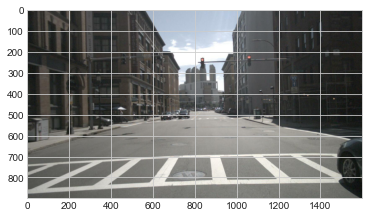

position:  (1937.5025820159767 @ 830.7554577593837)


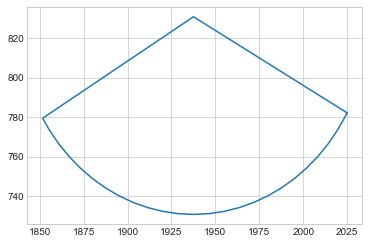

NOT VALID: POSITION
VALID:  False
position:  (740.3490349477131 @ 578.9617839283601)


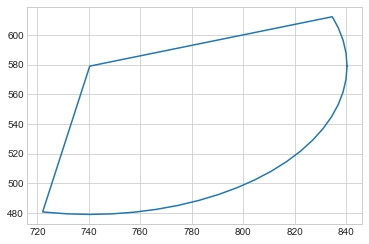

NOT VALID: POSITION
VALID:  False
position:  (1419.6099441520557 @ 948.1823795919074)


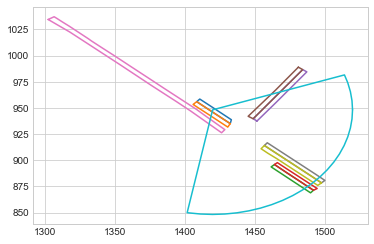

in Options class, polygonalRegions:  [<shapely.geometry.polygon.Polygon object at 0x244e8aeb0>, <shapely.geometry.polygon.Polygon object at 0x244e95a90>, <shapely.geometry.polygon.Polygon object at 0x2c48543d0>, <shapely.geometry.polygon.Polygon object at 0x2c4854ee0>, <shapely.geometry.polygon.Polygon object at 0x2c4c25910>, <shapely.geometry.polygon.Polygon object at 0x2c4c2e400>, <shapely.geometry.polygon.Polygon object at 0x2c506e2b0>, <shapely.geometry.polygon.Polygon object at 0x2c5c55970>, <shapely.geometry.polygon.Polygon object at 0x2c5c5d580>]


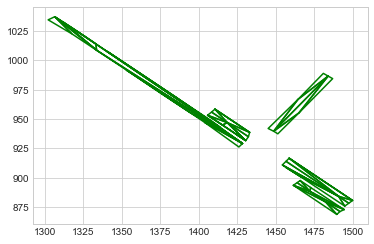

position is valid
heading:  4.005626608132651
within get_traffic_flow
point:  (1419.6099441520557 @ 948.1823795919074)
heading output =  3.993137939934231
heading is valid
position:  (1387.555 @ 958.682)
NOT VALID: POSITION
position:  (1419.6099441520557 @ 948.1823795919074)
NOT VALID: POSITION
position:  (1370.715 @ 972.314)
NOT VALID: POSITION
position:  (1419.6099441520557 @ 948.1823795919074)
NOT VALID: POSITION
within get_traffic_flow
point:  (1306.43273634985 @ 1060.6214415359389)
heading output =  2.443501780002331
within get_traffic_flow
point:  (1314.0106718364316 @ 1061.4090839119408)
heading output =  2.4538619376163604
VALID:  True


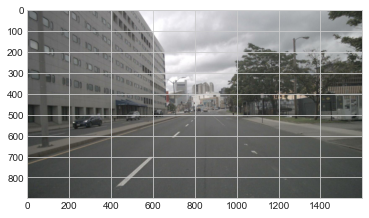

position:  (1502.7331733671592 @ 1361.728300145716)


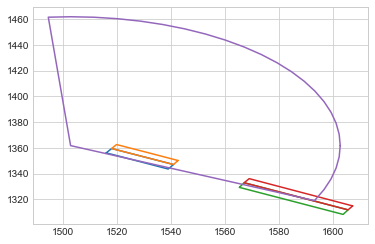

in Options class, polygonalRegions:  [<shapely.geometry.polygon.Polygon object at 0x2481edc40>, <shapely.geometry.polygon.Polygon object at 0x2481f7730>, <shapely.geometry.polygon.Polygon object at 0x2c4cc5cd0>, <shapely.geometry.polygon.Polygon object at 0x2c4cce6a0>]


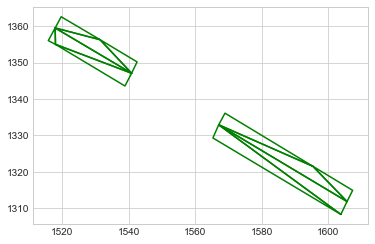

NOT VALID: POSITION
VALID:  False
position:  (793.9628450118589 @ 400.5426955253401)


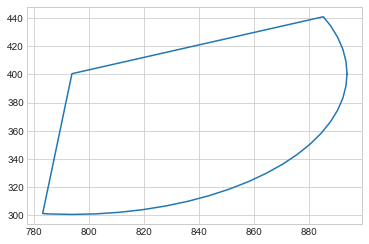

NOT VALID: POSITION
VALID:  False
position:  (1301.2033548602349 @ 896.0731306362499)


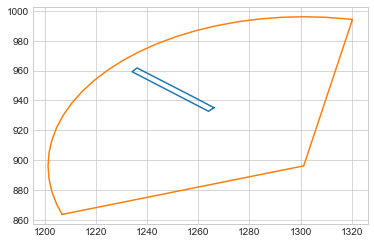

in Options class, polygonalRegions:  [<shapely.geometry.polygon.Polygon object at 0x2c5b37a90>]


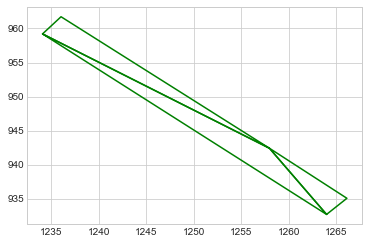

NOT VALID: POSITION
VALID:  False
position:  (492.16714030751496 @ 1583.1070343061542)


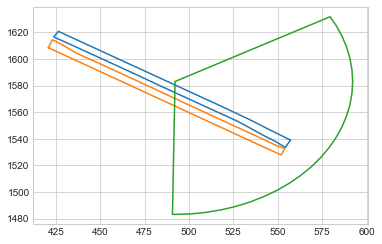

in Options class, polygonalRegions:  [<shapely.geometry.polygon.Polygon object at 0x24945ae20>, <shapely.geometry.polygon.Polygon object at 0x2c5cff4c0>]


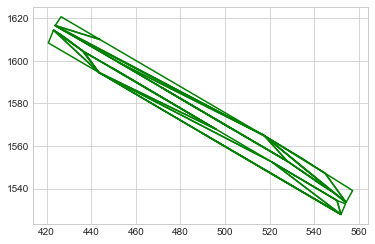

NOT VALID: POSITION
VALID:  False
position:  (2192.9708906325777 @ 792.113215216536)


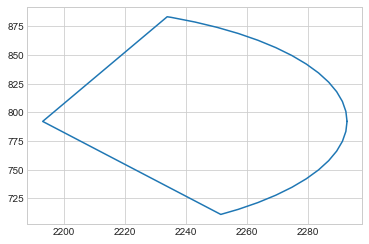

NOT VALID: POSITION
VALID:  False
position:  (1880.110069721878 @ 1084.3558324721146)


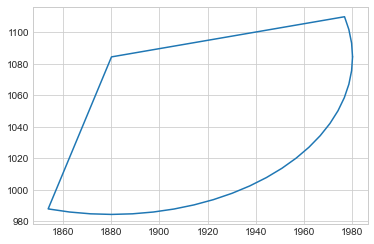

NOT VALID: POSITION
VALID:  False
position:  (1828.5321678338623 @ 1155.9881359954893)


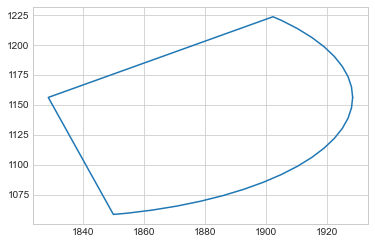

NOT VALID: POSITION
VALID:  False
position:  (1869.5840281733904 @ 1068.637039077882)


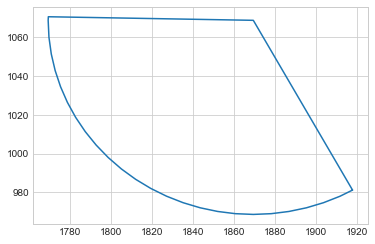

NOT VALID: POSITION
VALID:  False
position:  (1182.5302145709031 @ 1136.8107322352885)


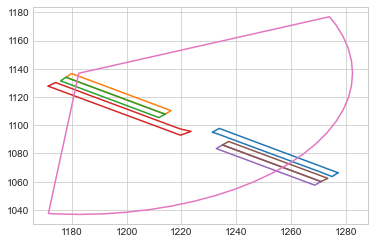

in Options class, polygonalRegions:  [<shapely.geometry.polygon.Polygon object at 0x248f88eb0>, <shapely.geometry.polygon.Polygon object at 0x263654640>, <shapely.geometry.polygon.Polygon object at 0x26365a250>, <shapely.geometry.polygon.Polygon object at 0x2c48e5c40>, <shapely.geometry.polygon.Polygon object at 0x2c5251070>, <shapely.geometry.polygon.Polygon object at 0x2c5251a60>]


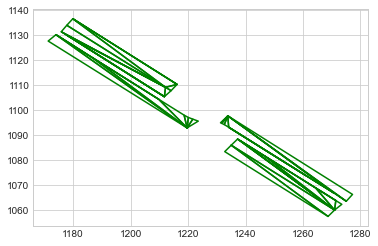

NOT VALID: POSITION
VALID:  False
position:  (2526.269563579848 @ 834.0350997683189)


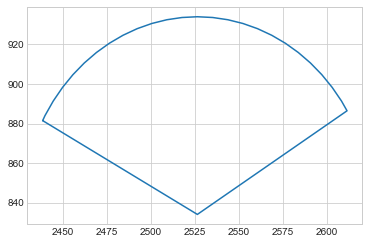

NOT VALID: POSITION
VALID:  False
position:  (1830.0976298565583 @ 1155.225821735092)


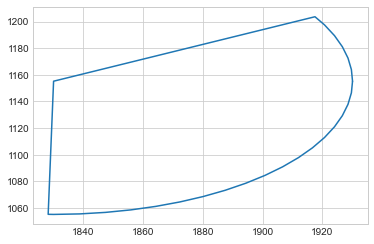

NOT VALID: POSITION
VALID:  False
position:  (1736.711336168919 @ 1236.0473585795185)


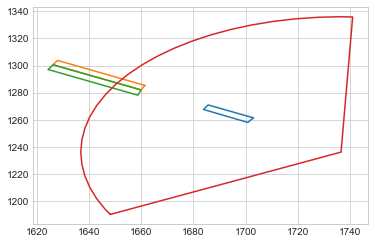

in Options class, polygonalRegions:  [<shapely.geometry.polygon.Polygon object at 0x2454fbcd0>, <shapely.geometry.polygon.Polygon object at 0x2480c9b50>, <shapely.geometry.polygon.Polygon object at 0x2480d2520>]


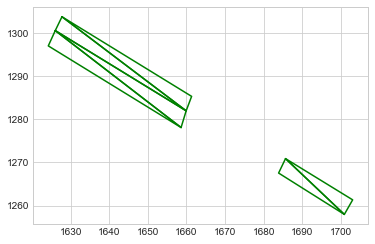

NOT VALID: POSITION
VALID:  False
position:  (1185.1335395643946 @ 1134.8982243380829)


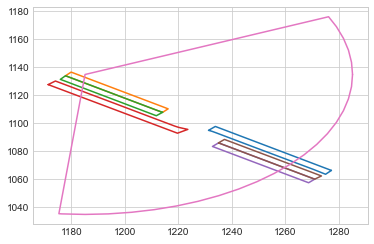

in Options class, polygonalRegions:  [<shapely.geometry.polygon.Polygon object at 0x248f88eb0>, <shapely.geometry.polygon.Polygon object at 0x263654640>, <shapely.geometry.polygon.Polygon object at 0x26365a250>, <shapely.geometry.polygon.Polygon object at 0x2c48e5c40>, <shapely.geometry.polygon.Polygon object at 0x2c5251070>, <shapely.geometry.polygon.Polygon object at 0x2c5251a60>]


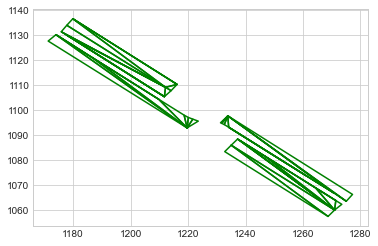

NOT VALID: POSITION
VALID:  False
position:  (1460.3648846975436 @ 913.0924672097522)


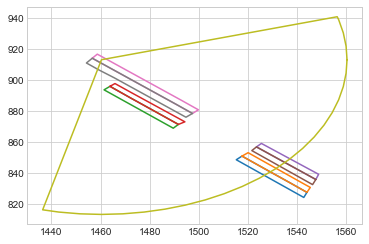

in Options class, polygonalRegions:  [<shapely.geometry.polygon.Polygon object at 0x248cee370>, <shapely.geometry.polygon.Polygon object at 0x248ceee80>, <shapely.geometry.polygon.Polygon object at 0x2c48543d0>, <shapely.geometry.polygon.Polygon object at 0x2c4854ee0>, <shapely.geometry.polygon.Polygon object at 0x2c51927c0>, <shapely.geometry.polygon.Polygon object at 0x2c519b1f0>, <shapely.geometry.polygon.Polygon object at 0x2c5c55970>, <shapely.geometry.polygon.Polygon object at 0x2c5c5d580>]


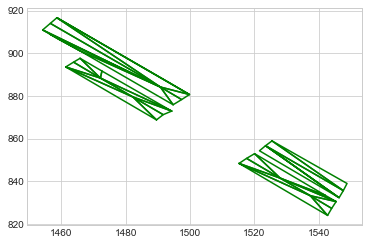

position is valid
heading:  3.9468708223605384
within get_traffic_flow
point:  (1460.3648846975436 @ 913.0924672097522)
heading output =  3.993938954957558
heading is valid
position:  (1426.543 @ 927.99)
NOT VALID: POSITION
position:  (1460.3648846975436 @ 913.0924672097522)
NOT VALID: POSITION
position:  (1393.69 @ 975.582)
NOT VALID: POSITION
position:  (1460.3648846975436 @ 913.0924672097522)
NOT VALID: POSITION
position:  (1359.137 @ 983.122)
NOT VALID: POSITION
position:  (1460.3648846975436 @ 913.0924672097522)
NOT VALID: POSITION
position:  (1359.137 @ 983.122)
NOT VALID: POSITION
position:  (1460.3648846975436 @ 913.0924672097522)
NOT VALID: POSITION
position:  (1426.543 @ 927.99)
NOT VALID: POSITION
position:  (1460.3648846975436 @ 913.0924672097522)
NOT VALID: POSITION
position:  (1393.69 @ 975.582)
NOT VALID: POSITION
position:  (1460.3648846975436 @ 913.0924672097522)
NOT VALID: POSITION
within get_traffic_flow
point:  (1464.8692193432264 @ 902.9070450893493)
heading output

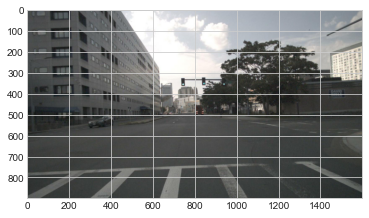

position:  (1027.2050183937743 @ 487.11910607259733)


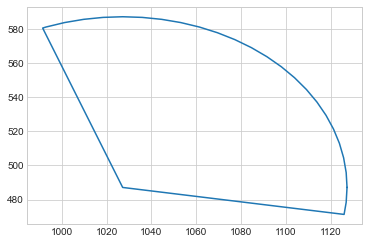

NOT VALID: POSITION
VALID:  False
position:  (1369.5267452074368 @ 991.9145169053384)


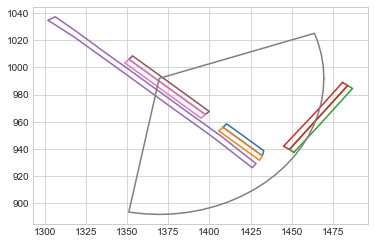

in Options class, polygonalRegions:  [<shapely.geometry.polygon.Polygon object at 0x244e8aeb0>, <shapely.geometry.polygon.Polygon object at 0x244e95a90>, <shapely.geometry.polygon.Polygon object at 0x2c4c25910>, <shapely.geometry.polygon.Polygon object at 0x2c4c2e400>, <shapely.geometry.polygon.Polygon object at 0x2c506e2b0>, <shapely.geometry.polygon.Polygon object at 0x2c5a697f0>, <shapely.geometry.polygon.Polygon object at 0x2c5a744c0>]


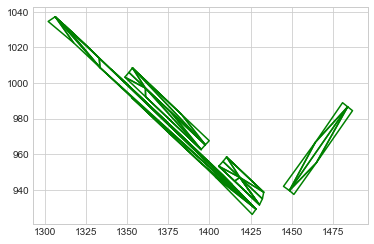

position is valid
heading:  4.002697758318629
within get_traffic_flow
point:  (1369.5267452074368 @ 991.9145169053384)
heading output =  3.993138586293062
heading is valid
position:  (1322.975 @ 1015.952)
NOT VALID: POSITION
position:  (1369.5267452074368 @ 991.9145169053384)
NOT VALID: POSITION
position:  (1301.601 @ 1053.769)
NOT VALID: POSITION
position:  (1369.5267452074368 @ 991.9145169053384)
NOT VALID: POSITION
position:  (1283.986 @ 1049.162)
NOT VALID: POSITION
position:  (1369.5267452074368 @ 991.9145169053384)
NOT VALID: POSITION
position:  (1283.986 @ 1049.162)
NOT VALID: POSITION
position:  (1369.5267452074368 @ 991.9145169053384)
NOT VALID: POSITION
position:  (1322.975 @ 1015.952)
NOT VALID: POSITION
position:  (1369.5267452074368 @ 991.9145169053384)
NOT VALID: POSITION
position:  (1301.601 @ 1053.769)
NOT VALID: POSITION
position:  (1369.5267452074368 @ 991.9145169053384)
NOT VALID: POSITION
within get_traffic_flow
point:  (1709.2510010312772 @ 853.9553899259498)
headi

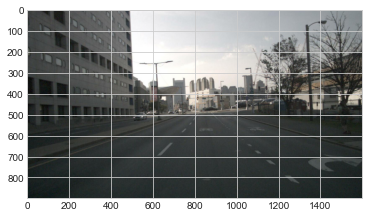

position:  (678.6986155554591 @ 1343.8027071003573)


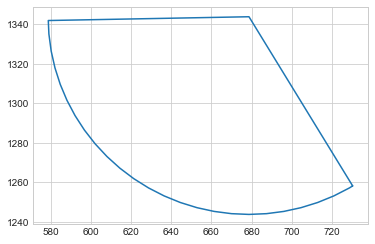

NOT VALID: POSITION
VALID:  False
position:  (602.2534754350156 @ 701.443880495782)


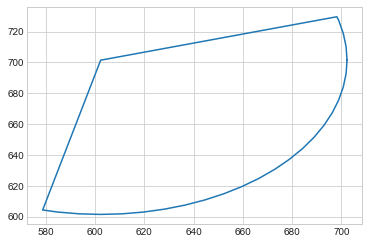

NOT VALID: POSITION
VALID:  False
position:  (1360.0710361775218 @ 1134.3659005476338)


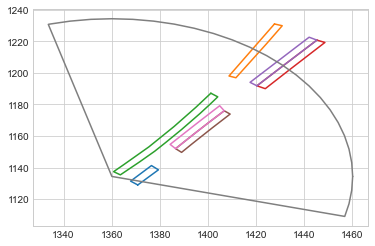

in Options class, polygonalRegions:  [<shapely.geometry.polygon.Polygon object at 0x24510fb80>, <shapely.geometry.polygon.Polygon object at 0x2499916a0>, <shapely.geometry.polygon.Polygon object at 0x2c5099d90>, <shapely.geometry.polygon.Polygon object at 0x2c50c1cd0>, <shapely.geometry.polygon.Polygon object at 0x2c50c98e0>, <shapely.geometry.polygon.Polygon object at 0x2c59e6d60>, <shapely.geometry.polygon.Polygon object at 0x2c59f1a30>]


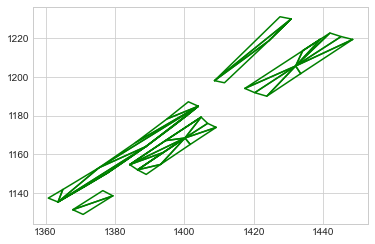

NOT VALID: POSITION
VALID:  False
position:  (1868.4140389198876 @ 1066.246214989931)


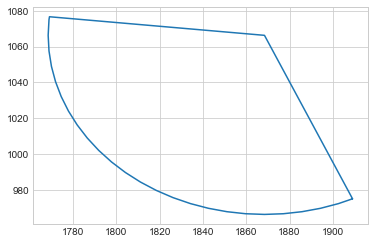

NOT VALID: POSITION
VALID:  False
position:  (1185.1333545184264 @ 1134.8979642399777)


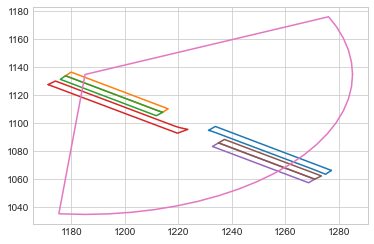

in Options class, polygonalRegions:  [<shapely.geometry.polygon.Polygon object at 0x248f88eb0>, <shapely.geometry.polygon.Polygon object at 0x263654640>, <shapely.geometry.polygon.Polygon object at 0x26365a250>, <shapely.geometry.polygon.Polygon object at 0x2c48e5c40>, <shapely.geometry.polygon.Polygon object at 0x2c5251070>, <shapely.geometry.polygon.Polygon object at 0x2c5251a60>]


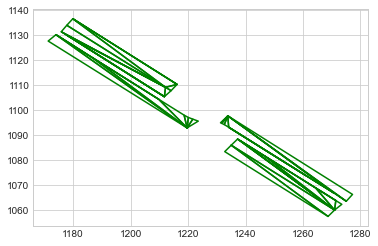

NOT VALID: POSITION
VALID:  False
position:  (418.82581531551114 @ 619.8999338899991)


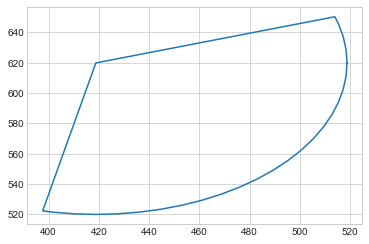

NOT VALID: POSITION
VALID:  False
position:  (770.0659144103442 @ 421.2352688555793)


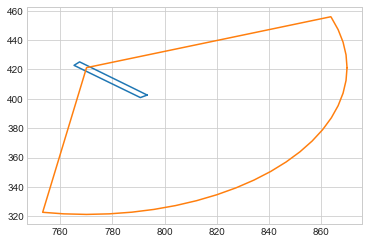

in Options class, polygonalRegions:  [<shapely.geometry.polygon.Polygon object at 0x248241550>]


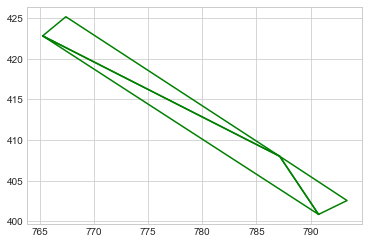

position is valid
heading:  4.019560995661693
within get_traffic_flow
point:  (770.0659144103442 @ 421.2352688555793)
heading output =  3.998104439752686
heading is valid
position:  (744.979 @ 441.731)
NOT VALID: POSITION
position:  (770.0659144103442 @ 421.2352688555793)
NOT VALID: POSITION
within get_traffic_flow
point:  (1570.079366975764 @ 1330.9821029918235)
heading output =  1.0714979682816352
within get_traffic_flow
point:  (1591.4723455135706 @ 1310.4558120855943)
heading output =  1.0703458040110605
VALID:  True


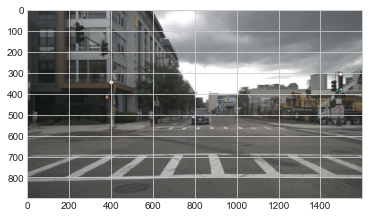

position:  (1717.3593330046765 @ 858.2699474328717)


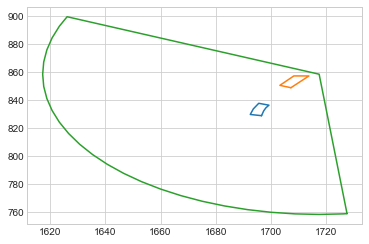

in Options class, polygonalRegions:  [<shapely.geometry.polygon.Polygon object at 0x2494b9a00>, <shapely.geometry.polygon.Polygon object at 0x2c214bdc0>]


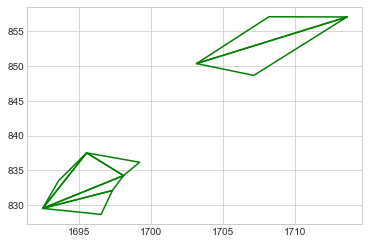

NOT VALID: POSITION
VALID:  False
position:  (1948.0513754864373 @ 1042.8260964136766)


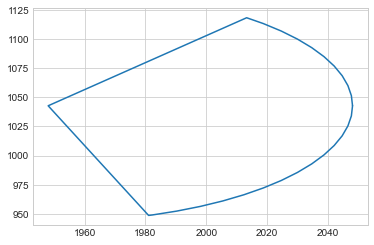

NOT VALID: POSITION
VALID:  False
position:  (1185.1335462875743 @ 1134.8982247986503)


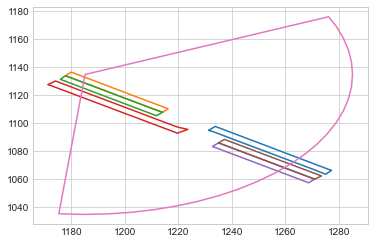

in Options class, polygonalRegions:  [<shapely.geometry.polygon.Polygon object at 0x248f88eb0>, <shapely.geometry.polygon.Polygon object at 0x263654640>, <shapely.geometry.polygon.Polygon object at 0x26365a250>, <shapely.geometry.polygon.Polygon object at 0x2c48e5c40>, <shapely.geometry.polygon.Polygon object at 0x2c5251070>, <shapely.geometry.polygon.Polygon object at 0x2c5251a60>]


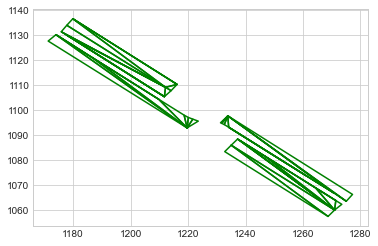

NOT VALID: POSITION
VALID:  False
position:  (1236.0240311576304 @ 964.2414444878629)


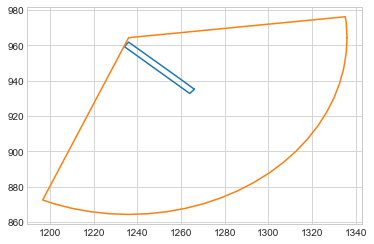

in Options class, polygonalRegions:  [<shapely.geometry.polygon.Polygon object at 0x2c5b37a90>]


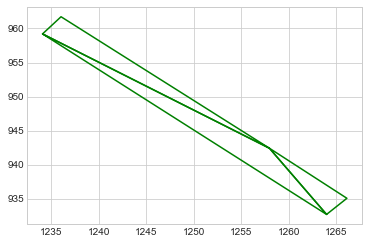

NOT VALID: POSITION
VALID:  False
position:  (614.6398627077735 @ 689.1072350356118)


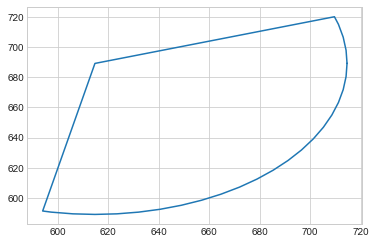

NOT VALID: POSITION
VALID:  False
position:  (2526.599400076504 @ 817.0901380041988)


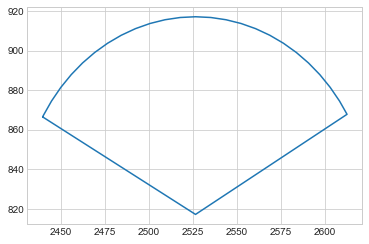

NOT VALID: POSITION
VALID:  False
position:  (802.4948963792922 @ 520.4605233831292)


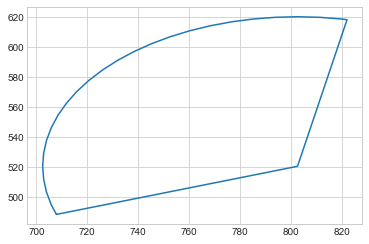

NOT VALID: POSITION
VALID:  False
position:  (1239.488982533634 @ 960.7237179342009)


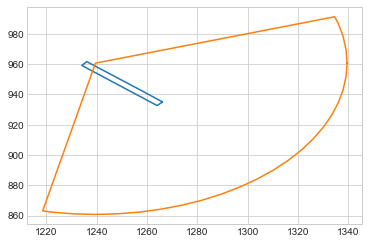

in Options class, polygonalRegions:  [<shapely.geometry.polygon.Polygon object at 0x2c5b37a90>]


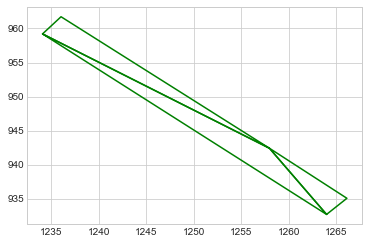

NOT VALID: POSITION
VALID:  False
position:  (1757.6181525332508 @ 1219.5856512005)


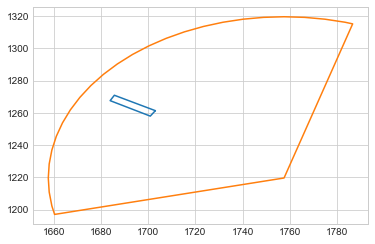

in Options class, polygonalRegions:  [<shapely.geometry.polygon.Polygon object at 0x2454fbcd0>]


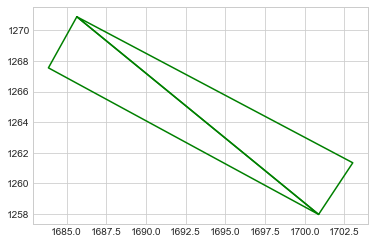

NOT VALID: POSITION
VALID:  False
position:  (545.6054297260157 @ 755.4646219483218)


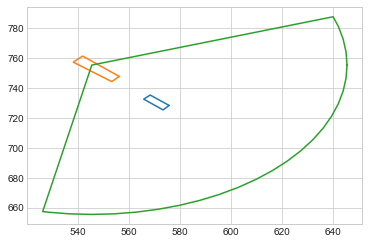

in Options class, polygonalRegions:  [<shapely.geometry.polygon.Polygon object at 0x2c40d8400>, <shapely.geometry.polygon.Polygon object at 0x2c47d9370>]


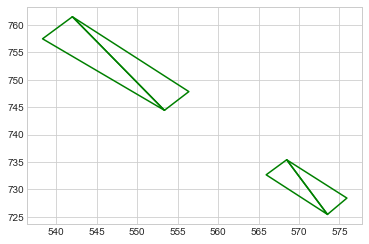

position is valid
heading:  3.9949137890136615
within get_traffic_flow
point:  (545.6054297260157 @ 755.4646219483218)
heading output =  3.9759529630445
heading is valid
position:  (526.615 @ 796.437)
NOT VALID: POSITION
position:  (545.6054297260157 @ 755.4646219483218)
NOT VALID: POSITION
position:  (530.769 @ 802.911)
NOT VALID: POSITION
position:  (545.6054297260157 @ 755.4646219483218)
NOT VALID: POSITION
position:  (501.904 @ 816.838)
NOT VALID: POSITION
position:  (545.6054297260157 @ 755.4646219483218)
NOT VALID: POSITION
position:  (501.904 @ 816.838)
NOT VALID: POSITION
position:  (545.6054297260157 @ 755.4646219483218)
NOT VALID: POSITION
position:  (526.615 @ 796.437)
NOT VALID: POSITION
position:  (545.6054297260157 @ 755.4646219483218)
NOT VALID: POSITION
position:  (530.769 @ 802.911)
NOT VALID: POSITION
position:  (545.6054297260157 @ 755.4646219483218)
NOT VALID: POSITION
within get_traffic_flow
point:  (388.38878930307993 @ 1824.2174807608121)
heading output =  3.7955

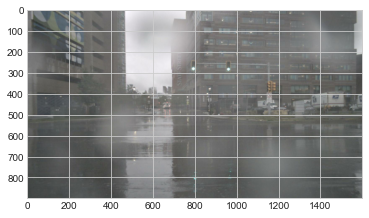

position:  (759.923249228942 @ 1515.0284495401122)


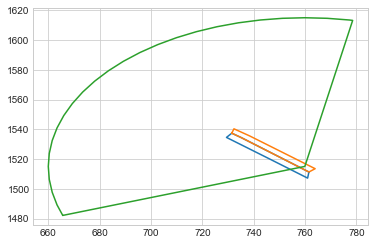

in Options class, polygonalRegions:  [<shapely.geometry.polygon.Polygon object at 0x2454b9a60>, <shapely.geometry.polygon.Polygon object at 0x2454c2670>]


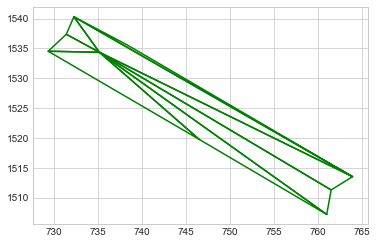

position is valid
heading:  0.8595762151640551
within get_traffic_flow
point:  (759.923249228942 @ 1515.0284495401122)
heading output =  0.8619605002069616
heading is valid
position:  (761.545 @ 1508.955)
NOT VALID: POSITION
position:  (759.923249228942 @ 1515.0284495401122)
NOT VALID: POSITION
position:  (793.584 @ 1503.247)
NOT VALID: POSITION
position:  (759.923249228942 @ 1515.0284495401122)
NOT VALID: POSITION
within get_traffic_flow
point:  (1317.9716490257288 @ 1310.8718547945632)
heading output =  1.0664261164944828
within get_traffic_flow
point:  (1302.8740802647503 @ 1311.313840219798)
heading output =  1.059822289136298
VALID:  True


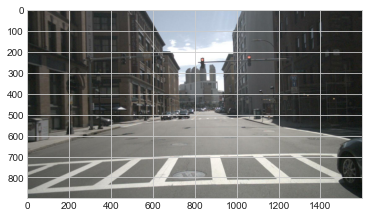

position:  (1863.1441352326212 @ 1058.4766744785386)


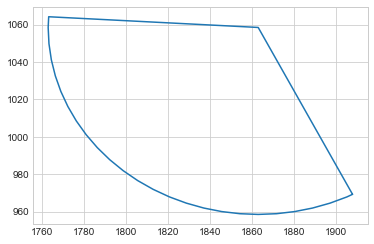

NOT VALID: POSITION
VALID:  False
position:  (906.1524802350068 @ 606.5044077021104)


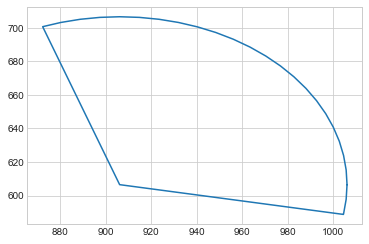

NOT VALID: POSITION
VALID:  False
position:  (1301.2033558803914 @ 896.0731297533807)


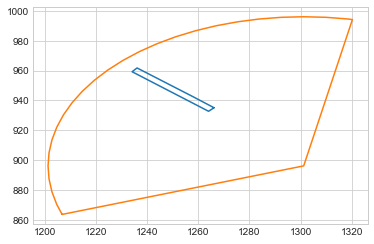

in Options class, polygonalRegions:  [<shapely.geometry.polygon.Polygon object at 0x2c5b37a90>]


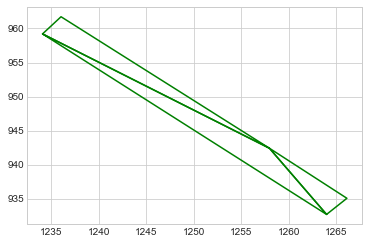

NOT VALID: POSITION
VALID:  False
position:  (1398.7110655762294 @ 966.5116483291283)


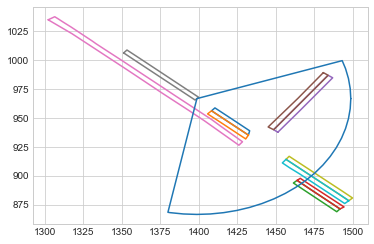

in Options class, polygonalRegions:  [<shapely.geometry.polygon.Polygon object at 0x244e8aeb0>, <shapely.geometry.polygon.Polygon object at 0x244e95a90>, <shapely.geometry.polygon.Polygon object at 0x2c48543d0>, <shapely.geometry.polygon.Polygon object at 0x2c4854ee0>, <shapely.geometry.polygon.Polygon object at 0x2c4c25910>, <shapely.geometry.polygon.Polygon object at 0x2c4c2e400>, <shapely.geometry.polygon.Polygon object at 0x2c506e2b0>, <shapely.geometry.polygon.Polygon object at 0x2c5a697f0>, <shapely.geometry.polygon.Polygon object at 0x2c5c55970>, <shapely.geometry.polygon.Polygon object at 0x2c5c5d580>]


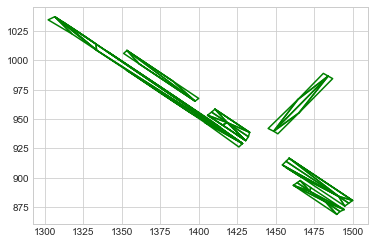

position is valid
heading:  3.9992163333227513
within get_traffic_flow
point:  (1398.7110655762294 @ 966.5116483291283)
heading output =  3.993138586293062
heading is valid
position:  (1383.207 @ 999.093)
NOT VALID: POSITION
position:  (1398.7110655762294 @ 966.5116483291283)
NOT VALID: POSITION
position:  (1371.881 @ 1050.221)
NOT VALID: POSITION
position:  (1398.7110655762294 @ 966.5116483291283)
NOT VALID: POSITION
within get_traffic_flow
point:  (1287.6055690568135 @ 1482.4566752542376)
heading output =  1.064459372759885
within get_traffic_flow
point:  (1300.1059543890424 @ 1469.5801256474103)
heading output =  1.06631598750008
VALID:  True


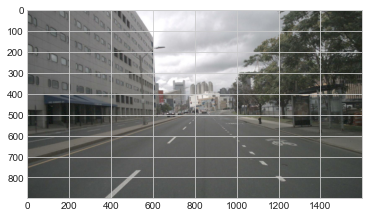

position:  (759.9248591135615 @ 1515.0303197785247)


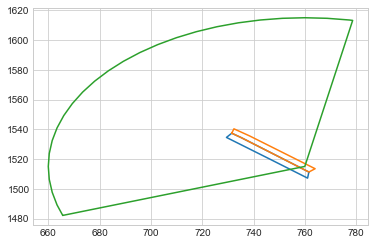

in Options class, polygonalRegions:  [<shapely.geometry.polygon.Polygon object at 0x2454b9a60>, <shapely.geometry.polygon.Polygon object at 0x2454c2670>]


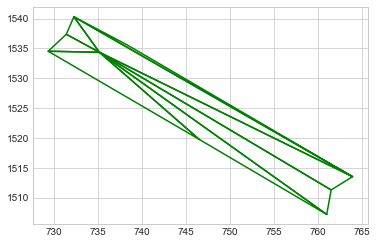

position is valid
heading:  0.8594523789618489
within get_traffic_flow
point:  (759.9248591135615 @ 1515.0303197785247)
heading output =  0.8619605002069616
heading is valid
position:  (761.545 @ 1508.955)
NOT VALID: POSITION
position:  (759.9248591135615 @ 1515.0303197785247)
NOT VALID: POSITION
position:  (793.527 @ 1503.259)
NOT VALID: POSITION
position:  (759.9248591135615 @ 1515.0303197785247)
NOT VALID: POSITION
within get_traffic_flow
point:  (1542.5155251237295 @ 843.1864377411914)
heading output =  3.999920262362644
within get_traffic_flow
point:  (1547.3608580562175 @ 843.6714080380366)
heading output =  4.018905439695171
VALID:  True


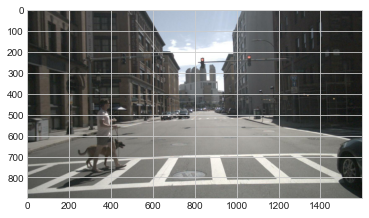

position:  (762.9643087782538 @ 554.9412399872483)


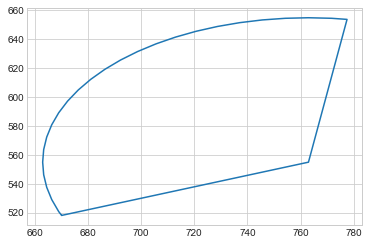

NOT VALID: POSITION
VALID:  False
position:  (1094.8683532513421 @ 1499.2215596599851)


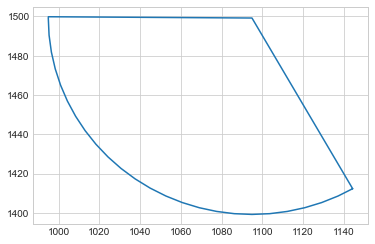

NOT VALID: POSITION
VALID:  False
position:  (1940.7514327099307 @ 870.6261607252975)


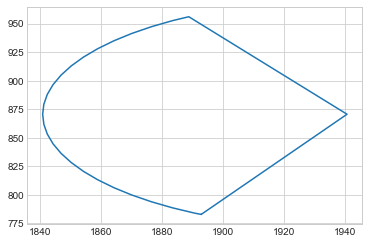

NOT VALID: POSITION
VALID:  False
position:  (1608.70704703546 @ 866.3922458173528)


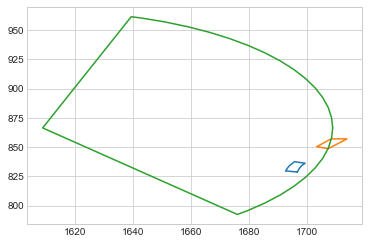

in Options class, polygonalRegions:  [<shapely.geometry.polygon.Polygon object at 0x2494b9a00>, <shapely.geometry.polygon.Polygon object at 0x2c214bdc0>]


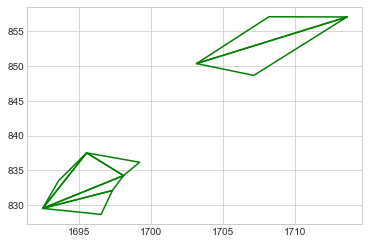

NOT VALID: POSITION
VALID:  False
position:  (2015.766526112945 @ 1229.7742728646454)


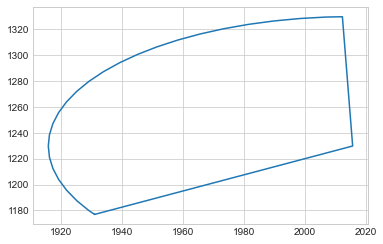

NOT VALID: POSITION
VALID:  False
position:  (1132.866948232733 @ 1391.0510090818752)


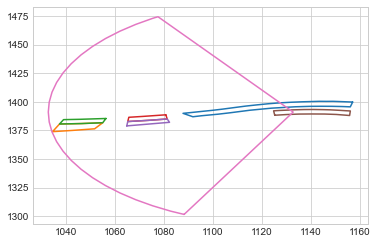

in Options class, polygonalRegions:  [<shapely.geometry.polygon.Polygon object at 0x244c5b880>, <shapely.geometry.polygon.Polygon object at 0x2451a3490>, <shapely.geometry.polygon.Polygon object at 0x2451ad040>, <shapely.geometry.polygon.Polygon object at 0x2643453a0>, <shapely.geometry.polygon.Polygon object at 0x264345f10>, <shapely.geometry.polygon.Polygon object at 0x2c5361310>]


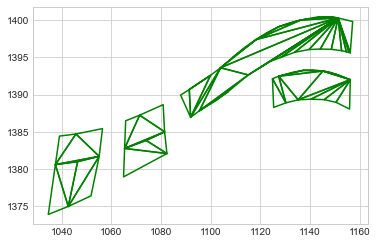

position is valid
heading:  1.6324198753677126
within get_traffic_flow
point:  (1132.866948232733 @ 1391.0510090818752)
heading output =  1.5651499679884395
heading is valid
position:  (1142.775 @ 1387.483)
NOT VALID: POSITION
position:  (1132.866948232733 @ 1391.0510090818752)
NOT VALID: POSITION
position:  (1144.474 @ 1391.357)
NOT VALID: POSITION
position:  (1132.866948232733 @ 1391.0510090818752)
NOT VALID: POSITION
position:  (1184.452 @ 1417.099)
NOT VALID: POSITION
position:  (1132.866948232733 @ 1391.0510090818752)
NOT VALID: POSITION
position:  (1184.452 @ 1417.099)
NOT VALID: POSITION
position:  (1132.866948232733 @ 1391.0510090818752)
NOT VALID: POSITION
position:  (1142.775 @ 1387.483)
NOT VALID: POSITION
position:  (1132.866948232733 @ 1391.0510090818752)
NOT VALID: POSITION
position:  (1144.474 @ 1391.357)
NOT VALID: POSITION
position:  (1132.866948232733 @ 1391.0510090818752)
NOT VALID: POSITION
within get_traffic_flow
point:  (1543.3938958598997 @ 836.9153162719598)
hea

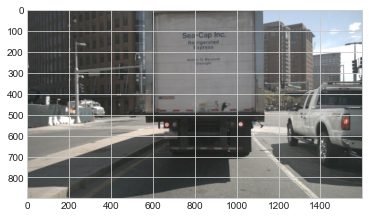

position:  (1409.0818495913722 @ 957.3696737735443)


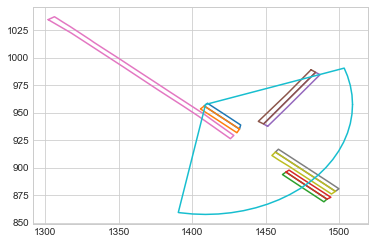

in Options class, polygonalRegions:  [<shapely.geometry.polygon.Polygon object at 0x244e8aeb0>, <shapely.geometry.polygon.Polygon object at 0x244e95a90>, <shapely.geometry.polygon.Polygon object at 0x2c48543d0>, <shapely.geometry.polygon.Polygon object at 0x2c4854ee0>, <shapely.geometry.polygon.Polygon object at 0x2c4c25910>, <shapely.geometry.polygon.Polygon object at 0x2c4c2e400>, <shapely.geometry.polygon.Polygon object at 0x2c506e2b0>, <shapely.geometry.polygon.Polygon object at 0x2c5c55970>, <shapely.geometry.polygon.Polygon object at 0x2c5c5d580>]


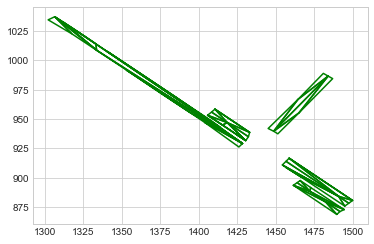

NOT VALID: POSITION
VALID:  False
position:  (1927.3625156512157 @ 1053.3215015295318)


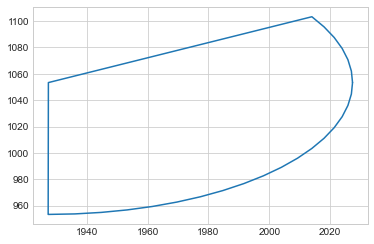

NOT VALID: POSITION
VALID:  False
position:  (494.4724415240473 @ 1705.0507175663108)


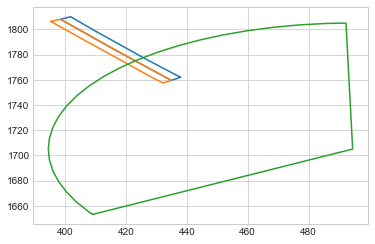

in Options class, polygonalRegions:  [<shapely.geometry.polygon.Polygon object at 0x248102ca0>, <shapely.geometry.polygon.Polygon object at 0x24810f910>]


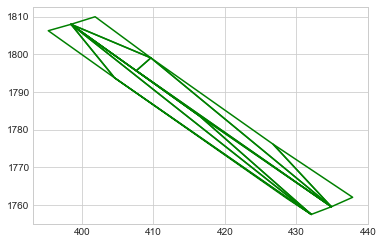

NOT VALID: POSITION
VALID:  False
position:  (1423.7079174866858 @ 1194.2379519576439)


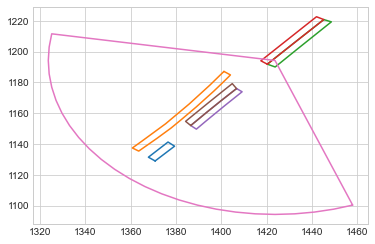

in Options class, polygonalRegions:  [<shapely.geometry.polygon.Polygon object at 0x24510fb80>, <shapely.geometry.polygon.Polygon object at 0x2c5099d90>, <shapely.geometry.polygon.Polygon object at 0x2c50c1cd0>, <shapely.geometry.polygon.Polygon object at 0x2c50c98e0>, <shapely.geometry.polygon.Polygon object at 0x2c59e6d60>, <shapely.geometry.polygon.Polygon object at 0x2c59f1a30>]


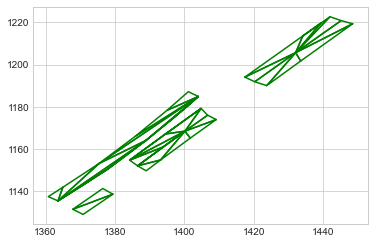

position is valid
heading:  2.443890989698377
within get_traffic_flow
point:  (1423.7079174866858 @ 1194.2379519576439)
heading output =  2.435917401753276
heading is valid
position:  (1430.971 @ 1196.841)
NOT VALID: POSITION
position:  (1423.7079174866858 @ 1194.2379519576439)
NOT VALID: POSITION
position:  (1447.398 @ 1210.729)
NOT VALID: POSITION
position:  (1423.7079174866858 @ 1194.2379519576439)
NOT VALID: POSITION
position:  (1488.337 @ 1260.111)
NOT VALID: POSITION
position:  (1423.7079174866858 @ 1194.2379519576439)
NOT VALID: POSITION
position:  (1488.337 @ 1260.111)
NOT VALID: POSITION
position:  (1423.7079174866858 @ 1194.2379519576439)
NOT VALID: POSITION
position:  (1430.971 @ 1196.841)
NOT VALID: POSITION
position:  (1423.7079174866858 @ 1194.2379519576439)
NOT VALID: POSITION
position:  (1447.398 @ 1210.729)
NOT VALID: POSITION
position:  (1423.7079174866858 @ 1194.2379519576439)
NOT VALID: POSITION
within get_traffic_flow
point:  (1166.2975053178636 @ 904.5953185677593

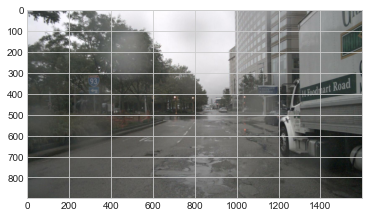

position:  (484.60283526621197 @ 795.4746835762085)


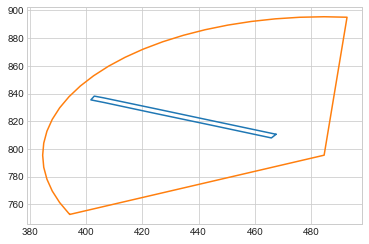

in Options class, polygonalRegions:  [<shapely.geometry.polygon.Polygon object at 0x2495d0400>]


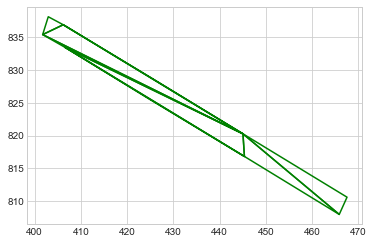

NOT VALID: POSITION
VALID:  False
position:  (1667.0676564129421 @ 1260.0592546998657)


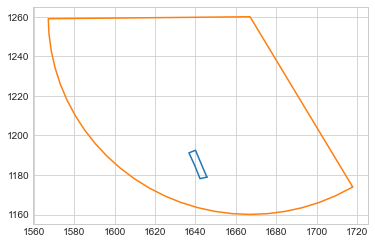

in Options class, polygonalRegions:  [<shapely.geometry.polygon.Polygon object at 0x2c437ccd0>]


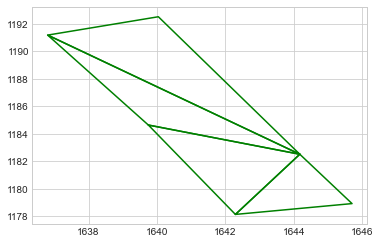

NOT VALID: POSITION
VALID:  False
position:  (576.1719671428668 @ 727.4615253061244)


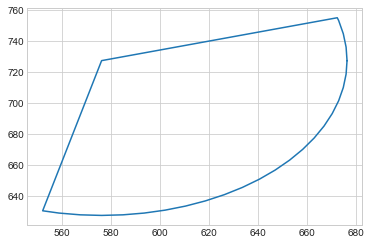

NOT VALID: POSITION
VALID:  False
position:  (489.4149472103695 @ 1706.7075201282057)


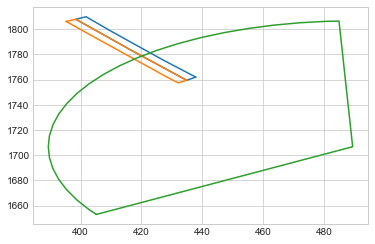

in Options class, polygonalRegions:  [<shapely.geometry.polygon.Polygon object at 0x248102ca0>, <shapely.geometry.polygon.Polygon object at 0x24810f910>]


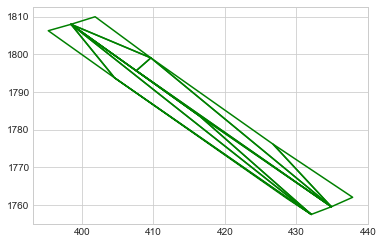

NOT VALID: POSITION
VALID:  False
position:  (1189.216352233142 @ 1397.5071678456807)


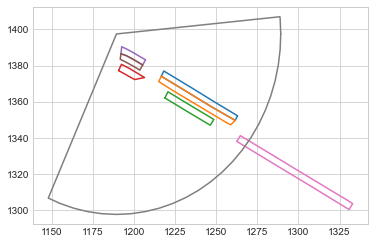

in Options class, polygonalRegions:  [<shapely.geometry.polygon.Polygon object at 0x248daa6d0>, <shapely.geometry.polygon.Polygon object at 0x248db33a0>, <shapely.geometry.polygon.Polygon object at 0x24941ee20>, <shapely.geometry.polygon.Polygon object at 0x2638910a0>, <shapely.geometry.polygon.Polygon object at 0x2c4b24a00>, <shapely.geometry.polygon.Polygon object at 0x2c4b31670>, <shapely.geometry.polygon.Polygon object at 0x2c55fe0d0>]


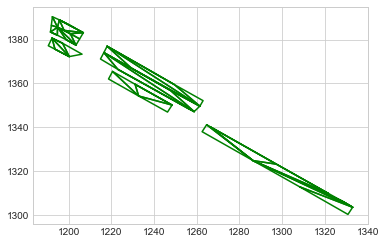

NOT VALID: POSITION
VALID:  False
position:  (1188.6925148775854 @ 1412.4434116394618)


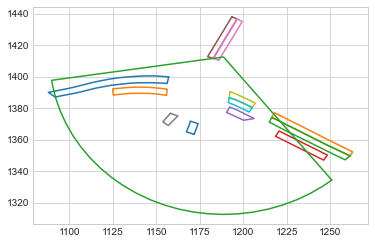

in Options class, polygonalRegions:  [<shapely.geometry.polygon.Polygon object at 0x244c5b880>, <shapely.geometry.polygon.Polygon object at 0x248daa6d0>, <shapely.geometry.polygon.Polygon object at 0x248db33a0>, <shapely.geometry.polygon.Polygon object at 0x24941ee20>, <shapely.geometry.polygon.Polygon object at 0x2638910a0>, <shapely.geometry.polygon.Polygon object at 0x2c3ef8af0>, <shapely.geometry.polygon.Polygon object at 0x2c3f00760>, <shapely.geometry.polygon.Polygon object at 0x2c4a6cbe0>, <shapely.geometry.polygon.Polygon object at 0x2c4b24a00>, <shapely.geometry.polygon.Polygon object at 0x2c4b31670>, <shapely.geometry.polygon.Polygon object at 0x2c51e5d90>, <shapely.geometry.polygon.Polygon object at 0x2c5361310>]


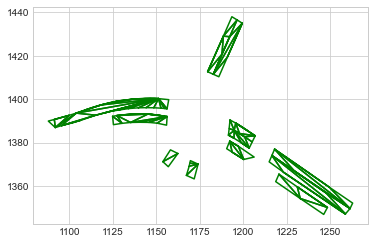

NOT VALID: POSITION
VALID:  False
position:  (1871.156355325461 @ 1094.702743173355)


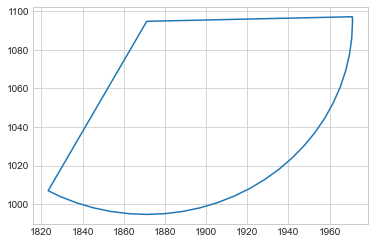

NOT VALID: POSITION
VALID:  False
position:  (1301.203359722353 @ 896.0731264058674)


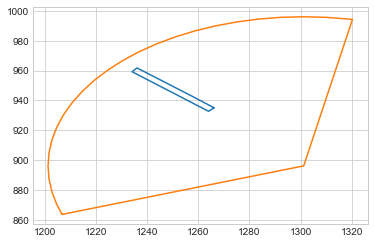

in Options class, polygonalRegions:  [<shapely.geometry.polygon.Polygon object at 0x2c5b37a90>]


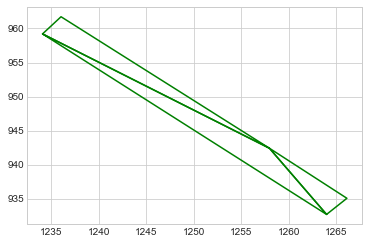

NOT VALID: POSITION
VALID:  False
position:  (761.7765381397253 @ 428.14631825397555)


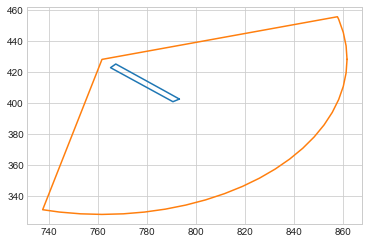

in Options class, polygonalRegions:  [<shapely.geometry.polygon.Polygon object at 0x248241550>]


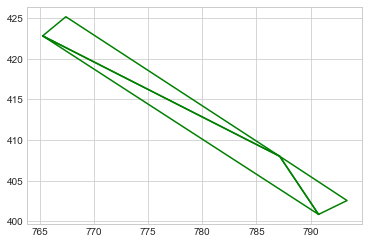

NOT VALID: POSITION
VALID:  False
position:  (1937.4187130121245 @ 856.8155129650825)


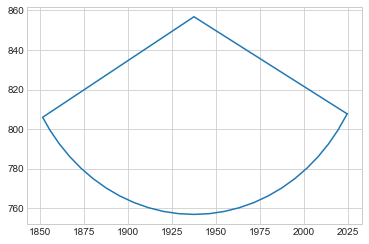

NOT VALID: POSITION
VALID:  False
position:  (657.7015517245225 @ 651.276536980215)


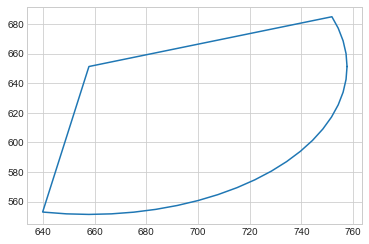

NOT VALID: POSITION
VALID:  False
position:  (1052.2433484254598 @ 1230.9460491601692)


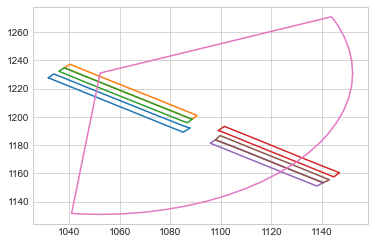

in Options class, polygonalRegions:  [<shapely.geometry.polygon.Polygon object at 0x247e11bb0>, <shapely.geometry.polygon.Polygon object at 0x2c3ccb3a0>, <shapely.geometry.polygon.Polygon object at 0x2c3ccbfd0>, <shapely.geometry.polygon.Polygon object at 0x2c3de77c0>, <shapely.geometry.polygon.Polygon object at 0x2c5bb1460>, <shapely.geometry.polygon.Polygon object at 0x2c5bbb130>]


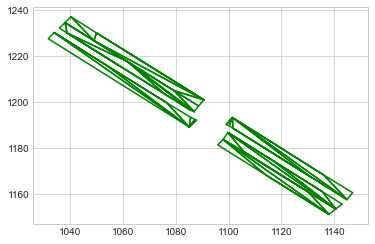

NOT VALID: POSITION
VALID:  False
position:  (1187.74118057217 @ 1399.8218251008022)


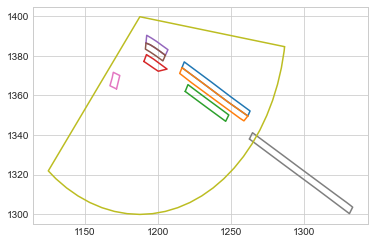

in Options class, polygonalRegions:  [<shapely.geometry.polygon.Polygon object at 0x248daa6d0>, <shapely.geometry.polygon.Polygon object at 0x248db33a0>, <shapely.geometry.polygon.Polygon object at 0x24941ee20>, <shapely.geometry.polygon.Polygon object at 0x2638910a0>, <shapely.geometry.polygon.Polygon object at 0x2c4b24a00>, <shapely.geometry.polygon.Polygon object at 0x2c4b31670>, <shapely.geometry.polygon.Polygon object at 0x2c51e5d90>, <shapely.geometry.polygon.Polygon object at 0x2c55fe0d0>]


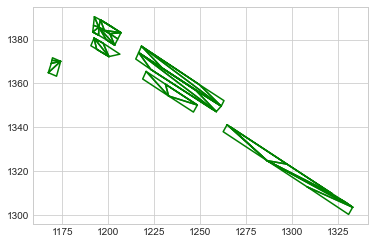

NOT VALID: POSITION
VALID:  False
position:  (1539.3833505991622 @ 1318.5725015562487)


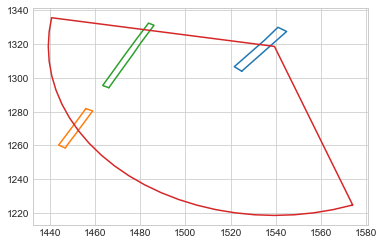

in Options class, polygonalRegions:  [<shapely.geometry.polygon.Polygon object at 0x2c475ae80>, <shapely.geometry.polygon.Polygon object at 0x2c54dabe0>, <shapely.geometry.polygon.Polygon object at 0x2c5b8e700>]


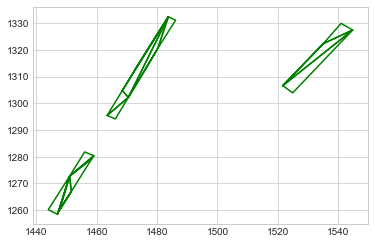

NOT VALID: POSITION
VALID:  False
position:  (1669.93431378575 @ 1264.5491734791183)


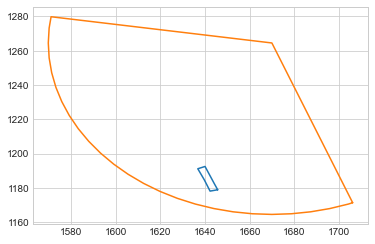

in Options class, polygonalRegions:  [<shapely.geometry.polygon.Polygon object at 0x2c437ccd0>]


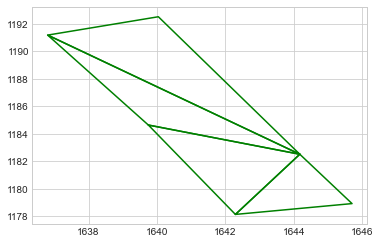

NOT VALID: POSITION
VALID:  False
position:  (617.2863501393006 @ 686.6932403363334)


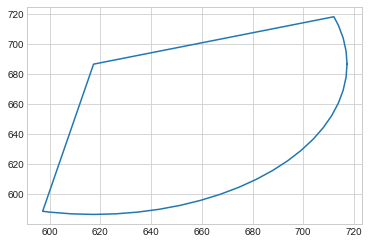

NOT VALID: POSITION
VALID:  False
position:  (1301.2033555263515 @ 896.0731299768903)


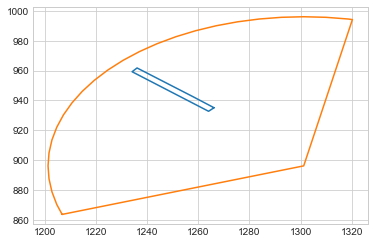

in Options class, polygonalRegions:  [<shapely.geometry.polygon.Polygon object at 0x2c5b37a90>]


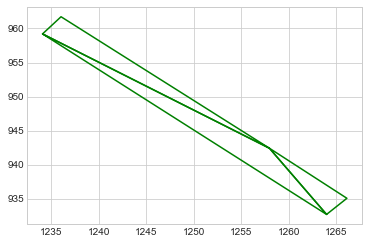

NOT VALID: POSITION
VALID:  False
position:  (388.7420433638365 @ 643.5331289691505)


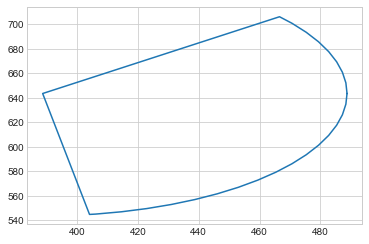

NOT VALID: POSITION
VALID:  False
position:  (2134.197539039943 @ 900.4883847574538)


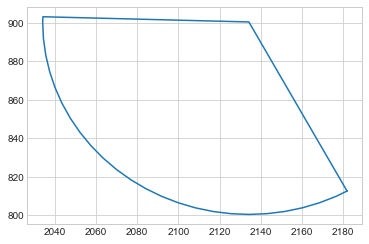

NOT VALID: POSITION
VALID:  False
position:  (2319.9715342993895 @ 1012.8065971337794)


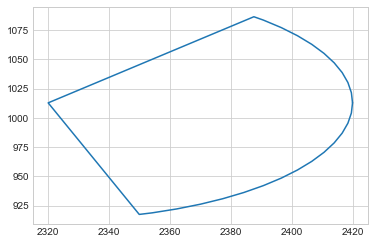

NOT VALID: POSITION
VALID:  False
position:  (2312.0532413201263 @ 1038.0160136893899)


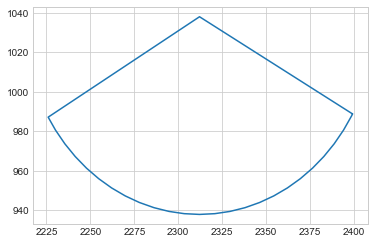

NOT VALID: POSITION
VALID:  False
position:  (453.81180703912696 @ 811.2458373480074)


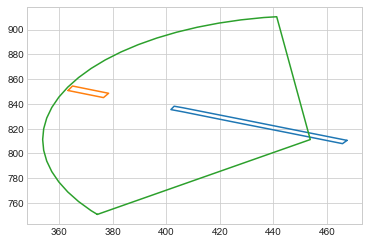

in Options class, polygonalRegions:  [<shapely.geometry.polygon.Polygon object at 0x2495d0400>, <shapely.geometry.polygon.Polygon object at 0x264439d60>]


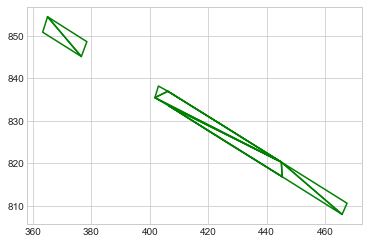

NOT VALID: POSITION
VALID:  False
position:  (677.7816864007177 @ 629.2915267934894)


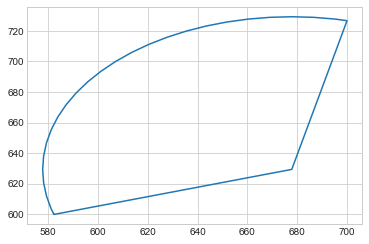

NOT VALID: POSITION
VALID:  False
position:  (1889.3985112845348 @ 1076.7859039290156)


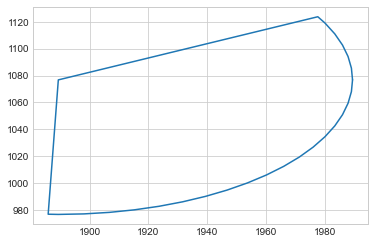

NOT VALID: POSITION
VALID:  False
position:  (743.9396070820471 @ 575.8479839318718)


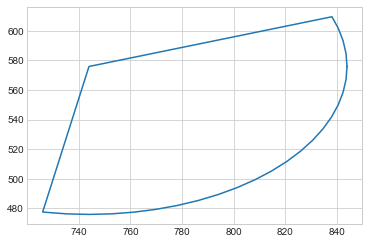

NOT VALID: POSITION
VALID:  False
position:  (1499.3295477008305 @ 1358.6668939174924)


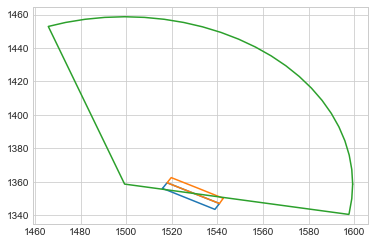

in Options class, polygonalRegions:  [<shapely.geometry.polygon.Polygon object at 0x2481edc40>, <shapely.geometry.polygon.Polygon object at 0x2481f7730>]


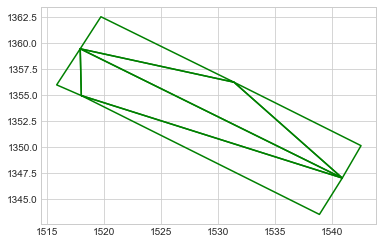

NOT VALID: POSITION
VALID:  False
position:  (454.90180708981916 @ 1717.6061114491927)


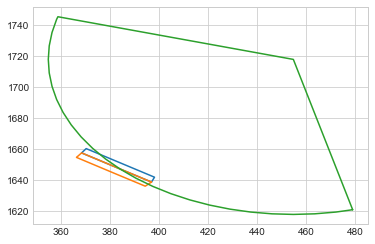

in Options class, polygonalRegions:  [<shapely.geometry.polygon.Polygon object at 0x248d0baf0>, <shapely.geometry.polygon.Polygon object at 0x248d12520>]


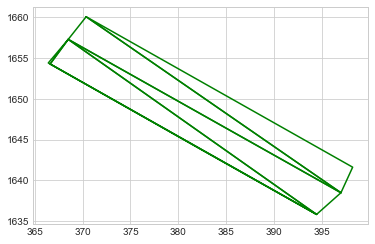

NOT VALID: POSITION
VALID:  False
position:  (447.5678223017803 @ 603.5285702899199)


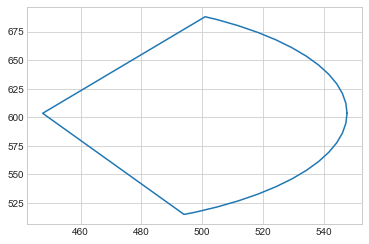

NOT VALID: POSITION
VALID:  False
position:  (1301.2033568483707 @ 896.0731289174115)


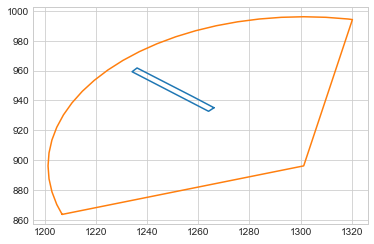

in Options class, polygonalRegions:  [<shapely.geometry.polygon.Polygon object at 0x2c5b37a90>]


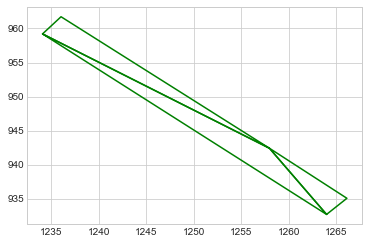

NOT VALID: POSITION
VALID:  False
position:  (1920.8964305245222 @ 1056.81655123123)


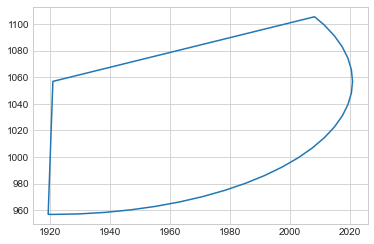

NOT VALID: POSITION
VALID:  False
position:  (1199.5378288191907 @ 1389.1209080711828)


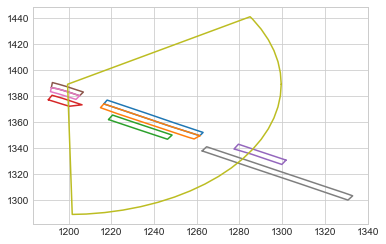

in Options class, polygonalRegions:  [<shapely.geometry.polygon.Polygon object at 0x248daa6d0>, <shapely.geometry.polygon.Polygon object at 0x248db33a0>, <shapely.geometry.polygon.Polygon object at 0x24941ee20>, <shapely.geometry.polygon.Polygon object at 0x2638910a0>, <shapely.geometry.polygon.Polygon object at 0x2640214c0>, <shapely.geometry.polygon.Polygon object at 0x2c4b24a00>, <shapely.geometry.polygon.Polygon object at 0x2c4b31670>, <shapely.geometry.polygon.Polygon object at 0x2c55fe0d0>]


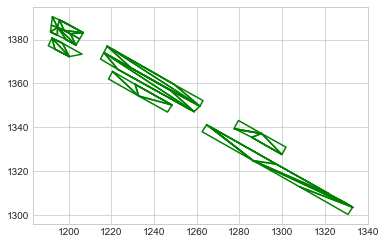

NOT VALID: POSITION
VALID:  False
position:  (693.4746676802076 @ 615.2406886016494)


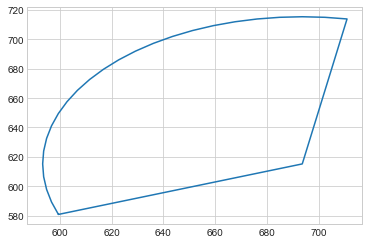

NOT VALID: POSITION
VALID:  False
position:  (2130.129119108582 @ 918.149639919515)


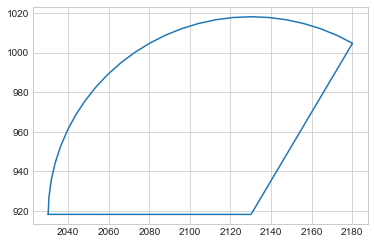

NOT VALID: POSITION
VALID:  False
position:  (1991.1459339098483 @ 784.8895080837738)


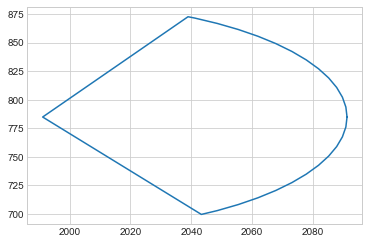

NOT VALID: POSITION
VALID:  False
position:  (1724.9018902380417 @ 893.9453354357704)


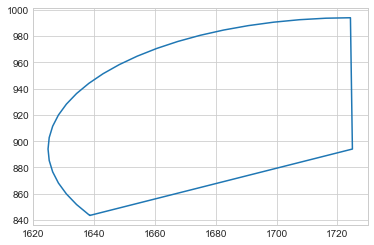

NOT VALID: POSITION
VALID:  False
position:  (2525.381469687889 @ 855.1292124752329)


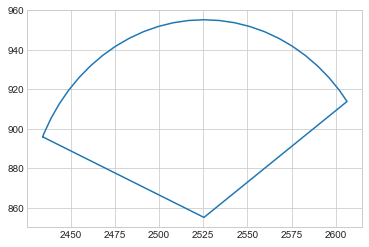

NOT VALID: POSITION
VALID:  False
position:  (1047.5382412073302 @ 1234.3810605987155)


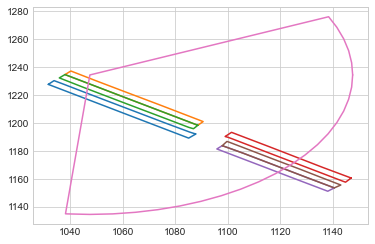

in Options class, polygonalRegions:  [<shapely.geometry.polygon.Polygon object at 0x247e11bb0>, <shapely.geometry.polygon.Polygon object at 0x2c3ccb3a0>, <shapely.geometry.polygon.Polygon object at 0x2c3ccbfd0>, <shapely.geometry.polygon.Polygon object at 0x2c3de77c0>, <shapely.geometry.polygon.Polygon object at 0x2c5bb1460>, <shapely.geometry.polygon.Polygon object at 0x2c5bbb130>]


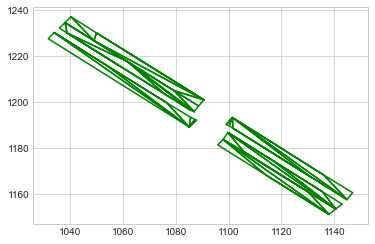

NOT VALID: POSITION
VALID:  False
position:  (1301.2033477649697 @ 896.0731367978916)


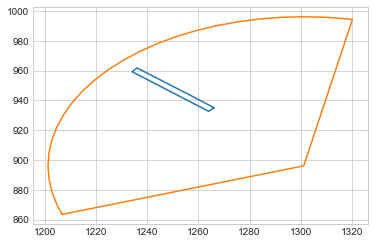

in Options class, polygonalRegions:  [<shapely.geometry.polygon.Polygon object at 0x2c5b37a90>]


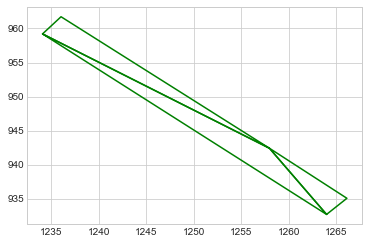

NOT VALID: POSITION
VALID:  False
position:  (2085.3451084076896 @ 947.7784254179086)


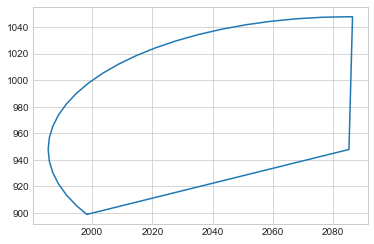

NOT VALID: POSITION
VALID:  False
position:  (1867.457194239216 @ 1064.8826635358528)


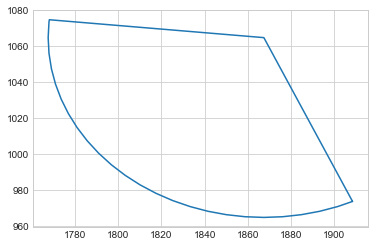

NOT VALID: POSITION
VALID:  False
position:  (615.4002760981184 @ 689.0477069556582)


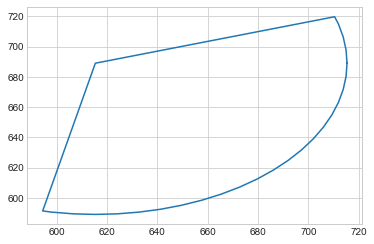

NOT VALID: POSITION
VALID:  False
position:  (1943.9831695311673 @ 870.6761307229319)


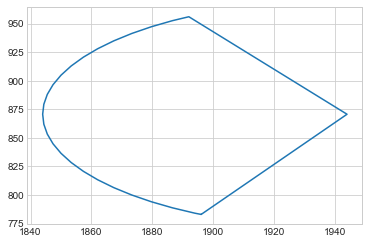

NOT VALID: POSITION
VALID:  False
position:  (1185.1334973176624 @ 1134.8981617127672)


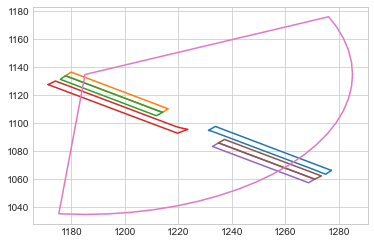

in Options class, polygonalRegions:  [<shapely.geometry.polygon.Polygon object at 0x248f88eb0>, <shapely.geometry.polygon.Polygon object at 0x263654640>, <shapely.geometry.polygon.Polygon object at 0x26365a250>, <shapely.geometry.polygon.Polygon object at 0x2c48e5c40>, <shapely.geometry.polygon.Polygon object at 0x2c5251070>, <shapely.geometry.polygon.Polygon object at 0x2c5251a60>]


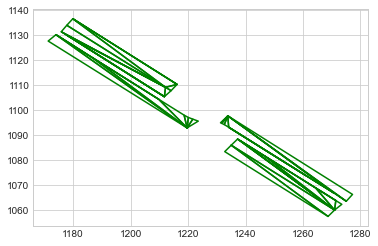

NOT VALID: POSITION
VALID:  False
position:  (443.3116336845055 @ 819.4442727094751)


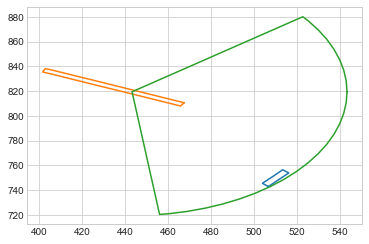

in Options class, polygonalRegions:  [<shapely.geometry.polygon.Polygon object at 0x248b8e610>, <shapely.geometry.polygon.Polygon object at 0x2495d0400>]


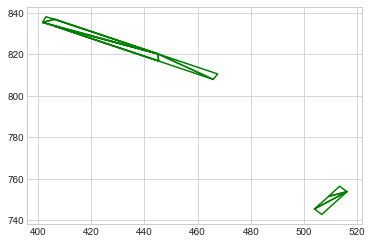

position is valid
heading:  4.317193185647613
within get_traffic_flow
point:  (443.3116336845055 @ 819.4442727094751)
heading output =  4.308298932715173
heading is valid
position:  (418.366 @ 822.586)
NOT VALID: POSITION
position:  (443.3116336845055 @ 819.4442727094751)
NOT VALID: POSITION
position:  (415.976 @ 831.111)
NOT VALID: POSITION
position:  (443.3116336845055 @ 819.4442727094751)
NOT VALID: POSITION
within get_traffic_flow
point:  (1427.1858182107762 @ 1261.4190875314857)
heading output =  4.204434021662495
within get_traffic_flow
point:  (1426.5591788452957 @ 1262.3887119288586)
heading output =  4.278888082212248
VALID:  True


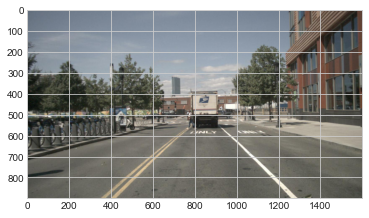

position:  (2370.9915327740086 @ 796.6005089680402)


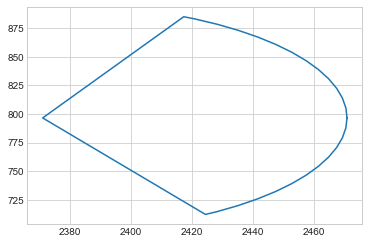

NOT VALID: POSITION
VALID:  False
position:  (759.9232052189031 @ 1515.0283983120507)


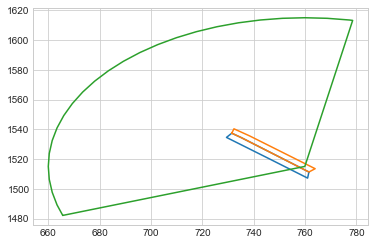

in Options class, polygonalRegions:  [<shapely.geometry.polygon.Polygon object at 0x2454b9a60>, <shapely.geometry.polygon.Polygon object at 0x2454c2670>]


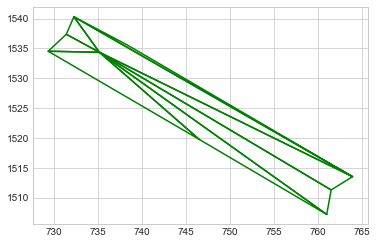

position is valid
heading:  0.8595716876419289
within get_traffic_flow
point:  (759.9232052189031 @ 1515.0283983120507)
heading output =  0.8619605002069616
heading is valid
position:  (761.545 @ 1508.955)
NOT VALID: POSITION
position:  (759.9232052189031 @ 1515.0283983120507)
NOT VALID: POSITION
position:  (793.551 @ 1503.308)
NOT VALID: POSITION
position:  (759.9232052189031 @ 1515.0283983120507)
NOT VALID: POSITION
within get_traffic_flow
point:  (364.43586949394404 @ 1852.5551497640936)
heading output =  3.8082470124717243
within get_traffic_flow
point:  (375.65692665708553 @ 1847.9582779905338)
heading output =  3.8328861893837245
VALID:  True


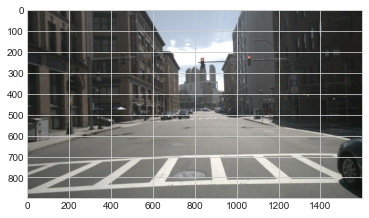

position:  (593.0312377265145 @ 710.5326657204029)


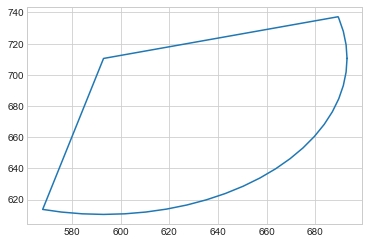

NOT VALID: POSITION
VALID:  False
position:  (1461.1538389236548 @ 912.4532510821055)


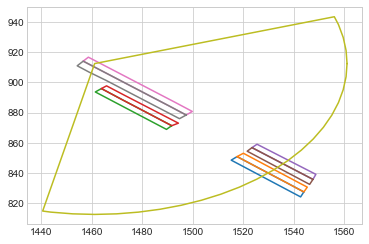

in Options class, polygonalRegions:  [<shapely.geometry.polygon.Polygon object at 0x248cee370>, <shapely.geometry.polygon.Polygon object at 0x248ceee80>, <shapely.geometry.polygon.Polygon object at 0x2c48543d0>, <shapely.geometry.polygon.Polygon object at 0x2c4854ee0>, <shapely.geometry.polygon.Polygon object at 0x2c51927c0>, <shapely.geometry.polygon.Polygon object at 0x2c519b1f0>, <shapely.geometry.polygon.Polygon object at 0x2c5c55970>, <shapely.geometry.polygon.Polygon object at 0x2c5c5d580>]


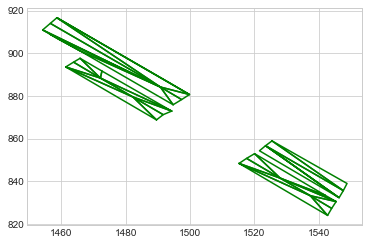

position is valid
heading:  3.981152372963363
within get_traffic_flow
point:  (1461.1538389236548 @ 912.4532510821055)
heading output =  3.993938954957558
heading is valid
position:  (1461.468 @ 916.531)
NOT VALID: POSITION
position:  (1461.1538389236548 @ 912.4532510821055)
NOT VALID: POSITION
position:  (1448.936 @ 950.443)
NOT VALID: POSITION
position:  (1461.1538389236548 @ 912.4532510821055)
NOT VALID: POSITION
within get_traffic_flow
point:  (1001.060936446926 @ 1633.1489103521758)
heading output =  2.6284020747439767
within get_traffic_flow
point:  (1002.1778273185278 @ 1630.9660751472645)
heading output =  2.619558435016506
VALID:  True


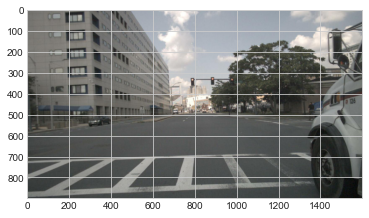

position:  (1712.2804558551622 @ 793.7976822117226)


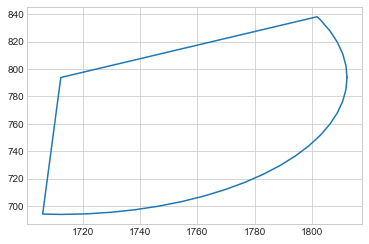

NOT VALID: POSITION
VALID:  False
position:  (1744.0501005792717 @ 1230.8825313555858)


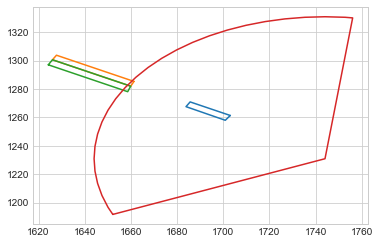

in Options class, polygonalRegions:  [<shapely.geometry.polygon.Polygon object at 0x2454fbcd0>, <shapely.geometry.polygon.Polygon object at 0x2480c9b50>, <shapely.geometry.polygon.Polygon object at 0x2480d2520>]


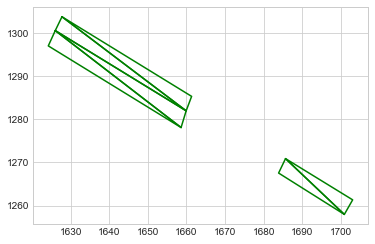

NOT VALID: POSITION
VALID:  False
position:  (1301.2033584401179 @ 896.0731275283554)


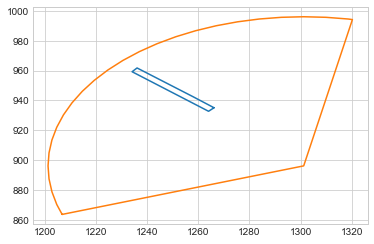

in Options class, polygonalRegions:  [<shapely.geometry.polygon.Polygon object at 0x2c5b37a90>]


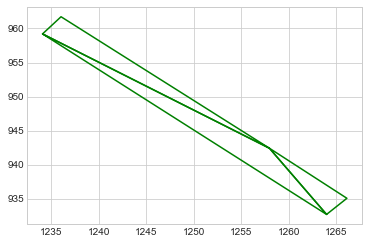

NOT VALID: POSITION
VALID:  False
position:  (1239.5396667361274 @ 960.6484901820168)


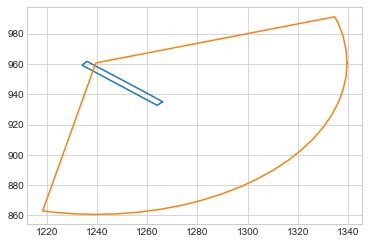

in Options class, polygonalRegions:  [<shapely.geometry.polygon.Polygon object at 0x2c5b37a90>]


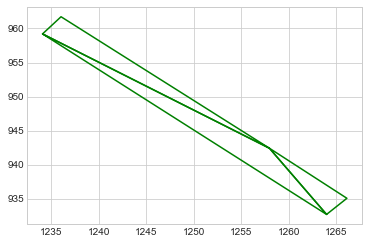

NOT VALID: POSITION
VALID:  False
position:  (2244.6949375378035 @ 793.751508054579)


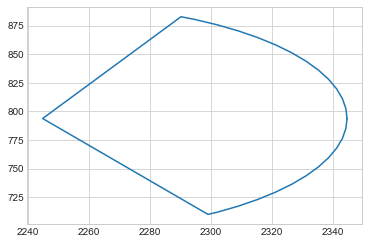

NOT VALID: POSITION
VALID:  False
position:  (1539.3833426956426 @ 1318.572508944188)


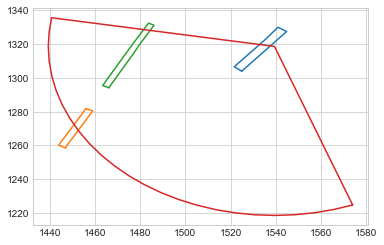

in Options class, polygonalRegions:  [<shapely.geometry.polygon.Polygon object at 0x2c475ae80>, <shapely.geometry.polygon.Polygon object at 0x2c54dabe0>, <shapely.geometry.polygon.Polygon object at 0x2c5b8e700>]


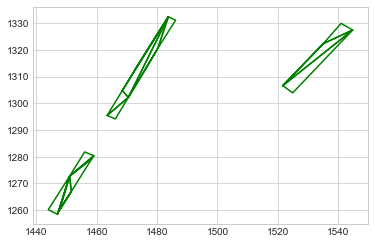

NOT VALID: POSITION
VALID:  False
position:  (757.2100619864011 @ 432.77456478391423)


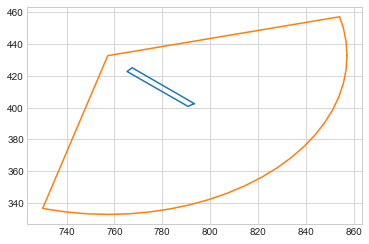

in Options class, polygonalRegions:  [<shapely.geometry.polygon.Polygon object at 0x248241550>]


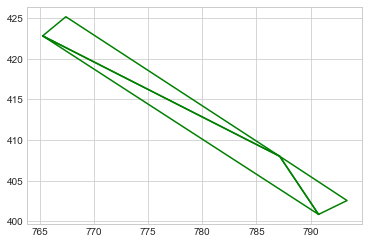

NOT VALID: POSITION
VALID:  False
position:  (1187.0996028104137 @ 1402.052247507586)


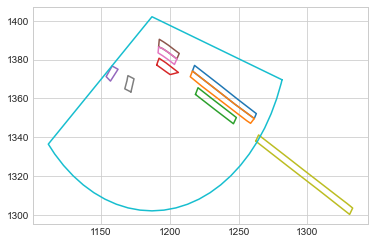

in Options class, polygonalRegions:  [<shapely.geometry.polygon.Polygon object at 0x248daa6d0>, <shapely.geometry.polygon.Polygon object at 0x248db33a0>, <shapely.geometry.polygon.Polygon object at 0x24941ee20>, <shapely.geometry.polygon.Polygon object at 0x2638910a0>, <shapely.geometry.polygon.Polygon object at 0x2c4a6cbe0>, <shapely.geometry.polygon.Polygon object at 0x2c4b24a00>, <shapely.geometry.polygon.Polygon object at 0x2c4b31670>, <shapely.geometry.polygon.Polygon object at 0x2c51e5d90>, <shapely.geometry.polygon.Polygon object at 0x2c55fe0d0>]


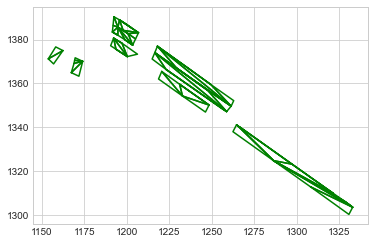

NOT VALID: POSITION
VALID:  False
position:  (796.3070449968304 @ 531.1014087056184)


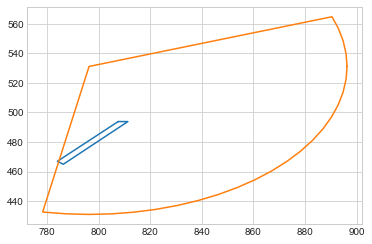

in Options class, polygonalRegions:  [<shapely.geometry.polygon.Polygon object at 0x263dce760>]


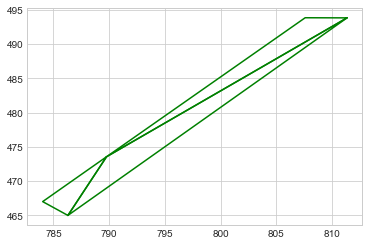

NOT VALID: POSITION
VALID:  False
position:  (1362.6359836590382 @ 1136.9804095355066)


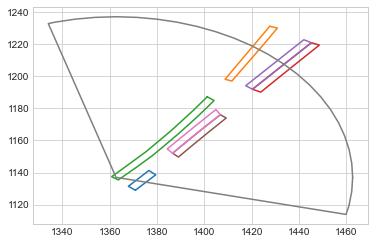

in Options class, polygonalRegions:  [<shapely.geometry.polygon.Polygon object at 0x24510fb80>, <shapely.geometry.polygon.Polygon object at 0x2499916a0>, <shapely.geometry.polygon.Polygon object at 0x2c5099d90>, <shapely.geometry.polygon.Polygon object at 0x2c50c1cd0>, <shapely.geometry.polygon.Polygon object at 0x2c50c98e0>, <shapely.geometry.polygon.Polygon object at 0x2c59e6d60>, <shapely.geometry.polygon.Polygon object at 0x2c59f1a30>]


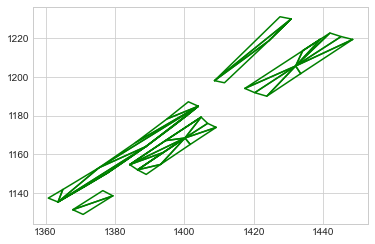

position is valid
heading:  -0.7566064638340705
within get_traffic_flow
point:  (1362.6359836590382 @ 1136.9804095355066)
heading output =  -0.6836340425536629
heading is valid
position:  (1328.748 @ 1101.126)
NOT VALID: POSITION
position:  (1362.6359836590382 @ 1136.9804095355066)
NOT VALID: POSITION
position:  (1321.329 @ 1093.592)
NOT VALID: POSITION
position:  (1362.6359836590382 @ 1136.9804095355066)
NOT VALID: POSITION
position:  (1310.982 @ 1075.821)
NOT VALID: POSITION
position:  (1362.6359836590382 @ 1136.9804095355066)
NOT VALID: POSITION
position:  (1310.982 @ 1075.821)
NOT VALID: POSITION
position:  (1362.6359836590382 @ 1136.9804095355066)
NOT VALID: POSITION
position:  (1328.748 @ 1101.126)
NOT VALID: POSITION
position:  (1362.6359836590382 @ 1136.9804095355066)
NOT VALID: POSITION
position:  (1321.329 @ 1093.592)
NOT VALID: POSITION
position:  (1362.6359836590382 @ 1136.9804095355066)
NOT VALID: POSITION
within get_traffic_flow
point:  (1242.719660635227 @ 1080.749733724

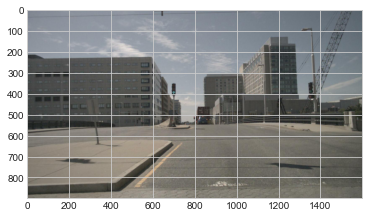

position:  (2508.8732086514074 @ 878.4199467721368)


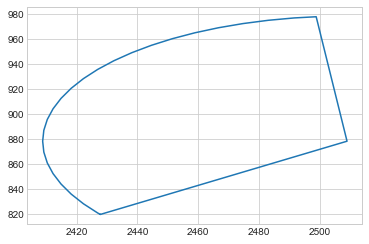

NOT VALID: POSITION
VALID:  False
position:  (1937.420540223908 @ 856.8157298121748)


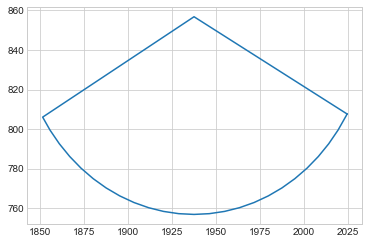

NOT VALID: POSITION
VALID:  False
position:  (1935.9662403441828 @ 867.3552572451161)


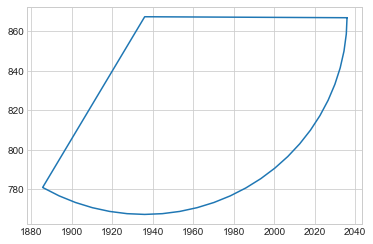

NOT VALID: POSITION
VALID:  False
position:  (1870.3398136803967 @ 1069.7573351906174)


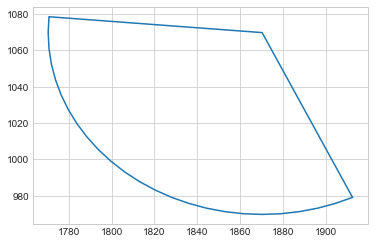

NOT VALID: POSITION
VALID:  False
position:  (2526.5748230786453 @ 819.7173985159534)


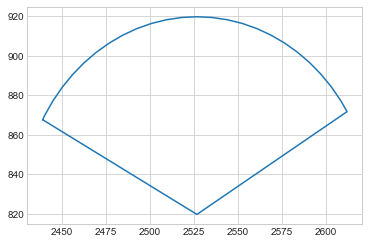

NOT VALID: POSITION
VALID:  False
position:  (802.6214546013885 @ 520.3421752215063)


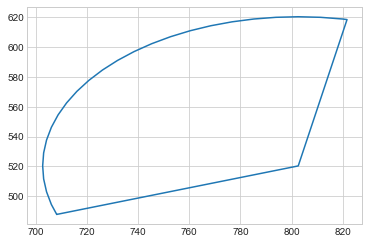

NOT VALID: POSITION
VALID:  False
position:  (1301.2033596816673 @ 896.0731264502789)


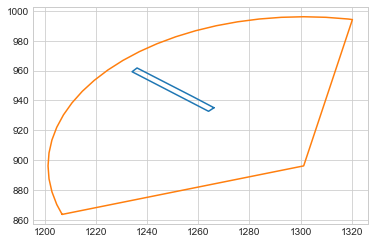

in Options class, polygonalRegions:  [<shapely.geometry.polygon.Polygon object at 0x2c5b37a90>]


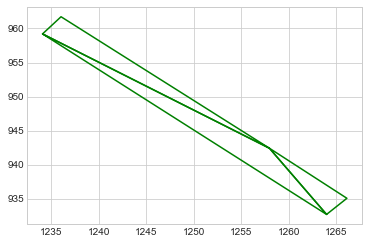

NOT VALID: POSITION
VALID:  False
position:  (2243.339149469555 @ 876.5519174526023)


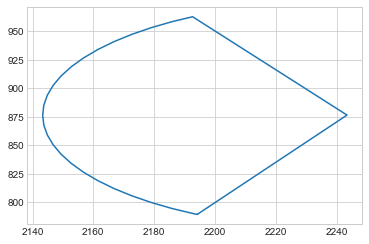

NOT VALID: POSITION
VALID:  False
position:  (1867.9028434264853 @ 1065.5178351284023)


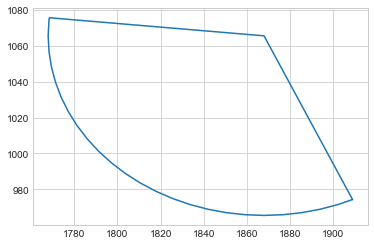

NOT VALID: POSITION
VALID:  False
position:  (1024.3191422635757 @ 483.6461983006871)


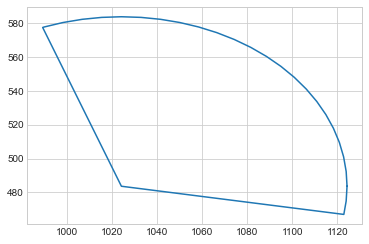

NOT VALID: POSITION
VALID:  False
position:  (302.0016810754364 @ 673.3910060016793)


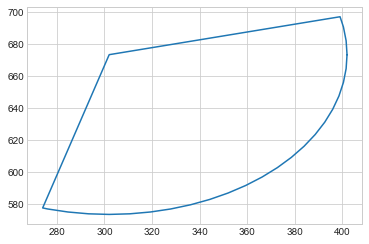

NOT VALID: POSITION
VALID:  False
position:  (1669.282823656221 @ 1263.1148494468773)


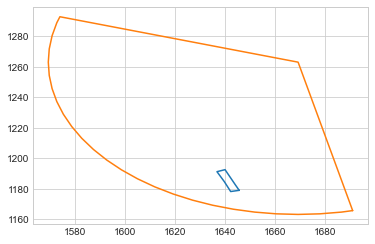

in Options class, polygonalRegions:  [<shapely.geometry.polygon.Polygon object at 0x2c437ccd0>]


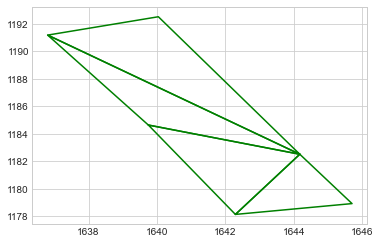

NOT VALID: POSITION
VALID:  False
position:  (903.1320462542944 @ 603.011401584808)


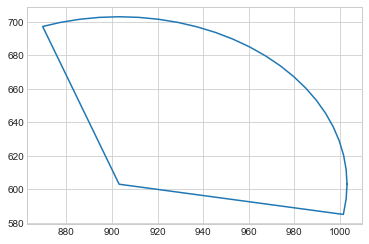

NOT VALID: POSITION
VALID:  False
position:  (472.7916359656356 @ 1594.8679461489933)


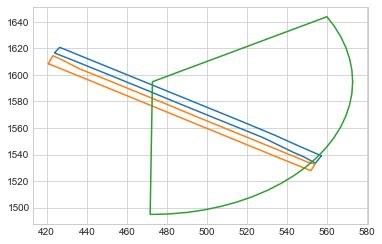

in Options class, polygonalRegions:  [<shapely.geometry.polygon.Polygon object at 0x24945ae20>, <shapely.geometry.polygon.Polygon object at 0x2c5cff4c0>]


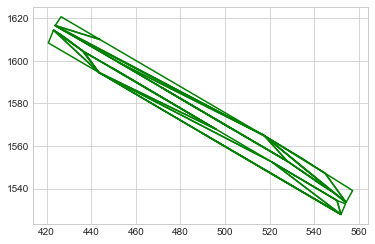

NOT VALID: POSITION
VALID:  False
position:  (1539.383332237106 @ 1318.572515988137)


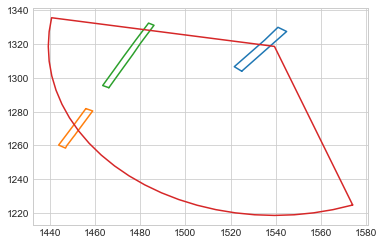

in Options class, polygonalRegions:  [<shapely.geometry.polygon.Polygon object at 0x2c475ae80>, <shapely.geometry.polygon.Polygon object at 0x2c54dabe0>, <shapely.geometry.polygon.Polygon object at 0x2c5b8e700>]


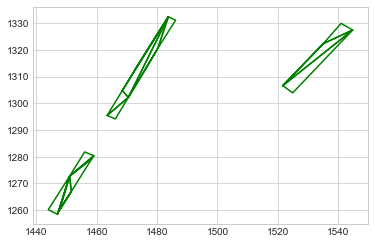

NOT VALID: POSITION
VALID:  False
position:  (1185.1334885822698 @ 1134.898152017579)


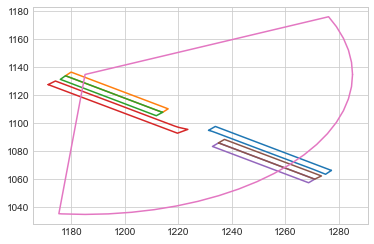

in Options class, polygonalRegions:  [<shapely.geometry.polygon.Polygon object at 0x248f88eb0>, <shapely.geometry.polygon.Polygon object at 0x263654640>, <shapely.geometry.polygon.Polygon object at 0x26365a250>, <shapely.geometry.polygon.Polygon object at 0x2c48e5c40>, <shapely.geometry.polygon.Polygon object at 0x2c5251070>, <shapely.geometry.polygon.Polygon object at 0x2c5251a60>]


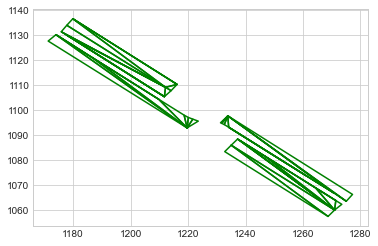

NOT VALID: POSITION
VALID:  False
position:  (299.6181311697924 @ 677.488991251522)


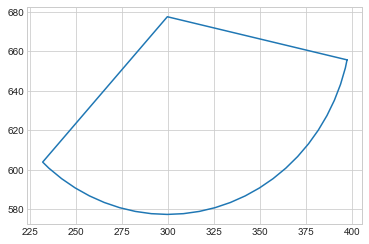

NOT VALID: POSITION
VALID:  False
position:  (750.9768652447383 @ 1522.9634455923788)


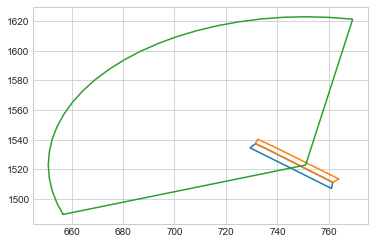

in Options class, polygonalRegions:  [<shapely.geometry.polygon.Polygon object at 0x2454b9a60>, <shapely.geometry.polygon.Polygon object at 0x2454c2670>]


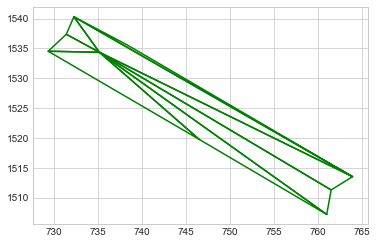

NOT VALID: POSITION
VALID:  False
position:  (1316.9478658666699 @ 1037.9566755409637)


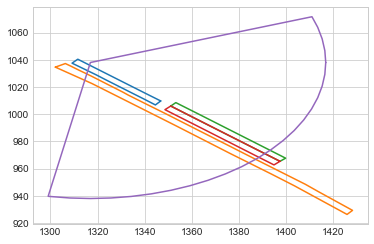

in Options class, polygonalRegions:  [<shapely.geometry.polygon.Polygon object at 0x2c4a4ceb0>, <shapely.geometry.polygon.Polygon object at 0x2c506e2b0>, <shapely.geometry.polygon.Polygon object at 0x2c5a697f0>, <shapely.geometry.polygon.Polygon object at 0x2c5a744c0>]


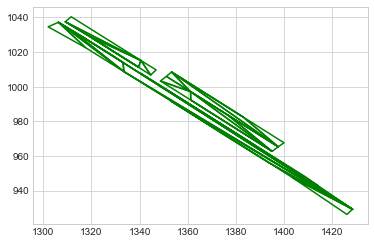

NOT VALID: POSITION
VALID:  False
position:  (1185.1335430050813 @ 1134.8982269216835)


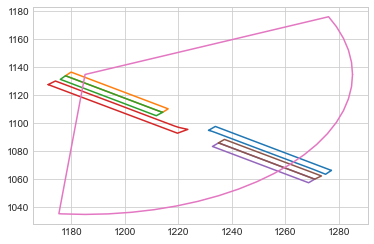

in Options class, polygonalRegions:  [<shapely.geometry.polygon.Polygon object at 0x248f88eb0>, <shapely.geometry.polygon.Polygon object at 0x263654640>, <shapely.geometry.polygon.Polygon object at 0x26365a250>, <shapely.geometry.polygon.Polygon object at 0x2c48e5c40>, <shapely.geometry.polygon.Polygon object at 0x2c5251070>, <shapely.geometry.polygon.Polygon object at 0x2c5251a60>]


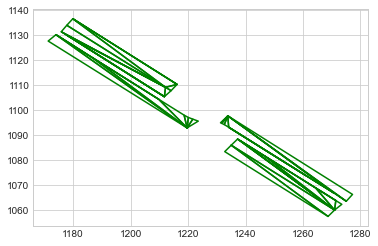

NOT VALID: POSITION
VALID:  False
position:  (1598.3606184669165 @ 863.820083424355)


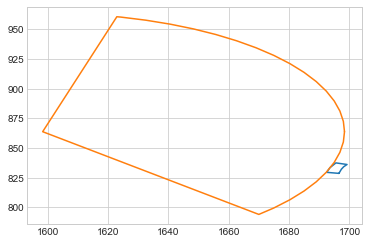

in Options class, polygonalRegions:  [<shapely.geometry.polygon.Polygon object at 0x2494b9a00>]


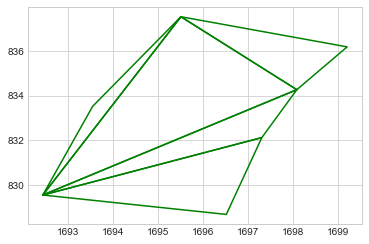

NOT VALID: POSITION
VALID:  False
position:  (2005.896877264534 @ 1235.0740899935818)


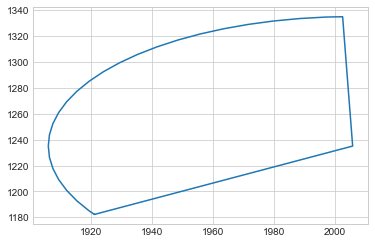

NOT VALID: POSITION
VALID:  False
position:  (2167.7449582687564 @ 875.3030642505051)


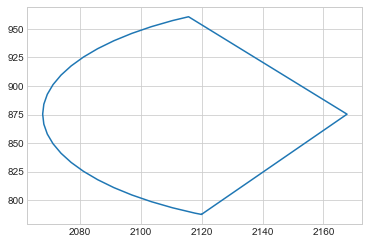

NOT VALID: POSITION
VALID:  False
position:  (1035.7645381781053 @ 497.59370504148535)


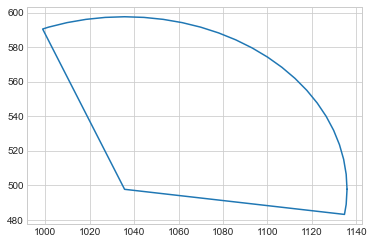

NOT VALID: POSITION
VALID:  False
position:  (1924.487978925326 @ 1055.023391492282)


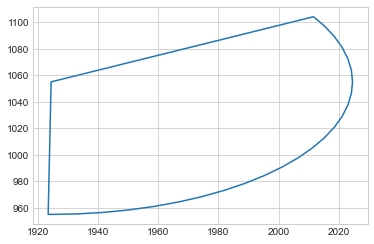

NOT VALID: POSITION
VALID:  False
position:  (426.0545503771623 @ 613.622253587579)


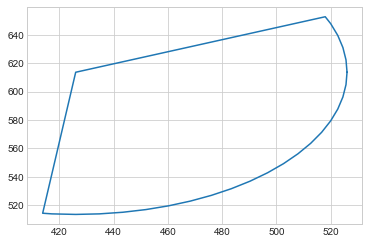

NOT VALID: POSITION
VALID:  False
position:  (2133.9411567858238 @ 900.0816933464534)


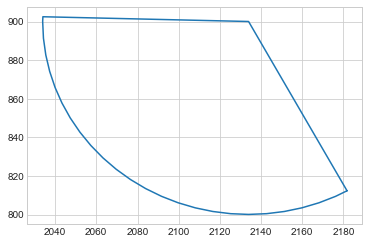

NOT VALID: POSITION
VALID:  False
position:  (1889.8350170971344 @ 1076.5056488129676)


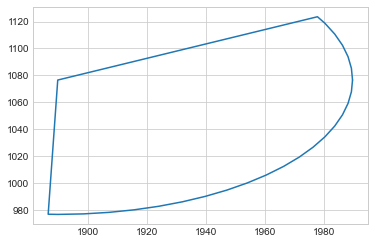

NOT VALID: POSITION
VALID:  False
position:  (770.0659186653988 @ 421.2352653394287)


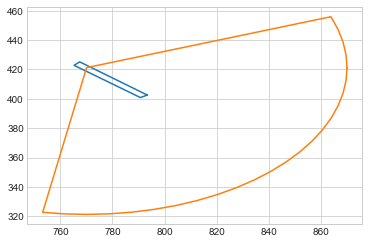

in Options class, polygonalRegions:  [<shapely.geometry.polygon.Polygon object at 0x248241550>]


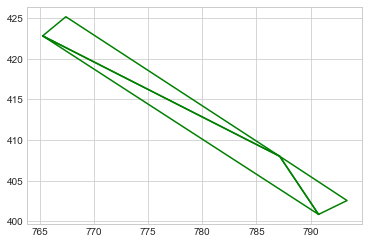

NOT VALID: POSITION
VALID:  False
position:  (1185.1335379842524 @ 1134.8982193230254)


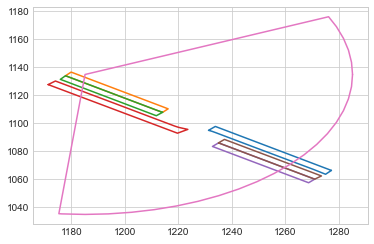

in Options class, polygonalRegions:  [<shapely.geometry.polygon.Polygon object at 0x248f88eb0>, <shapely.geometry.polygon.Polygon object at 0x263654640>, <shapely.geometry.polygon.Polygon object at 0x26365a250>, <shapely.geometry.polygon.Polygon object at 0x2c48e5c40>, <shapely.geometry.polygon.Polygon object at 0x2c5251070>, <shapely.geometry.polygon.Polygon object at 0x2c5251a60>]


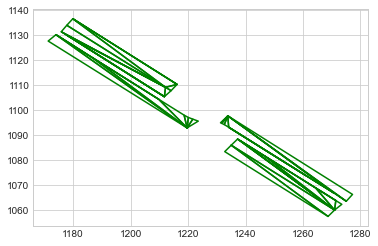

NOT VALID: POSITION
VALID:  False
position:  (531.1864045988702 @ 631.6518058858383)


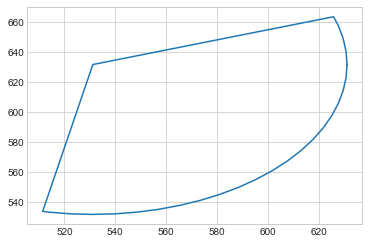

NOT VALID: POSITION
VALID:  False
position:  (1199.0359769520514 @ 1389.3982772293864)


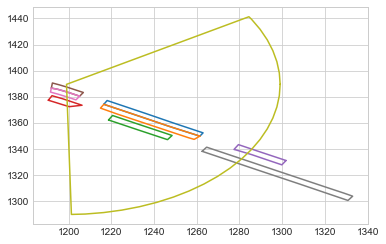

in Options class, polygonalRegions:  [<shapely.geometry.polygon.Polygon object at 0x248daa6d0>, <shapely.geometry.polygon.Polygon object at 0x248db33a0>, <shapely.geometry.polygon.Polygon object at 0x24941ee20>, <shapely.geometry.polygon.Polygon object at 0x2638910a0>, <shapely.geometry.polygon.Polygon object at 0x2640214c0>, <shapely.geometry.polygon.Polygon object at 0x2c4b24a00>, <shapely.geometry.polygon.Polygon object at 0x2c4b31670>, <shapely.geometry.polygon.Polygon object at 0x2c55fe0d0>]


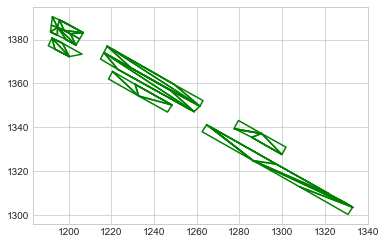

NOT VALID: POSITION
VALID:  False
position:  (2207.6419404388575 @ 1107.5724766190078)


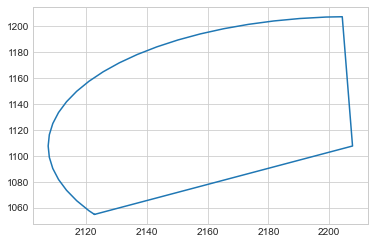

NOT VALID: POSITION
VALID:  False
position:  (805.9094658448726 @ 517.5679925805309)


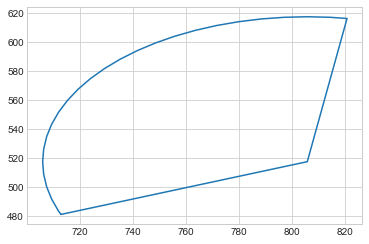

NOT VALID: POSITION
VALID:  False
position:  (759.4884522337757 @ 430.4257016797105)


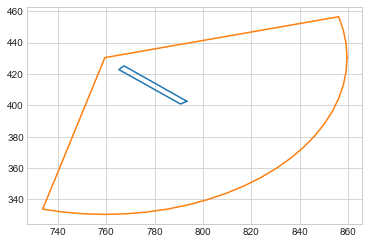

in Options class, polygonalRegions:  [<shapely.geometry.polygon.Polygon object at 0x248241550>]


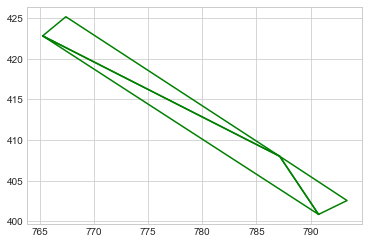

NOT VALID: POSITION
VALID:  False
position:  (653.9543104117306 @ 654.5128895172141)


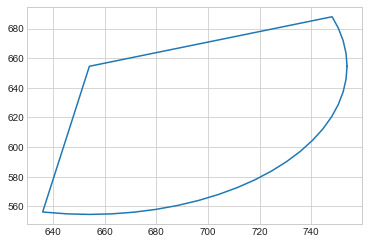

NOT VALID: POSITION
VALID:  False
position:  (579.0529862016147 @ 724.6097536534157)


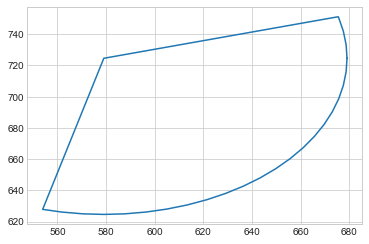

NOT VALID: POSITION
VALID:  False
position:  (1301.2033554396908 @ 896.0731301345206)


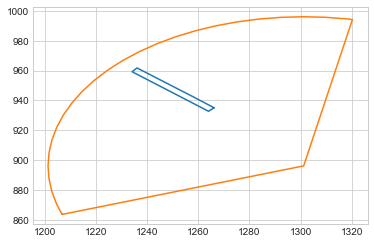

in Options class, polygonalRegions:  [<shapely.geometry.polygon.Polygon object at 0x2c5b37a90>]


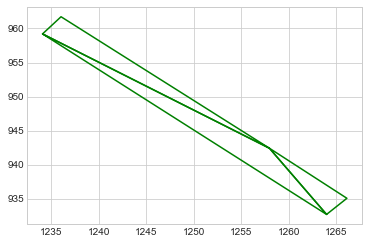

NOT VALID: POSITION
VALID:  False
position:  (1461.1547531333463 @ 912.4542389745413)


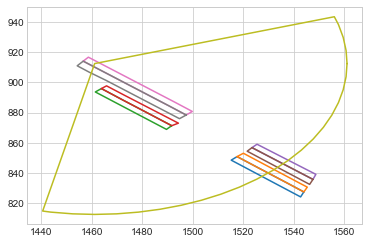

in Options class, polygonalRegions:  [<shapely.geometry.polygon.Polygon object at 0x248cee370>, <shapely.geometry.polygon.Polygon object at 0x248ceee80>, <shapely.geometry.polygon.Polygon object at 0x2c48543d0>, <shapely.geometry.polygon.Polygon object at 0x2c4854ee0>, <shapely.geometry.polygon.Polygon object at 0x2c51927c0>, <shapely.geometry.polygon.Polygon object at 0x2c519b1f0>, <shapely.geometry.polygon.Polygon object at 0x2c5c55970>, <shapely.geometry.polygon.Polygon object at 0x2c5c5d580>]


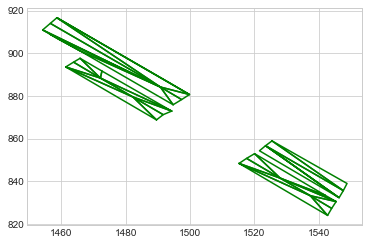

NOT VALID: POSITION
VALID:  False
position:  (1936.4907278654152 @ 866.6453047227651)


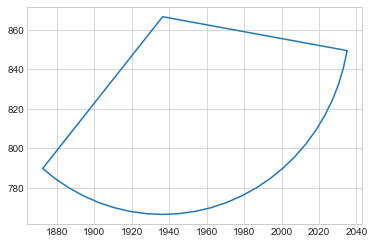

NOT VALID: POSITION
VALID:  False
position:  (1873.2513876990988 @ 1091.3298983176726)


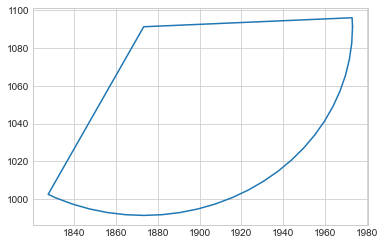

NOT VALID: POSITION
VALID:  False
position:  (1150.6261445144576 @ 1159.6788976803118)


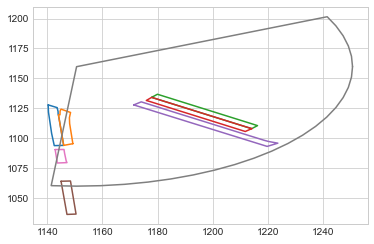

in Options class, polygonalRegions:  [<shapely.geometry.polygon.Polygon object at 0x249a64fa0>, <shapely.geometry.polygon.Polygon object at 0x249a70cd0>, <shapely.geometry.polygon.Polygon object at 0x263654640>, <shapely.geometry.polygon.Polygon object at 0x26365a250>, <shapely.geometry.polygon.Polygon object at 0x2c48e5c40>, <shapely.geometry.polygon.Polygon object at 0x2c5b01040>, <shapely.geometry.polygon.Polygon object at 0x2c5c7a0a0>]


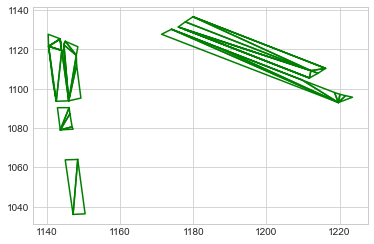

NOT VALID: POSITION
VALID:  False
position:  (1872.2293406372482 @ 1071.6991937735797)


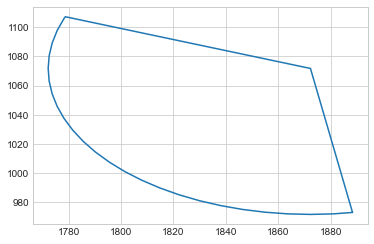

NOT VALID: POSITION
VALID:  False
position:  (2134.772516879334 @ 901.4072172879532)


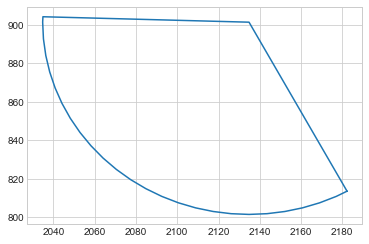

NOT VALID: POSITION
VALID:  False
position:  (1241.884688691265 @ 958.408272044473)


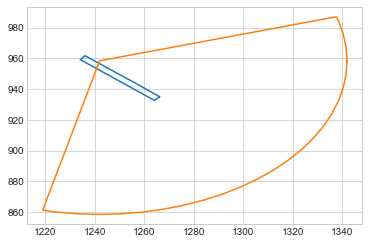

in Options class, polygonalRegions:  [<shapely.geometry.polygon.Polygon object at 0x2c5b37a90>]


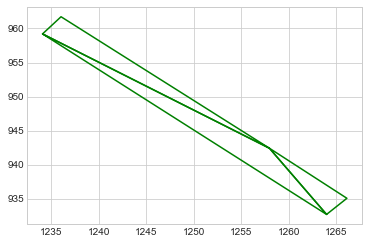

NOT VALID: POSITION
VALID:  False
position:  (537.5428411694379 @ 627.5015954223221)


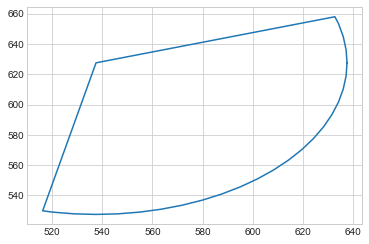

NOT VALID: POSITION
VALID:  False
position:  (678.9742426880118 @ 1344.2368144791533)


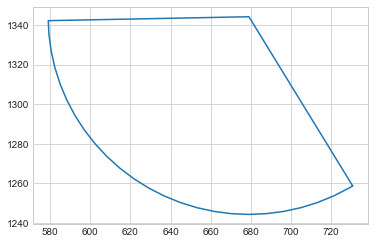

NOT VALID: POSITION
VALID:  False
position:  (461.6637932035633 @ 1601.629680931058)


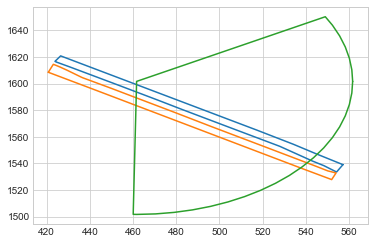

in Options class, polygonalRegions:  [<shapely.geometry.polygon.Polygon object at 0x24945ae20>, <shapely.geometry.polygon.Polygon object at 0x2c5cff4c0>]


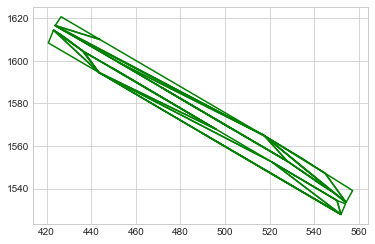

NOT VALID: POSITION
VALID:  False
position:  (2312.0769829201804 @ 1034.7868559160936)


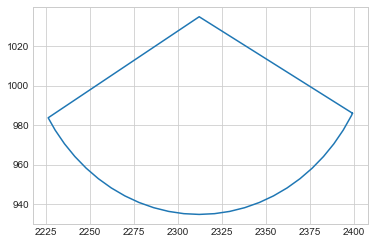

NOT VALID: POSITION
VALID:  False
position:  (1485.27966637952 @ 891.7717755552172)


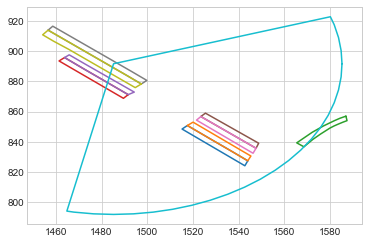

in Options class, polygonalRegions:  [<shapely.geometry.polygon.Polygon object at 0x248cee370>, <shapely.geometry.polygon.Polygon object at 0x248ceee80>, <shapely.geometry.polygon.Polygon object at 0x2496d36d0>, <shapely.geometry.polygon.Polygon object at 0x2c48543d0>, <shapely.geometry.polygon.Polygon object at 0x2c4854ee0>, <shapely.geometry.polygon.Polygon object at 0x2c51927c0>, <shapely.geometry.polygon.Polygon object at 0x2c519b1f0>, <shapely.geometry.polygon.Polygon object at 0x2c5c55970>, <shapely.geometry.polygon.Polygon object at 0x2c5c5d580>]


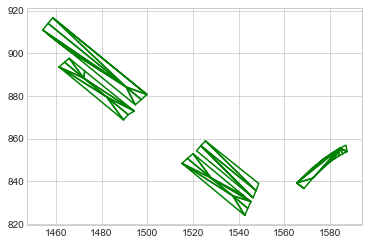

NOT VALID: POSITION
VALID:  False
position:  (1239.4696055609888 @ 960.7168445227359)


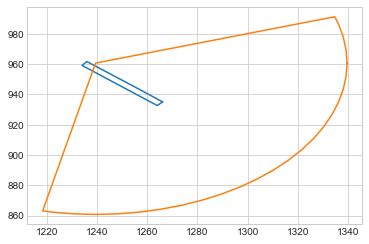

in Options class, polygonalRegions:  [<shapely.geometry.polygon.Polygon object at 0x2c5b37a90>]


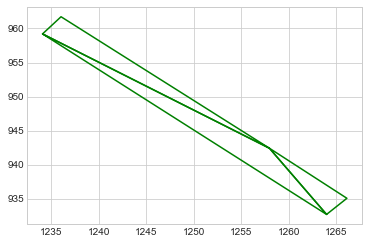

NOT VALID: POSITION
VALID:  False
position:  (1246.4239016113281 @ 948.9815365306786)


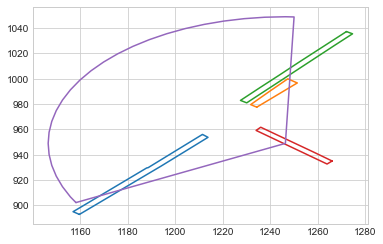

in Options class, polygonalRegions:  [<shapely.geometry.polygon.Polygon object at 0x24566e610>, <shapely.geometry.polygon.Polygon object at 0x263856160>, <shapely.geometry.polygon.Polygon object at 0x2c594c370>, <shapely.geometry.polygon.Polygon object at 0x2c5b37a90>]


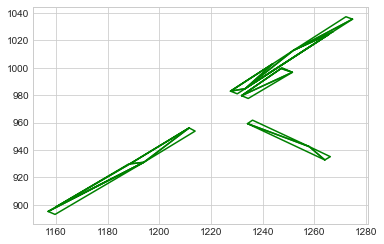

NOT VALID: POSITION
VALID:  False
position:  (733.9685131907536 @ 579.8786619818023)


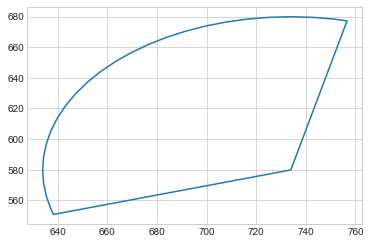

NOT VALID: POSITION
VALID:  False
position:  (1894.0507847122074 @ 1072.9241674395773)


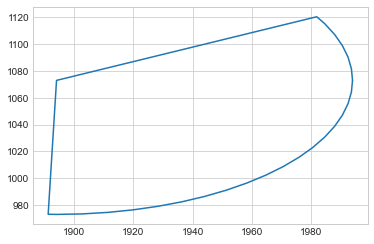

NOT VALID: POSITION
VALID:  False
position:  (2526.373566627476 @ 828.9900682883598)


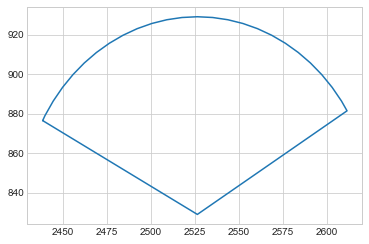

NOT VALID: POSITION
VALID:  False
position:  (1936.9774758299334 @ 870.5690018078196)


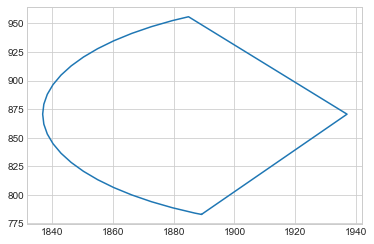

NOT VALID: POSITION
VALID:  False
position:  (1056.1470198596971 @ 1228.0358463250873)


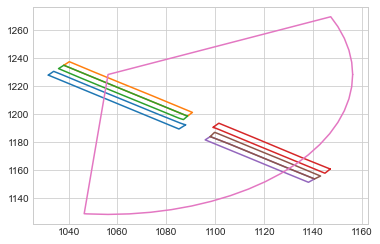

in Options class, polygonalRegions:  [<shapely.geometry.polygon.Polygon object at 0x247e11bb0>, <shapely.geometry.polygon.Polygon object at 0x2c3ccb3a0>, <shapely.geometry.polygon.Polygon object at 0x2c3ccbfd0>, <shapely.geometry.polygon.Polygon object at 0x2c3de77c0>, <shapely.geometry.polygon.Polygon object at 0x2c5bb1460>, <shapely.geometry.polygon.Polygon object at 0x2c5bbb130>]


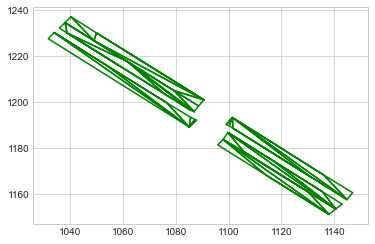

NOT VALID: POSITION
VALID:  False
position:  (1873.9035428321351 @ 1296.9877496515503)


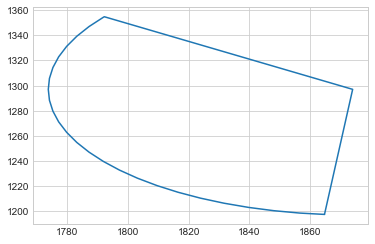

NOT VALID: POSITION
VALID:  False
position:  (759.9251744035059 @ 1515.0306869498943)


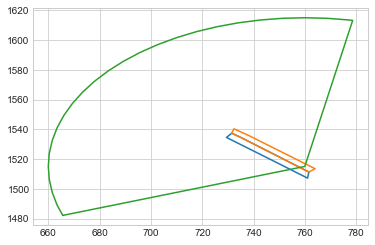

in Options class, polygonalRegions:  [<shapely.geometry.polygon.Polygon object at 0x2454b9a60>, <shapely.geometry.polygon.Polygon object at 0x2454c2670>]


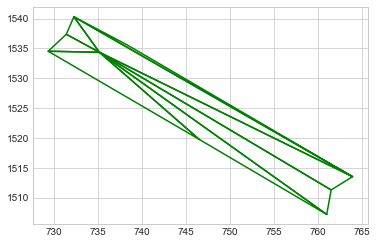

NOT VALID: POSITION
VALID:  False
position:  (1725.8692102170057 @ 784.6896235892924)


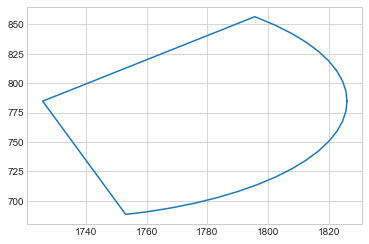

NOT VALID: POSITION
VALID:  False
position:  (680.2954423830433 @ 626.9344109564372)


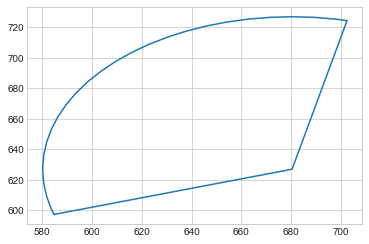

NOT VALID: POSITION
VALID:  False
position:  (1664.369609611936 @ 1274.3082829703892)


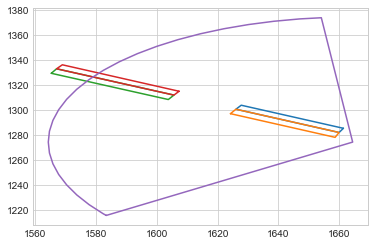

in Options class, polygonalRegions:  [<shapely.geometry.polygon.Polygon object at 0x2480c9b50>, <shapely.geometry.polygon.Polygon object at 0x2480d2520>, <shapely.geometry.polygon.Polygon object at 0x2c4cc5cd0>, <shapely.geometry.polygon.Polygon object at 0x2c4cce6a0>]


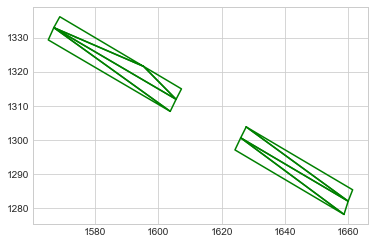

NOT VALID: POSITION
VALID:  False
position:  (2276.975268448643 @ 1080.719734690375)


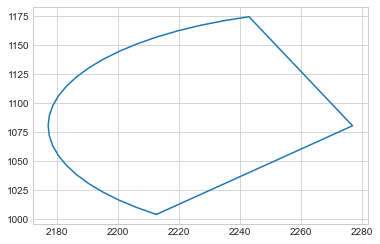

NOT VALID: POSITION
VALID:  False
position:  (1337.5633159403128 @ 1450.8067865378398)


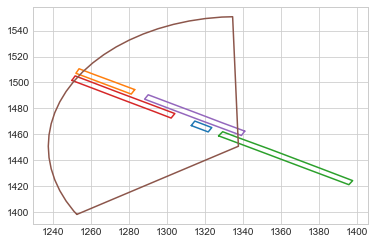

in Options class, polygonalRegions:  [<shapely.geometry.polygon.Polygon object at 0x244e4a040>, <shapely.geometry.polygon.Polygon object at 0x2481cbdf0>, <shapely.geometry.polygon.Polygon object at 0x263596610>, <shapely.geometry.polygon.Polygon object at 0x26428ef70>, <shapely.geometry.polygon.Polygon object at 0x2c5dc78e0>]


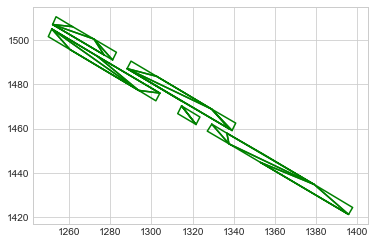

NOT VALID: POSITION
VALID:  False
position:  (1301.203359448345 @ 896.0731266565756)


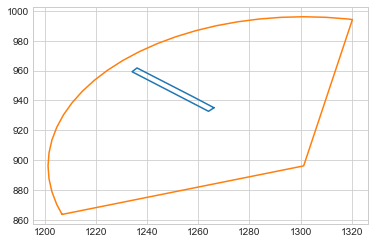

in Options class, polygonalRegions:  [<shapely.geometry.polygon.Polygon object at 0x2c5b37a90>]


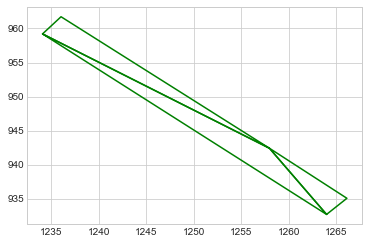

NOT VALID: POSITION
VALID:  False
position:  (1412.7349140659849 @ 954.1702911202713)


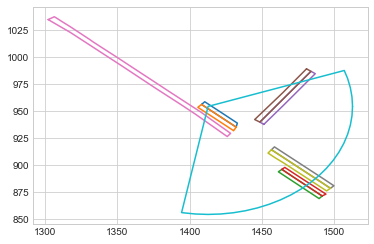

in Options class, polygonalRegions:  [<shapely.geometry.polygon.Polygon object at 0x244e8aeb0>, <shapely.geometry.polygon.Polygon object at 0x244e95a90>, <shapely.geometry.polygon.Polygon object at 0x2c48543d0>, <shapely.geometry.polygon.Polygon object at 0x2c4854ee0>, <shapely.geometry.polygon.Polygon object at 0x2c4c25910>, <shapely.geometry.polygon.Polygon object at 0x2c4c2e400>, <shapely.geometry.polygon.Polygon object at 0x2c506e2b0>, <shapely.geometry.polygon.Polygon object at 0x2c5c55970>, <shapely.geometry.polygon.Polygon object at 0x2c5c5d580>]


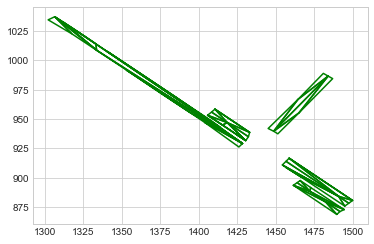

NOT VALID: POSITION
VALID:  False
position:  (789.6062682833638 @ 403.9899392798805)


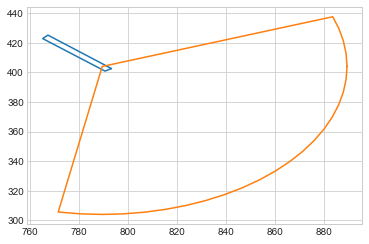

in Options class, polygonalRegions:  [<shapely.geometry.polygon.Polygon object at 0x248241550>]


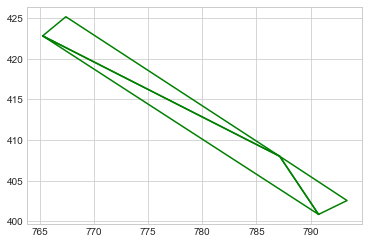

position is valid
heading:  4.007855452877054
within get_traffic_flow
point:  (789.6062682833638 @ 403.9899392798805)
heading output =  3.998104439752686
heading is valid
position:  (735.556 @ 453.814)
NOT VALID: POSITION
position:  (789.6062682833638 @ 403.9899392798805)
NOT VALID: POSITION
position:  (730.894 @ 457.546)
NOT VALID: POSITION
position:  (789.6062682833638 @ 403.9899392798805)
NOT VALID: POSITION
position:  (726.014 @ 454.912)
NOT VALID: POSITION
position:  (789.6062682833638 @ 403.9899392798805)
NOT VALID: POSITION
position:  (726.014 @ 454.912)
NOT VALID: POSITION
position:  (789.6062682833638 @ 403.9899392798805)
NOT VALID: POSITION
position:  (735.556 @ 453.814)
NOT VALID: POSITION
position:  (789.6062682833638 @ 403.9899392798805)
NOT VALID: POSITION
position:  (730.894 @ 457.546)
NOT VALID: POSITION
position:  (789.6062682833638 @ 403.9899392798805)
NOT VALID: POSITION
within get_traffic_flow
point:  (1521.5391987802302 @ 1354.2986407686933)
heading output =  1.075

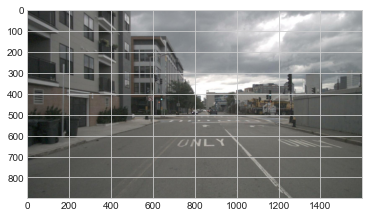

position:  (1461.154758428453 @ 912.45432585176)


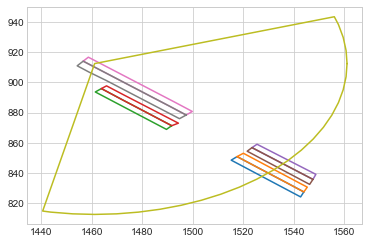

in Options class, polygonalRegions:  [<shapely.geometry.polygon.Polygon object at 0x248cee370>, <shapely.geometry.polygon.Polygon object at 0x248ceee80>, <shapely.geometry.polygon.Polygon object at 0x2c48543d0>, <shapely.geometry.polygon.Polygon object at 0x2c4854ee0>, <shapely.geometry.polygon.Polygon object at 0x2c51927c0>, <shapely.geometry.polygon.Polygon object at 0x2c519b1f0>, <shapely.geometry.polygon.Polygon object at 0x2c5c55970>, <shapely.geometry.polygon.Polygon object at 0x2c5c5d580>]


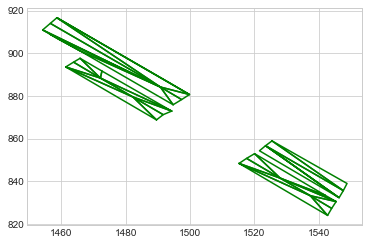

position is valid
heading:  3.981206922277614
within get_traffic_flow
point:  (1461.154758428453 @ 912.45432585176)
heading output =  3.993938954957558
heading is valid
position:  (1452.494 @ 928.63)
NOT VALID: POSITION
position:  (1461.154758428453 @ 912.45432585176)
NOT VALID: POSITION
position:  (1448.947 @ 950.458)
NOT VALID: POSITION
position:  (1461.154758428453 @ 912.45432585176)
NOT VALID: POSITION
position:  (1407.25 @ 945.458)
NOT VALID: POSITION
position:  (1461.154758428453 @ 912.45432585176)
NOT VALID: POSITION
position:  (1407.25 @ 945.458)
NOT VALID: POSITION
position:  (1461.154758428453 @ 912.45432585176)
NOT VALID: POSITION
position:  (1452.494 @ 928.63)
NOT VALID: POSITION
position:  (1461.154758428453 @ 912.45432585176)
NOT VALID: POSITION
position:  (1448.947 @ 950.458)
NOT VALID: POSITION
position:  (1461.154758428453 @ 912.45432585176)
NOT VALID: POSITION
within get_traffic_flow
point:  (758.977941085943 @ 1487.1750174299796)
heading output =  -0.5578581773814837

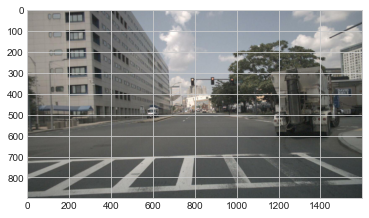

position:  (522.2145211846537 @ 1563.8902020169626)


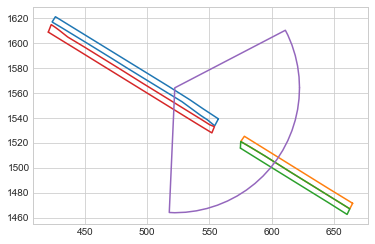

in Options class, polygonalRegions:  [<shapely.geometry.polygon.Polygon object at 0x24945ae20>, <shapely.geometry.polygon.Polygon object at 0x2c4f71be0>, <shapely.geometry.polygon.Polygon object at 0x2c4f7d910>, <shapely.geometry.polygon.Polygon object at 0x2c5cff4c0>]


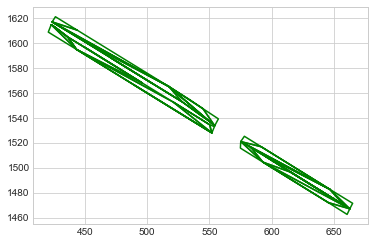

NOT VALID: POSITION
VALID:  False
position:  (1185.0411005971105 @ 1134.9647365470523)


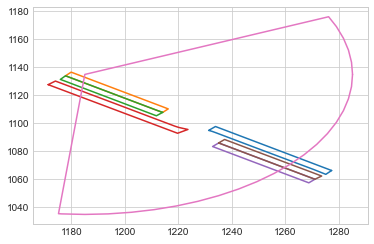

in Options class, polygonalRegions:  [<shapely.geometry.polygon.Polygon object at 0x248f88eb0>, <shapely.geometry.polygon.Polygon object at 0x263654640>, <shapely.geometry.polygon.Polygon object at 0x26365a250>, <shapely.geometry.polygon.Polygon object at 0x2c48e5c40>, <shapely.geometry.polygon.Polygon object at 0x2c5251070>, <shapely.geometry.polygon.Polygon object at 0x2c5251a60>]


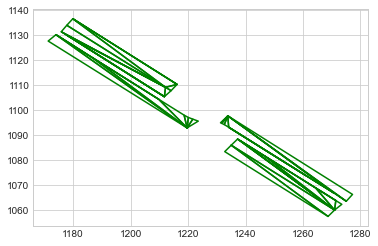

NOT VALID: POSITION
VALID:  False
position:  (1461.2944357274823 @ 1294.7654928176755)


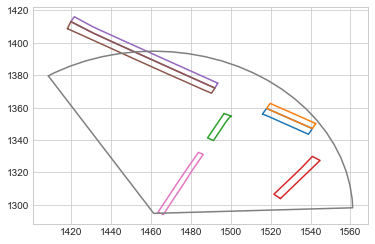

in Options class, polygonalRegions:  [<shapely.geometry.polygon.Polygon object at 0x2481edc40>, <shapely.geometry.polygon.Polygon object at 0x2481f7730>, <shapely.geometry.polygon.Polygon object at 0x2493f3460>, <shapely.geometry.polygon.Polygon object at 0x2c475ae80>, <shapely.geometry.polygon.Polygon object at 0x2c58f6370>, <shapely.geometry.polygon.Polygon object at 0x2c5904040>, <shapely.geometry.polygon.Polygon object at 0x2c5b8e700>]


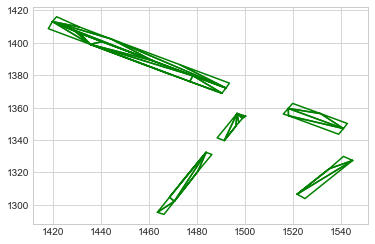

NOT VALID: POSITION
VALID:  False
position:  (441.01508230170657 @ 820.4521958837511)


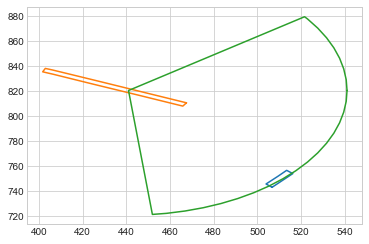

in Options class, polygonalRegions:  [<shapely.geometry.polygon.Polygon object at 0x248b8e610>, <shapely.geometry.polygon.Polygon object at 0x2495d0400>]


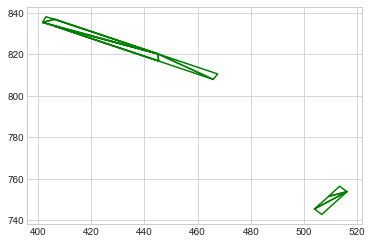

position is valid
heading:  4.29832744936795
within get_traffic_flow
point:  (441.01508230170657 @ 820.4521958837511)
heading output =  4.308298932715173
heading is valid
position:  (418.386 @ 822.631)
NOT VALID: POSITION
position:  (441.01508230170657 @ 820.4521958837511)
NOT VALID: POSITION
position:  (415.915 @ 831.134)
NOT VALID: POSITION
position:  (441.01508230170657 @ 820.4521958837511)
NOT VALID: POSITION
within get_traffic_flow
point:  (1430.263799006836 @ 937.2823872311574)
heading output =  3.993137939934231
within get_traffic_flow
point:  (1427.6218996516923 @ 945.2169971943048)
heading output =  4.053039864470734
VALID:  True


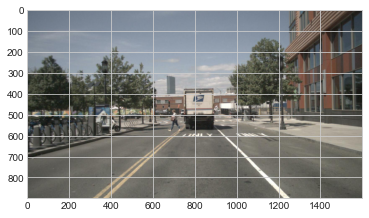

position:  (727.619417279861 @ 590.4352812103275)


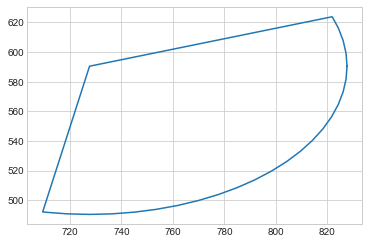

NOT VALID: POSITION
VALID:  False
position:  (785.7486618372404 @ 407.4566852306004)


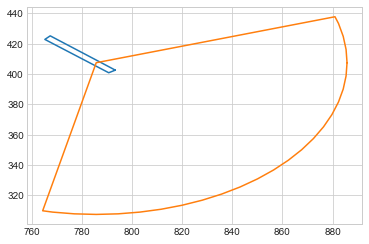

in Options class, polygonalRegions:  [<shapely.geometry.polygon.Polygon object at 0x248241550>]


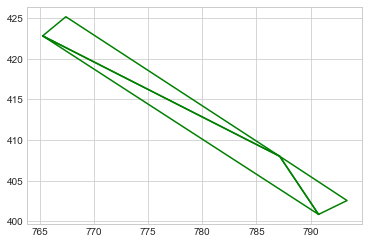

position is valid
heading:  3.9734036862713333
within get_traffic_flow
point:  (785.7486618372404 @ 407.4566852306004)
heading output =  3.998104439752686
heading is valid
position:  (732.047 @ 457.105)
NOT VALID: POSITION
position:  (785.7486618372404 @ 407.4566852306004)
NOT VALID: POSITION
within get_traffic_flow
point:  (1587.691377995651 @ 1318.9170355348185)
heading output =  1.0714979682816352
within get_traffic_flow
point:  (1582.8546719854573 @ 1316.2604801370292)
heading output =  1.0703458040110605
VALID:  True


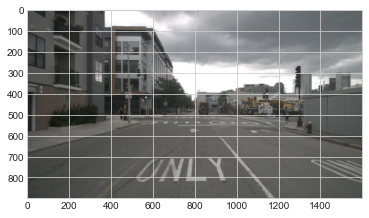

position:  (1853.715131675578 @ 1271.487074624122)


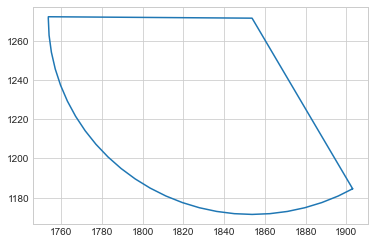

NOT VALID: POSITION
VALID:  False
position:  (1671.8579300704787 @ 1264.8870895796526)


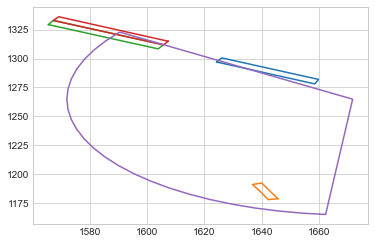

in Options class, polygonalRegions:  [<shapely.geometry.polygon.Polygon object at 0x2480d2520>, <shapely.geometry.polygon.Polygon object at 0x2c437ccd0>, <shapely.geometry.polygon.Polygon object at 0x2c4cc5cd0>, <shapely.geometry.polygon.Polygon object at 0x2c4cce6a0>]


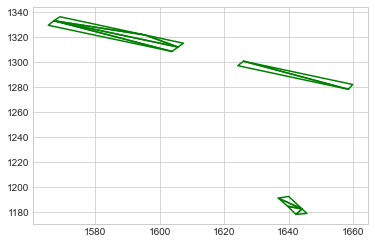

NOT VALID: POSITION
VALID:  False
position:  (1185.1335401660522 @ 1134.8982246736196)


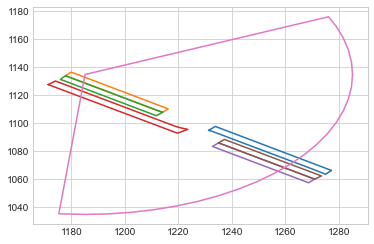

in Options class, polygonalRegions:  [<shapely.geometry.polygon.Polygon object at 0x248f88eb0>, <shapely.geometry.polygon.Polygon object at 0x263654640>, <shapely.geometry.polygon.Polygon object at 0x26365a250>, <shapely.geometry.polygon.Polygon object at 0x2c48e5c40>, <shapely.geometry.polygon.Polygon object at 0x2c5251070>, <shapely.geometry.polygon.Polygon object at 0x2c5251a60>]


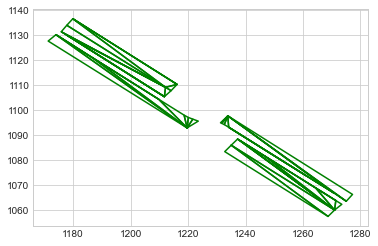

NOT VALID: POSITION
VALID:  False
position:  (612.026195667107 @ 692.1615464704851)


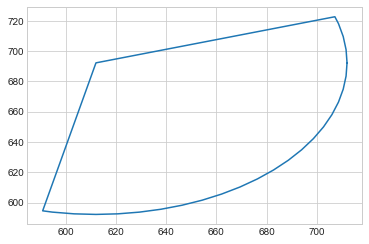

NOT VALID: POSITION
VALID:  False
position:  (1458.3935372950655 @ 914.8913937105336)


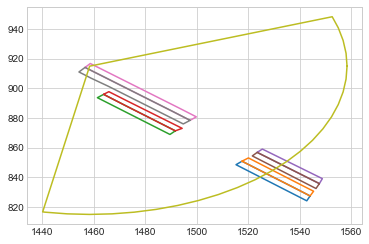

in Options class, polygonalRegions:  [<shapely.geometry.polygon.Polygon object at 0x248cee370>, <shapely.geometry.polygon.Polygon object at 0x248ceee80>, <shapely.geometry.polygon.Polygon object at 0x2c48543d0>, <shapely.geometry.polygon.Polygon object at 0x2c4854ee0>, <shapely.geometry.polygon.Polygon object at 0x2c51927c0>, <shapely.geometry.polygon.Polygon object at 0x2c519b1f0>, <shapely.geometry.polygon.Polygon object at 0x2c5c55970>, <shapely.geometry.polygon.Polygon object at 0x2c5c5d580>]


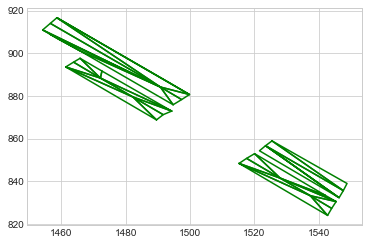

position is valid
heading:  4.005255897668601
within get_traffic_flow
point:  (1458.3935372950655 @ 914.8913937105336)
heading output =  3.993938954957558
heading is valid
position:  (1437.165 @ 917.844)
NOT VALID: POSITION
position:  (1458.3935372950655 @ 914.8913937105336)
NOT VALID: POSITION
position:  (1393.703 @ 975.498)
NOT VALID: POSITION
position:  (1458.3935372950655 @ 914.8913937105336)
NOT VALID: POSITION
position:  (1371.893 @ 971.467)
NOT VALID: POSITION
position:  (1458.3935372950655 @ 914.8913937105336)
NOT VALID: POSITION
position:  (1371.893 @ 971.467)
NOT VALID: POSITION
position:  (1458.3935372950655 @ 914.8913937105336)
NOT VALID: POSITION
position:  (1437.165 @ 917.844)
NOT VALID: POSITION
position:  (1458.3935372950655 @ 914.8913937105336)
NOT VALID: POSITION
position:  (1393.703 @ 975.498)
NOT VALID: POSITION
position:  (1458.3935372950655 @ 914.8913937105336)
NOT VALID: POSITION
within get_traffic_flow
point:  (1271.913840084804 @ 1024.6885114267043)
heading out

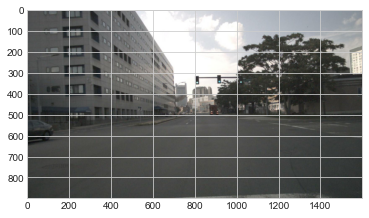

position:  (2138.821732818572 @ 911.1956474856863)


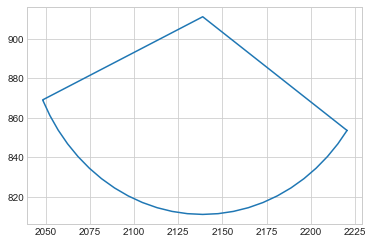

NOT VALID: POSITION
VALID:  False
position:  (1741.7618962820939 @ 1232.574743511673)


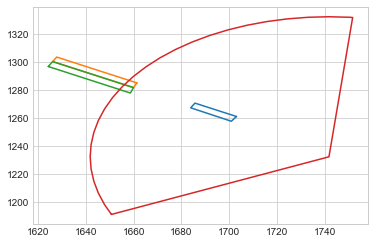

in Options class, polygonalRegions:  [<shapely.geometry.polygon.Polygon object at 0x2454fbcd0>, <shapely.geometry.polygon.Polygon object at 0x2480c9b50>, <shapely.geometry.polygon.Polygon object at 0x2480d2520>]


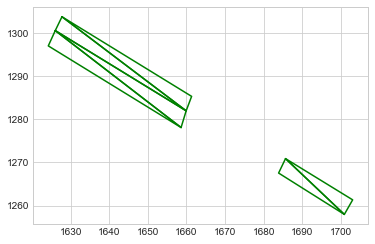

NOT VALID: POSITION
VALID:  False
position:  (1185.133540372785 @ 1134.8982218306385)


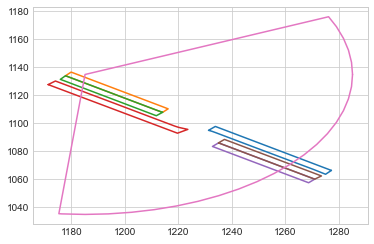

in Options class, polygonalRegions:  [<shapely.geometry.polygon.Polygon object at 0x248f88eb0>, <shapely.geometry.polygon.Polygon object at 0x263654640>, <shapely.geometry.polygon.Polygon object at 0x26365a250>, <shapely.geometry.polygon.Polygon object at 0x2c48e5c40>, <shapely.geometry.polygon.Polygon object at 0x2c5251070>, <shapely.geometry.polygon.Polygon object at 0x2c5251a60>]


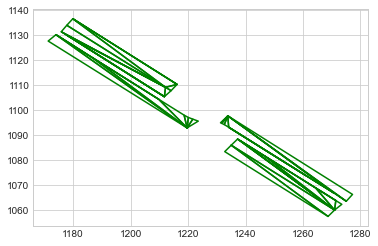

NOT VALID: POSITION
VALID:  False
position:  (2239.726660567886 @ 793.5446052791785)


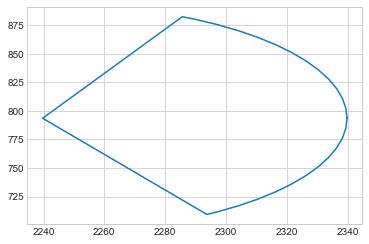

NOT VALID: POSITION
VALID:  False
position:  (2163.45943531692 @ 875.2375985583933)


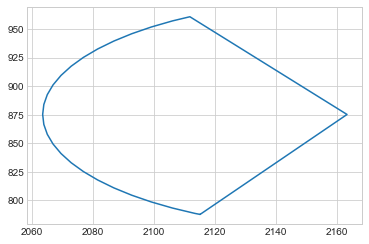

NOT VALID: POSITION
VALID:  False
position:  (786.1691321234885 @ 406.67076378166496)


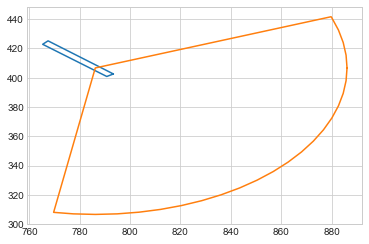

in Options class, polygonalRegions:  [<shapely.geometry.polygon.Polygon object at 0x248241550>]


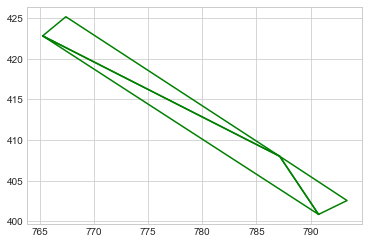

position is valid
heading:  4.022449696529552
within get_traffic_flow
point:  (786.1691321234885 @ 406.67076378166496)
heading output =  3.998104439752686
heading is valid
position:  (762.752 @ 445.5)
NOT VALID: POSITION
position:  (786.1691321234885 @ 406.67076378166496)
NOT VALID: POSITION
position:  (749.851 @ 438.349)
NOT VALID: POSITION
position:  (786.1691321234885 @ 406.67076378166496)
NOT VALID: POSITION
position:  (718.504 @ 472.716)
NOT VALID: POSITION
position:  (786.1691321234885 @ 406.67076378166496)
NOT VALID: POSITION
position:  (718.504 @ 472.716)
NOT VALID: POSITION
position:  (786.1691321234885 @ 406.67076378166496)
NOT VALID: POSITION
position:  (762.752 @ 445.5)
NOT VALID: POSITION
position:  (786.1691321234885 @ 406.67076378166496)
NOT VALID: POSITION
position:  (749.851 @ 438.349)
NOT VALID: POSITION
position:  (786.1691321234885 @ 406.67076378166496)
NOT VALID: POSITION
within get_traffic_flow
point:  (606.9459625314208 @ 1921.5323532650523)
heading output =  0.9

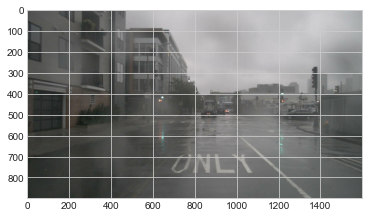

position:  (1670.6432414319356 @ 1265.3467399318)


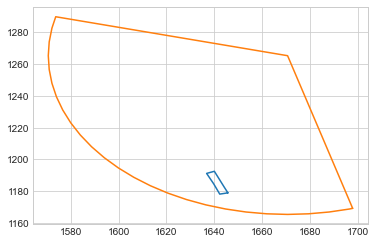

in Options class, polygonalRegions:  [<shapely.geometry.polygon.Polygon object at 0x2c437ccd0>]


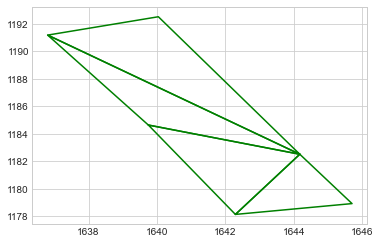

NOT VALID: POSITION
VALID:  False
position:  (1462.3957357078325 @ 1296.8138598578353)


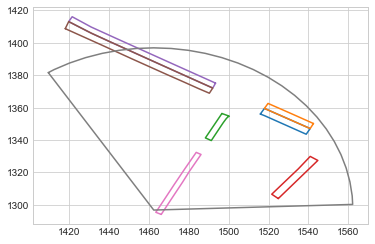

in Options class, polygonalRegions:  [<shapely.geometry.polygon.Polygon object at 0x2481edc40>, <shapely.geometry.polygon.Polygon object at 0x2481f7730>, <shapely.geometry.polygon.Polygon object at 0x2493f3460>, <shapely.geometry.polygon.Polygon object at 0x2c475ae80>, <shapely.geometry.polygon.Polygon object at 0x2c58f6370>, <shapely.geometry.polygon.Polygon object at 0x2c5904040>, <shapely.geometry.polygon.Polygon object at 0x2c5b8e700>]


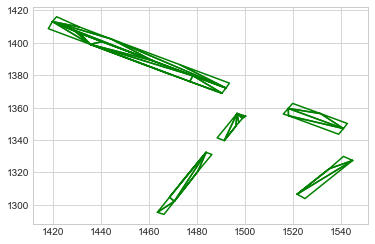

NOT VALID: POSITION
VALID:  False
position:  (678.9235100486906 @ 1344.1596410630646)


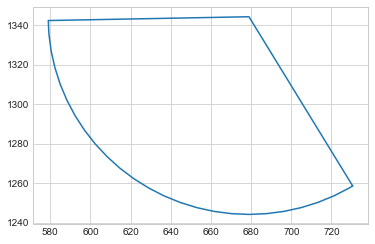

NOT VALID: POSITION
VALID:  False
position:  (2367.6877863657837 @ 796.5005725059959)


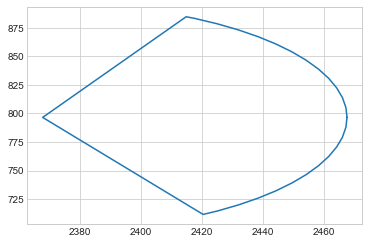

NOT VALID: POSITION
VALID:  False
position:  (1458.9094561160018 @ 914.7780126461739)


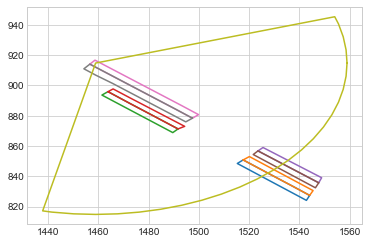

in Options class, polygonalRegions:  [<shapely.geometry.polygon.Polygon object at 0x248cee370>, <shapely.geometry.polygon.Polygon object at 0x248ceee80>, <shapely.geometry.polygon.Polygon object at 0x2c48543d0>, <shapely.geometry.polygon.Polygon object at 0x2c4854ee0>, <shapely.geometry.polygon.Polygon object at 0x2c51927c0>, <shapely.geometry.polygon.Polygon object at 0x2c519b1f0>, <shapely.geometry.polygon.Polygon object at 0x2c5c55970>, <shapely.geometry.polygon.Polygon object at 0x2c5c5d580>]


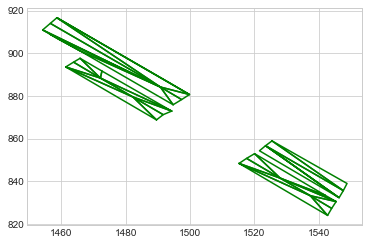

position is valid
heading:  3.9764198705967257
within get_traffic_flow
point:  (1458.9094561160018 @ 914.7780126461739)
heading output =  3.993938954957558
heading is valid
position:  (1406.299 @ 960.397)
NOT VALID: POSITION
position:  (1458.9094561160018 @ 914.7780126461739)
NOT VALID: POSITION
position:  (1368.747 @ 975.158)
NOT VALID: POSITION
position:  (1458.9094561160018 @ 914.7780126461739)
NOT VALID: POSITION
position:  (1353.279 @ 992.442)
NOT VALID: POSITION
position:  (1458.9094561160018 @ 914.7780126461739)
NOT VALID: POSITION
position:  (1353.279 @ 992.442)
NOT VALID: POSITION
position:  (1458.9094561160018 @ 914.7780126461739)
NOT VALID: POSITION
position:  (1406.299 @ 960.397)
NOT VALID: POSITION
position:  (1458.9094561160018 @ 914.7780126461739)
NOT VALID: POSITION
position:  (1368.747 @ 975.158)
NOT VALID: POSITION
position:  (1458.9094561160018 @ 914.7780126461739)
NOT VALID: POSITION
within get_traffic_flow
point:  (1579.5799556462307 @ 807.6421630767244)
heading ou

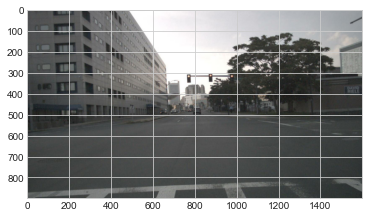

position:  (1185.133287475619 @ 1134.8978722963561)


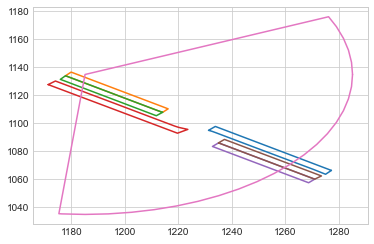

in Options class, polygonalRegions:  [<shapely.geometry.polygon.Polygon object at 0x248f88eb0>, <shapely.geometry.polygon.Polygon object at 0x263654640>, <shapely.geometry.polygon.Polygon object at 0x26365a250>, <shapely.geometry.polygon.Polygon object at 0x2c48e5c40>, <shapely.geometry.polygon.Polygon object at 0x2c5251070>, <shapely.geometry.polygon.Polygon object at 0x2c5251a60>]


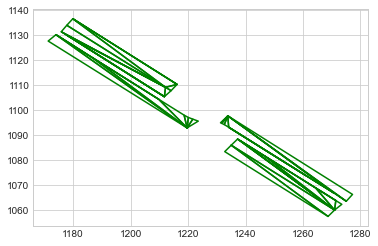

NOT VALID: POSITION
VALID:  False
position:  (1254.7446639897043 @ 942.450223148541)


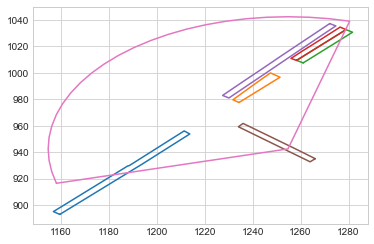

in Options class, polygonalRegions:  [<shapely.geometry.polygon.Polygon object at 0x24566e610>, <shapely.geometry.polygon.Polygon object at 0x263856160>, <shapely.geometry.polygon.Polygon object at 0x2c477a8e0>, <shapely.geometry.polygon.Polygon object at 0x2c47834f0>, <shapely.geometry.polygon.Polygon object at 0x2c594c370>, <shapely.geometry.polygon.Polygon object at 0x2c5b37a90>]


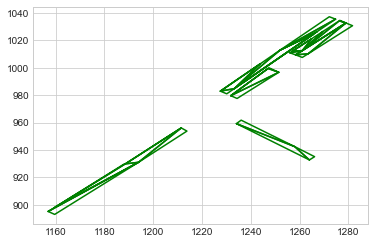

NOT VALID: POSITION
VALID:  False
position:  (1357.479920523973 @ 1131.82294530463)


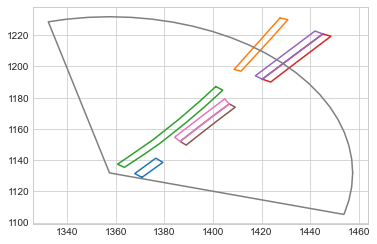

in Options class, polygonalRegions:  [<shapely.geometry.polygon.Polygon object at 0x24510fb80>, <shapely.geometry.polygon.Polygon object at 0x2499916a0>, <shapely.geometry.polygon.Polygon object at 0x2c5099d90>, <shapely.geometry.polygon.Polygon object at 0x2c50c1cd0>, <shapely.geometry.polygon.Polygon object at 0x2c50c98e0>, <shapely.geometry.polygon.Polygon object at 0x2c59e6d60>, <shapely.geometry.polygon.Polygon object at 0x2c59f1a30>]


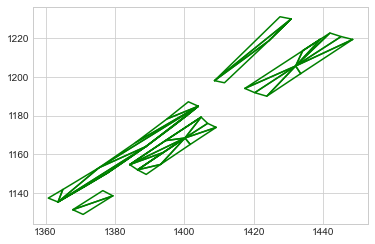

NOT VALID: POSITION
VALID:  False
position:  (596.0136730784714 @ 707.5663696627682)


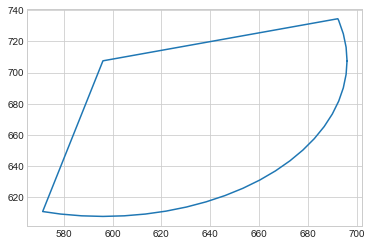

NOT VALID: POSITION
VALID:  False
position:  (1241.0465300358696 @ 959.2177151237964)


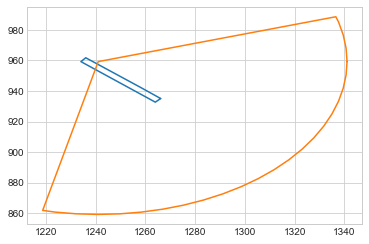

in Options class, polygonalRegions:  [<shapely.geometry.polygon.Polygon object at 0x2c5b37a90>]


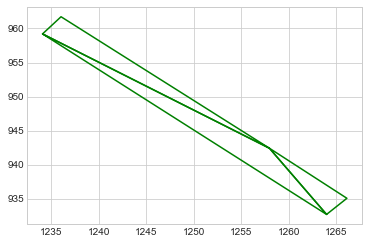

NOT VALID: POSITION
VALID:  False
position:  (1816.0638258664771 @ 1163.850213999884)


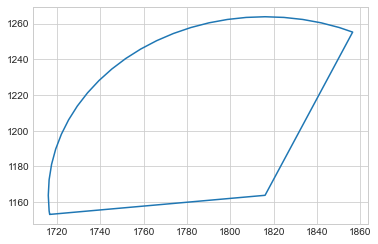

NOT VALID: POSITION
VALID:  False
position:  (1187.748168281174 @ 1409.758686174941)


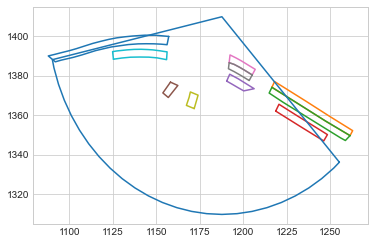

in Options class, polygonalRegions:  [<shapely.geometry.polygon.Polygon object at 0x244c5b880>, <shapely.geometry.polygon.Polygon object at 0x248daa6d0>, <shapely.geometry.polygon.Polygon object at 0x248db33a0>, <shapely.geometry.polygon.Polygon object at 0x24941ee20>, <shapely.geometry.polygon.Polygon object at 0x2638910a0>, <shapely.geometry.polygon.Polygon object at 0x2c4a6cbe0>, <shapely.geometry.polygon.Polygon object at 0x2c4b24a00>, <shapely.geometry.polygon.Polygon object at 0x2c4b31670>, <shapely.geometry.polygon.Polygon object at 0x2c51e5d90>, <shapely.geometry.polygon.Polygon object at 0x2c5361310>]


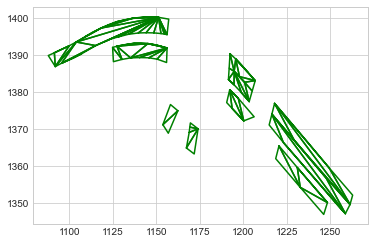

NOT VALID: POSITION
VALID:  False
position:  (2012.599649594164 @ 992.8465711109704)


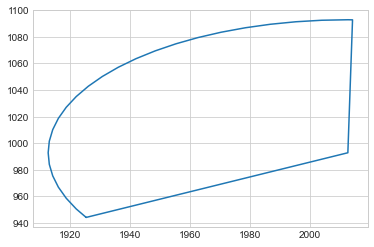

NOT VALID: POSITION
VALID:  False
position:  (1870.1767798994279 @ 1069.5338194937663)


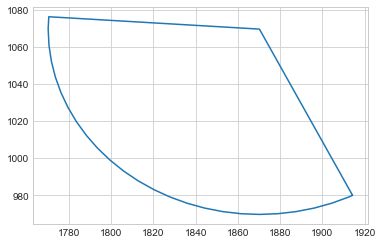

NOT VALID: POSITION
VALID:  False
position:  (2331.340294966385 @ 1012.7209654009428)


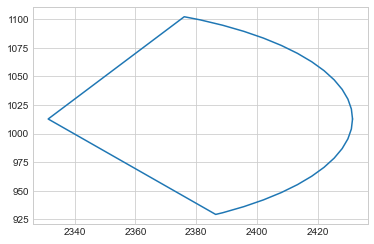

NOT VALID: POSITION
VALID:  False
position:  (492.4161946151248 @ 1705.1348112052726)


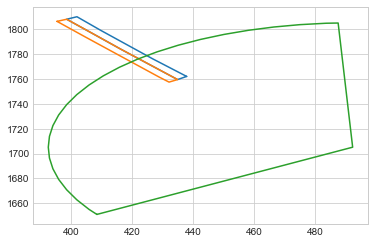

in Options class, polygonalRegions:  [<shapely.geometry.polygon.Polygon object at 0x248102ca0>, <shapely.geometry.polygon.Polygon object at 0x24810f910>]


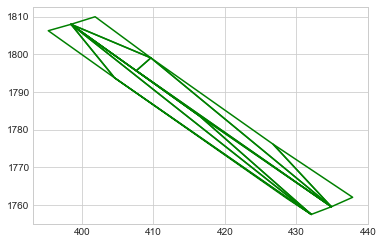

NOT VALID: POSITION
VALID:  False
position:  (1236.49936402194 @ 963.6480006406429)


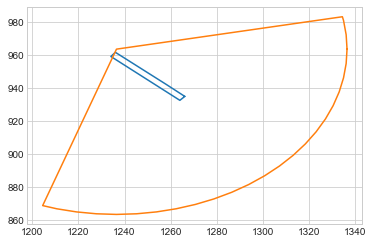

in Options class, polygonalRegions:  [<shapely.geometry.polygon.Polygon object at 0x2c5b37a90>]


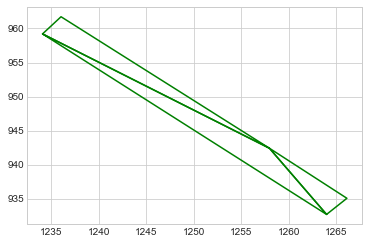

NOT VALID: POSITION
VALID:  False
position:  (754.8993900978944 @ 435.1961291828957)


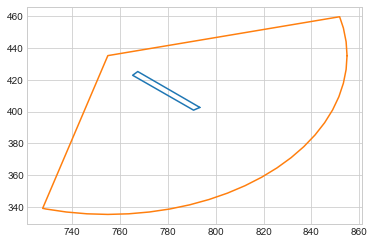

in Options class, polygonalRegions:  [<shapely.geometry.polygon.Polygon object at 0x248241550>]


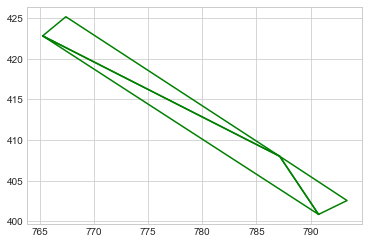

NOT VALID: POSITION
VALID:  False
position:  (1936.6191255710464 @ 1047.787536869634)


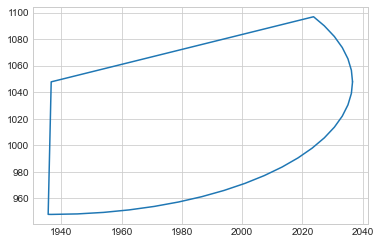

NOT VALID: POSITION
VALID:  False
position:  (1321.3567731400008 @ 1459.8378261471141)


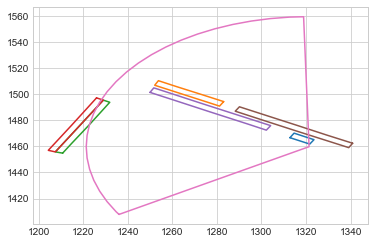

in Options class, polygonalRegions:  [<shapely.geometry.polygon.Polygon object at 0x244e4a040>, <shapely.geometry.polygon.Polygon object at 0x2481cbdf0>, <shapely.geometry.polygon.Polygon object at 0x248c2c7f0>, <shapely.geometry.polygon.Polygon object at 0x248c34340>, <shapely.geometry.polygon.Polygon object at 0x26428ef70>, <shapely.geometry.polygon.Polygon object at 0x2c5dc78e0>]


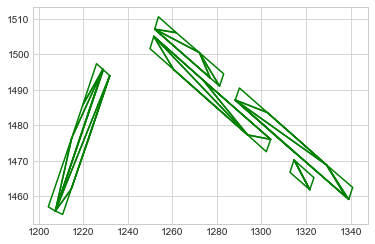

NOT VALID: POSITION
VALID:  False
position:  (1185.1335096770754 @ 1134.8981784073262)


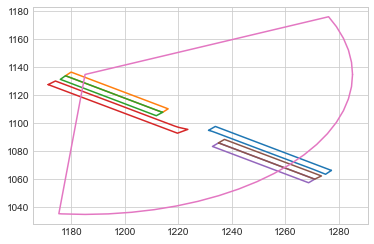

in Options class, polygonalRegions:  [<shapely.geometry.polygon.Polygon object at 0x248f88eb0>, <shapely.geometry.polygon.Polygon object at 0x263654640>, <shapely.geometry.polygon.Polygon object at 0x26365a250>, <shapely.geometry.polygon.Polygon object at 0x2c48e5c40>, <shapely.geometry.polygon.Polygon object at 0x2c5251070>, <shapely.geometry.polygon.Polygon object at 0x2c5251a60>]


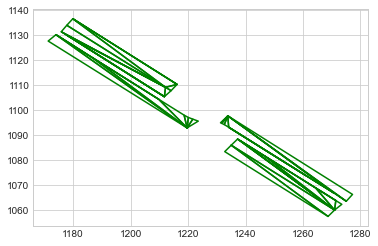

NOT VALID: POSITION
VALID:  False
position:  (1186.5249196165867 @ 1404.458794908116)


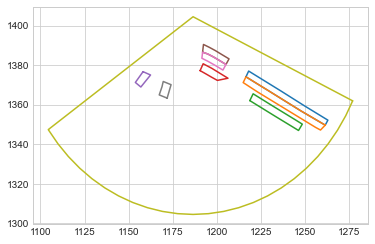

in Options class, polygonalRegions:  [<shapely.geometry.polygon.Polygon object at 0x248daa6d0>, <shapely.geometry.polygon.Polygon object at 0x248db33a0>, <shapely.geometry.polygon.Polygon object at 0x24941ee20>, <shapely.geometry.polygon.Polygon object at 0x2638910a0>, <shapely.geometry.polygon.Polygon object at 0x2c4a6cbe0>, <shapely.geometry.polygon.Polygon object at 0x2c4b24a00>, <shapely.geometry.polygon.Polygon object at 0x2c4b31670>, <shapely.geometry.polygon.Polygon object at 0x2c51e5d90>]


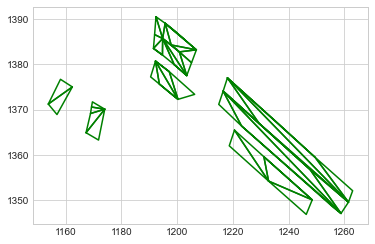

NOT VALID: POSITION
VALID:  False
position:  (1179.1561929860504 @ 1139.3513739716623)


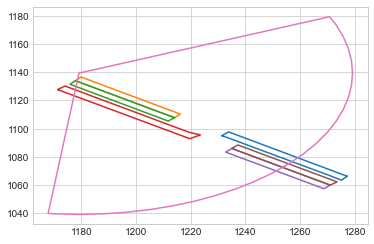

in Options class, polygonalRegions:  [<shapely.geometry.polygon.Polygon object at 0x248f88eb0>, <shapely.geometry.polygon.Polygon object at 0x263654640>, <shapely.geometry.polygon.Polygon object at 0x26365a250>, <shapely.geometry.polygon.Polygon object at 0x2c48e5c40>, <shapely.geometry.polygon.Polygon object at 0x2c5251070>, <shapely.geometry.polygon.Polygon object at 0x2c5251a60>]


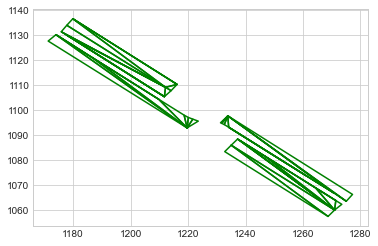

NOT VALID: POSITION
VALID:  False
position:  (759.9255446942661 @ 1515.0311169441816)


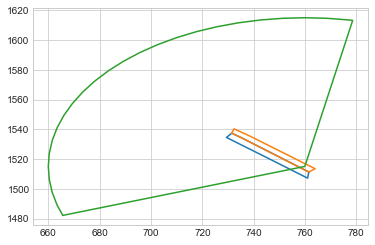

in Options class, polygonalRegions:  [<shapely.geometry.polygon.Polygon object at 0x2454b9a60>, <shapely.geometry.polygon.Polygon object at 0x2454c2670>]


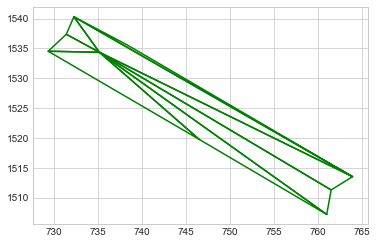

NOT VALID: POSITION
VALID:  False
position:  (1935.185378853655 @ 1048.431021801274)


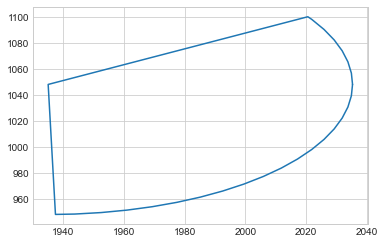

NOT VALID: POSITION
VALID:  False
position:  (756.0720788947183 @ 560.4010091952738)


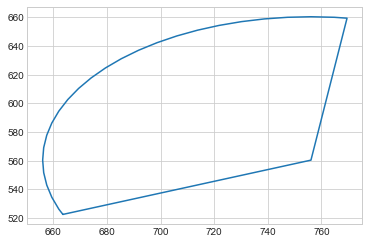

NOT VALID: POSITION
VALID:  False
position:  (1931.639465856277 @ 871.7137651931201)


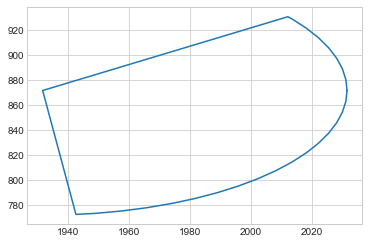

NOT VALID: POSITION
VALID:  False
position:  (2526.2176508746275 @ 836.6885363965272)


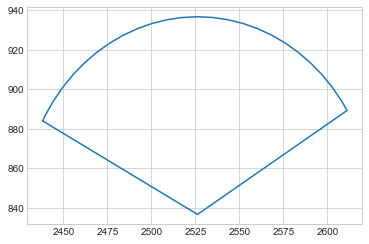

NOT VALID: POSITION
VALID:  False
position:  (756.7676234067087 @ 1517.868232249397)


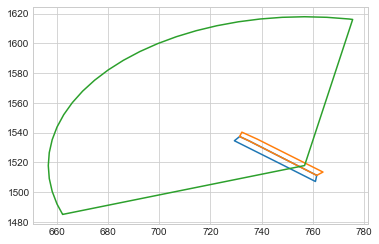

in Options class, polygonalRegions:  [<shapely.geometry.polygon.Polygon object at 0x2454b9a60>, <shapely.geometry.polygon.Polygon object at 0x2454c2670>]


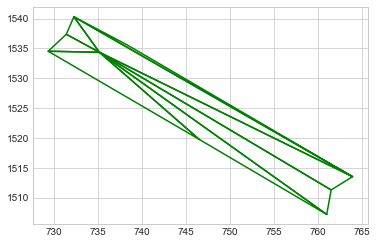

NOT VALID: POSITION
VALID:  False
position:  (2009.2117187043284 @ 1233.3068965733044)


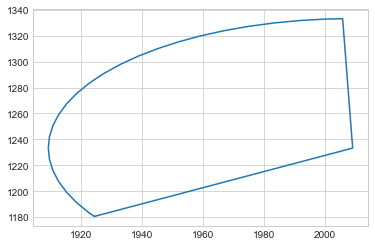

NOT VALID: POSITION
VALID:  False
position:  (2106.4799776726513 @ 934.3413249213856)


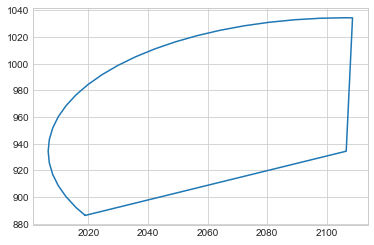

NOT VALID: POSITION
VALID:  False
position:  (1011.7975274625096 @ 1258.2914948340442)


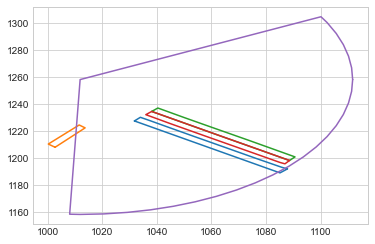

in Options class, polygonalRegions:  [<shapely.geometry.polygon.Polygon object at 0x247e11bb0>, <shapely.geometry.polygon.Polygon object at 0x248fc9d90>, <shapely.geometry.polygon.Polygon object at 0x2c3ccb3a0>, <shapely.geometry.polygon.Polygon object at 0x2c3ccbfd0>]


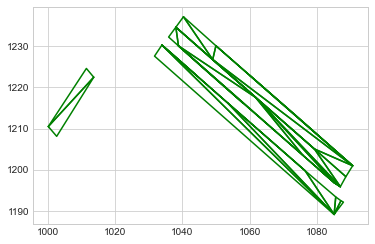

NOT VALID: POSITION
VALID:  False
position:  (1872.2285243461092 @ 785.4949798500975)


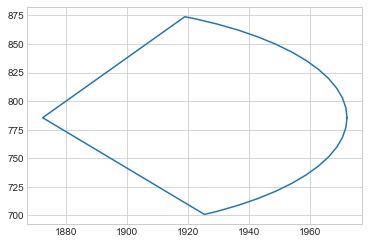

NOT VALID: POSITION
VALID:  False
position:  (1666.2810698850549 @ 1258.654102323938)


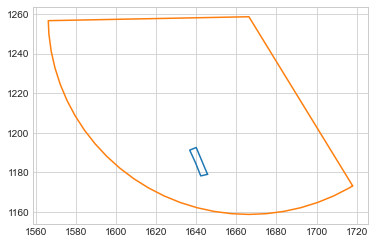

in Options class, polygonalRegions:  [<shapely.geometry.polygon.Polygon object at 0x2c437ccd0>]


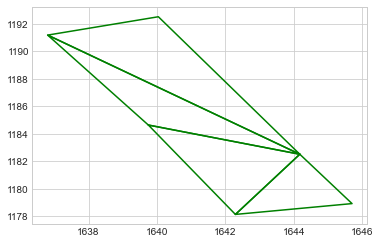

NOT VALID: POSITION
VALID:  False
position:  (2396.40618833583 @ 880.4746928318666)


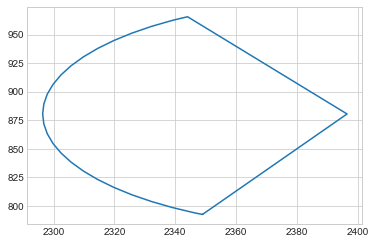

NOT VALID: POSITION
VALID:  False
position:  (517.9063800696704 @ 1566.6871953542914)


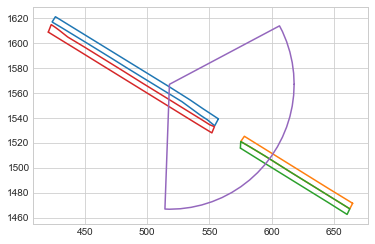

in Options class, polygonalRegions:  [<shapely.geometry.polygon.Polygon object at 0x24945ae20>, <shapely.geometry.polygon.Polygon object at 0x2c4f71be0>, <shapely.geometry.polygon.Polygon object at 0x2c4f7d910>, <shapely.geometry.polygon.Polygon object at 0x2c5cff4c0>]


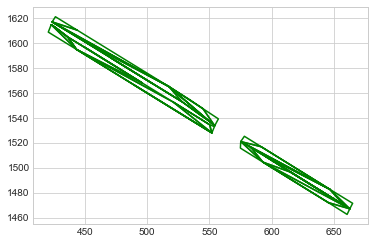

position is valid
heading:  4.152784083903149
within get_traffic_flow
point:  (517.9063800696704 @ 1566.6871953542914)
heading output =  4.157322004217218
heading is valid
position:  (508.313 @ 1567.893)
NOT VALID: POSITION
position:  (517.9063800696704 @ 1566.6871953542914)
NOT VALID: POSITION
position:  (487.396 @ 1570.754)
NOT VALID: POSITION
position:  (517.9063800696704 @ 1566.6871953542914)
NOT VALID: POSITION
position:  (485.544 @ 1567.619)
NOT VALID: POSITION
position:  (517.9063800696704 @ 1566.6871953542914)
NOT VALID: POSITION
position:  (485.544 @ 1567.619)
NOT VALID: POSITION
position:  (517.9063800696704 @ 1566.6871953542914)
NOT VALID: POSITION
position:  (508.313 @ 1567.893)
NOT VALID: POSITION
position:  (517.9063800696704 @ 1566.6871953542914)
NOT VALID: POSITION
position:  (487.396 @ 1570.754)
NOT VALID: POSITION
position:  (517.9063800696704 @ 1566.6871953542914)
NOT VALID: POSITION
within get_traffic_flow
point:  (170.11179269271085 @ 1766.6547807604388)
heading ou

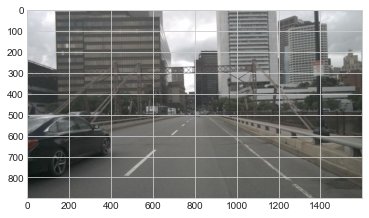

position:  (802.2599712606977 @ 520.6821905042405)


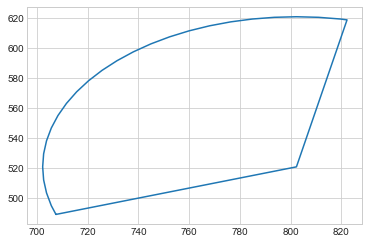

NOT VALID: POSITION
VALID:  False
position:  (2137.5843280145973 @ 918.323498035495)


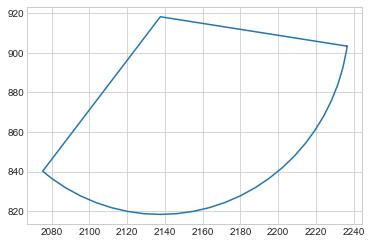

NOT VALID: POSITION
VALID:  False
position:  (759.9238520578369 @ 1515.02914936668)


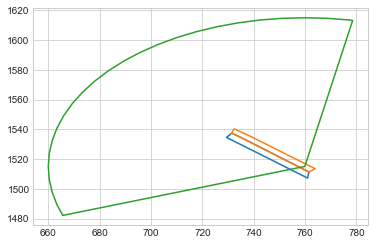

in Options class, polygonalRegions:  [<shapely.geometry.polygon.Polygon object at 0x2454b9a60>, <shapely.geometry.polygon.Polygon object at 0x2454c2670>]


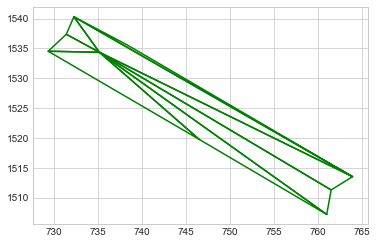

position is valid
heading:  0.8595609931496073
within get_traffic_flow
point:  (759.9238520578369 @ 1515.02914936668)
heading output =  0.8619605002069616
heading is valid
position:  (761.545 @ 1508.955)
NOT VALID: POSITION
position:  (759.9238520578369 @ 1515.02914936668)
NOT VALID: POSITION
position:  (793.527 @ 1503.259)
NOT VALID: POSITION
position:  (759.9238520578369 @ 1515.02914936668)
NOT VALID: POSITION
within get_traffic_flow
point:  (731.5529973077875 @ 1534.813215800339)
heading output =  0.8567470729277984
within get_traffic_flow
point:  (753.2892041395065 @ 1510.5738103592062)
heading output =  0.8551732586562254
VALID:  True


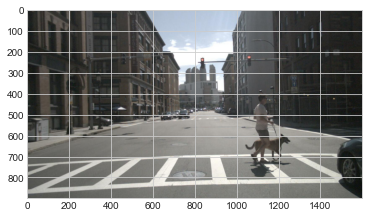

position:  (608.1523804386161 @ 695.1325161978971)


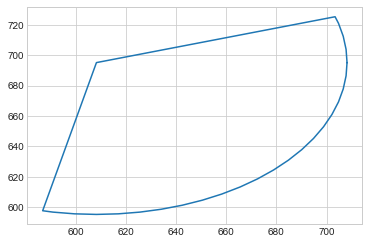

NOT VALID: POSITION
VALID:  False
position:  (2092.358262363719 @ 943.5151946142925)


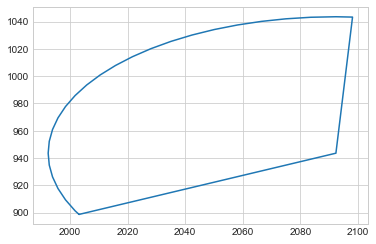

NOT VALID: POSITION
VALID:  False
position:  (1236.999480573219 @ 963.1046266868175)


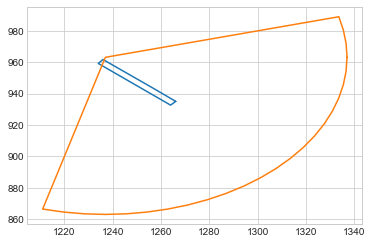

in Options class, polygonalRegions:  [<shapely.geometry.polygon.Polygon object at 0x2c5b37a90>]


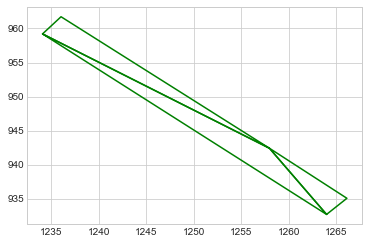

NOT VALID: POSITION
VALID:  False
position:  (1937.4599039461305 @ 840.9824375163728)


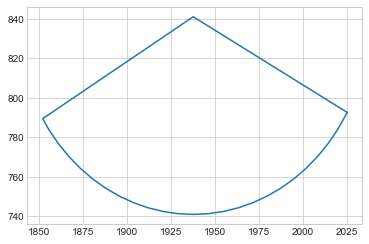

NOT VALID: POSITION
VALID:  False
position:  (309.1878574546422 @ 668.6677241101553)


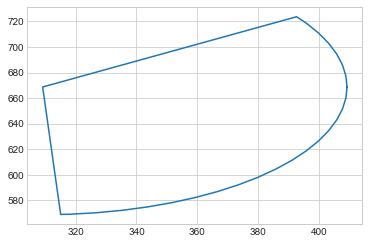

NOT VALID: POSITION
VALID:  False
position:  (418.75484788973563 @ 1629.018677847895)


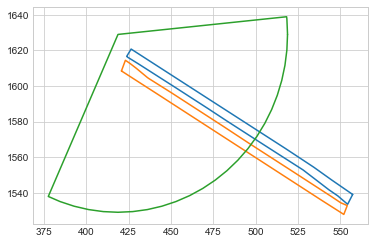

in Options class, polygonalRegions:  [<shapely.geometry.polygon.Polygon object at 0x24945ae20>, <shapely.geometry.polygon.Polygon object at 0x2c5cff4c0>]


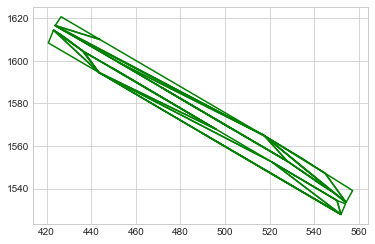

NOT VALID: POSITION
VALID:  False
position:  (1239.4874857263171 @ 960.7220548618243)


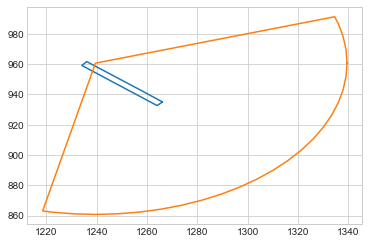

in Options class, polygonalRegions:  [<shapely.geometry.polygon.Polygon object at 0x2c5b37a90>]


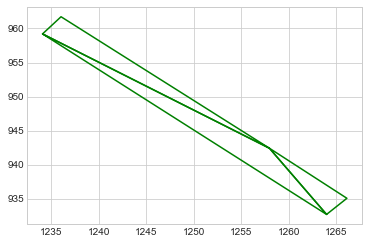

NOT VALID: POSITION
VALID:  False
position:  (1855.4205651838038 @ 785.1121729125862)


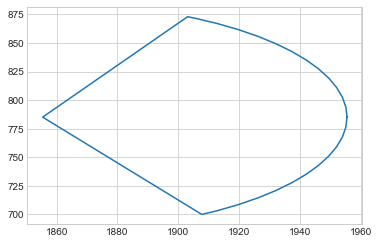

NOT VALID: POSITION
VALID:  False
position:  (1315.9192452862442 @ 1038.8523504379377)


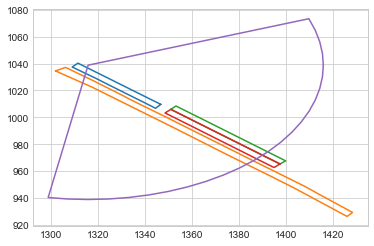

in Options class, polygonalRegions:  [<shapely.geometry.polygon.Polygon object at 0x2c4a4ceb0>, <shapely.geometry.polygon.Polygon object at 0x2c506e2b0>, <shapely.geometry.polygon.Polygon object at 0x2c5a697f0>, <shapely.geometry.polygon.Polygon object at 0x2c5a744c0>]


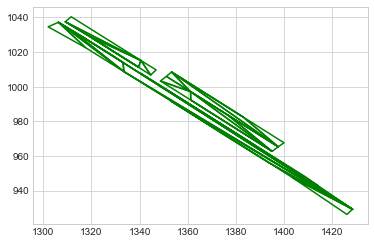

NOT VALID: POSITION
VALID:  False
position:  (1539.3833636503118 @ 1318.5724902150828)


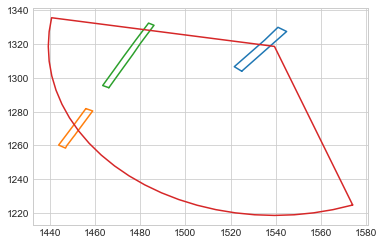

in Options class, polygonalRegions:  [<shapely.geometry.polygon.Polygon object at 0x2c475ae80>, <shapely.geometry.polygon.Polygon object at 0x2c54dabe0>, <shapely.geometry.polygon.Polygon object at 0x2c5b8e700>]


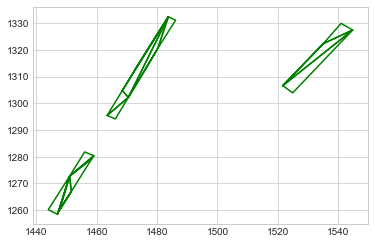

NOT VALID: POSITION
VALID:  False
position:  (520.5266103428576 @ 1565.4430193655908)


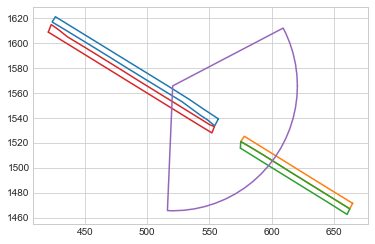

in Options class, polygonalRegions:  [<shapely.geometry.polygon.Polygon object at 0x24945ae20>, <shapely.geometry.polygon.Polygon object at 0x2c4f71be0>, <shapely.geometry.polygon.Polygon object at 0x2c4f7d910>, <shapely.geometry.polygon.Polygon object at 0x2c5cff4c0>]


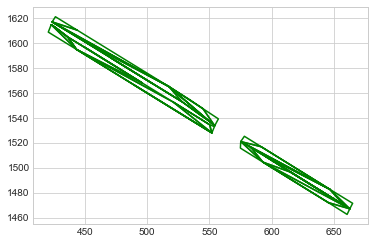

NOT VALID: POSITION
VALID:  False
position:  (1459.5228404181348 @ 913.8915932646929)


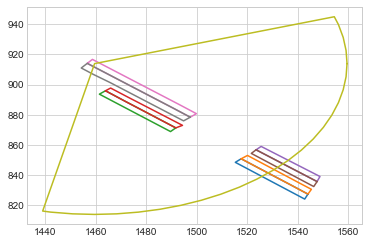

in Options class, polygonalRegions:  [<shapely.geometry.polygon.Polygon object at 0x248cee370>, <shapely.geometry.polygon.Polygon object at 0x248ceee80>, <shapely.geometry.polygon.Polygon object at 0x2c48543d0>, <shapely.geometry.polygon.Polygon object at 0x2c4854ee0>, <shapely.geometry.polygon.Polygon object at 0x2c51927c0>, <shapely.geometry.polygon.Polygon object at 0x2c519b1f0>, <shapely.geometry.polygon.Polygon object at 0x2c5c55970>, <shapely.geometry.polygon.Polygon object at 0x2c5c5d580>]


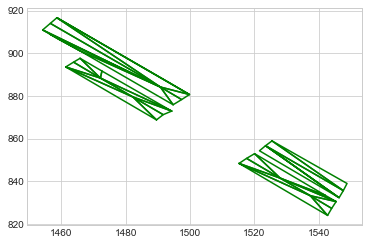

NOT VALID: POSITION
VALID:  False
position:  (1358.9121283675536 @ 1133.214437835295)


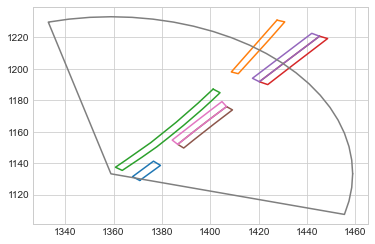

in Options class, polygonalRegions:  [<shapely.geometry.polygon.Polygon object at 0x24510fb80>, <shapely.geometry.polygon.Polygon object at 0x2499916a0>, <shapely.geometry.polygon.Polygon object at 0x2c5099d90>, <shapely.geometry.polygon.Polygon object at 0x2c50c1cd0>, <shapely.geometry.polygon.Polygon object at 0x2c50c98e0>, <shapely.geometry.polygon.Polygon object at 0x2c59e6d60>, <shapely.geometry.polygon.Polygon object at 0x2c59f1a30>]


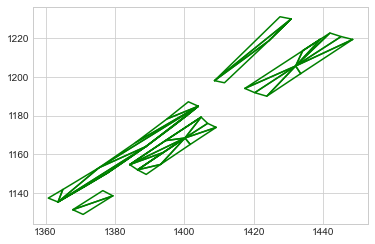

NOT VALID: POSITION
VALID:  False
position:  (395.3953265088744 @ 640.3329500663758)


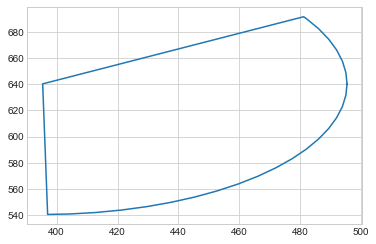

NOT VALID: POSITION
VALID:  False
position:  (821.2034594713105 @ 380.6765984627548)


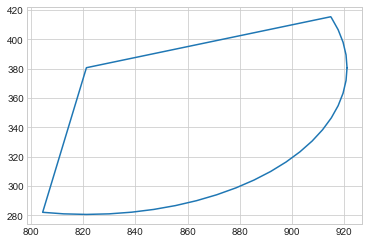

NOT VALID: POSITION
VALID:  False
position:  (1803.9549669384921 @ 1181.0275037132858)


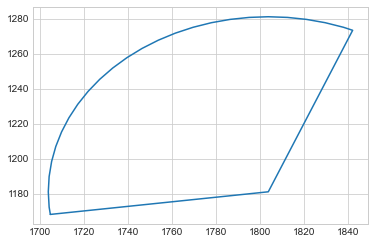

NOT VALID: POSITION
VALID:  False
position:  (1728.743396966841 @ 786.4346395114725)


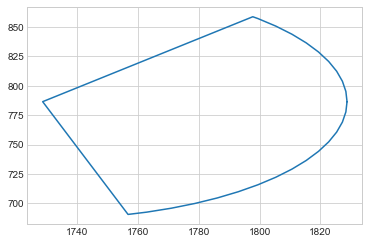

NOT VALID: POSITION
VALID:  False
position:  (1274.3505875524404 @ 921.0118850833929)


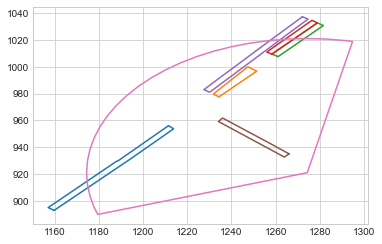

in Options class, polygonalRegions:  [<shapely.geometry.polygon.Polygon object at 0x24566e610>, <shapely.geometry.polygon.Polygon object at 0x263856160>, <shapely.geometry.polygon.Polygon object at 0x2c477a8e0>, <shapely.geometry.polygon.Polygon object at 0x2c47834f0>, <shapely.geometry.polygon.Polygon object at 0x2c594c370>, <shapely.geometry.polygon.Polygon object at 0x2c5b37a90>]


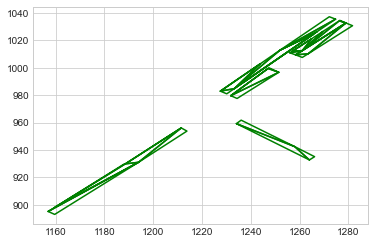

NOT VALID: POSITION
VALID:  False
position:  (1185.1335336887353 @ 1134.8982127976055)


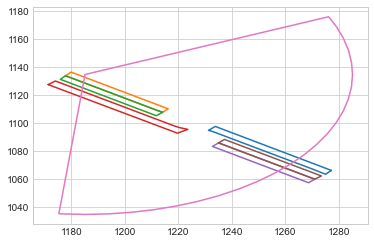

in Options class, polygonalRegions:  [<shapely.geometry.polygon.Polygon object at 0x248f88eb0>, <shapely.geometry.polygon.Polygon object at 0x263654640>, <shapely.geometry.polygon.Polygon object at 0x26365a250>, <shapely.geometry.polygon.Polygon object at 0x2c48e5c40>, <shapely.geometry.polygon.Polygon object at 0x2c5251070>, <shapely.geometry.polygon.Polygon object at 0x2c5251a60>]


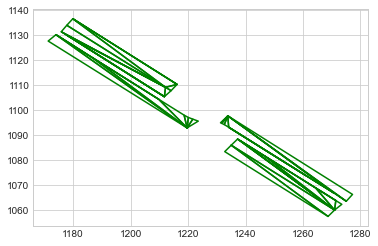

NOT VALID: POSITION
VALID:  False
position:  (2108.9619199514896 @ 933.1005645970067)


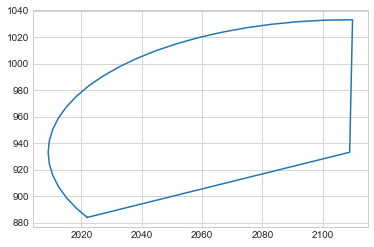

NOT VALID: POSITION
VALID:  False
position:  (1301.2033545802615 @ 896.0731308826149)


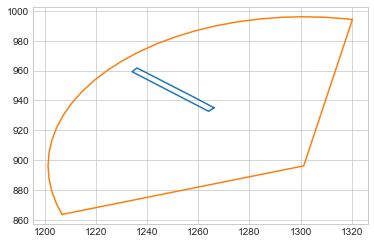

in Options class, polygonalRegions:  [<shapely.geometry.polygon.Polygon object at 0x2c5b37a90>]


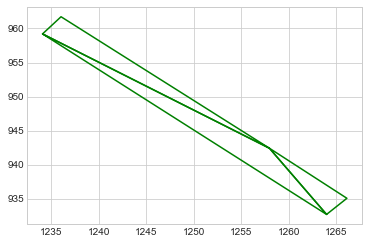

NOT VALID: POSITION
VALID:  False
position:  (1416.337863637986 @ 1256.417657485049)


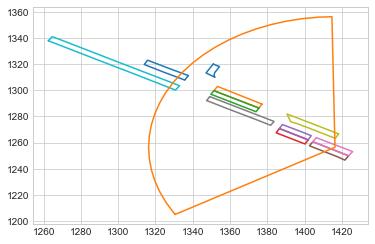

in Options class, polygonalRegions:  [<shapely.geometry.polygon.Polygon object at 0x2450fa160>, <shapely.geometry.polygon.Polygon object at 0x2452b2d90>, <shapely.geometry.polygon.Polygon object at 0x2452b97c0>, <shapely.geometry.polygon.Polygon object at 0x248f2de50>, <shapely.geometry.polygon.Polygon object at 0x248f36880>, <shapely.geometry.polygon.Polygon object at 0x249525a30>, <shapely.geometry.polygon.Polygon object at 0x249530640>, <shapely.geometry.polygon.Polygon object at 0x2c53ac730>, <shapely.geometry.polygon.Polygon object at 0x2c540dd60>, <shapely.geometry.polygon.Polygon object at 0x2c55fe0d0>, <shapely.geometry.polygon.Polygon object at 0x2c5896580>]


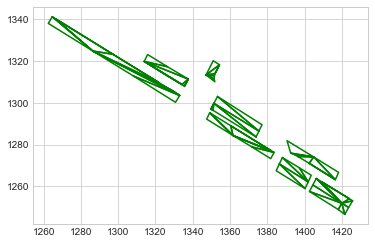

NOT VALID: POSITION
VALID:  False
position:  (1187.1068948998523 @ 1407.1881516692815)


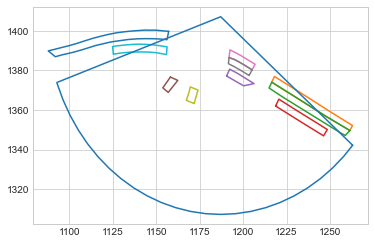

in Options class, polygonalRegions:  [<shapely.geometry.polygon.Polygon object at 0x244c5b880>, <shapely.geometry.polygon.Polygon object at 0x248daa6d0>, <shapely.geometry.polygon.Polygon object at 0x248db33a0>, <shapely.geometry.polygon.Polygon object at 0x24941ee20>, <shapely.geometry.polygon.Polygon object at 0x2638910a0>, <shapely.geometry.polygon.Polygon object at 0x2c4a6cbe0>, <shapely.geometry.polygon.Polygon object at 0x2c4b24a00>, <shapely.geometry.polygon.Polygon object at 0x2c4b31670>, <shapely.geometry.polygon.Polygon object at 0x2c51e5d90>, <shapely.geometry.polygon.Polygon object at 0x2c5361310>]


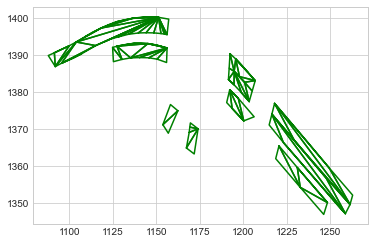

NOT VALID: POSITION
VALID:  False
position:  (766.5205425223749 @ 423.6630287396556)


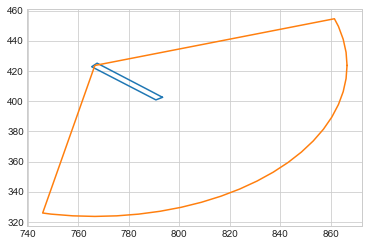

in Options class, polygonalRegions:  [<shapely.geometry.polygon.Polygon object at 0x248241550>]


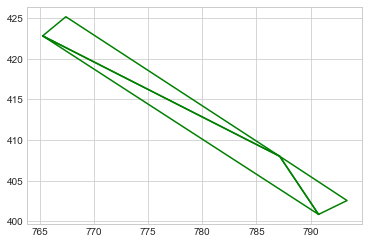

NOT VALID: POSITION
VALID:  False
position:  (1937.420570958885 @ 856.8901934143842)


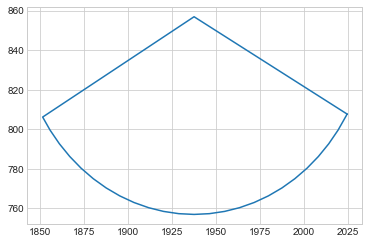

NOT VALID: POSITION
VALID:  False
position:  (1539.383383023878 @ 1318.5724727858792)


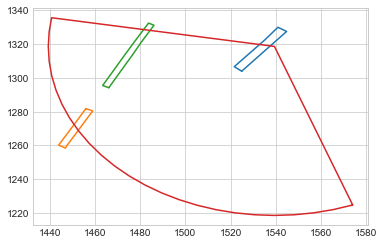

in Options class, polygonalRegions:  [<shapely.geometry.polygon.Polygon object at 0x2c475ae80>, <shapely.geometry.polygon.Polygon object at 0x2c54dabe0>, <shapely.geometry.polygon.Polygon object at 0x2c5b8e700>]


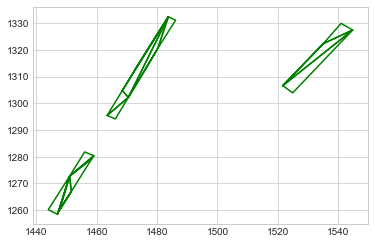

NOT VALID: POSITION
VALID:  False
position:  (1361.1834981912311 @ 1135.485146167524)


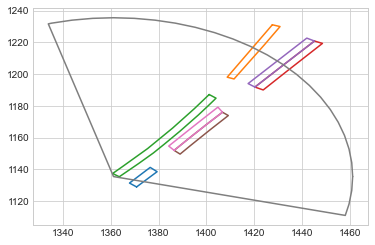

in Options class, polygonalRegions:  [<shapely.geometry.polygon.Polygon object at 0x24510fb80>, <shapely.geometry.polygon.Polygon object at 0x2499916a0>, <shapely.geometry.polygon.Polygon object at 0x2c5099d90>, <shapely.geometry.polygon.Polygon object at 0x2c50c1cd0>, <shapely.geometry.polygon.Polygon object at 0x2c50c98e0>, <shapely.geometry.polygon.Polygon object at 0x2c59e6d60>, <shapely.geometry.polygon.Polygon object at 0x2c59f1a30>]


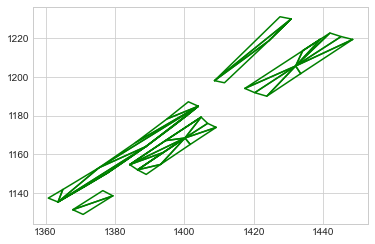

NOT VALID: POSITION
VALID:  False
position:  (1181.0169065835319 @ 1137.9529610187587)


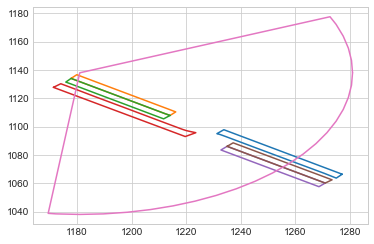

in Options class, polygonalRegions:  [<shapely.geometry.polygon.Polygon object at 0x248f88eb0>, <shapely.geometry.polygon.Polygon object at 0x263654640>, <shapely.geometry.polygon.Polygon object at 0x26365a250>, <shapely.geometry.polygon.Polygon object at 0x2c48e5c40>, <shapely.geometry.polygon.Polygon object at 0x2c5251070>, <shapely.geometry.polygon.Polygon object at 0x2c5251a60>]


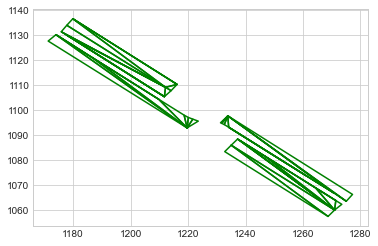

NOT VALID: POSITION
VALID:  False
position:  (2525.855080641583 @ 848.2604520305009)


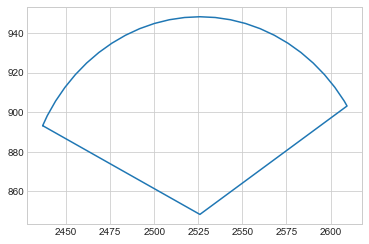

NOT VALID: POSITION
VALID:  False
position:  (1054.7032880932852 @ 1229.0900796384103)


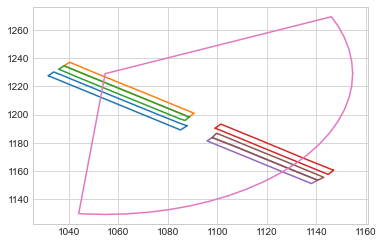

in Options class, polygonalRegions:  [<shapely.geometry.polygon.Polygon object at 0x247e11bb0>, <shapely.geometry.polygon.Polygon object at 0x2c3ccb3a0>, <shapely.geometry.polygon.Polygon object at 0x2c3ccbfd0>, <shapely.geometry.polygon.Polygon object at 0x2c3de77c0>, <shapely.geometry.polygon.Polygon object at 0x2c5bb1460>, <shapely.geometry.polygon.Polygon object at 0x2c5bbb130>]


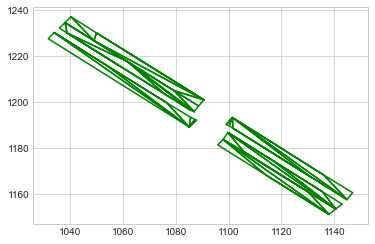

NOT VALID: POSITION
VALID:  False
position:  (1038.877997396713 @ 499.8602637387381)


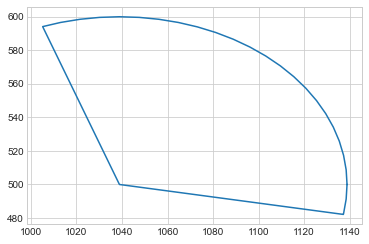

NOT VALID: POSITION
VALID:  False
position:  (1759.3453745842041 @ 1218.6266506531663)


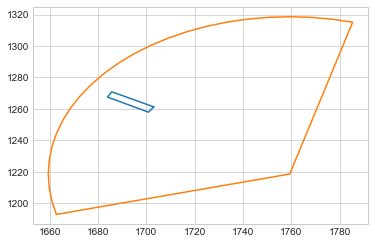

in Options class, polygonalRegions:  [<shapely.geometry.polygon.Polygon object at 0x2454fbcd0>]


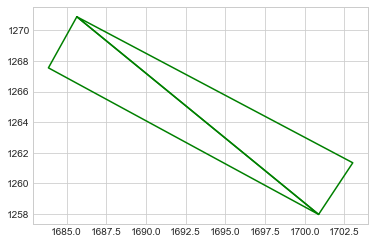

NOT VALID: POSITION
VALID:  False
position:  (1870.6835410126855 @ 1070.1250281421078)


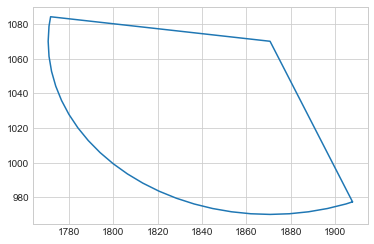

NOT VALID: POSITION
VALID:  False
position:  (1827.9576122466365 @ 1156.258004890797)


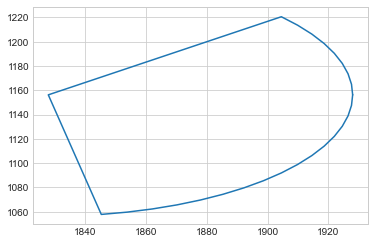

NOT VALID: POSITION
VALID:  False
position:  (1301.203356615184 @ 896.0731291057862)


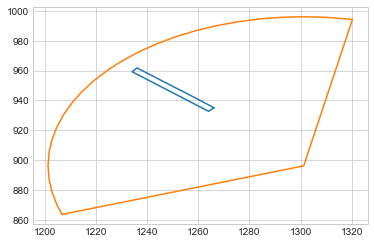

in Options class, polygonalRegions:  [<shapely.geometry.polygon.Polygon object at 0x2c5b37a90>]


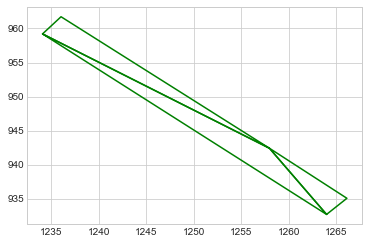

NOT VALID: POSITION
VALID:  False
position:  (780.5095744202974 @ 412.203370748654)


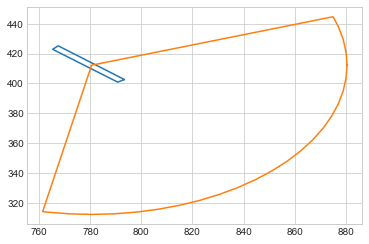

in Options class, polygonalRegions:  [<shapely.geometry.polygon.Polygon object at 0x248241550>]


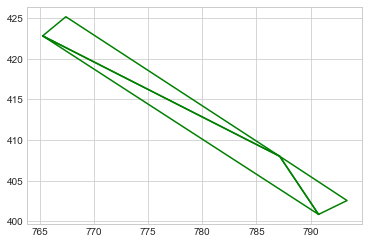

NOT VALID: POSITION
VALID:  False
position:  (2525.744827986816 @ 850.4451395150545)


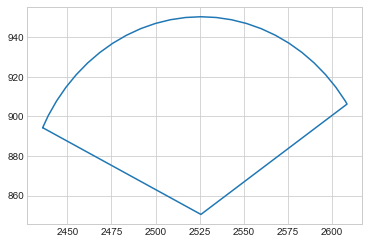

NOT VALID: POSITION
VALID:  False
position:  (1697.315842470744 @ 986.4959865921658)


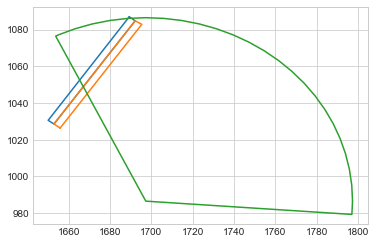

in Options class, polygonalRegions:  [<shapely.geometry.polygon.Polygon object at 0x2494924c0>, <shapely.geometry.polygon.Polygon object at 0x249492e50>]


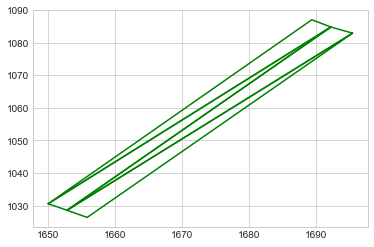

NOT VALID: POSITION
VALID:  False
position:  (1239.4853553076246 @ 960.719730594731)


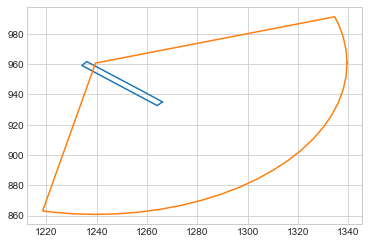

in Options class, polygonalRegions:  [<shapely.geometry.polygon.Polygon object at 0x2c5b37a90>]


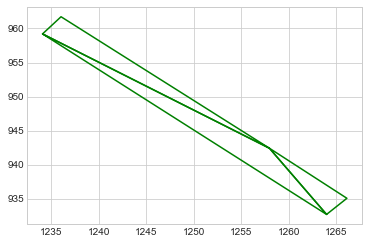

NOT VALID: POSITION
VALID:  False
position:  (806.5618960621982 @ 517.0248243872883)


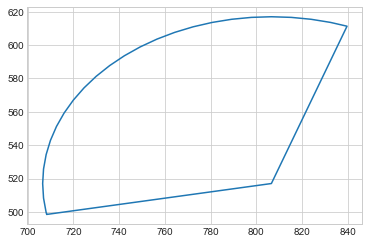

NOT VALID: POSITION
VALID:  False
position:  (1301.203353936291 @ 896.0731314447222)


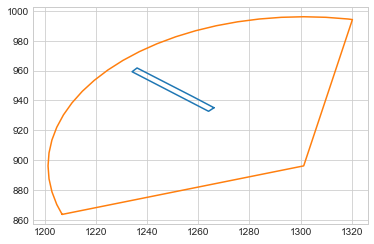

in Options class, polygonalRegions:  [<shapely.geometry.polygon.Polygon object at 0x2c5b37a90>]


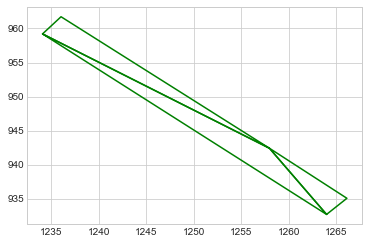

NOT VALID: POSITION
VALID:  False
position:  (608.7087419840968 @ 695.2600210894459)


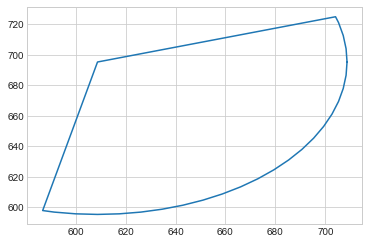

NOT VALID: POSITION
VALID:  False
position:  (420.078655829165 @ 1627.4322468426963)


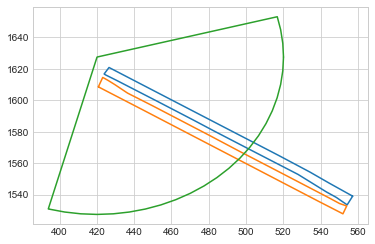

in Options class, polygonalRegions:  [<shapely.geometry.polygon.Polygon object at 0x24945ae20>, <shapely.geometry.polygon.Polygon object at 0x2c5cff4c0>]


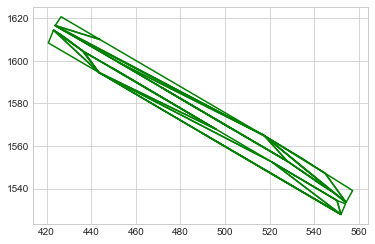

NOT VALID: POSITION
VALID:  False
position:  (2084.544805552579 @ 947.8097898273812)


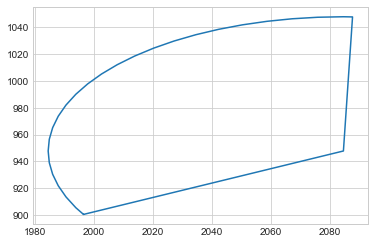

NOT VALID: POSITION
VALID:  False
position:  (1185.1334089446002 @ 1134.8980373536153)


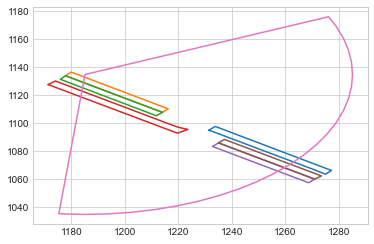

in Options class, polygonalRegions:  [<shapely.geometry.polygon.Polygon object at 0x248f88eb0>, <shapely.geometry.polygon.Polygon object at 0x263654640>, <shapely.geometry.polygon.Polygon object at 0x26365a250>, <shapely.geometry.polygon.Polygon object at 0x2c48e5c40>, <shapely.geometry.polygon.Polygon object at 0x2c5251070>, <shapely.geometry.polygon.Polygon object at 0x2c5251a60>]


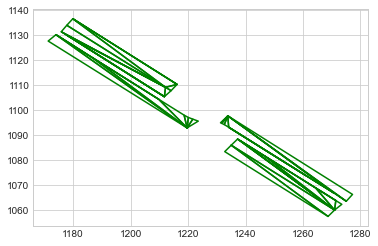

NOT VALID: POSITION
VALID:  False
position:  (1824.344129036685 @ 1167.4307304745168)


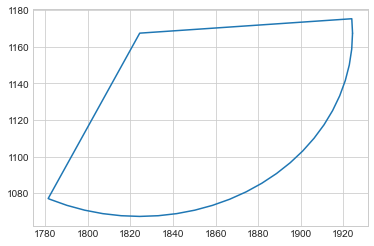

NOT VALID: POSITION
VALID:  False
position:  (1185.1334786870411 @ 1134.8981405656893)


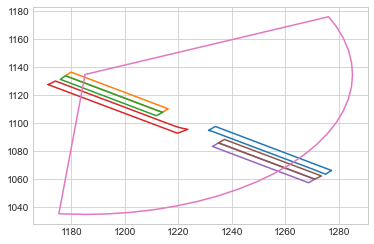

in Options class, polygonalRegions:  [<shapely.geometry.polygon.Polygon object at 0x248f88eb0>, <shapely.geometry.polygon.Polygon object at 0x263654640>, <shapely.geometry.polygon.Polygon object at 0x26365a250>, <shapely.geometry.polygon.Polygon object at 0x2c48e5c40>, <shapely.geometry.polygon.Polygon object at 0x2c5251070>, <shapely.geometry.polygon.Polygon object at 0x2c5251a60>]


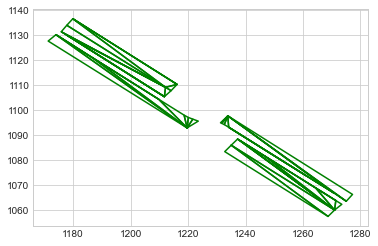

NOT VALID: POSITION
VALID:  False
position:  (1889.1019700239317 @ 1076.9864557407132)


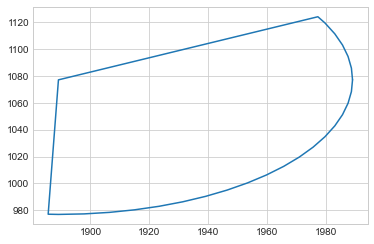

NOT VALID: POSITION
VALID:  False
position:  (1492.4889985384868 @ 1359.9865007688904)


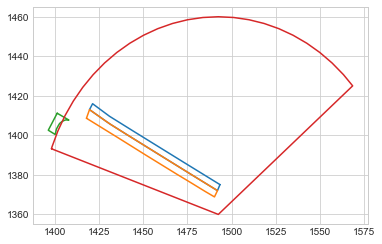

in Options class, polygonalRegions:  [<shapely.geometry.polygon.Polygon object at 0x2c58f6370>, <shapely.geometry.polygon.Polygon object at 0x2c5904040>, <shapely.geometry.polygon.Polygon object at 0x2c669fa90>]


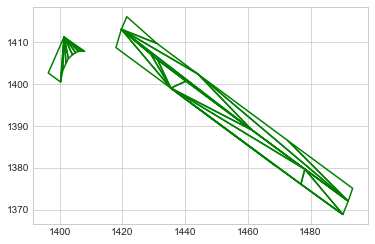

NOT VALID: POSITION
VALID:  False
position:  (589.7972787881017 @ 707.1566618111644)


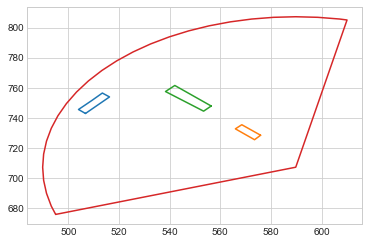

in Options class, polygonalRegions:  [<shapely.geometry.polygon.Polygon object at 0x248b8e610>, <shapely.geometry.polygon.Polygon object at 0x2c40d8400>, <shapely.geometry.polygon.Polygon object at 0x2c47d9370>]


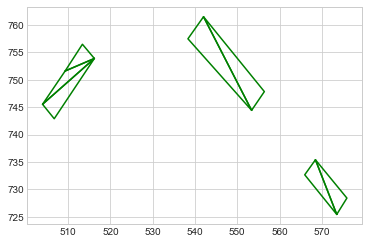

NOT VALID: POSITION
VALID:  False
position:  (1500.9200692917932 @ 1360.297027401392)


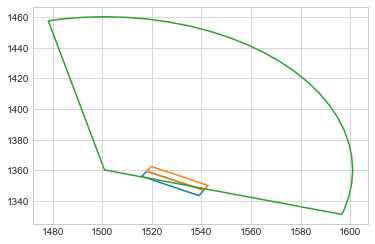

in Options class, polygonalRegions:  [<shapely.geometry.polygon.Polygon object at 0x2481edc40>, <shapely.geometry.polygon.Polygon object at 0x2481f7730>]


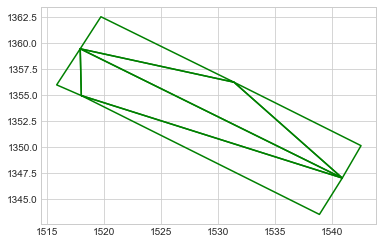

NOT VALID: POSITION
VALID:  False
position:  (451.862181648944 @ 1713.4454333967496)


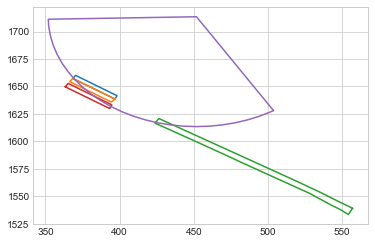

in Options class, polygonalRegions:  [<shapely.geometry.polygon.Polygon object at 0x248d0baf0>, <shapely.geometry.polygon.Polygon object at 0x248d12520>, <shapely.geometry.polygon.Polygon object at 0x24945ae20>, <shapely.geometry.polygon.Polygon object at 0x2c50ed880>]


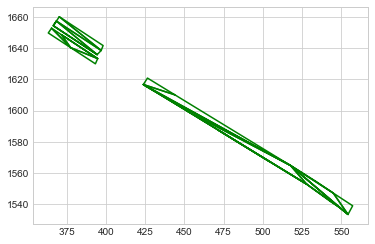

NOT VALID: POSITION
VALID:  False
position:  (1546.0777305374072 @ 1332.4140983440857)


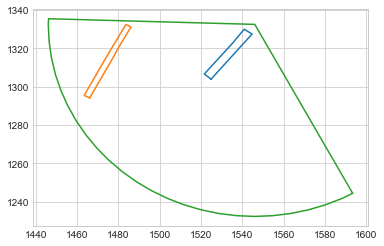

in Options class, polygonalRegions:  [<shapely.geometry.polygon.Polygon object at 0x2c475ae80>, <shapely.geometry.polygon.Polygon object at 0x2c5b8e700>]


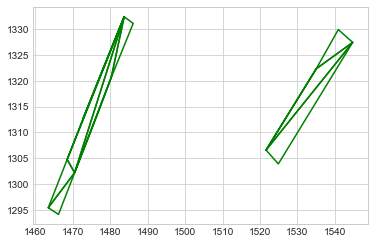

NOT VALID: POSITION
VALID:  False
position:  (1100.9672431473314 @ 1509.3049756433038)


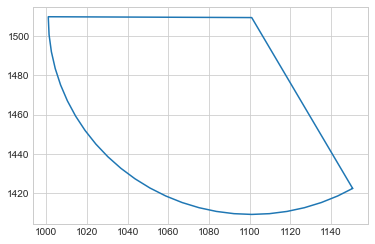

NOT VALID: POSITION
VALID:  False
position:  (531.620963829587 @ 1685.0368447088674)


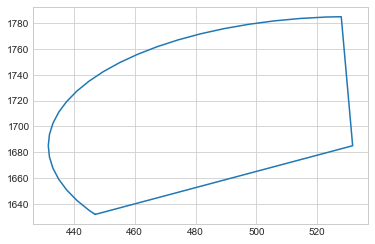

NOT VALID: POSITION
VALID:  False
position:  (653.2402989170498 @ 655.5621511429883)


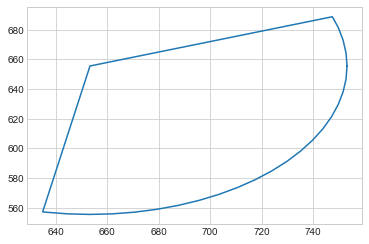

NOT VALID: POSITION
VALID:  False
position:  (1198.1936264425979 @ 1389.861765064312)


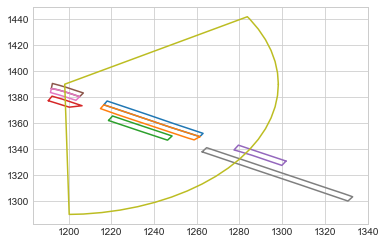

in Options class, polygonalRegions:  [<shapely.geometry.polygon.Polygon object at 0x248daa6d0>, <shapely.geometry.polygon.Polygon object at 0x248db33a0>, <shapely.geometry.polygon.Polygon object at 0x24941ee20>, <shapely.geometry.polygon.Polygon object at 0x2638910a0>, <shapely.geometry.polygon.Polygon object at 0x2640214c0>, <shapely.geometry.polygon.Polygon object at 0x2c4b24a00>, <shapely.geometry.polygon.Polygon object at 0x2c4b31670>, <shapely.geometry.polygon.Polygon object at 0x2c55fe0d0>]


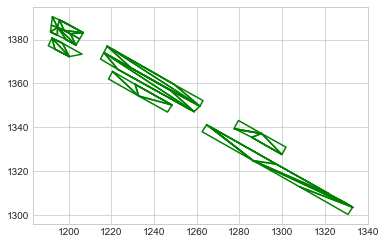

NOT VALID: POSITION
VALID:  False
position:  (752.5579082788613 @ 437.62653032275966)


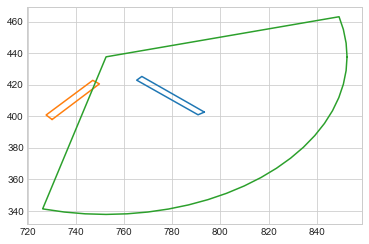

in Options class, polygonalRegions:  [<shapely.geometry.polygon.Polygon object at 0x248241550>, <shapely.geometry.polygon.Polygon object at 0x2497e7e50>]


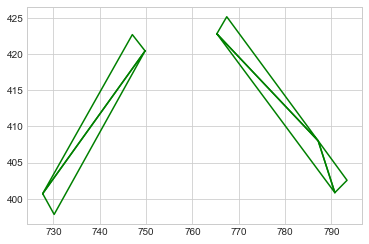

NOT VALID: POSITION
VALID:  False
position:  (1937.4083511954975 @ 858.0902988021252)


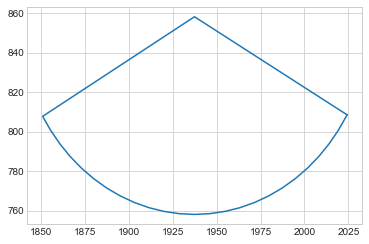

NOT VALID: POSITION
VALID:  False
position:  (1239.491128362747 @ 960.726058326671)


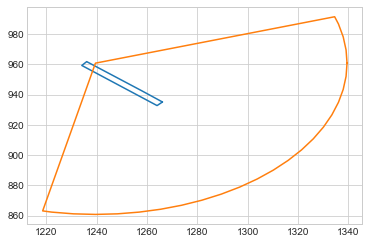

in Options class, polygonalRegions:  [<shapely.geometry.polygon.Polygon object at 0x2c5b37a90>]


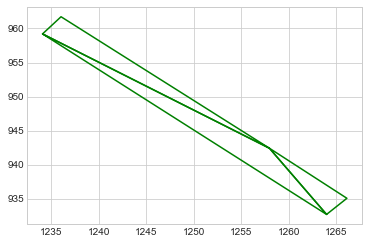

NOT VALID: POSITION
VALID:  False
position:  (1240.8602556864064 @ 951.0745490479918)


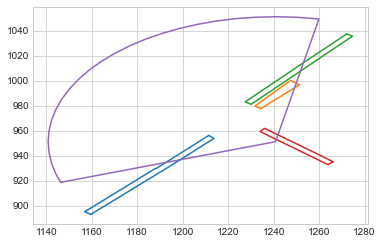

in Options class, polygonalRegions:  [<shapely.geometry.polygon.Polygon object at 0x24566e610>, <shapely.geometry.polygon.Polygon object at 0x263856160>, <shapely.geometry.polygon.Polygon object at 0x2c594c370>, <shapely.geometry.polygon.Polygon object at 0x2c5b37a90>]


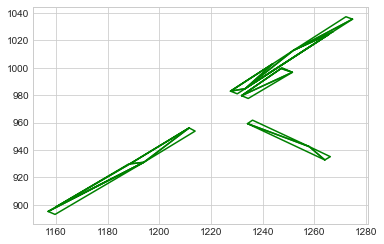

NOT VALID: POSITION
VALID:  False
position:  (1757.6071478878237 @ 1220.3323280966815)


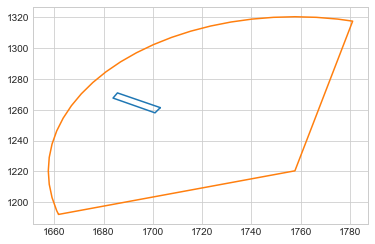

in Options class, polygonalRegions:  [<shapely.geometry.polygon.Polygon object at 0x2454fbcd0>]


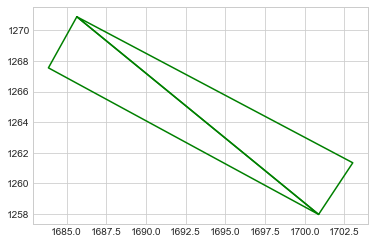

NOT VALID: POSITION
VALID:  False
position:  (1730.5911612868986 @ 890.95686011217)


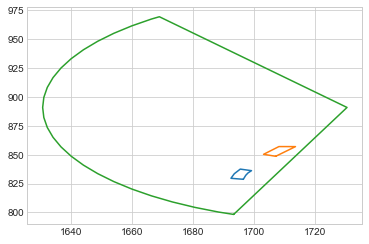

in Options class, polygonalRegions:  [<shapely.geometry.polygon.Polygon object at 0x2494b9a00>, <shapely.geometry.polygon.Polygon object at 0x2c214bdc0>]


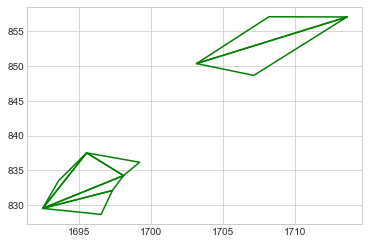

NOT VALID: POSITION
VALID:  False
position:  (1361.9506928027724 @ 1136.2693464463505)


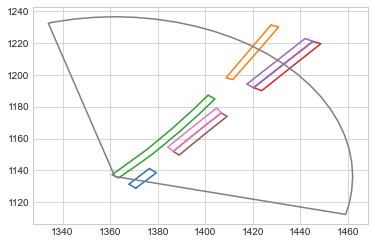

in Options class, polygonalRegions:  [<shapely.geometry.polygon.Polygon object at 0x24510fb80>, <shapely.geometry.polygon.Polygon object at 0x2499916a0>, <shapely.geometry.polygon.Polygon object at 0x2c5099d90>, <shapely.geometry.polygon.Polygon object at 0x2c50c1cd0>, <shapely.geometry.polygon.Polygon object at 0x2c50c98e0>, <shapely.geometry.polygon.Polygon object at 0x2c59e6d60>, <shapely.geometry.polygon.Polygon object at 0x2c59f1a30>]


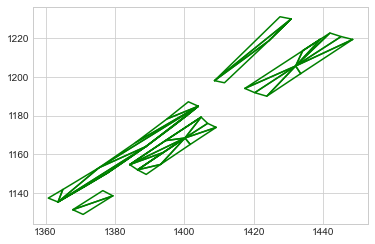

NOT VALID: POSITION
VALID:  False
position:  (1427.6669843126965 @ 941.1756994378768)


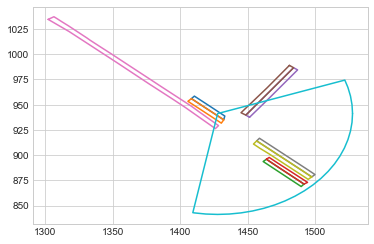

in Options class, polygonalRegions:  [<shapely.geometry.polygon.Polygon object at 0x244e8aeb0>, <shapely.geometry.polygon.Polygon object at 0x244e95a90>, <shapely.geometry.polygon.Polygon object at 0x2c48543d0>, <shapely.geometry.polygon.Polygon object at 0x2c4854ee0>, <shapely.geometry.polygon.Polygon object at 0x2c4c25910>, <shapely.geometry.polygon.Polygon object at 0x2c4c2e400>, <shapely.geometry.polygon.Polygon object at 0x2c506e2b0>, <shapely.geometry.polygon.Polygon object at 0x2c5c55970>, <shapely.geometry.polygon.Polygon object at 0x2c5c5d580>]


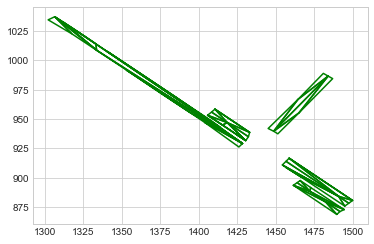

NOT VALID: POSITION
VALID:  False
position:  (1539.3833855597811 @ 1318.5724707618292)


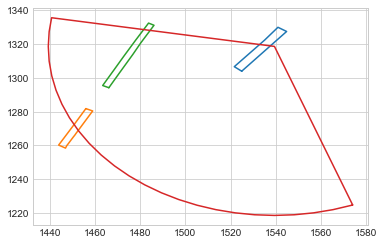

in Options class, polygonalRegions:  [<shapely.geometry.polygon.Polygon object at 0x2c475ae80>, <shapely.geometry.polygon.Polygon object at 0x2c54dabe0>, <shapely.geometry.polygon.Polygon object at 0x2c5b8e700>]


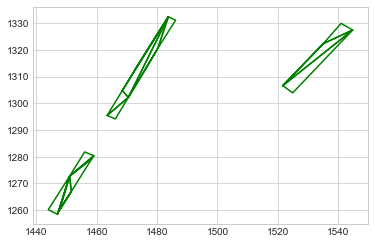

NOT VALID: POSITION
VALID:  False
position:  (1937.416710179357 @ 857.2719755901244)


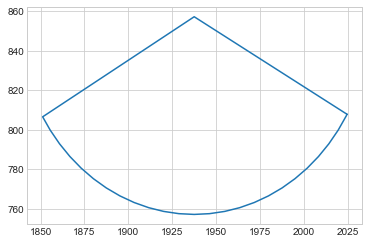

NOT VALID: POSITION
VALID:  False
position:  (1831.074566902132 @ 1154.5746238521497)


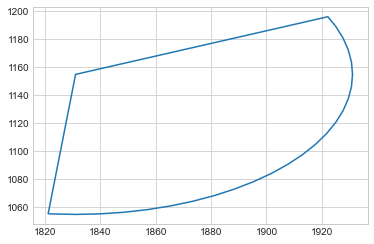

NOT VALID: POSITION
VALID:  False
position:  (802.6144270927787 @ 525.7000062875568)


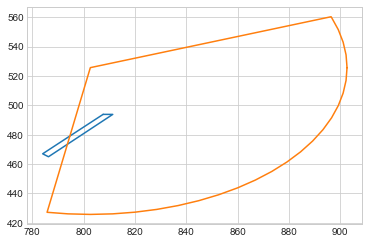

in Options class, polygonalRegions:  [<shapely.geometry.polygon.Polygon object at 0x263dce760>]


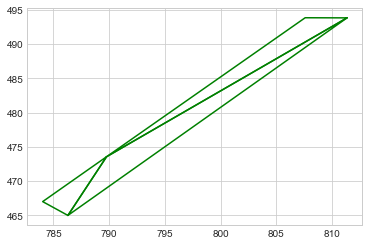

NOT VALID: POSITION
VALID:  False
position:  (1904.9192185604018 @ 1067.127504839688)


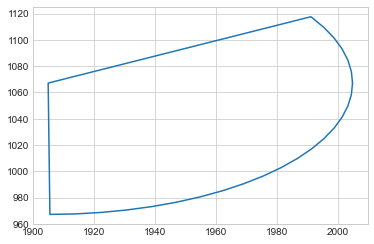

NOT VALID: POSITION
VALID:  False
position:  (1936.9061404554625 @ 865.2499819105255)


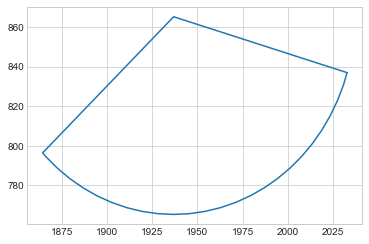

NOT VALID: POSITION
VALID:  False
position:  (1301.2033529328965 @ 896.0731323135022)


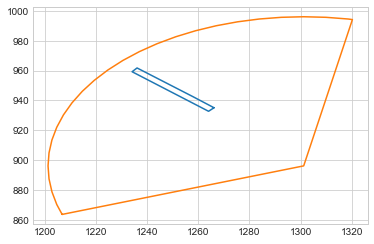

in Options class, polygonalRegions:  [<shapely.geometry.polygon.Polygon object at 0x2c5b37a90>]


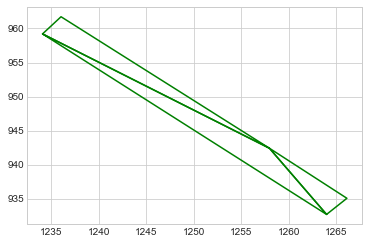

NOT VALID: POSITION
VALID:  False
position:  (1869.9171944721193 @ 1069.1541078320765)


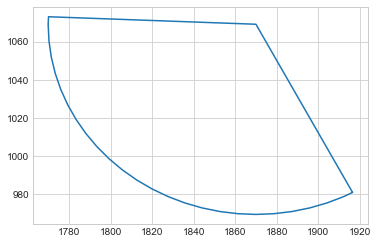

NOT VALID: POSITION
VALID:  False
position:  (2526.4433973880914 @ 825.4607728222265)


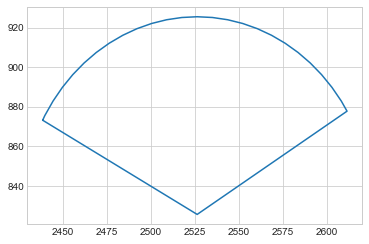

NOT VALID: POSITION
VALID:  False
position:  (1184.5859909173264 @ 1135.2921983321314)


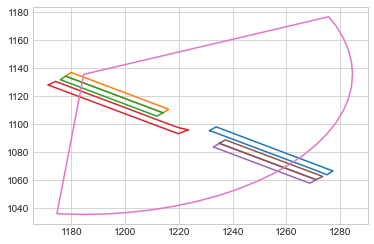

in Options class, polygonalRegions:  [<shapely.geometry.polygon.Polygon object at 0x248f88eb0>, <shapely.geometry.polygon.Polygon object at 0x263654640>, <shapely.geometry.polygon.Polygon object at 0x26365a250>, <shapely.geometry.polygon.Polygon object at 0x2c48e5c40>, <shapely.geometry.polygon.Polygon object at 0x2c5251070>, <shapely.geometry.polygon.Polygon object at 0x2c5251a60>]


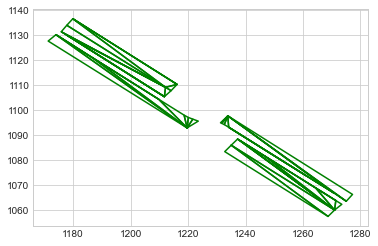

NOT VALID: POSITION
VALID:  False
position:  (2508.764333466254 @ 878.6792806979832)


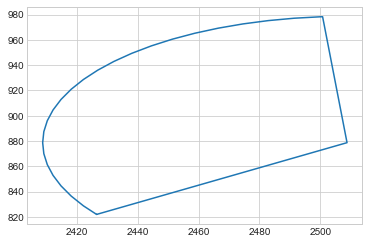

NOT VALID: POSITION
VALID:  False
position:  (2342.6623377936885 @ 878.7030325085138)


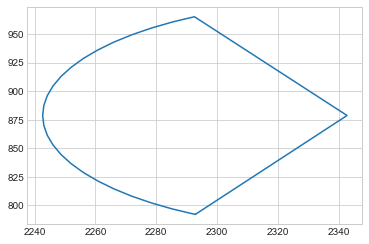

NOT VALID: POSITION
VALID:  False
position:  (599.0777046281166 @ 704.5400702377301)


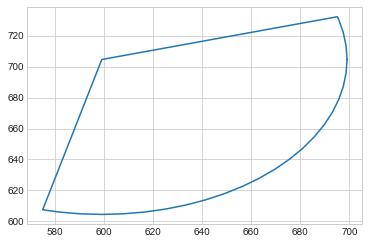

NOT VALID: POSITION
VALID:  False
position:  (1739.289155776657 @ 1234.3217000688178)


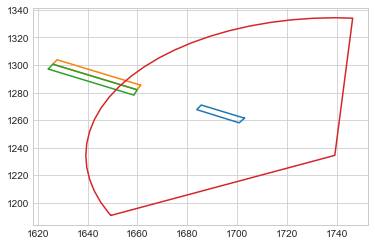

in Options class, polygonalRegions:  [<shapely.geometry.polygon.Polygon object at 0x2454fbcd0>, <shapely.geometry.polygon.Polygon object at 0x2480c9b50>, <shapely.geometry.polygon.Polygon object at 0x2480d2520>]


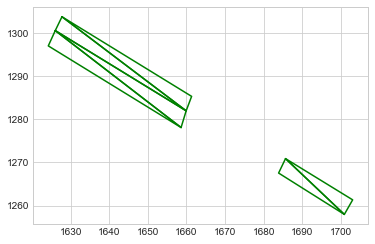

NOT VALID: POSITION
VALID:  False
position:  (540.1024829674452 @ 625.1385585231965)


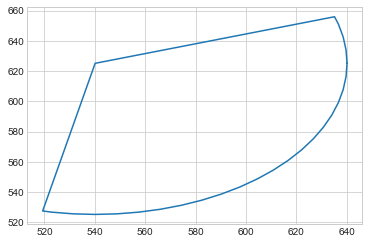

NOT VALID: POSITION
VALID:  False
position:  (746.1899034520604 @ 445.29545053668545)


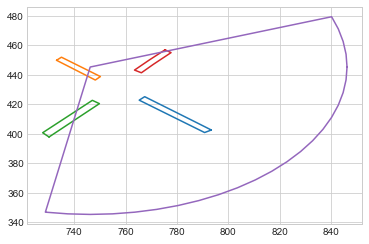

in Options class, polygonalRegions:  [<shapely.geometry.polygon.Polygon object at 0x248241550>, <shapely.geometry.polygon.Polygon object at 0x248c8cf10>, <shapely.geometry.polygon.Polygon object at 0x2497e7e50>, <shapely.geometry.polygon.Polygon object at 0x249b793a0>]


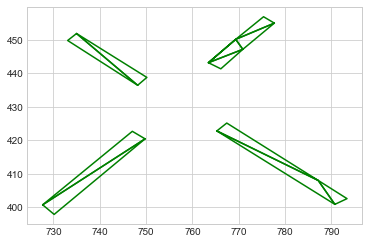

NOT VALID: POSITION
VALID:  False
position:  (1239.4767981921768 @ 960.7160060197789)


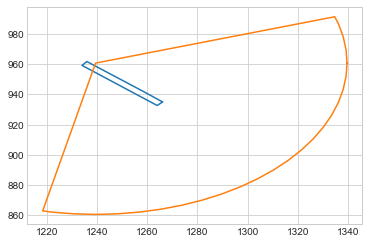

in Options class, polygonalRegions:  [<shapely.geometry.polygon.Polygon object at 0x2c5b37a90>]


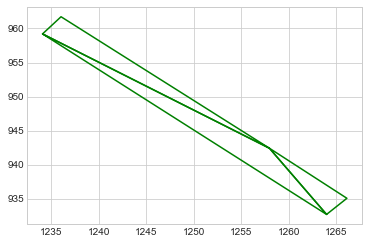

NOT VALID: POSITION
VALID:  False
position:  (1539.383357072185 @ 1318.5724948032682)


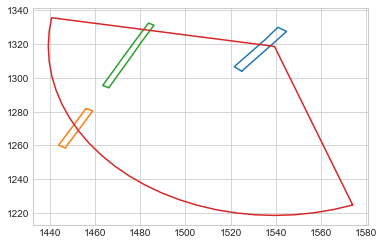

in Options class, polygonalRegions:  [<shapely.geometry.polygon.Polygon object at 0x2c475ae80>, <shapely.geometry.polygon.Polygon object at 0x2c54dabe0>, <shapely.geometry.polygon.Polygon object at 0x2c5b8e700>]


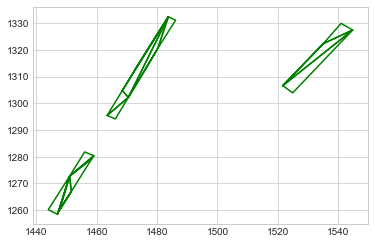

NOT VALID: POSITION
VALID:  False
position:  (783.0424967515855 @ 409.2975135726517)


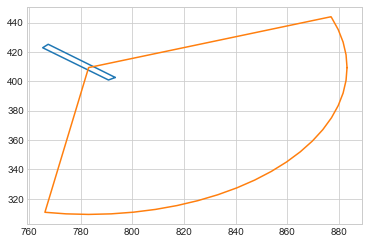

in Options class, polygonalRegions:  [<shapely.geometry.polygon.Polygon object at 0x248241550>]


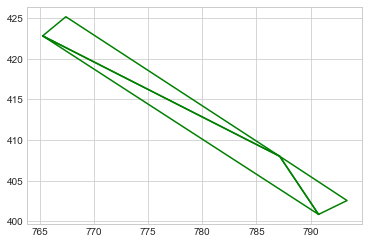

position is valid
heading:  4.018893552243286
within get_traffic_flow
point:  (783.0424967515855 @ 409.2975135726517)
heading output =  3.998104439752686
heading is valid
position:  (761.585 @ 444.27)
NOT VALID: POSITION
position:  (783.0424967515855 @ 409.2975135726517)
NOT VALID: POSITION
position:  (748.061 @ 439.835)
NOT VALID: POSITION
position:  (783.0424967515855 @ 409.2975135726517)
NOT VALID: POSITION
position:  (718.504 @ 472.716)
NOT VALID: POSITION
position:  (783.0424967515855 @ 409.2975135726517)
NOT VALID: POSITION
position:  (718.504 @ 472.716)
NOT VALID: POSITION
position:  (783.0424967515855 @ 409.2975135726517)
NOT VALID: POSITION
position:  (761.585 @ 444.27)
NOT VALID: POSITION
position:  (783.0424967515855 @ 409.2975135726517)
NOT VALID: POSITION
position:  (748.061 @ 439.835)
NOT VALID: POSITION
position:  (783.0424967515855 @ 409.2975135726517)
NOT VALID: POSITION
within get_traffic_flow
point:  (1478.9955852135076 @ 897.7744226664862)
heading output =  3.993938

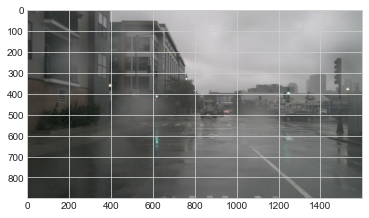

position:  (1461.1534275152344 @ 912.4528037997975)


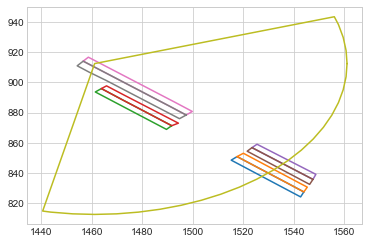

in Options class, polygonalRegions:  [<shapely.geometry.polygon.Polygon object at 0x248cee370>, <shapely.geometry.polygon.Polygon object at 0x248ceee80>, <shapely.geometry.polygon.Polygon object at 0x2c48543d0>, <shapely.geometry.polygon.Polygon object at 0x2c4854ee0>, <shapely.geometry.polygon.Polygon object at 0x2c51927c0>, <shapely.geometry.polygon.Polygon object at 0x2c519b1f0>, <shapely.geometry.polygon.Polygon object at 0x2c5c55970>, <shapely.geometry.polygon.Polygon object at 0x2c5c5d580>]


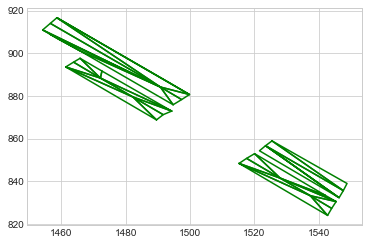

position is valid
heading:  3.9812093311103993
within get_traffic_flow
point:  (1461.1534275152344 @ 912.4528037997975)
heading output =  3.993938954957558
heading is valid
position:  (1448.91 @ 950.423)
NOT VALID: POSITION
position:  (1461.1534275152344 @ 912.4528037997975)
NOT VALID: POSITION
within get_traffic_flow
point:  (810.9253876230935 @ 1470.1615488708815)
heading output =  0.8561659309774273
within get_traffic_flow
point:  (813.1144339442252 @ 1461.1640156033452)
heading output =  0.8556565766527079
VALID:  True


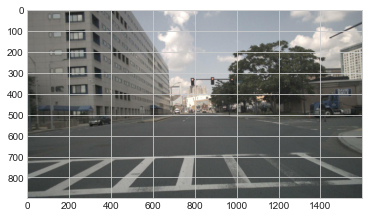

position:  (505.217762828368 @ 1698.3633208095591)


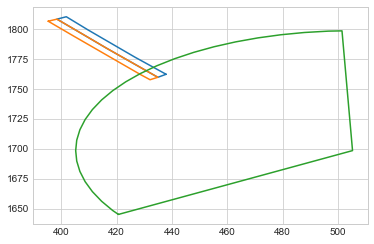

in Options class, polygonalRegions:  [<shapely.geometry.polygon.Polygon object at 0x248102ca0>, <shapely.geometry.polygon.Polygon object at 0x24810f910>]


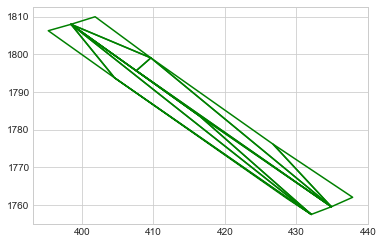

NOT VALID: POSITION
VALID:  False
position:  (2005.3188514999451 @ 784.4830753073546)


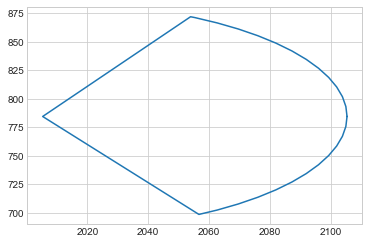

NOT VALID: POSITION
VALID:  False
position:  (1461.154946742584 @ 912.4545150402139)


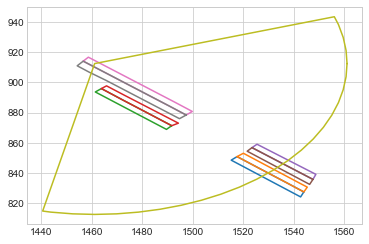

in Options class, polygonalRegions:  [<shapely.geometry.polygon.Polygon object at 0x248cee370>, <shapely.geometry.polygon.Polygon object at 0x248ceee80>, <shapely.geometry.polygon.Polygon object at 0x2c48543d0>, <shapely.geometry.polygon.Polygon object at 0x2c4854ee0>, <shapely.geometry.polygon.Polygon object at 0x2c51927c0>, <shapely.geometry.polygon.Polygon object at 0x2c519b1f0>, <shapely.geometry.polygon.Polygon object at 0x2c5c55970>, <shapely.geometry.polygon.Polygon object at 0x2c5c5d580>]


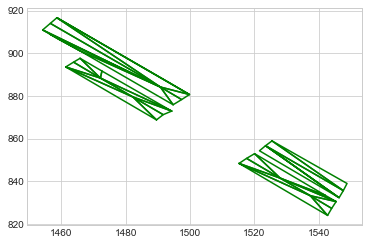

position is valid
heading:  3.981166742762555
within get_traffic_flow
point:  (1461.154946742584 @ 912.4545150402139)
heading output =  3.993938954957558
heading is valid
position:  (1452.649 @ 927.372)
NOT VALID: POSITION
position:  (1461.154946742584 @ 912.4545150402139)
NOT VALID: POSITION
position:  (1428.895 @ 927.429)
NOT VALID: POSITION
position:  (1461.154946742584 @ 912.4545150402139)
NOT VALID: POSITION
position:  (1448.903 @ 950.4)
NOT VALID: POSITION
position:  (1461.154946742584 @ 912.4545150402139)
NOT VALID: POSITION
position:  (1448.903 @ 950.4)
NOT VALID: POSITION
position:  (1461.154946742584 @ 912.4545150402139)
NOT VALID: POSITION
position:  (1452.649 @ 927.372)
NOT VALID: POSITION
position:  (1461.154946742584 @ 912.4545150402139)
NOT VALID: POSITION
position:  (1428.895 @ 927.429)
NOT VALID: POSITION
position:  (1461.154946742584 @ 912.4545150402139)
NOT VALID: POSITION
within get_traffic_flow
point:  (512.6679554220024 @ 753.4581251856703)
heading output =  2.429

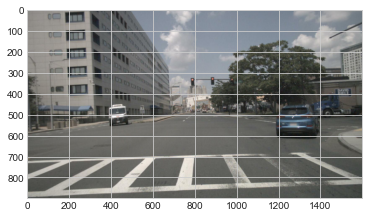

position:  (935.5477259644331 @ 635.5699354246624)


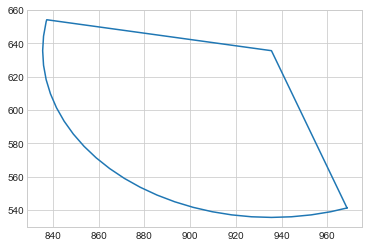

NOT VALID: POSITION
VALID:  False
position:  (1828.943797159825 @ 1153.6340360420868)


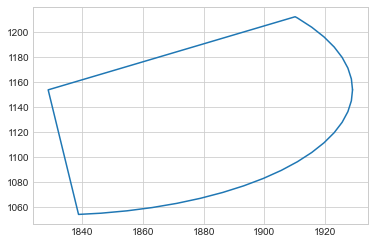

NOT VALID: POSITION
VALID:  False
position:  (1002.6400440851112 @ 457.9328484294223)


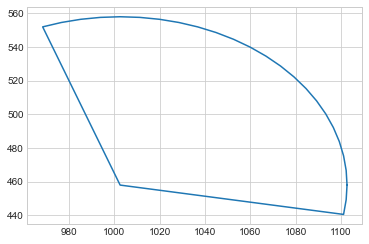

NOT VALID: POSITION
VALID:  False
position:  (1239.8043114984744 @ 960.4034776345408)


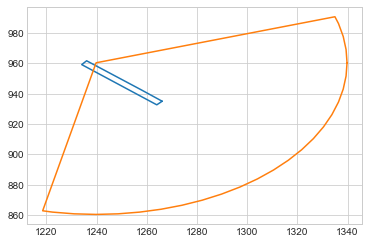

in Options class, polygonalRegions:  [<shapely.geometry.polygon.Polygon object at 0x2c5b37a90>]


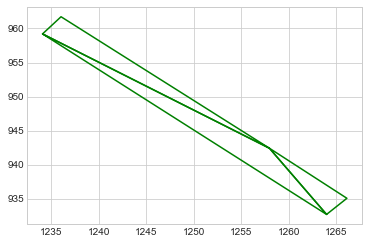

NOT VALID: POSITION
VALID:  False
position:  (1057.6775517800934 @ 1226.93583340142)


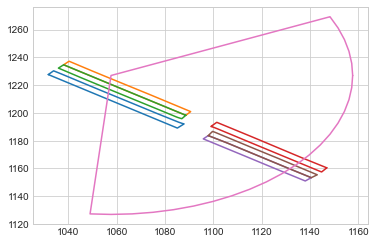

in Options class, polygonalRegions:  [<shapely.geometry.polygon.Polygon object at 0x247e11bb0>, <shapely.geometry.polygon.Polygon object at 0x2c3ccb3a0>, <shapely.geometry.polygon.Polygon object at 0x2c3ccbfd0>, <shapely.geometry.polygon.Polygon object at 0x2c3de77c0>, <shapely.geometry.polygon.Polygon object at 0x2c5bb1460>, <shapely.geometry.polygon.Polygon object at 0x2c5bbb130>]


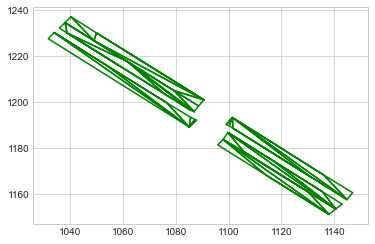

NOT VALID: POSITION
VALID:  False
position:  (1250.4825746005652 @ 946.1867580558222)


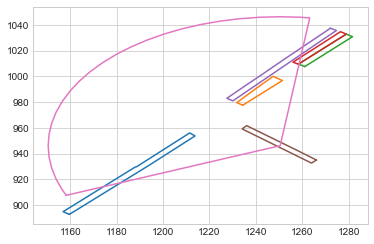

in Options class, polygonalRegions:  [<shapely.geometry.polygon.Polygon object at 0x24566e610>, <shapely.geometry.polygon.Polygon object at 0x263856160>, <shapely.geometry.polygon.Polygon object at 0x2c477a8e0>, <shapely.geometry.polygon.Polygon object at 0x2c47834f0>, <shapely.geometry.polygon.Polygon object at 0x2c594c370>, <shapely.geometry.polygon.Polygon object at 0x2c5b37a90>]


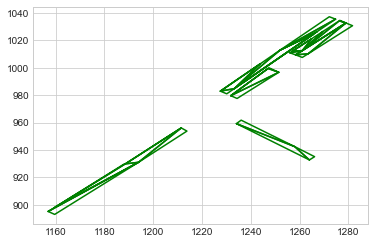

position is valid
heading:  0.9191586962147235
within get_traffic_flow
point:  (1250.4825746005652 @ 946.1867580558222)
heading output =  3.987180328799435
NOT VALID: HEADING
VALID:  False
position:  (1933.8454999722258 @ 870.5221821645334)


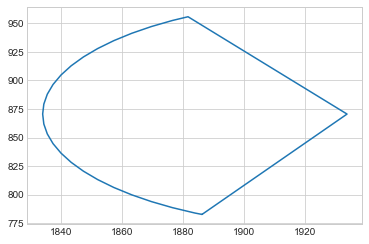

NOT VALID: POSITION
VALID:  False
position:  (770.0659169601563 @ 421.23526680547684)


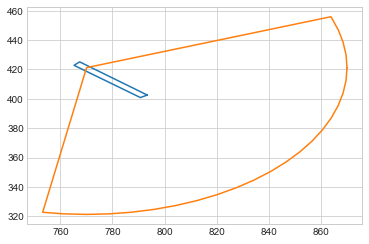

in Options class, polygonalRegions:  [<shapely.geometry.polygon.Polygon object at 0x248241550>]


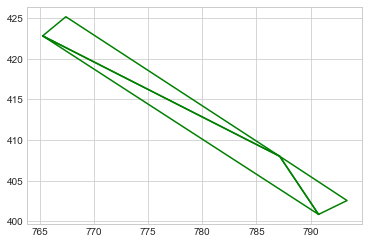

position is valid
heading:  4.019425513983342
within get_traffic_flow
point:  (770.0659169601563 @ 421.23526680547684)
heading output =  3.998104439752686
heading is valid
position:  (761.376 @ 440.464)
NOT VALID: POSITION
position:  (770.0659169601563 @ 421.23526680547684)
NOT VALID: POSITION
position:  (745.052 @ 441.654)
NOT VALID: POSITION
position:  (770.0659169601563 @ 421.23526680547684)
NOT VALID: POSITION
within get_traffic_flow
point:  (1273.5812674050476 @ 1026.6023377545107)
heading output =  2.415642717999222
within get_traffic_flow
point:  (1283.4620313712564 @ 1028.0351379702354)
heading output =  2.4195473264922565
VALID:  True


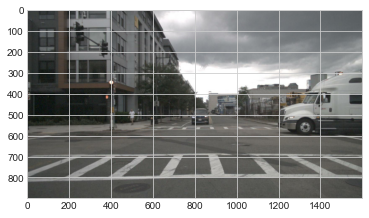

position:  (1066.0664117200831 @ 1449.0617977299091)


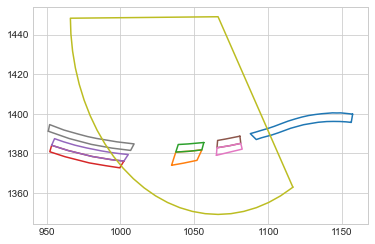

in Options class, polygonalRegions:  [<shapely.geometry.polygon.Polygon object at 0x244c5b880>, <shapely.geometry.polygon.Polygon object at 0x2451a3490>, <shapely.geometry.polygon.Polygon object at 0x2451ad040>, <shapely.geometry.polygon.Polygon object at 0x24586b0d0>, <shapely.geometry.polygon.Polygon object at 0x24586bd00>, <shapely.geometry.polygon.Polygon object at 0x2643453a0>, <shapely.geometry.polygon.Polygon object at 0x264345f10>, <shapely.geometry.polygon.Polygon object at 0x2c58143d0>]


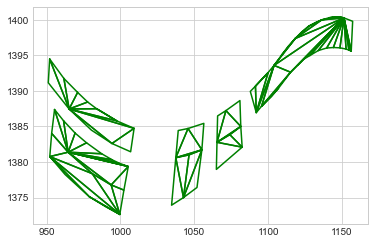

NOT VALID: POSITION
VALID:  False
position:  (1548.2963462297444 @ 839.7838478429744)


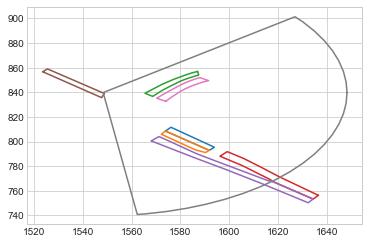

in Options class, polygonalRegions:  [<shapely.geometry.polygon.Polygon object at 0x248e2e5b0>, <shapely.geometry.polygon.Polygon object at 0x248e2efa0>, <shapely.geometry.polygon.Polygon object at 0x2496d36d0>, <shapely.geometry.polygon.Polygon object at 0x26449dd60>, <shapely.geometry.polygon.Polygon object at 0x2644a6a30>, <shapely.geometry.polygon.Polygon object at 0x2c51927c0>, <shapely.geometry.polygon.Polygon object at 0x2c569f490>]


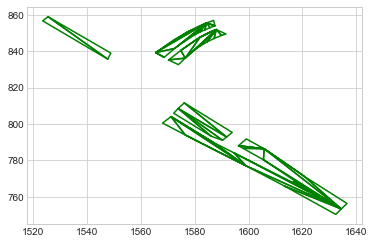

NOT VALID: POSITION
VALID:  False
position:  (803.0935395588697 @ 519.9266828103189)


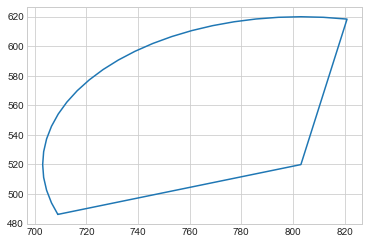

NOT VALID: POSITION
VALID:  False
position:  (345.20719489756675 @ 739.068691755558)


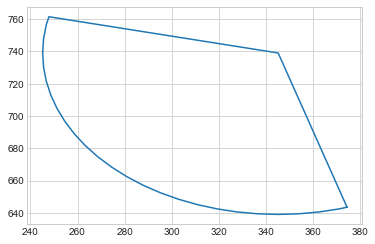

NOT VALID: POSITION
VALID:  False
position:  (1315.917592208233 @ 1038.8503671992416)


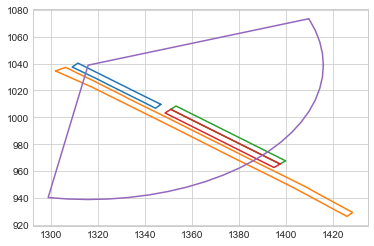

in Options class, polygonalRegions:  [<shapely.geometry.polygon.Polygon object at 0x2c4a4ceb0>, <shapely.geometry.polygon.Polygon object at 0x2c506e2b0>, <shapely.geometry.polygon.Polygon object at 0x2c5a697f0>, <shapely.geometry.polygon.Polygon object at 0x2c5a744c0>]


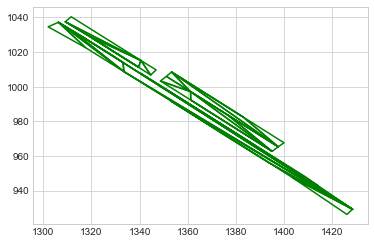

NOT VALID: POSITION
VALID:  False
position:  (2155.385532156249 @ 1139.7484476463344)


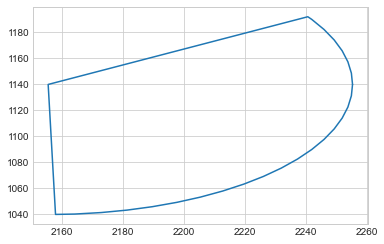

NOT VALID: POSITION
VALID:  False
position:  (1870.9360667856254 @ 1070.4302803712064)


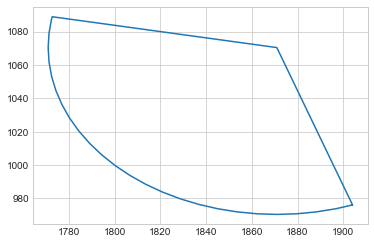

NOT VALID: POSITION
VALID:  False
position:  (2271.4689588631695 @ 868.5333551932996)


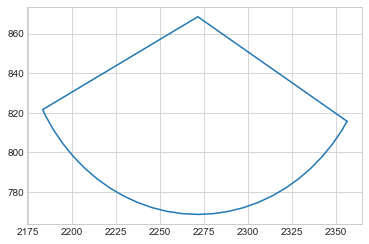

NOT VALID: POSITION
VALID:  False
position:  (1301.2033618971304 @ 896.0731245151317)


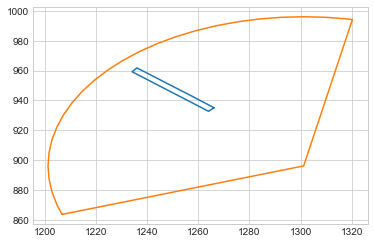

in Options class, polygonalRegions:  [<shapely.geometry.polygon.Polygon object at 0x2c5b37a90>]


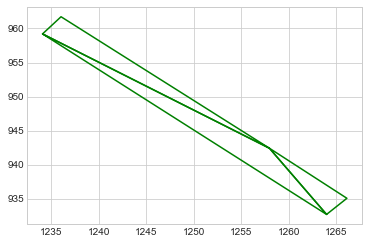

NOT VALID: POSITION
VALID:  False
position:  (2526.425235284873 @ 812.708178199664)


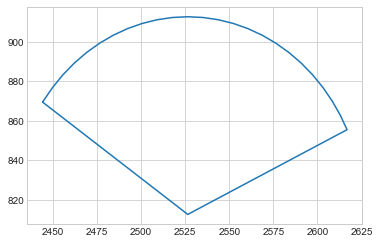

NOT VALID: POSITION
VALID:  False
position:  (1185.1333236306048 @ 1134.8979216534378)


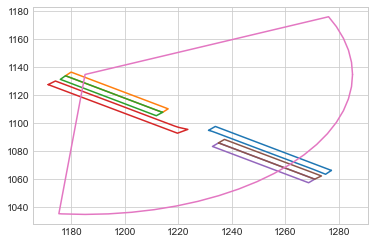

in Options class, polygonalRegions:  [<shapely.geometry.polygon.Polygon object at 0x248f88eb0>, <shapely.geometry.polygon.Polygon object at 0x263654640>, <shapely.geometry.polygon.Polygon object at 0x26365a250>, <shapely.geometry.polygon.Polygon object at 0x2c48e5c40>, <shapely.geometry.polygon.Polygon object at 0x2c5251070>, <shapely.geometry.polygon.Polygon object at 0x2c5251a60>]


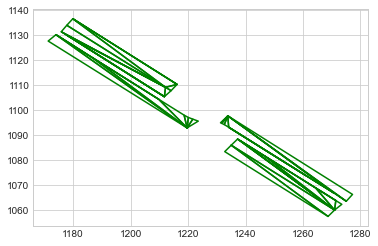

NOT VALID: POSITION
VALID:  False
position:  (1447.9146766744216 @ 1215.802806217672)


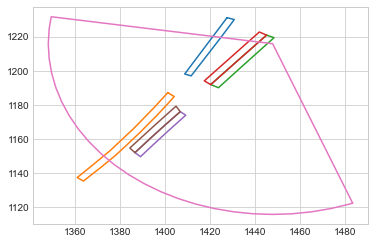

in Options class, polygonalRegions:  [<shapely.geometry.polygon.Polygon object at 0x2499916a0>, <shapely.geometry.polygon.Polygon object at 0x2c5099d90>, <shapely.geometry.polygon.Polygon object at 0x2c50c1cd0>, <shapely.geometry.polygon.Polygon object at 0x2c50c98e0>, <shapely.geometry.polygon.Polygon object at 0x2c59e6d60>, <shapely.geometry.polygon.Polygon object at 0x2c59f1a30>]


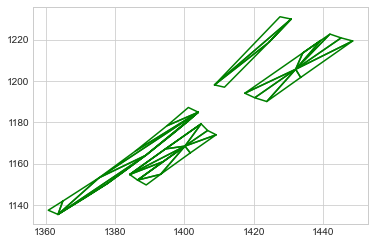

NOT VALID: POSITION
VALID:  False
position:  (1813.3148932385625 @ 1213.751252555607)


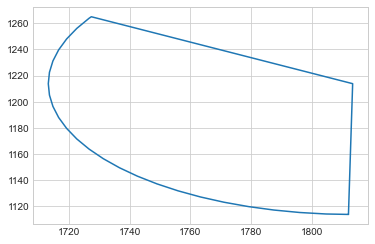

NOT VALID: POSITION
VALID:  False
position:  (2523.39059549219 @ 863.4459207953553)


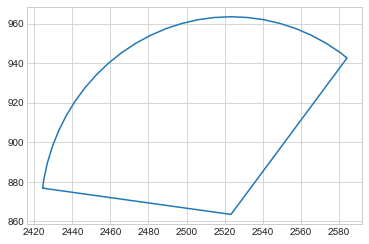

NOT VALID: POSITION
VALID:  False
position:  (1185.1335439721656 @ 1134.8982263459843)


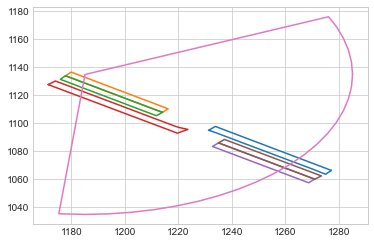

in Options class, polygonalRegions:  [<shapely.geometry.polygon.Polygon object at 0x248f88eb0>, <shapely.geometry.polygon.Polygon object at 0x263654640>, <shapely.geometry.polygon.Polygon object at 0x26365a250>, <shapely.geometry.polygon.Polygon object at 0x2c48e5c40>, <shapely.geometry.polygon.Polygon object at 0x2c5251070>, <shapely.geometry.polygon.Polygon object at 0x2c5251a60>]


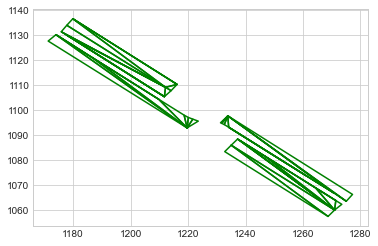

NOT VALID: POSITION
VALID:  False
position:  (2136.6322569752992 @ 904.4138782699498)


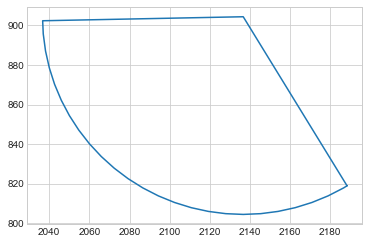

NOT VALID: POSITION
VALID:  False
position:  (803.61834694957 @ 519.4723029151407)


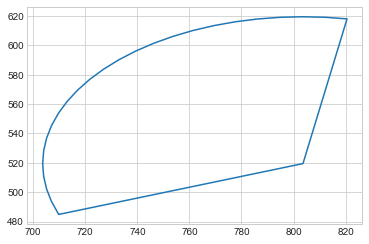

NOT VALID: POSITION
VALID:  False
position:  (446.2276482005127 @ 814.4733333748039)


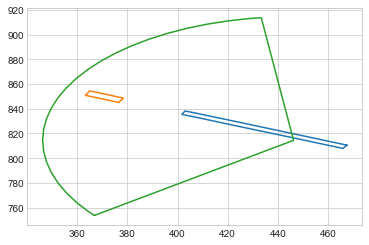

in Options class, polygonalRegions:  [<shapely.geometry.polygon.Polygon object at 0x2495d0400>, <shapely.geometry.polygon.Polygon object at 0x264439d60>]


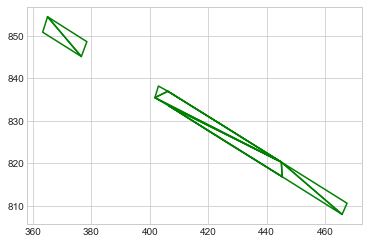

NOT VALID: POSITION
VALID:  False
position:  (1373.113987697902 @ 988.7957006326482)


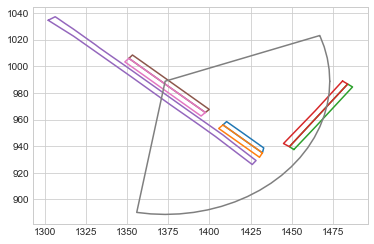

in Options class, polygonalRegions:  [<shapely.geometry.polygon.Polygon object at 0x244e8aeb0>, <shapely.geometry.polygon.Polygon object at 0x244e95a90>, <shapely.geometry.polygon.Polygon object at 0x2c4c25910>, <shapely.geometry.polygon.Polygon object at 0x2c4c2e400>, <shapely.geometry.polygon.Polygon object at 0x2c506e2b0>, <shapely.geometry.polygon.Polygon object at 0x2c5a697f0>, <shapely.geometry.polygon.Polygon object at 0x2c5a744c0>]


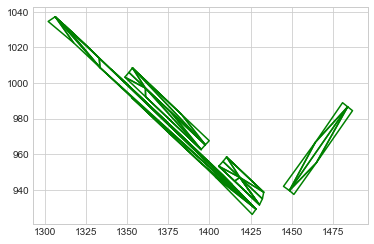

position is valid
heading:  4.015211411635154
within get_traffic_flow
point:  (1373.113987697902 @ 988.7957006326482)
heading output =  3.993138586293062
heading is valid
position:  (1365.565 @ 1014.593)
NOT VALID: POSITION
position:  (1373.113987697902 @ 988.7957006326482)
NOT VALID: POSITION
position:  (1299.831 @ 1053.269)
NOT VALID: POSITION
position:  (1373.113987697902 @ 988.7957006326482)
NOT VALID: POSITION
position:  (1281.547 @ 1050.836)
NOT VALID: POSITION
position:  (1373.113987697902 @ 988.7957006326482)
NOT VALID: POSITION
position:  (1281.547 @ 1050.836)
NOT VALID: POSITION
position:  (1373.113987697902 @ 988.7957006326482)
NOT VALID: POSITION
position:  (1365.565 @ 1014.593)
NOT VALID: POSITION
position:  (1373.113987697902 @ 988.7957006326482)
NOT VALID: POSITION
position:  (1299.831 @ 1053.269)
NOT VALID: POSITION
position:  (1373.113987697902 @ 988.7957006326482)
NOT VALID: POSITION
within get_traffic_flow
point:  (692.3397765864842 @ 1454.2570538975535)
heading outp

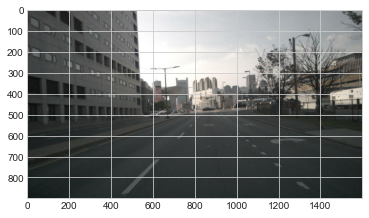

position:  (2499.5821112846907 @ 881.7336773939282)


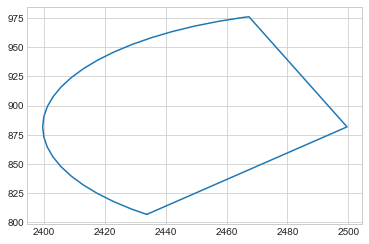

NOT VALID: POSITION
VALID:  False
position:  (778.1816467451113 @ 414.2266081956924)


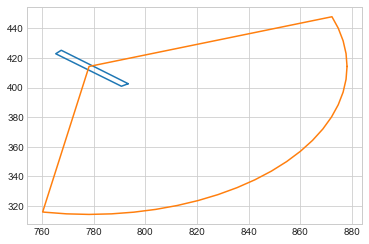

in Options class, polygonalRegions:  [<shapely.geometry.polygon.Polygon object at 0x248241550>]


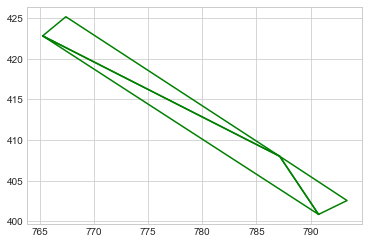

position is valid
heading:  4.007991764172598
within get_traffic_flow
point:  (778.1816467451113 @ 414.2266081956924)
heading output =  3.998104439752686
heading is valid
position:  (719.465 @ 467.778)
NOT VALID: POSITION
position:  (778.1816467451113 @ 414.2266081956924)
NOT VALID: POSITION
within get_traffic_flow
point:  (1032.970140376589 @ 749.049973631792)
heading output =  -0.7017887453113056
within get_traffic_flow
point:  (1025.3234397169358 @ 748.022677967203)
heading output =  -0.6727881261169384
VALID:  True


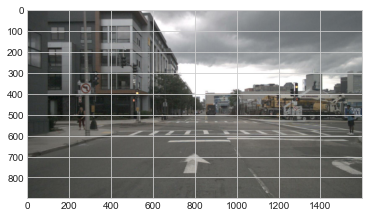

position:  (1859.8449736926311 @ 1053.5866035299366)


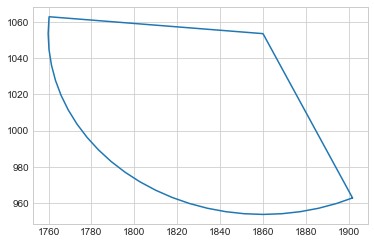

NOT VALID: POSITION
VALID:  False
position:  (2271.4849257823253 @ 868.838177972234)


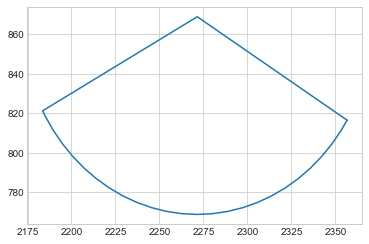

NOT VALID: POSITION
VALID:  False
position:  (309.18411916002333 @ 668.6639066570241)


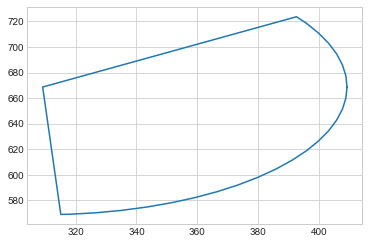

NOT VALID: POSITION
VALID:  False
position:  (2096.0830034038086 @ 940.6951177285387)


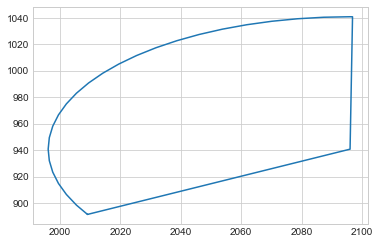

NOT VALID: POSITION
VALID:  False
position:  (1185.1335392131184 @ 1134.89822146389)


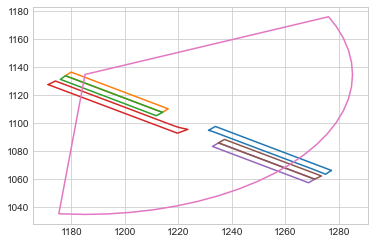

in Options class, polygonalRegions:  [<shapely.geometry.polygon.Polygon object at 0x248f88eb0>, <shapely.geometry.polygon.Polygon object at 0x263654640>, <shapely.geometry.polygon.Polygon object at 0x26365a250>, <shapely.geometry.polygon.Polygon object at 0x2c48e5c40>, <shapely.geometry.polygon.Polygon object at 0x2c5251070>, <shapely.geometry.polygon.Polygon object at 0x2c5251a60>]


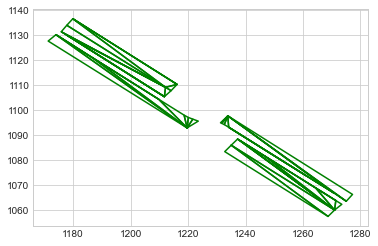

NOT VALID: POSITION
VALID:  False
position:  (730.0215517453462 @ 583.5807060642867)


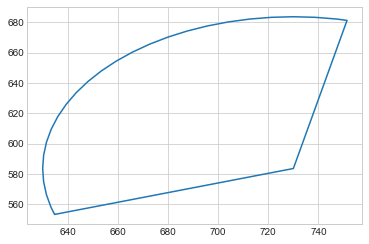

NOT VALID: POSITION
VALID:  False
position:  (2066.814324784105 @ 789.8504307107152)


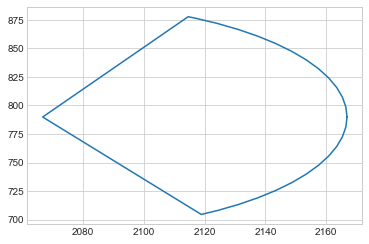

NOT VALID: POSITION
VALID:  False
position:  (2430.7348205730073 @ 797.4425874341226)


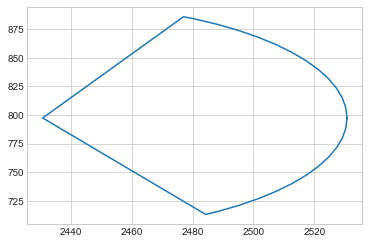

NOT VALID: POSITION
VALID:  False
position:  (759.9241552584585 @ 1515.0295039939106)


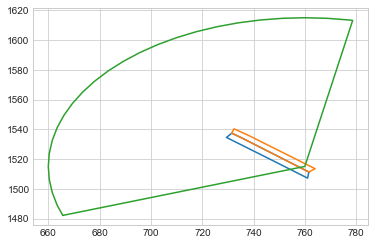

in Options class, polygonalRegions:  [<shapely.geometry.polygon.Polygon object at 0x2454b9a60>, <shapely.geometry.polygon.Polygon object at 0x2454c2670>]


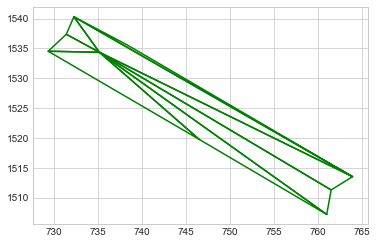

position is valid
heading:  0.8594450299891068
within get_traffic_flow
point:  (759.9241552584585 @ 1515.0295039939106)
heading output =  0.8619605002069616
heading is valid
position:  (761.545 @ 1508.955)
NOT VALID: POSITION
position:  (759.9241552584585 @ 1515.0295039939106)
NOT VALID: POSITION
position:  (793.527 @ 1503.259)
NOT VALID: POSITION
position:  (759.9241552584585 @ 1515.0295039939106)
NOT VALID: POSITION
within get_traffic_flow
point:  (1390.5126199406661 @ 1268.2026753503396)
heading output =  1.064361316689943
within get_traffic_flow
point:  (1392.708866570247 @ 1262.349252532923)
heading output =  1.067953419086934
VALID:  True


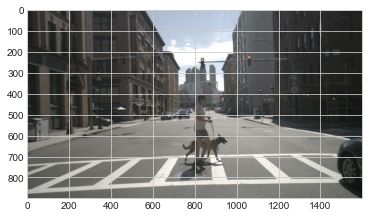

position:  (1868.3528349863668 @ 1066.1527382527045)


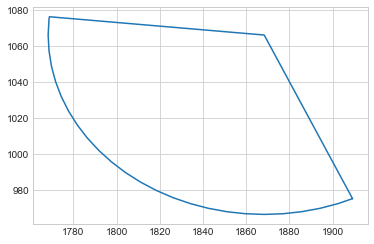

NOT VALID: POSITION
VALID:  False
position:  (1936.5203885093906 @ 1048.0996772777971)


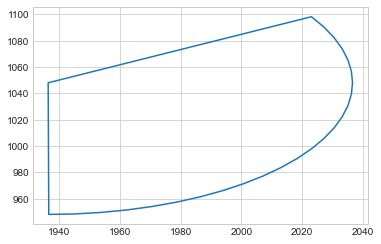

NOT VALID: POSITION
VALID:  False
position:  (1458.9818552305792 @ 1290.379478145041)


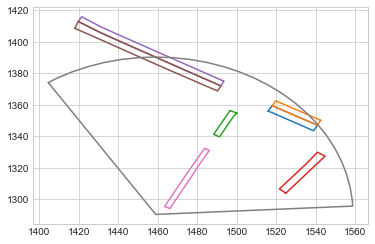

in Options class, polygonalRegions:  [<shapely.geometry.polygon.Polygon object at 0x2481edc40>, <shapely.geometry.polygon.Polygon object at 0x2481f7730>, <shapely.geometry.polygon.Polygon object at 0x2493f3460>, <shapely.geometry.polygon.Polygon object at 0x2c475ae80>, <shapely.geometry.polygon.Polygon object at 0x2c58f6370>, <shapely.geometry.polygon.Polygon object at 0x2c5904040>, <shapely.geometry.polygon.Polygon object at 0x2c5b8e700>]


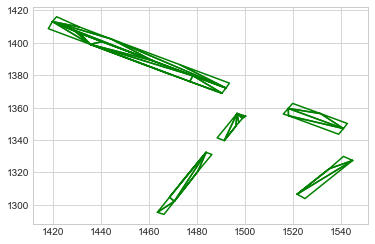

NOT VALID: POSITION
VALID:  False
position:  (437.1870765640492 @ 822.3703554760142)


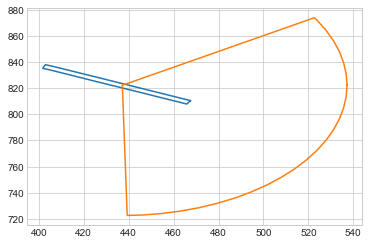

in Options class, polygonalRegions:  [<shapely.geometry.polygon.Polygon object at 0x2495d0400>]


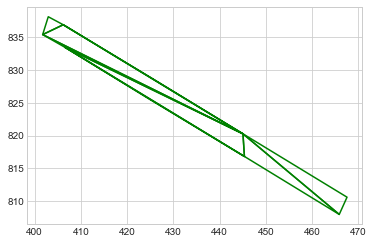

position is valid
heading:  4.210451935716383
within get_traffic_flow
point:  (437.1870765640492 @ 822.3703554760142)
heading output =  4.308298932715173
heading is valid
position:  (418.381 @ 822.62)
NOT VALID: POSITION
position:  (437.1870765640492 @ 822.3703554760142)
NOT VALID: POSITION
position:  (416.048 @ 831.111)
NOT VALID: POSITION
position:  (437.1870765640492 @ 822.3703554760142)
NOT VALID: POSITION
within get_traffic_flow
point:  (762.7742547247889 @ 1489.6047553269084)
heading output =  2.57329410010953
within get_traffic_flow
point:  (767.5461837017091 @ 1493.3829190967579)
heading output =  2.5698542053851443
VALID:  True


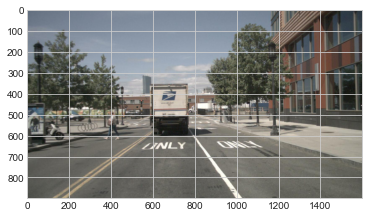

position:  (1788.8657753970067 @ 1198.6563316238942)


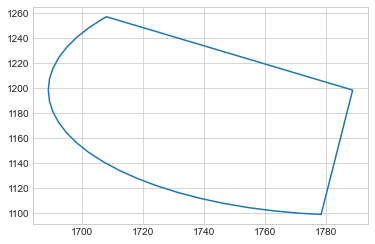

NOT VALID: POSITION
VALID:  False
position:  (452.82637486004296 @ 1713.5710294036246)


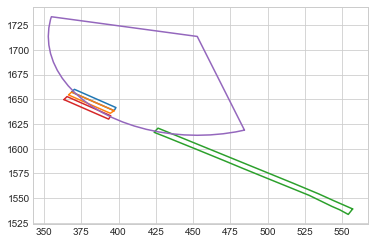

in Options class, polygonalRegions:  [<shapely.geometry.polygon.Polygon object at 0x248d0baf0>, <shapely.geometry.polygon.Polygon object at 0x248d12520>, <shapely.geometry.polygon.Polygon object at 0x24945ae20>, <shapely.geometry.polygon.Polygon object at 0x2c50ed880>]


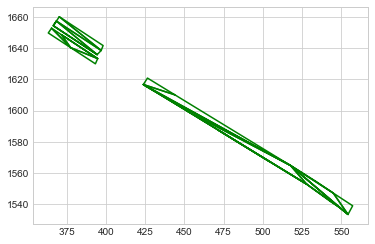

NOT VALID: POSITION
VALID:  False
position:  (1185.1321696113362 @ 1134.896314776417)


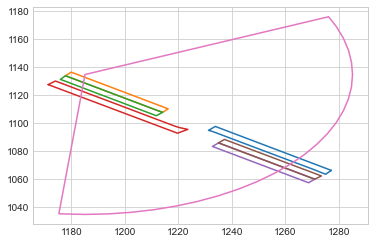

in Options class, polygonalRegions:  [<shapely.geometry.polygon.Polygon object at 0x248f88eb0>, <shapely.geometry.polygon.Polygon object at 0x263654640>, <shapely.geometry.polygon.Polygon object at 0x26365a250>, <shapely.geometry.polygon.Polygon object at 0x2c48e5c40>, <shapely.geometry.polygon.Polygon object at 0x2c5251070>, <shapely.geometry.polygon.Polygon object at 0x2c5251a60>]


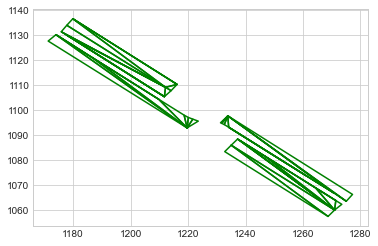

NOT VALID: POSITION
VALID:  False
position:  (2326.431092422549 @ 1012.5037462075479)


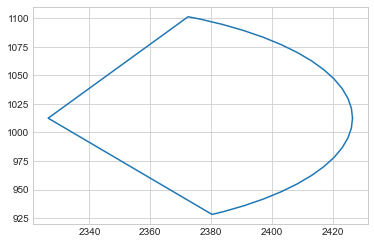

NOT VALID: POSITION
VALID:  False
position:  (805.9273540478111 @ 517.5525492220074)


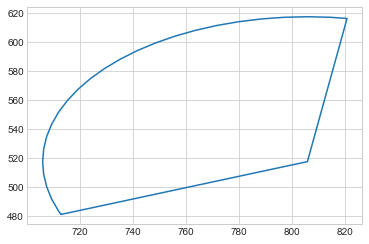

NOT VALID: POSITION
VALID:  False
position:  (1977.0786870865927 @ 1015.6507604664882)


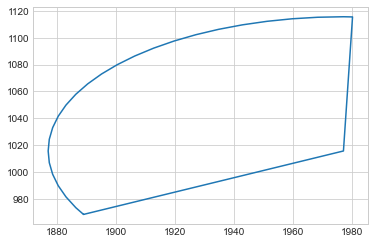

NOT VALID: POSITION
VALID:  False
position:  (1831.2344855021508 @ 1153.4983939682431)


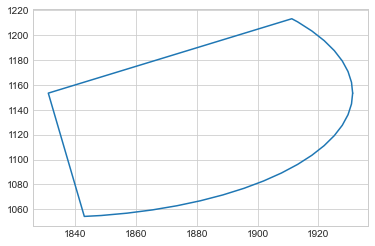

NOT VALID: POSITION
VALID:  False
position:  (2115.2288015253034 @ 875.5702667176083)


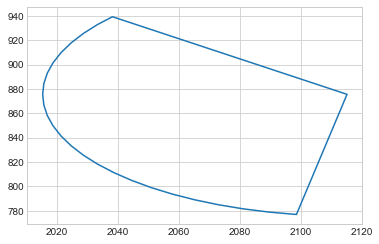

NOT VALID: POSITION
VALID:  False
position:  (2135.7603617511295 @ 902.999159980274)


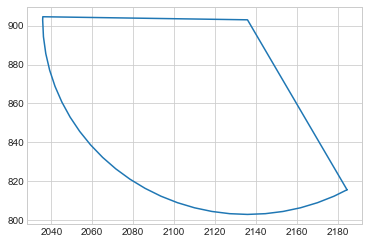

NOT VALID: POSITION
VALID:  False
position:  (2261.7613088463772 @ 857.8628274705532)


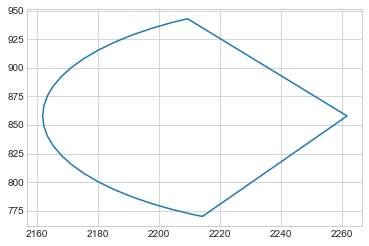

NOT VALID: POSITION
VALID:  False
position:  (1185.133538514104 @ 1134.8982205632863)


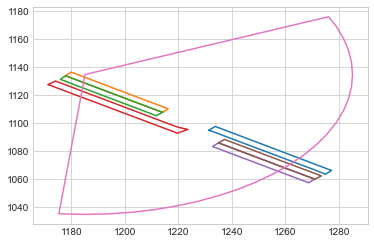

in Options class, polygonalRegions:  [<shapely.geometry.polygon.Polygon object at 0x248f88eb0>, <shapely.geometry.polygon.Polygon object at 0x263654640>, <shapely.geometry.polygon.Polygon object at 0x26365a250>, <shapely.geometry.polygon.Polygon object at 0x2c48e5c40>, <shapely.geometry.polygon.Polygon object at 0x2c5251070>, <shapely.geometry.polygon.Polygon object at 0x2c5251a60>]


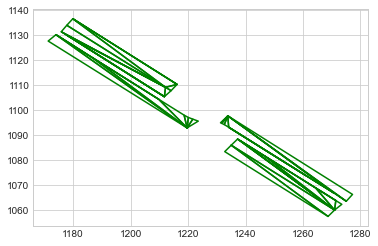

NOT VALID: POSITION
VALID:  False
position:  (1038.5620581658688 @ 501.0742891169342)


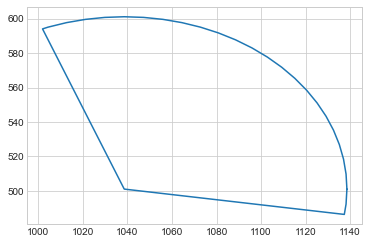

NOT VALID: POSITION
VALID:  False
position:  (2106.8121749285056 @ 934.4052384907588)


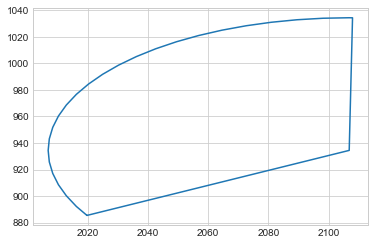

NOT VALID: POSITION
VALID:  False
position:  (2427.708871240749 @ 797.3316244626347)


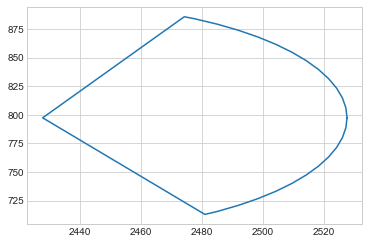

NOT VALID: POSITION
VALID:  False
position:  (1868.4227938114861 @ 1066.253406346063)


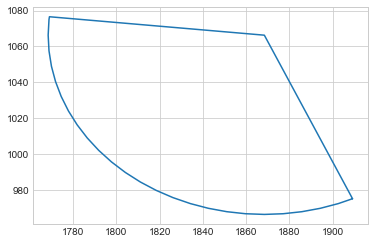

NOT VALID: POSITION
VALID:  False
position:  (590.1246452376586 @ 713.4504190979288)


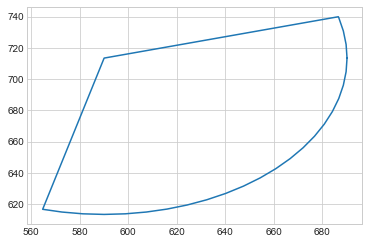

NOT VALID: POSITION
VALID:  False
position:  (2172.1423941444777 @ 875.374280613328)


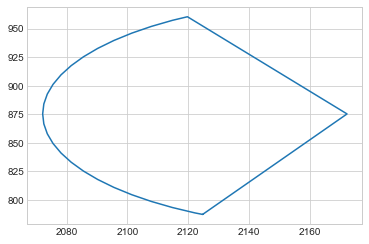

NOT VALID: POSITION
VALID:  False
position:  (770.065915968737 @ 421.23526758371906)


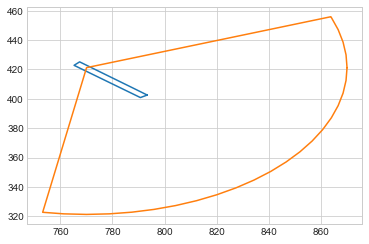

in Options class, polygonalRegions:  [<shapely.geometry.polygon.Polygon object at 0x248241550>]


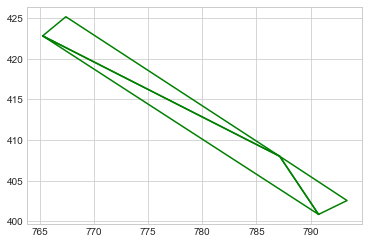

position is valid
heading:  4.019421658570266
within get_traffic_flow
point:  (770.065915968737 @ 421.23526758371906)
heading output =  3.998104439752686
heading is valid
position:  (761.68 @ 431.244)
NOT VALID: POSITION
position:  (770.065915968737 @ 421.23526758371906)
NOT VALID: POSITION
position:  (744.979 @ 441.731)
NOT VALID: POSITION
position:  (770.065915968737 @ 421.23526758371906)
NOT VALID: POSITION
within get_traffic_flow
point:  (1710.3301125238065 @ 854.3973516860048)
heading output =  2.4893371758874787
within get_traffic_flow
point:  (1711.653194567496 @ 849.2106607816161)
heading output =  2.4033520579803143
VALID:  True


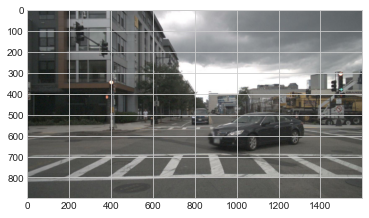

position:  (1456.4938709528856 @ 1226.1930443111544)


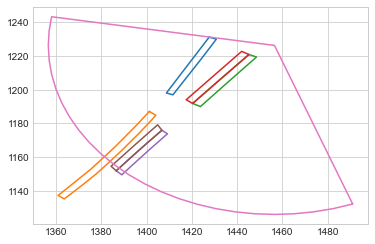

in Options class, polygonalRegions:  [<shapely.geometry.polygon.Polygon object at 0x2499916a0>, <shapely.geometry.polygon.Polygon object at 0x2c5099d90>, <shapely.geometry.polygon.Polygon object at 0x2c50c1cd0>, <shapely.geometry.polygon.Polygon object at 0x2c50c98e0>, <shapely.geometry.polygon.Polygon object at 0x2c59e6d60>, <shapely.geometry.polygon.Polygon object at 0x2c59f1a30>]


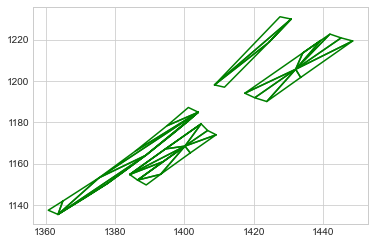

NOT VALID: POSITION
VALID:  False
position:  (1316.9482850949373 @ 1037.9571688589872)


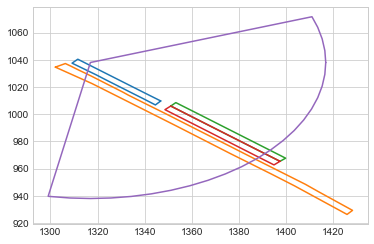

in Options class, polygonalRegions:  [<shapely.geometry.polygon.Polygon object at 0x2c4a4ceb0>, <shapely.geometry.polygon.Polygon object at 0x2c506e2b0>, <shapely.geometry.polygon.Polygon object at 0x2c5a697f0>, <shapely.geometry.polygon.Polygon object at 0x2c5a744c0>]


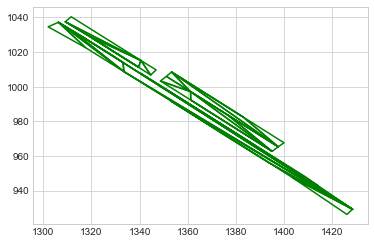

NOT VALID: POSITION
VALID:  False
position:  (2136.104139338075 @ 903.5642915283773)


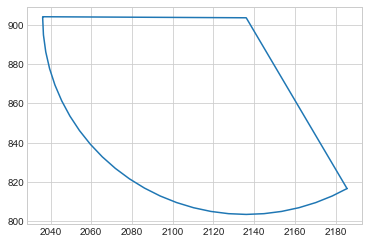

NOT VALID: POSITION
VALID:  False
position:  (867.232450079295 @ 556.8358277562952)


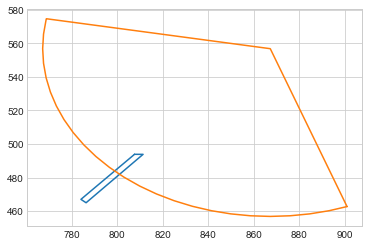

in Options class, polygonalRegions:  [<shapely.geometry.polygon.Polygon object at 0x263dce760>]


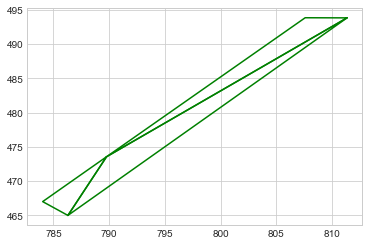

NOT VALID: POSITION
VALID:  False
position:  (469.6861385219322 @ 1718.0929835966533)


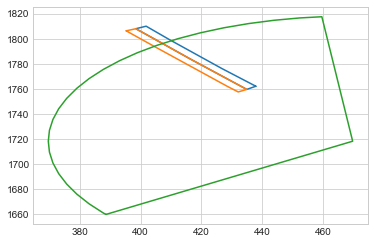

in Options class, polygonalRegions:  [<shapely.geometry.polygon.Polygon object at 0x248102ca0>, <shapely.geometry.polygon.Polygon object at 0x24810f910>]


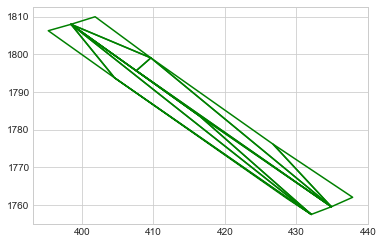

NOT VALID: POSITION
VALID:  False
position:  (527.6706440801358 @ 1686.8150406615682)


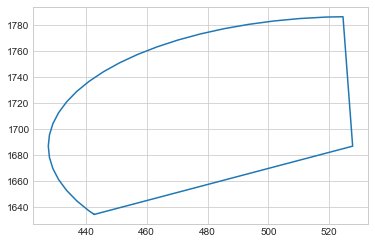

NOT VALID: POSITION
VALID:  False
position:  (1461.1546936484458 @ 912.4541859061354)


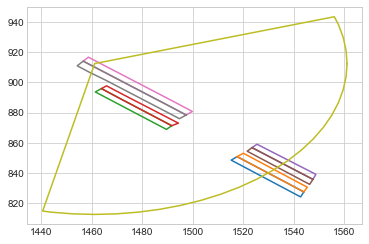

in Options class, polygonalRegions:  [<shapely.geometry.polygon.Polygon object at 0x248cee370>, <shapely.geometry.polygon.Polygon object at 0x248ceee80>, <shapely.geometry.polygon.Polygon object at 0x2c48543d0>, <shapely.geometry.polygon.Polygon object at 0x2c4854ee0>, <shapely.geometry.polygon.Polygon object at 0x2c51927c0>, <shapely.geometry.polygon.Polygon object at 0x2c519b1f0>, <shapely.geometry.polygon.Polygon object at 0x2c5c55970>, <shapely.geometry.polygon.Polygon object at 0x2c5c5d580>]


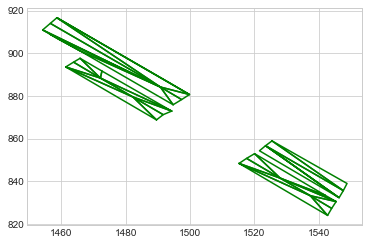

position is valid
heading:  3.9811090429466507
within get_traffic_flow
point:  (1461.1546936484458 @ 912.4541859061354)
heading output =  3.993938954957558
heading is valid
position:  (1454.105 @ 925.091)
NOT VALID: POSITION
position:  (1461.1546936484458 @ 912.4541859061354)
NOT VALID: POSITION
position:  (1448.93 @ 950.436)
NOT VALID: POSITION
position:  (1461.1546936484458 @ 912.4541859061354)
NOT VALID: POSITION
position:  (1399.059 @ 952.851)
NOT VALID: POSITION
position:  (1461.1546936484458 @ 912.4541859061354)
NOT VALID: POSITION
position:  (1399.059 @ 952.851)
NOT VALID: POSITION
position:  (1461.1546936484458 @ 912.4541859061354)
NOT VALID: POSITION
position:  (1454.105 @ 925.091)
NOT VALID: POSITION
position:  (1461.1546936484458 @ 912.4541859061354)
NOT VALID: POSITION
position:  (1448.93 @ 950.436)
NOT VALID: POSITION
position:  (1461.1546936484458 @ 912.4541859061354)
NOT VALID: POSITION
within get_traffic_flow
point:  (1381.1357938241104 @ 1431.5448684685568)
heading out

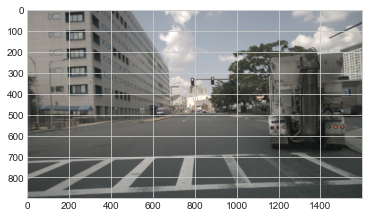

position:  (303.7343085902544 @ 671.86461960774)


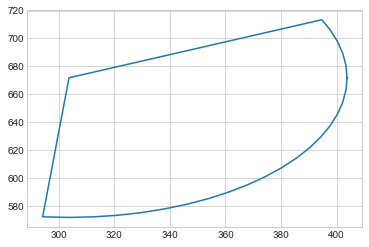

NOT VALID: POSITION
VALID:  False
position:  (569.7496471021011 @ 1663.9906062225818)


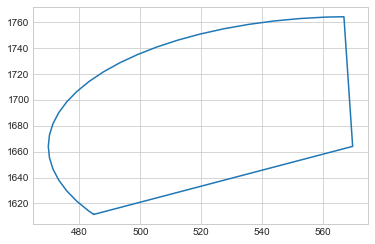

NOT VALID: POSITION
VALID:  False
position:  (1460.6328534770137 @ 1293.7150957752947)


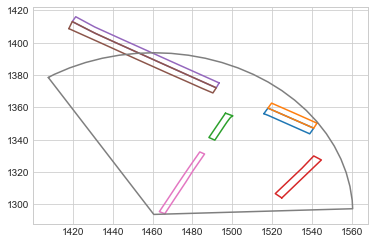

in Options class, polygonalRegions:  [<shapely.geometry.polygon.Polygon object at 0x2481edc40>, <shapely.geometry.polygon.Polygon object at 0x2481f7730>, <shapely.geometry.polygon.Polygon object at 0x2493f3460>, <shapely.geometry.polygon.Polygon object at 0x2c475ae80>, <shapely.geometry.polygon.Polygon object at 0x2c58f6370>, <shapely.geometry.polygon.Polygon object at 0x2c5904040>, <shapely.geometry.polygon.Polygon object at 0x2c5b8e700>]


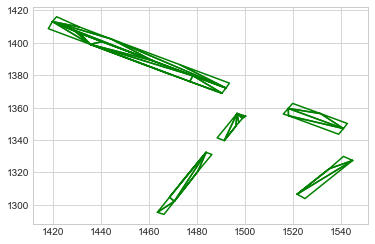

NOT VALID: POSITION
VALID:  False
position:  (1926.8443228593574 @ 870.8910483213982)


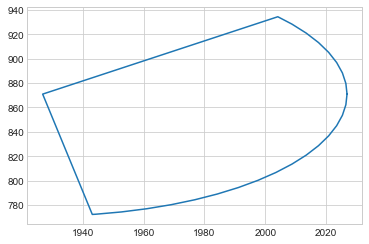

NOT VALID: POSITION
VALID:  False
position:  (414.44229815350127 @ 887.1691129640243)


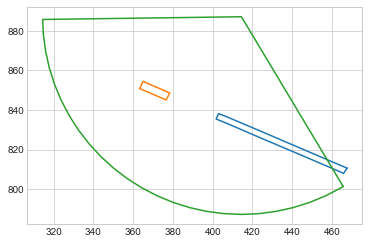

in Options class, polygonalRegions:  [<shapely.geometry.polygon.Polygon object at 0x2495d0400>, <shapely.geometry.polygon.Polygon object at 0x264439d60>]


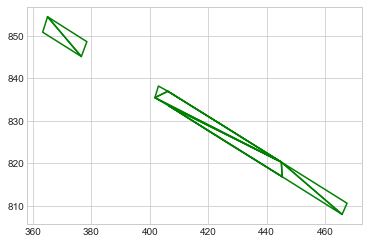

NOT VALID: POSITION
VALID:  False
position:  (2271.507713289942 @ 869.0009538524748)


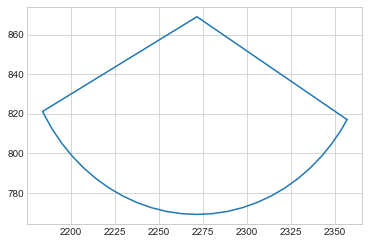

NOT VALID: POSITION
VALID:  False
position:  (1935.654244522133 @ 863.2740858048157)


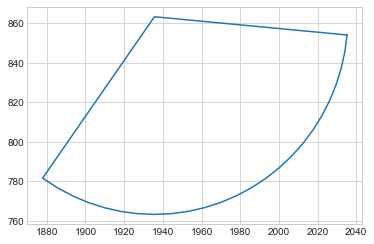

NOT VALID: POSITION
VALID:  False
position:  (789.3878394228154 @ 404.18492810375227)


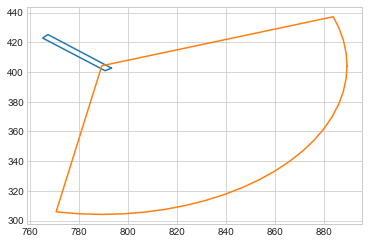

in Options class, polygonalRegions:  [<shapely.geometry.polygon.Polygon object at 0x248241550>]


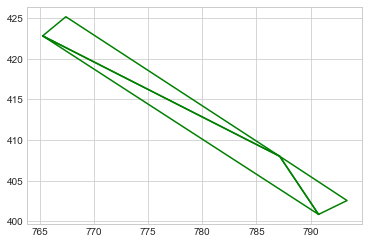

position is valid
heading:  4.001292821677748
within get_traffic_flow
point:  (789.3878394228154 @ 404.18492810375227)
heading output =  3.998104439752686
heading is valid
position:  (738.546 @ 451.126)
NOT VALID: POSITION
position:  (789.3878394228154 @ 404.18492810375227)
NOT VALID: POSITION
within get_traffic_flow
point:  (374.3630563208388 @ 1654.9032797764335)
heading output =  4.1286992654684544
within get_traffic_flow
point:  (384.24605773153996 @ 1651.0275641497026)
heading output =  4.126017714755827
VALID:  True


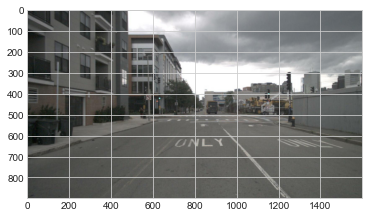

position:  (1991.7281660020947 @ 784.3400988190117)


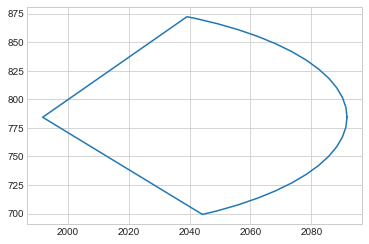

NOT VALID: POSITION
VALID:  False
position:  (2172.850221672495 @ 875.2572214883096)


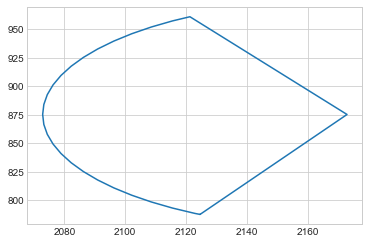

NOT VALID: POSITION
VALID:  False
position:  (1545.1248185164495 @ 1330.9897619303501)


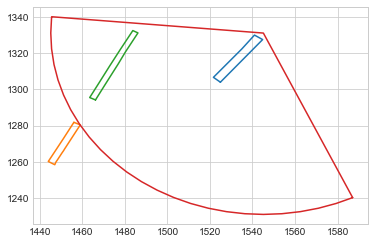

in Options class, polygonalRegions:  [<shapely.geometry.polygon.Polygon object at 0x2c475ae80>, <shapely.geometry.polygon.Polygon object at 0x2c54dabe0>, <shapely.geometry.polygon.Polygon object at 0x2c5b8e700>]


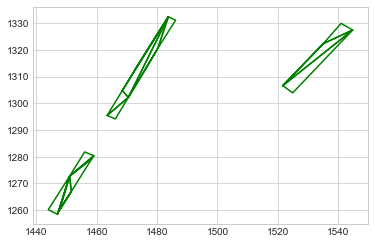

NOT VALID: POSITION
VALID:  False
position:  (1837.7134701015066 @ 1147.0521030175273)


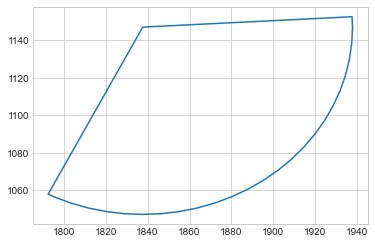

NOT VALID: POSITION
VALID:  False
position:  (309.1878396101729 @ 668.6676882811496)


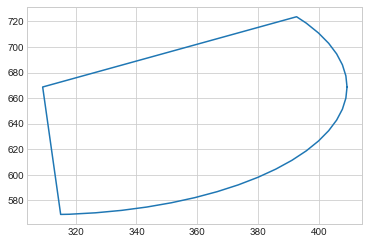

NOT VALID: POSITION
VALID:  False
position:  (1315.9187796961157 @ 1038.8517870335618)


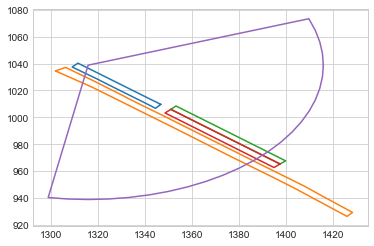

in Options class, polygonalRegions:  [<shapely.geometry.polygon.Polygon object at 0x2c4a4ceb0>, <shapely.geometry.polygon.Polygon object at 0x2c506e2b0>, <shapely.geometry.polygon.Polygon object at 0x2c5a697f0>, <shapely.geometry.polygon.Polygon object at 0x2c5a744c0>]


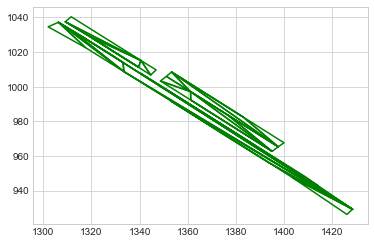

NOT VALID: POSITION
VALID:  False
position:  (1843.9871759788707 @ 1121.76024173463)


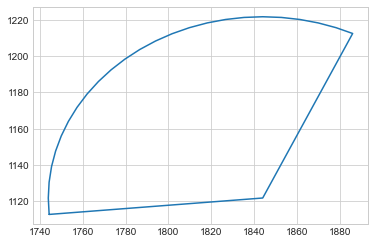

NOT VALID: POSITION
VALID:  False
position:  (1405.4925465103713 @ 960.5279076409186)


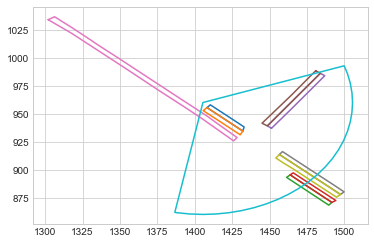

in Options class, polygonalRegions:  [<shapely.geometry.polygon.Polygon object at 0x244e8aeb0>, <shapely.geometry.polygon.Polygon object at 0x244e95a90>, <shapely.geometry.polygon.Polygon object at 0x2c48543d0>, <shapely.geometry.polygon.Polygon object at 0x2c4854ee0>, <shapely.geometry.polygon.Polygon object at 0x2c4c25910>, <shapely.geometry.polygon.Polygon object at 0x2c4c2e400>, <shapely.geometry.polygon.Polygon object at 0x2c506e2b0>, <shapely.geometry.polygon.Polygon object at 0x2c5c55970>, <shapely.geometry.polygon.Polygon object at 0x2c5c5d580>]


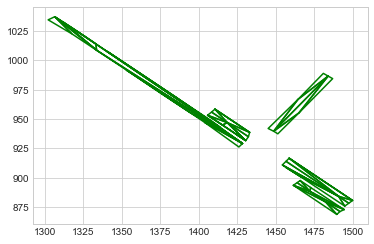

NOT VALID: POSITION
VALID:  False
position:  (526.3162072867744 @ 1561.1592608152782)


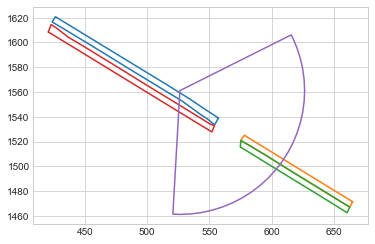

in Options class, polygonalRegions:  [<shapely.geometry.polygon.Polygon object at 0x24945ae20>, <shapely.geometry.polygon.Polygon object at 0x2c4f71be0>, <shapely.geometry.polygon.Polygon object at 0x2c4f7d910>, <shapely.geometry.polygon.Polygon object at 0x2c5cff4c0>]


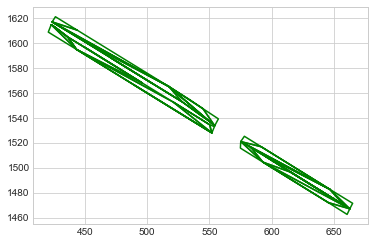

NOT VALID: POSITION
VALID:  False
position:  (2138.102386252363 @ 907.8930123619517)


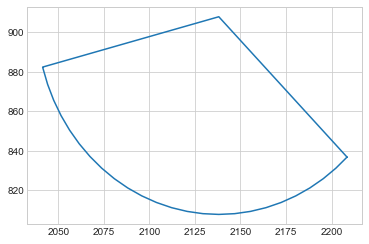

NOT VALID: POSITION
VALID:  False
position:  (675.3705427224093 @ 631.5479121235721)


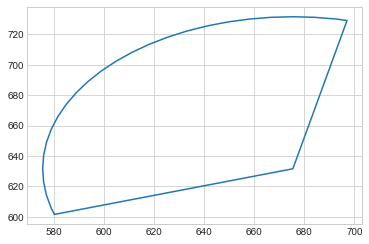

NOT VALID: POSITION
VALID:  False
position:  (2271.3929206608377 @ 867.1826789203614)


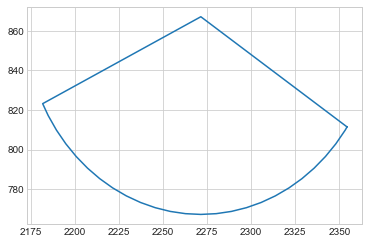

NOT VALID: POSITION
VALID:  False
position:  (1971.0860310526593 @ 1018.7427602867516)


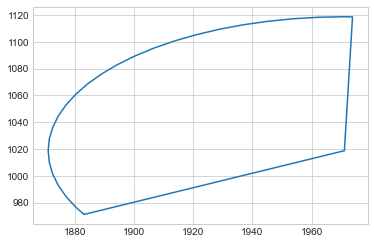

NOT VALID: POSITION
VALID:  False
position:  (2021.4696645793529 @ 788.8772204894577)


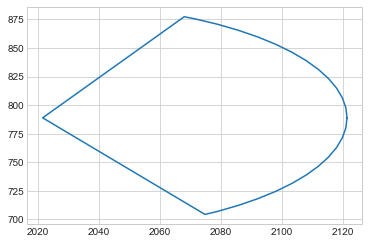

NOT VALID: POSITION
VALID:  False
position:  (1762.935470969082 @ 1214.7593073619362)


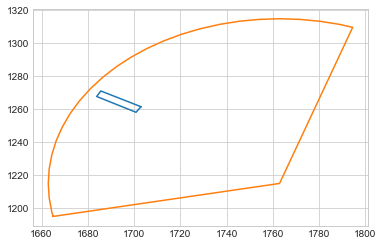

in Options class, polygonalRegions:  [<shapely.geometry.polygon.Polygon object at 0x2454fbcd0>]


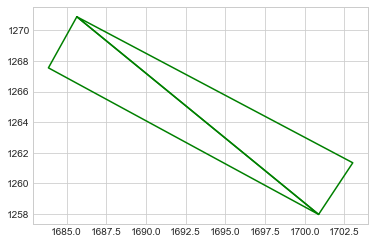

NOT VALID: POSITION
VALID:  False
position:  (1447.9146780835144 @ 1215.8028079486303)


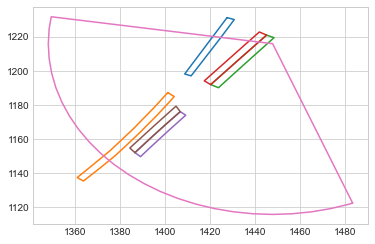

in Options class, polygonalRegions:  [<shapely.geometry.polygon.Polygon object at 0x2499916a0>, <shapely.geometry.polygon.Polygon object at 0x2c5099d90>, <shapely.geometry.polygon.Polygon object at 0x2c50c1cd0>, <shapely.geometry.polygon.Polygon object at 0x2c50c98e0>, <shapely.geometry.polygon.Polygon object at 0x2c59e6d60>, <shapely.geometry.polygon.Polygon object at 0x2c59f1a30>]


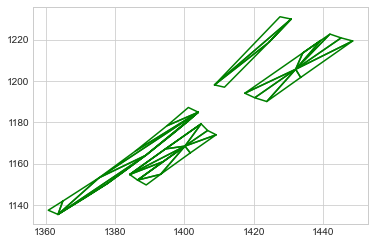

NOT VALID: POSITION
VALID:  False
position:  (1301.2033479994298 @ 896.0731365930743)


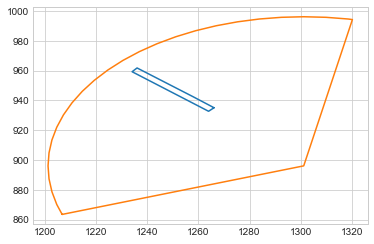

in Options class, polygonalRegions:  [<shapely.geometry.polygon.Polygon object at 0x2c5b37a90>]


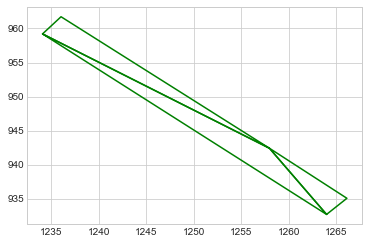

NOT VALID: POSITION
VALID:  False
position:  (508.7113485102691 @ 1696.971701988251)


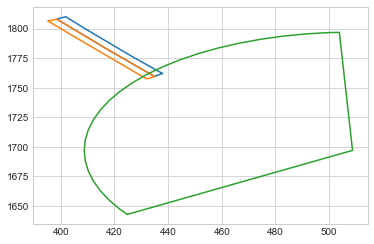

in Options class, polygonalRegions:  [<shapely.geometry.polygon.Polygon object at 0x248102ca0>, <shapely.geometry.polygon.Polygon object at 0x24810f910>]


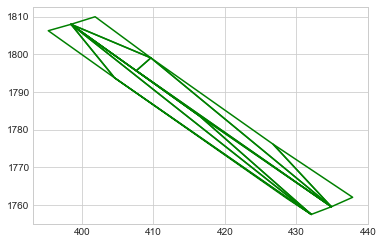

NOT VALID: POSITION
VALID:  False
position:  (1026.0865229962146 @ 485.10032147413904)


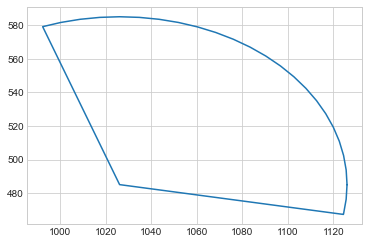

NOT VALID: POSITION
VALID:  False
position:  (2525.591630471233 @ 852.6896308543339)


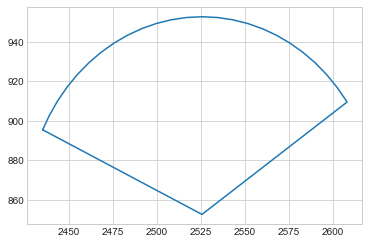

NOT VALID: POSITION
VALID:  False
position:  (1239.486512259727 @ 960.7209999945438)


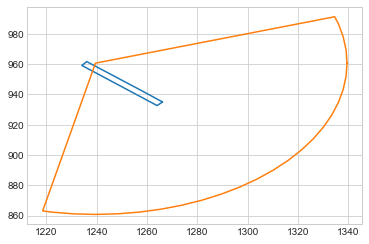

in Options class, polygonalRegions:  [<shapely.geometry.polygon.Polygon object at 0x2c5b37a90>]


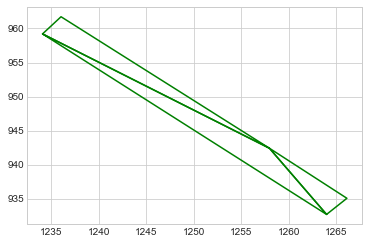

NOT VALID: POSITION
VALID:  False
position:  (1323.2309983942614 @ 1070.2945772864623)


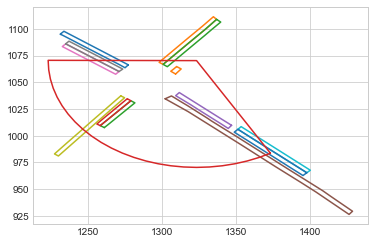

in Options class, polygonalRegions:  [<shapely.geometry.polygon.Polygon object at 0x248f88eb0>, <shapely.geometry.polygon.Polygon object at 0x249506cd0>, <shapely.geometry.polygon.Polygon object at 0x2c477a8e0>, <shapely.geometry.polygon.Polygon object at 0x2c47834f0>, <shapely.geometry.polygon.Polygon object at 0x2c4a4ceb0>, <shapely.geometry.polygon.Polygon object at 0x2c506e2b0>, <shapely.geometry.polygon.Polygon object at 0x2c5251070>, <shapely.geometry.polygon.Polygon object at 0x2c5251a60>, <shapely.geometry.polygon.Polygon object at 0x2c594c370>, <shapely.geometry.polygon.Polygon object at 0x2c5a697f0>, <shapely.geometry.polygon.Polygon object at 0x2c5a744c0>, <shapely.geometry.polygon.Polygon object at 0x2c5b5d820>, <shapely.geometry.polygon.Polygon object at 0x2c5b684f0>]


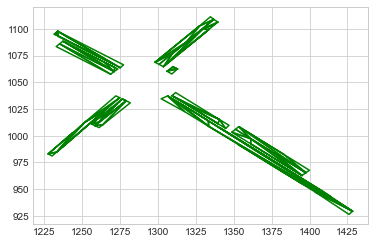

NOT VALID: POSITION
VALID:  False
position:  (1695.512013794081 @ 983.8736376306965)


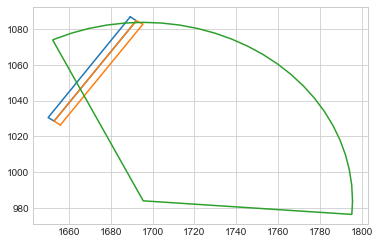

in Options class, polygonalRegions:  [<shapely.geometry.polygon.Polygon object at 0x2494924c0>, <shapely.geometry.polygon.Polygon object at 0x249492e50>]


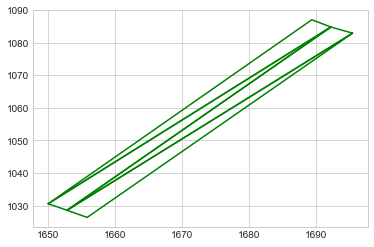

NOT VALID: POSITION
VALID:  False
position:  (2115.06363930213 @ 874.3508846006655)


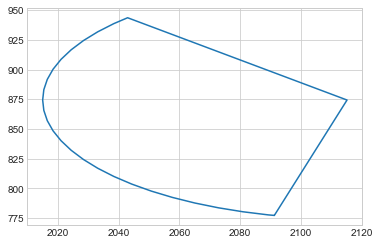

NOT VALID: POSITION
VALID:  False
position:  (2131.5901938604616 @ 912.3877932622875)


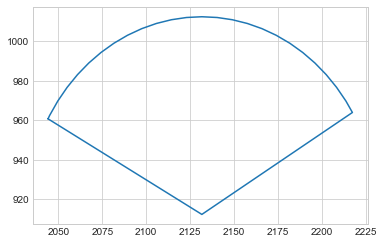

NOT VALID: POSITION
VALID:  False
position:  (1000.6601302420913 @ 455.5810348618644)


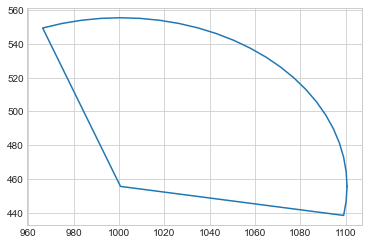

NOT VALID: POSITION
VALID:  False
position:  (1937.4160392330482 @ 856.761616622068)


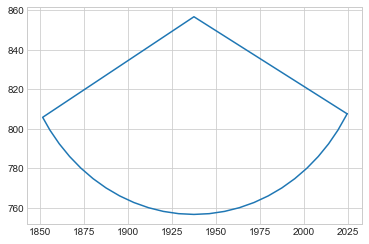

NOT VALID: POSITION
VALID:  False
position:  (1539.3833742598129 @ 1318.5724829501935)


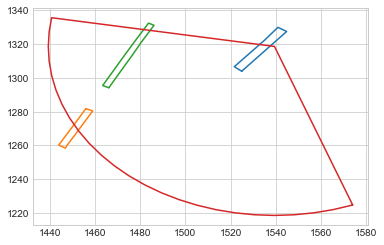

in Options class, polygonalRegions:  [<shapely.geometry.polygon.Polygon object at 0x2c475ae80>, <shapely.geometry.polygon.Polygon object at 0x2c54dabe0>, <shapely.geometry.polygon.Polygon object at 0x2c5b8e700>]


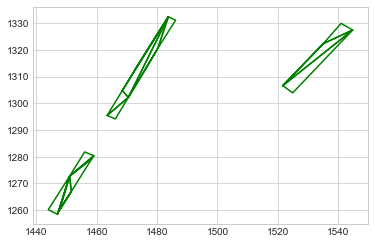

NOT VALID: POSITION
VALID:  False
position:  (2039.7233335412043 @ 982.0812528247643)


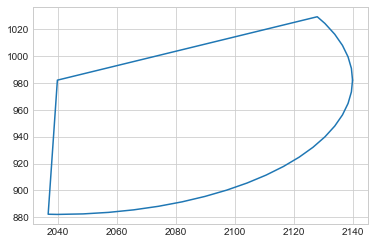

NOT VALID: POSITION
VALID:  False
position:  (1679.5043705656396 @ 959.5124474416622)


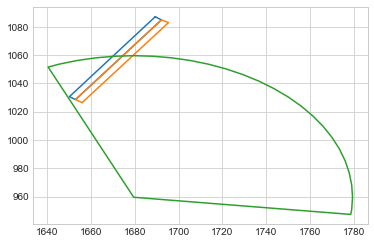

in Options class, polygonalRegions:  [<shapely.geometry.polygon.Polygon object at 0x2494924c0>, <shapely.geometry.polygon.Polygon object at 0x249492e50>]


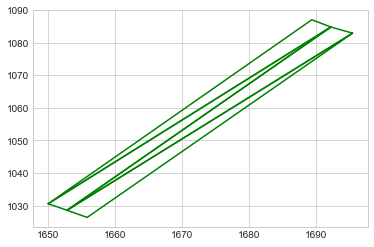

NOT VALID: POSITION
VALID:  False
position:  (1830.6379976008352 @ 1152.6498567526876)


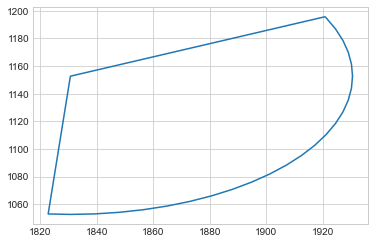

NOT VALID: POSITION
VALID:  False
position:  (445.13283144109755 @ 603.7820624915734)


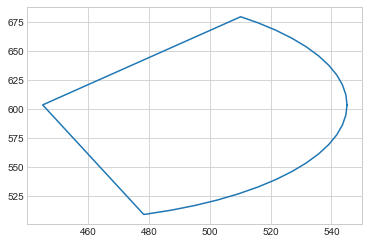

NOT VALID: POSITION
VALID:  False
position:  (585.9458972234816 @ 710.7024716065584)


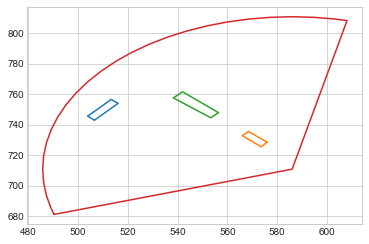

in Options class, polygonalRegions:  [<shapely.geometry.polygon.Polygon object at 0x248b8e610>, <shapely.geometry.polygon.Polygon object at 0x2c40d8400>, <shapely.geometry.polygon.Polygon object at 0x2c47d9370>]


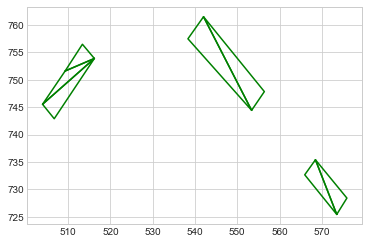

NOT VALID: POSITION
VALID:  False
position:  (759.9233057088677 @ 1515.028515673896)


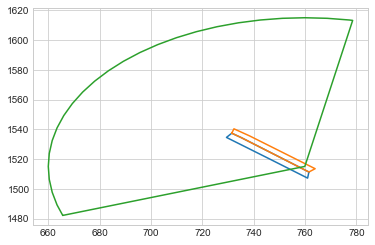

in Options class, polygonalRegions:  [<shapely.geometry.polygon.Polygon object at 0x2454b9a60>, <shapely.geometry.polygon.Polygon object at 0x2454c2670>]


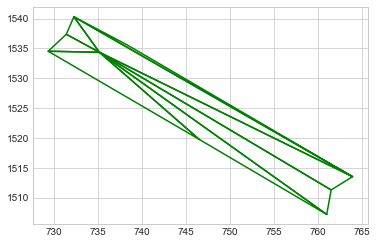

position is valid
heading:  0.8595302340336076
within get_traffic_flow
point:  (759.9233057088677 @ 1515.028515673896)
heading output =  0.8619605002069616
heading is valid
position:  (761.545 @ 1508.955)
NOT VALID: POSITION
position:  (759.9233057088677 @ 1515.028515673896)
NOT VALID: POSITION
position:  (793.616 @ 1503.186)
NOT VALID: POSITION
position:  (759.9233057088677 @ 1515.028515673896)
NOT VALID: POSITION
within get_traffic_flow
point:  (1480.1095136838032 @ 879.3901300541003)
heading output =  0.8482197353083331
within get_traffic_flow
point:  (1466.8969609841818 @ 884.6953523964038)
heading output =  0.8487465649028552
VALID:  True


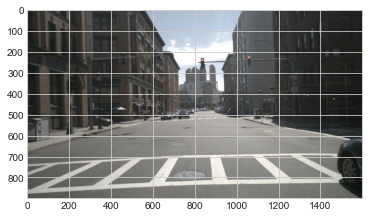

position:  (784.264119781719 @ 408.8246242577395)


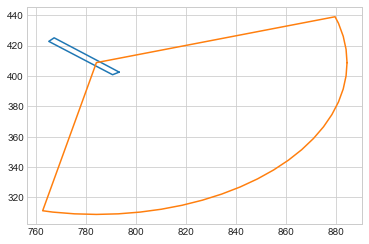

in Options class, polygonalRegions:  [<shapely.geometry.polygon.Polygon object at 0x248241550>]


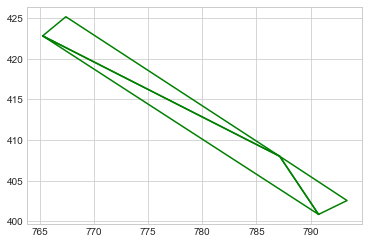

position is valid
heading:  3.972529766458775
within get_traffic_flow
point:  (784.264119781719 @ 408.8246242577395)
heading output =  3.998104439752686
heading is valid
position:  (729.217 @ 459.507)
NOT VALID: POSITION
position:  (784.264119781719 @ 408.8246242577395)
NOT VALID: POSITION
within get_traffic_flow
point:  (1364.6217270846737 @ 1139.588110294289)
heading output =  -0.6836340425536629
within get_traffic_flow
point:  (1378.133119486315 @ 1158.3498065704243)
heading output =  -0.680927506615201
VALID:  True


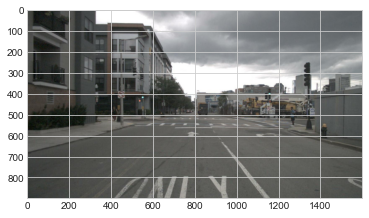

position:  (1185.1323627645945 @ 1134.896580889288)


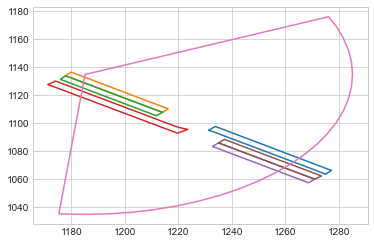

in Options class, polygonalRegions:  [<shapely.geometry.polygon.Polygon object at 0x248f88eb0>, <shapely.geometry.polygon.Polygon object at 0x263654640>, <shapely.geometry.polygon.Polygon object at 0x26365a250>, <shapely.geometry.polygon.Polygon object at 0x2c48e5c40>, <shapely.geometry.polygon.Polygon object at 0x2c5251070>, <shapely.geometry.polygon.Polygon object at 0x2c5251a60>]


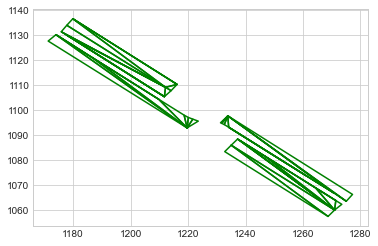

NOT VALID: POSITION
VALID:  False
position:  (2128.1997780966744 @ 920.4801464286486)


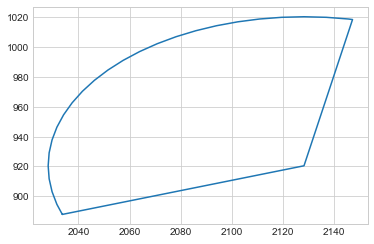

NOT VALID: POSITION
VALID:  False
position:  (543.3132720262936 @ 1678.7174217820848)


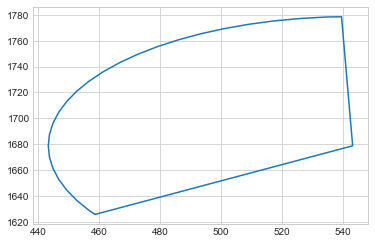

NOT VALID: POSITION
VALID:  False
position:  (2032.7584991630251 @ 1220.5046648187742)


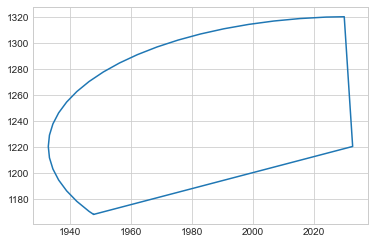

NOT VALID: POSITION
VALID:  False
position:  (1460.2010164776934 @ 1292.7104222960702)


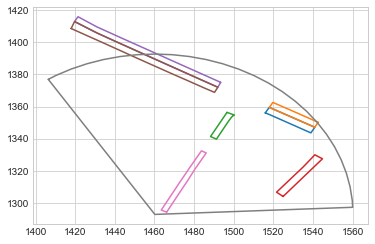

in Options class, polygonalRegions:  [<shapely.geometry.polygon.Polygon object at 0x2481edc40>, <shapely.geometry.polygon.Polygon object at 0x2481f7730>, <shapely.geometry.polygon.Polygon object at 0x2493f3460>, <shapely.geometry.polygon.Polygon object at 0x2c475ae80>, <shapely.geometry.polygon.Polygon object at 0x2c58f6370>, <shapely.geometry.polygon.Polygon object at 0x2c5904040>, <shapely.geometry.polygon.Polygon object at 0x2c5b8e700>]


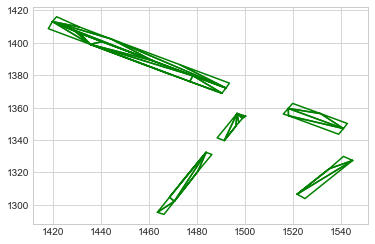

NOT VALID: POSITION
VALID:  False
position:  (1818.2343604008495 @ 1216.778693787815)


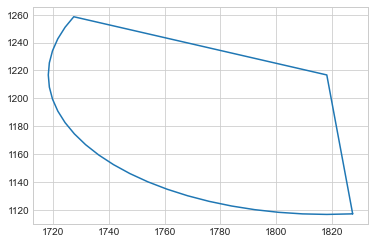

NOT VALID: POSITION
VALID:  False
position:  (803.4430327741788 @ 519.6267757915892)


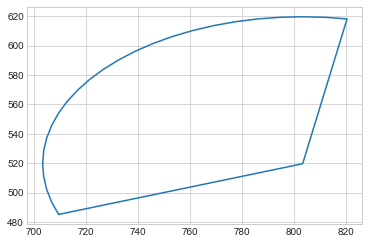

NOT VALID: POSITION
VALID:  False
position:  (1487.683551221749 @ 889.5395207720143)


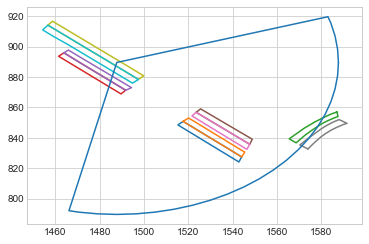

in Options class, polygonalRegions:  [<shapely.geometry.polygon.Polygon object at 0x248cee370>, <shapely.geometry.polygon.Polygon object at 0x248ceee80>, <shapely.geometry.polygon.Polygon object at 0x2496d36d0>, <shapely.geometry.polygon.Polygon object at 0x2c48543d0>, <shapely.geometry.polygon.Polygon object at 0x2c4854ee0>, <shapely.geometry.polygon.Polygon object at 0x2c51927c0>, <shapely.geometry.polygon.Polygon object at 0x2c519b1f0>, <shapely.geometry.polygon.Polygon object at 0x2c569f490>, <shapely.geometry.polygon.Polygon object at 0x2c5c55970>, <shapely.geometry.polygon.Polygon object at 0x2c5c5d580>]


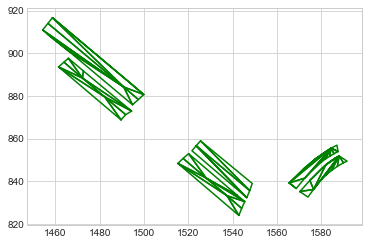

position is valid
heading:  3.9710497356774646
within get_traffic_flow
point:  (1487.683551221749 @ 889.5395207720143)
heading output =  3.993938954957558
heading is valid
position:  (1456.962 @ 899.216)
NOT VALID: POSITION
position:  (1487.683551221749 @ 889.5395207720143)
NOT VALID: POSITION
position:  (1452.4 @ 929.21)
NOT VALID: POSITION
position:  (1487.683551221749 @ 889.5395207720143)
NOT VALID: POSITION
position:  (1419.292 @ 949.245)
NOT VALID: POSITION
position:  (1487.683551221749 @ 889.5395207720143)
NOT VALID: POSITION
position:  (1419.292 @ 949.245)
NOT VALID: POSITION
position:  (1487.683551221749 @ 889.5395207720143)
NOT VALID: POSITION
position:  (1456.962 @ 899.216)
NOT VALID: POSITION
position:  (1487.683551221749 @ 889.5395207720143)
NOT VALID: POSITION
position:  (1452.4 @ 929.21)
NOT VALID: POSITION
position:  (1487.683551221749 @ 889.5395207720143)
NOT VALID: POSITION
within get_traffic_flow
point:  (383.7600827177584 @ 1636.7625674122862)
heading output =  0.986

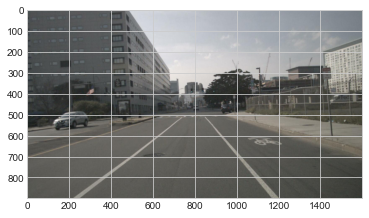

position:  (902.5970574741009 @ 344.6054838493774)


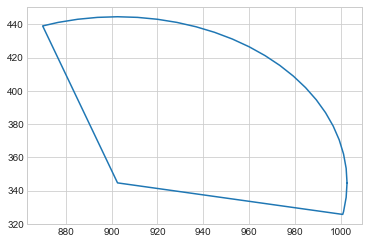

NOT VALID: POSITION
VALID:  False
position:  (2008.8048089809774 @ 788.5679742576616)


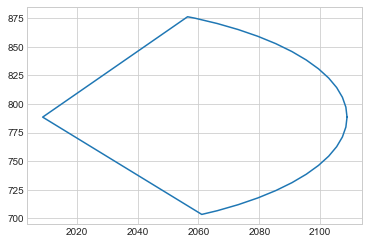

NOT VALID: POSITION
VALID:  False
position:  (681.3611160364349 @ 1348.4377901777668)


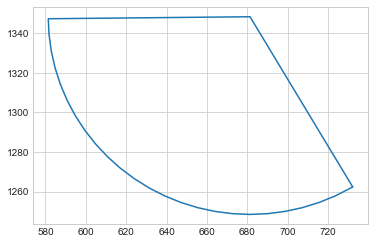

NOT VALID: POSITION
VALID:  False
position:  (2081.065971554296 @ 1177.7757524772817)


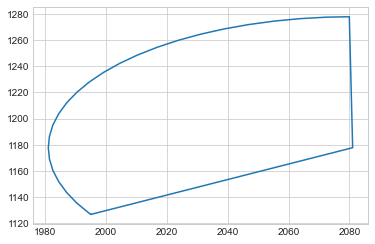

NOT VALID: POSITION
VALID:  False
position:  (748.2171533362014 @ 443.5912329873424)


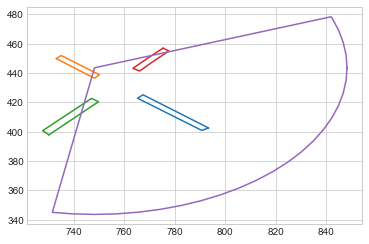

in Options class, polygonalRegions:  [<shapely.geometry.polygon.Polygon object at 0x248241550>, <shapely.geometry.polygon.Polygon object at 0x248c8cf10>, <shapely.geometry.polygon.Polygon object at 0x2497e7e50>, <shapely.geometry.polygon.Polygon object at 0x249b793a0>]


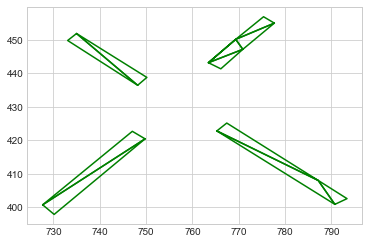

NOT VALID: POSITION
VALID:  False
position:  (895.4002954497491 @ 336.3014320736697)


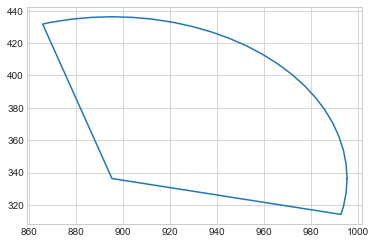

NOT VALID: POSITION
VALID:  False
position:  (2136.6303164865135 @ 904.4148782151628)


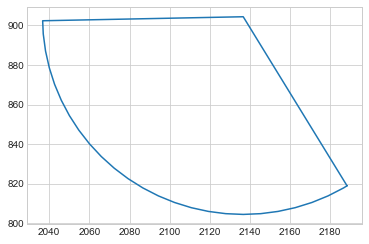

NOT VALID: POSITION
VALID:  False
position:  (1584.3433077962882 @ 857.9687820151938)


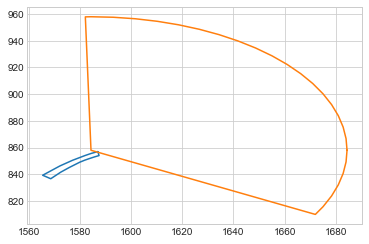

in Options class, polygonalRegions:  [<shapely.geometry.polygon.Polygon object at 0x2496d36d0>]


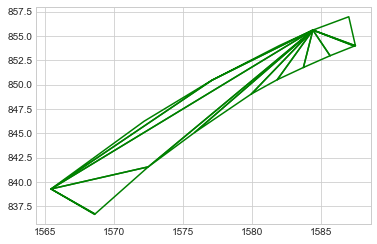

NOT VALID: POSITION
VALID:  False
position:  (2099.333778128445 @ 939.0473301445654)


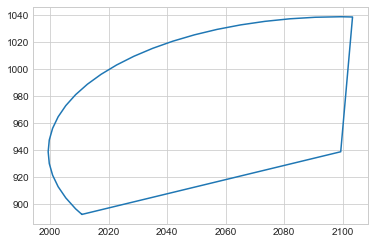

NOT VALID: POSITION
VALID:  False
position:  (581.8380060108252 @ 721.8082137128807)


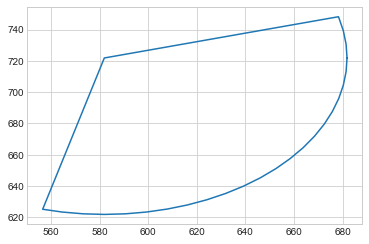

NOT VALID: POSITION
VALID:  False
position:  (1356.017901636973 @ 1130.4132539413422)


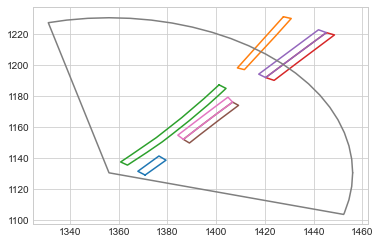

in Options class, polygonalRegions:  [<shapely.geometry.polygon.Polygon object at 0x24510fb80>, <shapely.geometry.polygon.Polygon object at 0x2499916a0>, <shapely.geometry.polygon.Polygon object at 0x2c5099d90>, <shapely.geometry.polygon.Polygon object at 0x2c50c1cd0>, <shapely.geometry.polygon.Polygon object at 0x2c50c98e0>, <shapely.geometry.polygon.Polygon object at 0x2c59e6d60>, <shapely.geometry.polygon.Polygon object at 0x2c59f1a30>]


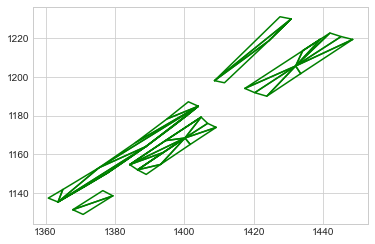

NOT VALID: POSITION
VALID:  False
position:  (777.1415156702392 @ 414.30946163490466)


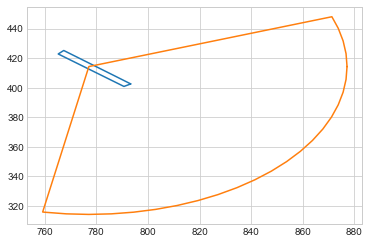

in Options class, polygonalRegions:  [<shapely.geometry.polygon.Polygon object at 0x248241550>]


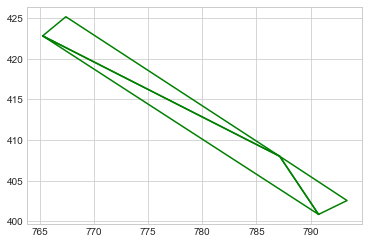

position is valid
heading:  4.008818587667649
within get_traffic_flow
point:  (777.1415156702392 @ 414.30946163490466)
heading output =  3.998104439752686
heading is valid
position:  (758.612 @ 442.184)
NOT VALID: POSITION
position:  (777.1415156702392 @ 414.30946163490466)
NOT VALID: POSITION
position:  (743.984 @ 443.739)
NOT VALID: POSITION
position:  (777.1415156702392 @ 414.30946163490466)
NOT VALID: POSITION
position:  (718.504 @ 472.716)
NOT VALID: POSITION
position:  (777.1415156702392 @ 414.30946163490466)
NOT VALID: POSITION
position:  (718.504 @ 472.716)
NOT VALID: POSITION
position:  (777.1415156702392 @ 414.30946163490466)
NOT VALID: POSITION
position:  (758.612 @ 442.184)
NOT VALID: POSITION
position:  (777.1415156702392 @ 414.30946163490466)
NOT VALID: POSITION
position:  (743.984 @ 443.739)
NOT VALID: POSITION
position:  (777.1415156702392 @ 414.30946163490466)
NOT VALID: POSITION
within get_traffic_flow
point:  (1068.0180498552645 @ 1381.1049171216964)
heading output =

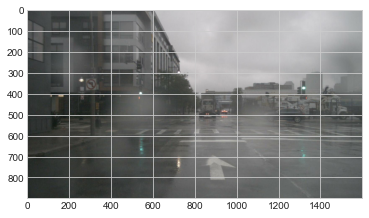

position:  (1539.3833694579694 @ 1318.5724864379408)


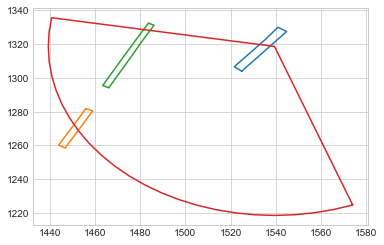

in Options class, polygonalRegions:  [<shapely.geometry.polygon.Polygon object at 0x2c475ae80>, <shapely.geometry.polygon.Polygon object at 0x2c54dabe0>, <shapely.geometry.polygon.Polygon object at 0x2c5b8e700>]


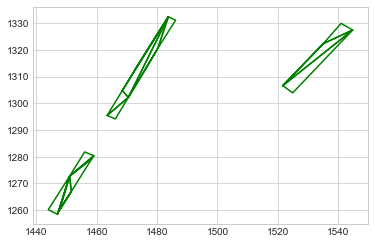

NOT VALID: POSITION
VALID:  False
position:  (2526.1627748922974 @ 839.2060235874085)


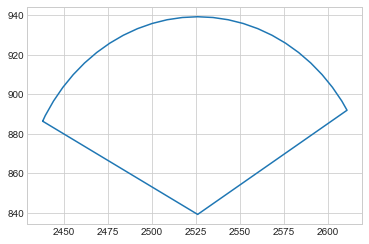

NOT VALID: POSITION
VALID:  False
position:  (1354.270684852907 @ 1128.7086774713152)


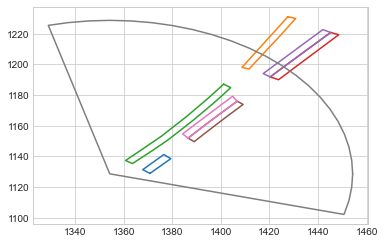

in Options class, polygonalRegions:  [<shapely.geometry.polygon.Polygon object at 0x24510fb80>, <shapely.geometry.polygon.Polygon object at 0x2499916a0>, <shapely.geometry.polygon.Polygon object at 0x2c5099d90>, <shapely.geometry.polygon.Polygon object at 0x2c50c1cd0>, <shapely.geometry.polygon.Polygon object at 0x2c50c98e0>, <shapely.geometry.polygon.Polygon object at 0x2c59e6d60>, <shapely.geometry.polygon.Polygon object at 0x2c59f1a30>]


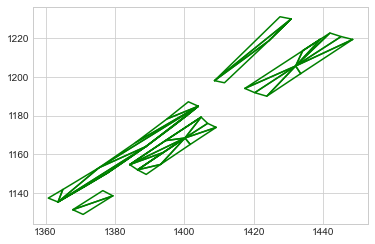

NOT VALID: POSITION
VALID:  False
position:  (1301.2033521276444 @ 896.073133016613)


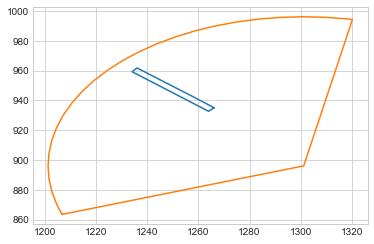

in Options class, polygonalRegions:  [<shapely.geometry.polygon.Polygon object at 0x2c5b37a90>]


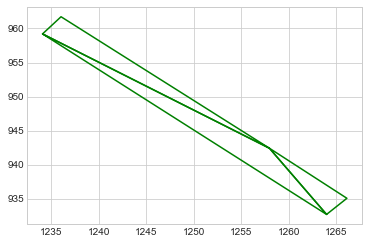

NOT VALID: POSITION
VALID:  False
position:  (1734.0963144250763 @ 1237.7411218131465)


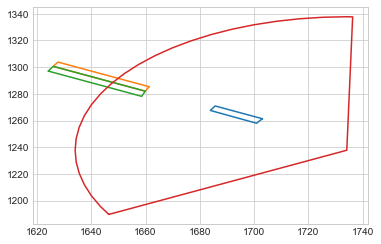

in Options class, polygonalRegions:  [<shapely.geometry.polygon.Polygon object at 0x2454fbcd0>, <shapely.geometry.polygon.Polygon object at 0x2480c9b50>, <shapely.geometry.polygon.Polygon object at 0x2480d2520>]


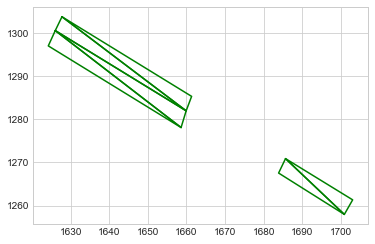

NOT VALID: POSITION
VALID:  False
position:  (1315.9168485073244 @ 1038.8494693880525)


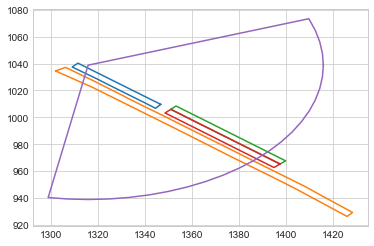

in Options class, polygonalRegions:  [<shapely.geometry.polygon.Polygon object at 0x2c4a4ceb0>, <shapely.geometry.polygon.Polygon object at 0x2c506e2b0>, <shapely.geometry.polygon.Polygon object at 0x2c5a697f0>, <shapely.geometry.polygon.Polygon object at 0x2c5a744c0>]


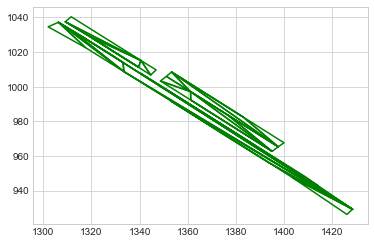

NOT VALID: POSITION
VALID:  False
position:  (894.8692807881034 @ 335.7514025918789)


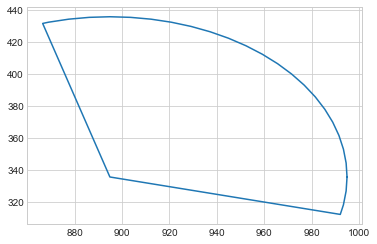

NOT VALID: POSITION
VALID:  False
position:  (1245.4993964393357 @ 946.9722392576317)


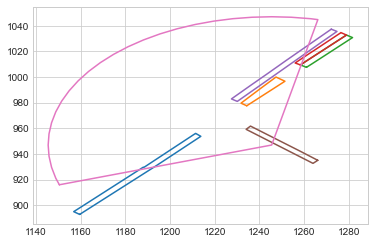

in Options class, polygonalRegions:  [<shapely.geometry.polygon.Polygon object at 0x24566e610>, <shapely.geometry.polygon.Polygon object at 0x263856160>, <shapely.geometry.polygon.Polygon object at 0x2c477a8e0>, <shapely.geometry.polygon.Polygon object at 0x2c47834f0>, <shapely.geometry.polygon.Polygon object at 0x2c594c370>, <shapely.geometry.polygon.Polygon object at 0x2c5b37a90>]


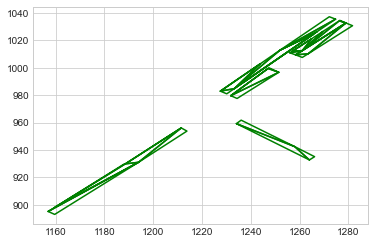

NOT VALID: POSITION
VALID:  False
position:  (1727.347692097278 @ 891.0520664655962)


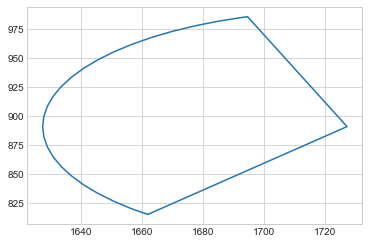

NOT VALID: POSITION
VALID:  False
position:  (822.4793168294404 @ 507.8929163873195)


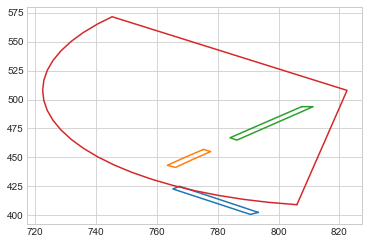

in Options class, polygonalRegions:  [<shapely.geometry.polygon.Polygon object at 0x248241550>, <shapely.geometry.polygon.Polygon object at 0x249b793a0>, <shapely.geometry.polygon.Polygon object at 0x263dce760>]


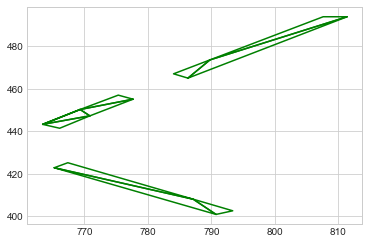

NOT VALID: POSITION
VALID:  False
position:  (1239.4882984852084 @ 960.7229537063149)


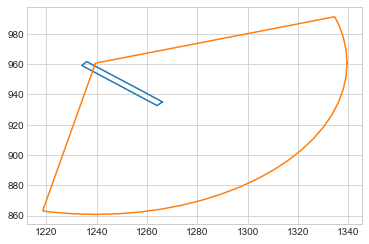

in Options class, polygonalRegions:  [<shapely.geometry.polygon.Polygon object at 0x2c5b37a90>]


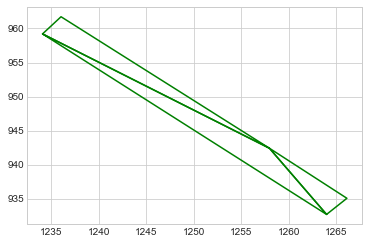

NOT VALID: POSITION
VALID:  False
position:  (802.092266085167 @ 520.8336418433419)


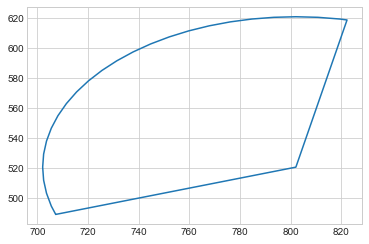

NOT VALID: POSITION
VALID:  False
position:  (2526.0817337017907 @ 810.3281690201959)


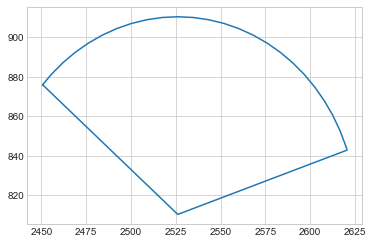

NOT VALID: POSITION
VALID:  False
position:  (2324.073359199802 @ 1012.4412909988472)


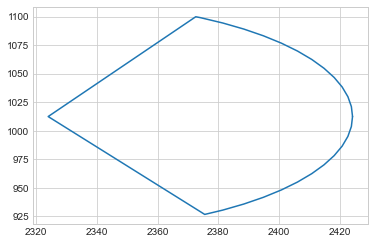

NOT VALID: POSITION
VALID:  False
position:  (447.6419963808801 @ 1704.6353404340807)


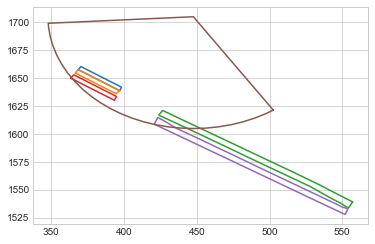

in Options class, polygonalRegions:  [<shapely.geometry.polygon.Polygon object at 0x248d0baf0>, <shapely.geometry.polygon.Polygon object at 0x248d12520>, <shapely.geometry.polygon.Polygon object at 0x24945ae20>, <shapely.geometry.polygon.Polygon object at 0x2c50ed880>, <shapely.geometry.polygon.Polygon object at 0x2c5cff4c0>]


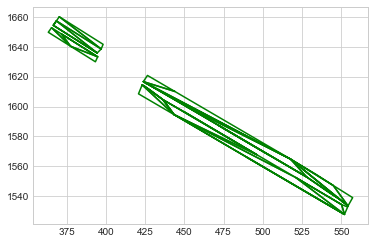

NOT VALID: POSITION
VALID:  False
position:  (1467.4404028707395 @ 906.708721788468)


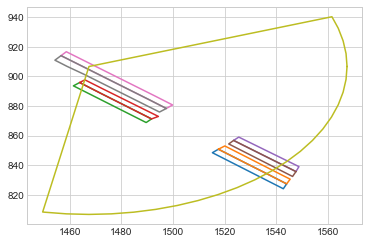

in Options class, polygonalRegions:  [<shapely.geometry.polygon.Polygon object at 0x248cee370>, <shapely.geometry.polygon.Polygon object at 0x248ceee80>, <shapely.geometry.polygon.Polygon object at 0x2c48543d0>, <shapely.geometry.polygon.Polygon object at 0x2c4854ee0>, <shapely.geometry.polygon.Polygon object at 0x2c51927c0>, <shapely.geometry.polygon.Polygon object at 0x2c519b1f0>, <shapely.geometry.polygon.Polygon object at 0x2c5c55970>, <shapely.geometry.polygon.Polygon object at 0x2c5c5d580>]


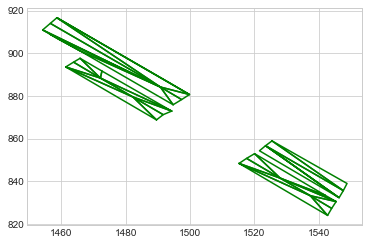

position is valid
heading:  4.008371528991287
within get_traffic_flow
point:  (1467.4404028707395 @ 906.708721788468)
heading output =  3.993938954957558
heading is valid
position:  (1441.265 @ 909.549)
NOT VALID: POSITION
position:  (1467.4404028707395 @ 906.708721788468)
NOT VALID: POSITION
position:  (1453.529 @ 956.105)
NOT VALID: POSITION
position:  (1467.4404028707395 @ 906.708721788468)
NOT VALID: POSITION
within get_traffic_flow
point:  (1524.621434289174 @ 1209.1426691953825)
heading output =  4.523681694801251
within get_traffic_flow
point:  (1515.8352125473946 @ 1213.2291503000863)
heading output =  4.526206403868347
VALID:  True


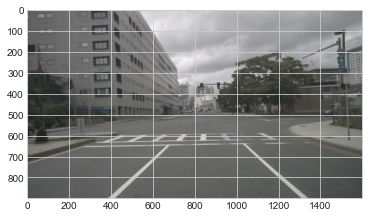

position:  (1185.1335442839309 @ 1134.898226165693)


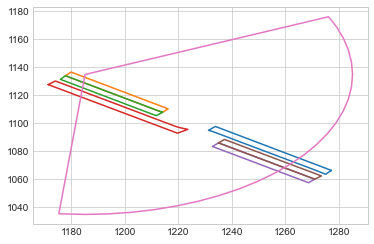

in Options class, polygonalRegions:  [<shapely.geometry.polygon.Polygon object at 0x248f88eb0>, <shapely.geometry.polygon.Polygon object at 0x263654640>, <shapely.geometry.polygon.Polygon object at 0x26365a250>, <shapely.geometry.polygon.Polygon object at 0x2c48e5c40>, <shapely.geometry.polygon.Polygon object at 0x2c5251070>, <shapely.geometry.polygon.Polygon object at 0x2c5251a60>]


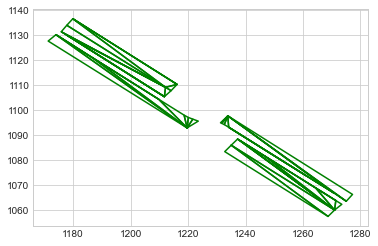

NOT VALID: POSITION
VALID:  False
position:  (1806.2244797122412 @ 1177.937026376894)


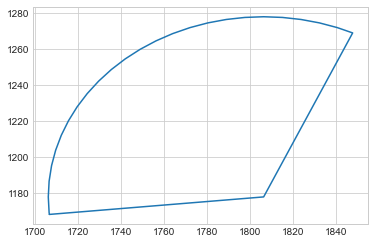

NOT VALID: POSITION
VALID:  False
position:  (2138.444424759289 @ 909.4151322409309)


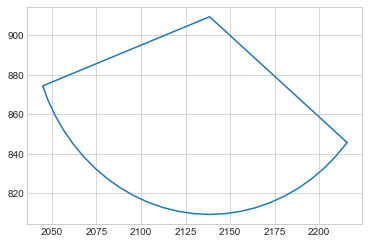

NOT VALID: POSITION
VALID:  False
position:  (1447.9146764307657 @ 1215.8028059148912)


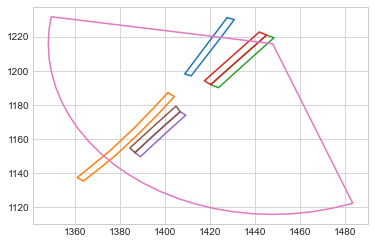

in Options class, polygonalRegions:  [<shapely.geometry.polygon.Polygon object at 0x2499916a0>, <shapely.geometry.polygon.Polygon object at 0x2c5099d90>, <shapely.geometry.polygon.Polygon object at 0x2c50c1cd0>, <shapely.geometry.polygon.Polygon object at 0x2c50c98e0>, <shapely.geometry.polygon.Polygon object at 0x2c59e6d60>, <shapely.geometry.polygon.Polygon object at 0x2c59f1a30>]


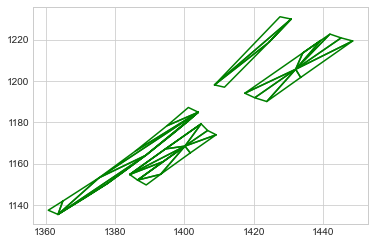

NOT VALID: POSITION
VALID:  False
position:  (309.1876700138364 @ 668.6675904066867)


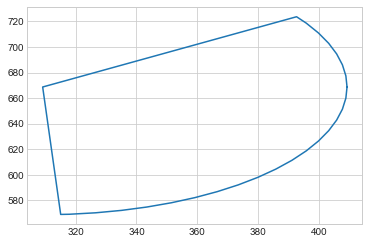

NOT VALID: POSITION
VALID:  False
position:  (900.1651684019939 @ 599.604206373558)


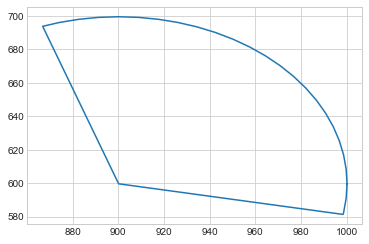

NOT VALID: POSITION
VALID:  False
position:  (1195.6462791332715 @ 1391.31251707201)


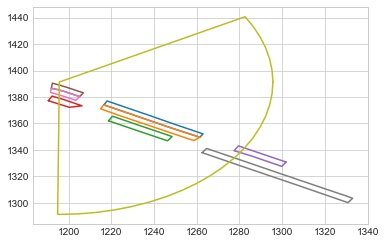

in Options class, polygonalRegions:  [<shapely.geometry.polygon.Polygon object at 0x248daa6d0>, <shapely.geometry.polygon.Polygon object at 0x248db33a0>, <shapely.geometry.polygon.Polygon object at 0x24941ee20>, <shapely.geometry.polygon.Polygon object at 0x2638910a0>, <shapely.geometry.polygon.Polygon object at 0x2640214c0>, <shapely.geometry.polygon.Polygon object at 0x2c4b24a00>, <shapely.geometry.polygon.Polygon object at 0x2c4b31670>, <shapely.geometry.polygon.Polygon object at 0x2c55fe0d0>]


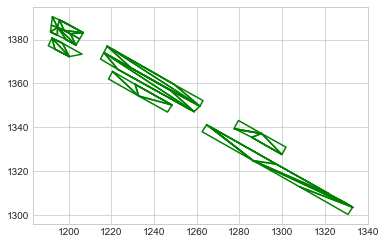

NOT VALID: POSITION
VALID:  False
position:  (2124.049169894738 @ 923.0863536798245)


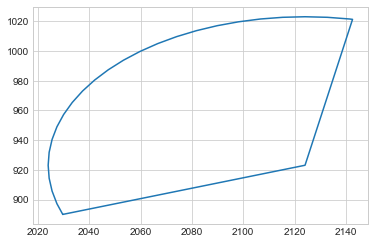

NOT VALID: POSITION
VALID:  False
position:  (1671.5078428470956 @ 1266.1296280909057)


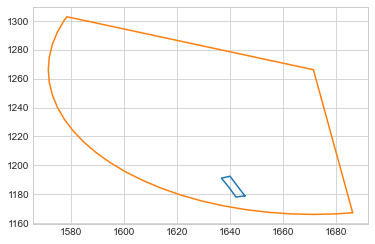

in Options class, polygonalRegions:  [<shapely.geometry.polygon.Polygon object at 0x2c437ccd0>]


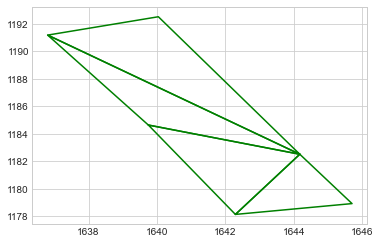

NOT VALID: POSITION
VALID:  False
position:  (1053.4383966489704 @ 1230.0356493717895)


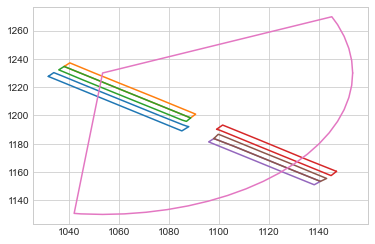

in Options class, polygonalRegions:  [<shapely.geometry.polygon.Polygon object at 0x247e11bb0>, <shapely.geometry.polygon.Polygon object at 0x2c3ccb3a0>, <shapely.geometry.polygon.Polygon object at 0x2c3ccbfd0>, <shapely.geometry.polygon.Polygon object at 0x2c3de77c0>, <shapely.geometry.polygon.Polygon object at 0x2c5bb1460>, <shapely.geometry.polygon.Polygon object at 0x2c5bbb130>]


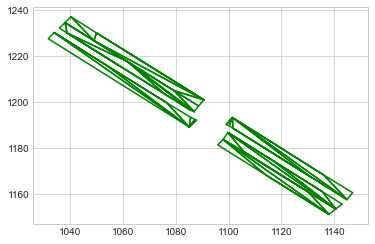

NOT VALID: POSITION
VALID:  False
position:  (1301.2033585193167 @ 896.0731274443301)


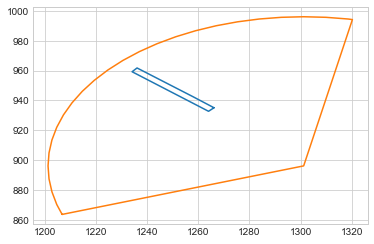

in Options class, polygonalRegions:  [<shapely.geometry.polygon.Polygon object at 0x2c5b37a90>]


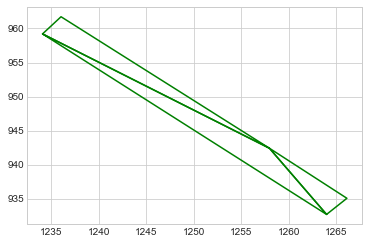

NOT VALID: POSITION
VALID:  False
position:  (759.924355087416 @ 1515.0297354262475)


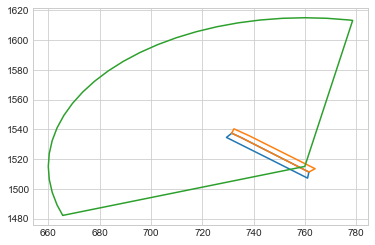

in Options class, polygonalRegions:  [<shapely.geometry.polygon.Polygon object at 0x2454b9a60>, <shapely.geometry.polygon.Polygon object at 0x2454c2670>]


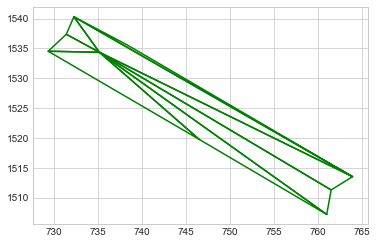

position is valid
heading:  0.859419940123508
within get_traffic_flow
point:  (759.924355087416 @ 1515.0297354262475)
heading output =  0.8619605002069616
heading is valid
position:  (761.545 @ 1508.955)
NOT VALID: POSITION
position:  (759.924355087416 @ 1515.0297354262475)
NOT VALID: POSITION
position:  (793.527 @ 1503.259)
NOT VALID: POSITION
position:  (759.924355087416 @ 1515.0297354262475)
NOT VALID: POSITION
within get_traffic_flow
point:  (463.6919666533023 @ 811.1372218518231)
heading output =  4.308298932715173
within get_traffic_flow
point:  (424.8654678313215 @ 829.849425039829)
heading output =  4.303655733602891
VALID:  True


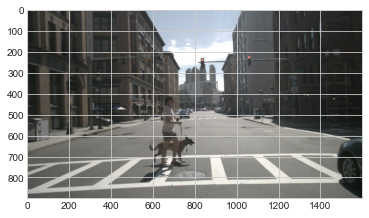

position:  (1868.4153126868434 @ 1066.2421490283912)


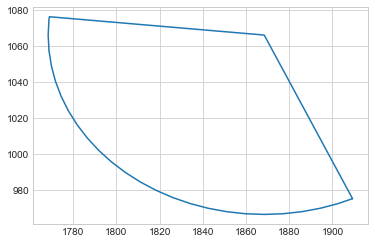

NOT VALID: POSITION
VALID:  False
position:  (1925.9125710003882 @ 1054.4358024553517)


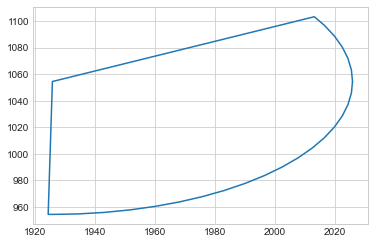

NOT VALID: POSITION
VALID:  False
position:  (2138.6772753329087 @ 913.2082381083194)


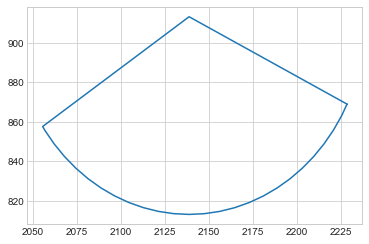

NOT VALID: POSITION
VALID:  False
position:  (2271.5067592269033 @ 868.9917919950312)


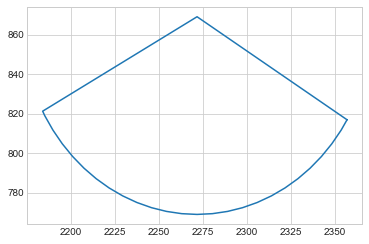

NOT VALID: POSITION
VALID:  False
position:  (870.3941620656358 @ 560.5272723949976)


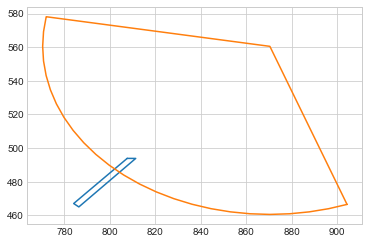

in Options class, polygonalRegions:  [<shapely.geometry.polygon.Polygon object at 0x263dce760>]


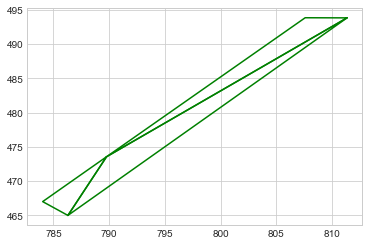

NOT VALID: POSITION
VALID:  False
position:  (1185.133456560633 @ 1134.8981097910114)


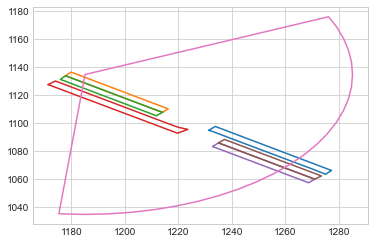

in Options class, polygonalRegions:  [<shapely.geometry.polygon.Polygon object at 0x248f88eb0>, <shapely.geometry.polygon.Polygon object at 0x263654640>, <shapely.geometry.polygon.Polygon object at 0x26365a250>, <shapely.geometry.polygon.Polygon object at 0x2c48e5c40>, <shapely.geometry.polygon.Polygon object at 0x2c5251070>, <shapely.geometry.polygon.Polygon object at 0x2c5251a60>]


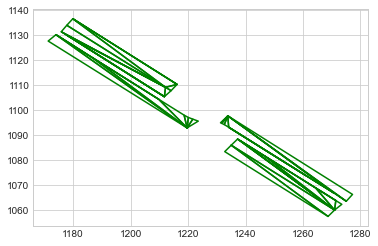

NOT VALID: POSITION
VALID:  False
position:  (2152.2261967146796 @ 788.5965807473574)


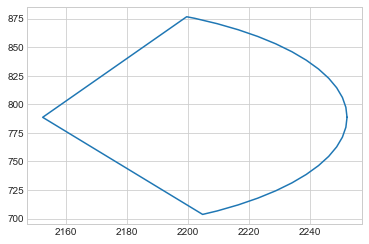

NOT VALID: POSITION
VALID:  False
position:  (770.0659181640976 @ 421.2352657844466)


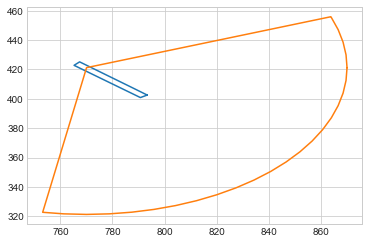

in Options class, polygonalRegions:  [<shapely.geometry.polygon.Polygon object at 0x248241550>]


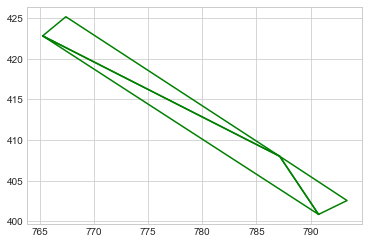

position is valid
heading:  4.019445942740751
within get_traffic_flow
point:  (770.0659181640976 @ 421.2352657844466)
heading output =  3.998104439752686
heading is valid
position:  (762.69 @ 426.047)
NOT VALID: POSITION
position:  (770.0659181640976 @ 421.2352657844466)
NOT VALID: POSITION
position:  (744.994 @ 441.715)
NOT VALID: POSITION
position:  (770.0659181640976 @ 421.2352657844466)
NOT VALID: POSITION
within get_traffic_flow
point:  (1326.5187583782574 @ 1023.8219072895138)
heading output =  3.9970114130560392
within get_traffic_flow
point:  (1343.9103246097006 @ 1012.3314238308693)
heading output =  3.9882307082586825
VALID:  True


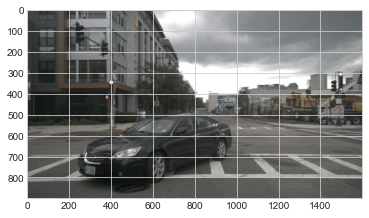

position:  (302.87920419376906 @ 672.5462053009322)


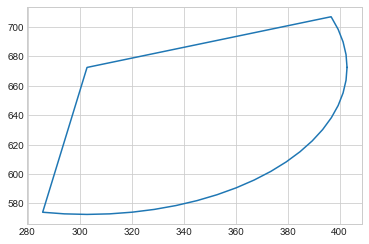

NOT VALID: POSITION
VALID:  False
position:  (1936.6257936549362 @ 870.2124428595533)


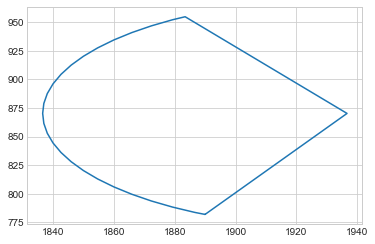

NOT VALID: POSITION
VALID:  False
position:  (1185.1335344811466 @ 1134.8982151972102)


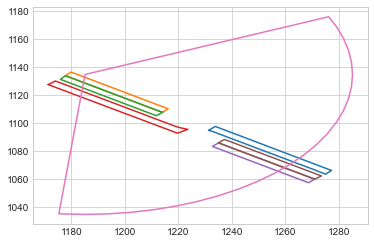

in Options class, polygonalRegions:  [<shapely.geometry.polygon.Polygon object at 0x248f88eb0>, <shapely.geometry.polygon.Polygon object at 0x263654640>, <shapely.geometry.polygon.Polygon object at 0x26365a250>, <shapely.geometry.polygon.Polygon object at 0x2c48e5c40>, <shapely.geometry.polygon.Polygon object at 0x2c5251070>, <shapely.geometry.polygon.Polygon object at 0x2c5251a60>]


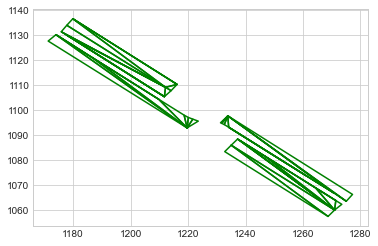

NOT VALID: POSITION
VALID:  False
position:  (1461.15496356978 @ 912.4545287598937)


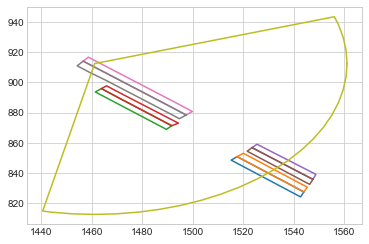

in Options class, polygonalRegions:  [<shapely.geometry.polygon.Polygon object at 0x248cee370>, <shapely.geometry.polygon.Polygon object at 0x248ceee80>, <shapely.geometry.polygon.Polygon object at 0x2c48543d0>, <shapely.geometry.polygon.Polygon object at 0x2c4854ee0>, <shapely.geometry.polygon.Polygon object at 0x2c51927c0>, <shapely.geometry.polygon.Polygon object at 0x2c519b1f0>, <shapely.geometry.polygon.Polygon object at 0x2c5c55970>, <shapely.geometry.polygon.Polygon object at 0x2c5c5d580>]


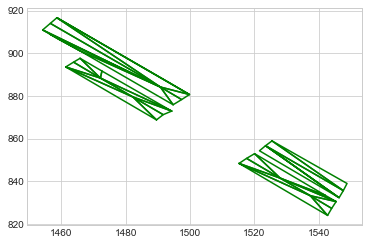

position is valid
heading:  3.9811394058857643
within get_traffic_flow
point:  (1461.15496356978 @ 912.4545287598937)
heading output =  3.993938954957558
heading is valid
position:  (1452.2 @ 929.922)
NOT VALID: POSITION
position:  (1461.15496356978 @ 912.4545287598937)
NOT VALID: POSITION
position:  (1431.5 @ 926.517)
NOT VALID: POSITION
position:  (1461.15496356978 @ 912.4545287598937)
NOT VALID: POSITION
position:  (1448.882 @ 950.373)
NOT VALID: POSITION
position:  (1461.15496356978 @ 912.4545287598937)
NOT VALID: POSITION
position:  (1448.882 @ 950.373)
NOT VALID: POSITION
position:  (1461.15496356978 @ 912.4545287598937)
NOT VALID: POSITION
position:  (1452.2 @ 929.922)
NOT VALID: POSITION
position:  (1461.15496356978 @ 912.4545287598937)
NOT VALID: POSITION
position:  (1431.5 @ 926.517)
NOT VALID: POSITION
position:  (1461.15496356978 @ 912.4545287598937)
NOT VALID: POSITION
within get_traffic_flow
point:  (1102.0926336439575 @ 828.2334575245898)
heading output =  2.422956878877

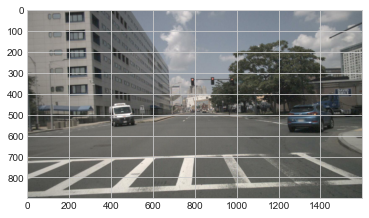

position:  (1247.9424953931766 @ 944.761911255473)


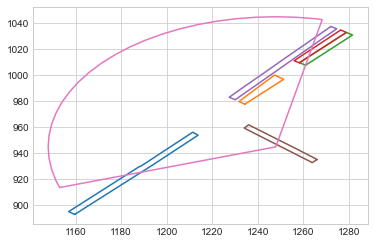

in Options class, polygonalRegions:  [<shapely.geometry.polygon.Polygon object at 0x24566e610>, <shapely.geometry.polygon.Polygon object at 0x263856160>, <shapely.geometry.polygon.Polygon object at 0x2c477a8e0>, <shapely.geometry.polygon.Polygon object at 0x2c47834f0>, <shapely.geometry.polygon.Polygon object at 0x2c594c370>, <shapely.geometry.polygon.Polygon object at 0x2c5b37a90>]


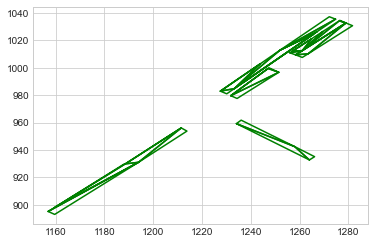

NOT VALID: POSITION
VALID:  False
position:  (1936.5404802361013 @ 866.0672712774175)


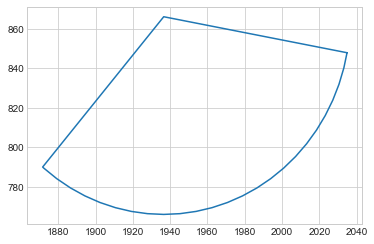

NOT VALID: POSITION
VALID:  False
position:  (1853.4666909818584 @ 1044.745395278941)


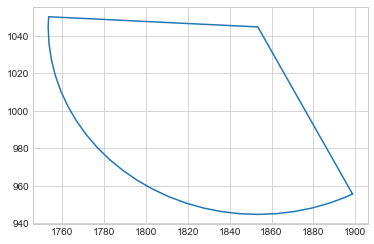

NOT VALID: POSITION
VALID:  False
position:  (2271.427395509739 @ 867.7310960074873)


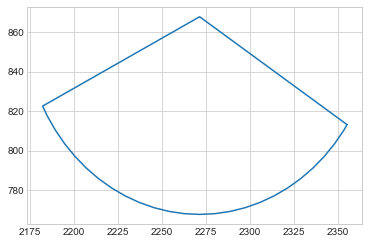

NOT VALID: POSITION
VALID:  False
position:  (2525.462718966117 @ 808.0471823516796)


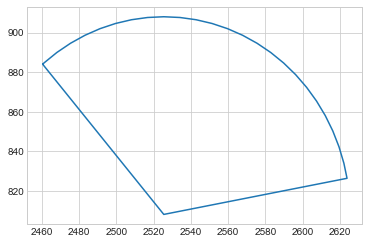

NOT VALID: POSITION
VALID:  False
position:  (449.03328587166834 @ 1707.3429733256485)


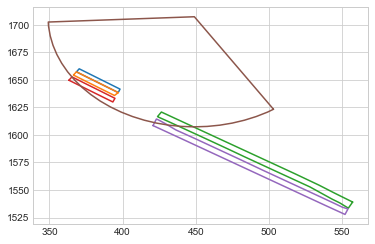

in Options class, polygonalRegions:  [<shapely.geometry.polygon.Polygon object at 0x248d0baf0>, <shapely.geometry.polygon.Polygon object at 0x248d12520>, <shapely.geometry.polygon.Polygon object at 0x24945ae20>, <shapely.geometry.polygon.Polygon object at 0x2c50ed880>, <shapely.geometry.polygon.Polygon object at 0x2c5cff4c0>]


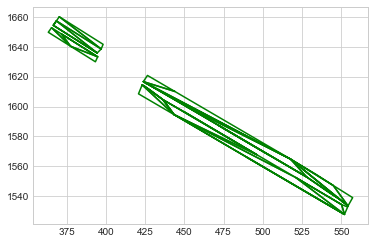

NOT VALID: POSITION
VALID:  False
position:  (1301.2033567534795 @ 896.0731289849257)


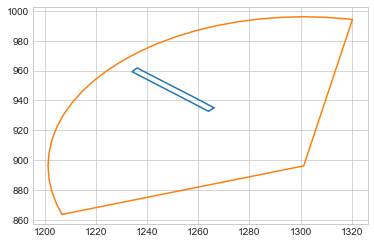

in Options class, polygonalRegions:  [<shapely.geometry.polygon.Polygon object at 0x2c5b37a90>]


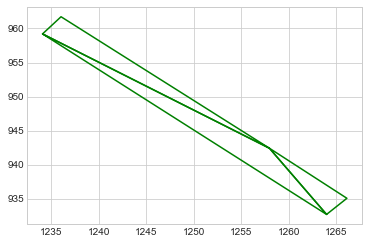

NOT VALID: POSITION
VALID:  False
position:  (752.3026136244864 @ 569.1144223817053)


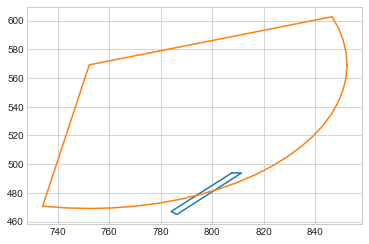

in Options class, polygonalRegions:  [<shapely.geometry.polygon.Polygon object at 0x263dce760>]


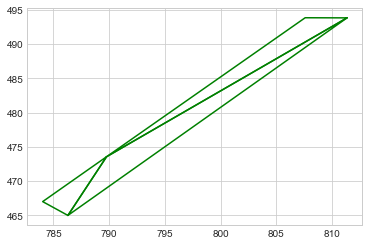

NOT VALID: POSITION
VALID:  False
position:  (791.6494387329265 @ 402.3045442169557)


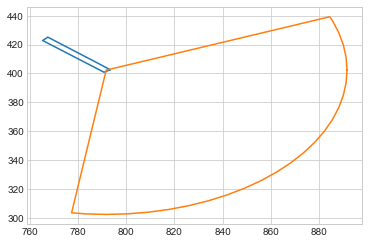

in Options class, polygonalRegions:  [<shapely.geometry.polygon.Polygon object at 0x248241550>]


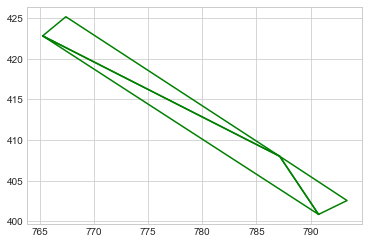

position is valid
heading:  4.044425990407354
within get_traffic_flow
point:  (791.6494387329265 @ 402.3045442169557)
heading output =  3.998104439752686
heading is valid
position:  (739.578 @ 450.318)
NOT VALID: POSITION
position:  (791.6494387329265 @ 402.3045442169557)
NOT VALID: POSITION
position:  (734.694 @ 454.051)
NOT VALID: POSITION
position:  (791.6494387329265 @ 402.3045442169557)
NOT VALID: POSITION
position:  (722.605 @ 457.885)
NOT VALID: POSITION
position:  (791.6494387329265 @ 402.3045442169557)
NOT VALID: POSITION
position:  (722.605 @ 457.885)
NOT VALID: POSITION
position:  (791.6494387329265 @ 402.3045442169557)
NOT VALID: POSITION
position:  (739.578 @ 450.318)
NOT VALID: POSITION
position:  (791.6494387329265 @ 402.3045442169557)
NOT VALID: POSITION
position:  (734.694 @ 454.051)
NOT VALID: POSITION
position:  (791.6494387329265 @ 402.3045442169557)
NOT VALID: POSITION
within get_traffic_flow
point:  (1383.998615580315 @ 1435.903390868571)
heading output =  4.20880

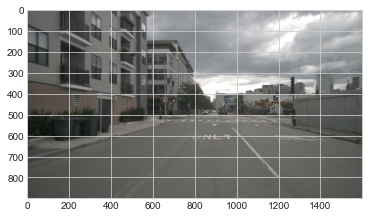

position:  (1934.9103747843203 @ 868.8226063867723)


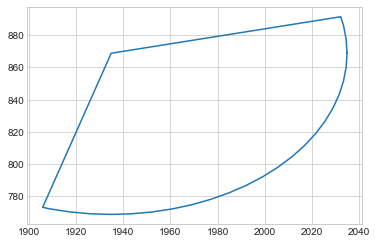

NOT VALID: POSITION
VALID:  False
position:  (420.9619468337496 @ 617.9317965123508)


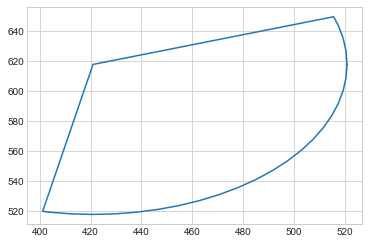

NOT VALID: POSITION
VALID:  False
position:  (509.27416801691584 @ 1572.5688456748221)


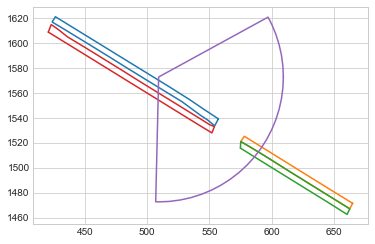

in Options class, polygonalRegions:  [<shapely.geometry.polygon.Polygon object at 0x24945ae20>, <shapely.geometry.polygon.Polygon object at 0x2c4f71be0>, <shapely.geometry.polygon.Polygon object at 0x2c4f7d910>, <shapely.geometry.polygon.Polygon object at 0x2c5cff4c0>]


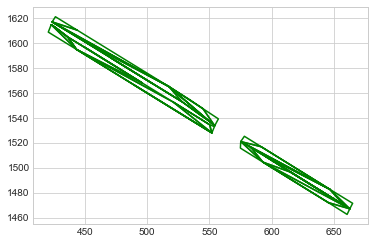

NOT VALID: POSITION
VALID:  False
position:  (1868.8366134545704 @ 1067.4101571975752)


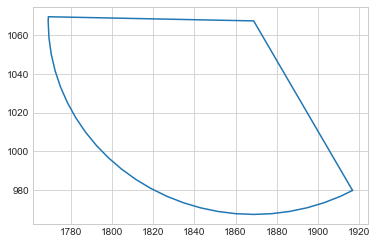

NOT VALID: POSITION
VALID:  False
position:  (2114.886131204962 @ 874.2966696833018)


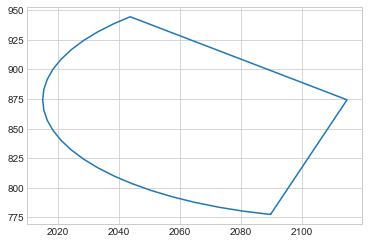

NOT VALID: POSITION
VALID:  False
position:  (770.0659175778351 @ 421.2352662842021)


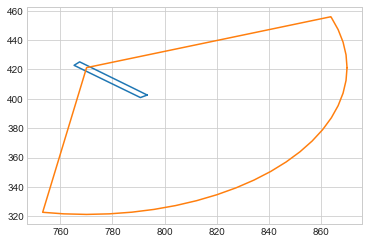

in Options class, polygonalRegions:  [<shapely.geometry.polygon.Polygon object at 0x248241550>]


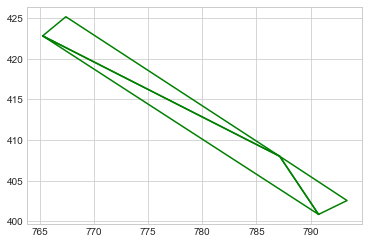

position is valid
heading:  4.019361545126404
within get_traffic_flow
point:  (770.0659175778351 @ 421.2352662842021)
heading output =  3.998104439752686
heading is valid
position:  (764.149 @ 443.475)
NOT VALID: POSITION
position:  (770.0659175778351 @ 421.2352662842021)
NOT VALID: POSITION
position:  (745.036 @ 441.672)
NOT VALID: POSITION
position:  (770.0659175778351 @ 421.2352662842021)
NOT VALID: POSITION
within get_traffic_flow
point:  (1162.6715902103388 @ 1563.725356324021)
heading output =  0.9885226208539324
within get_traffic_flow
point:  (1175.210864445351 @ 1546.8176341211931)
heading output =  1.0032839932692528
VALID:  True


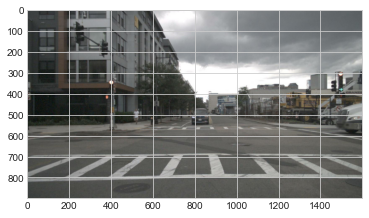

position:  (2035.8499508658601 @ 984.5335270515343)


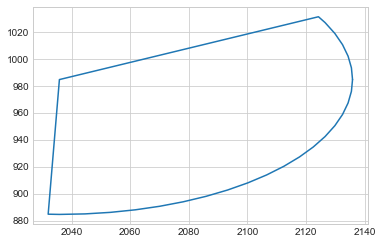

NOT VALID: POSITION
VALID:  False
position:  (1185.1007563605883 @ 1134.9241609705832)


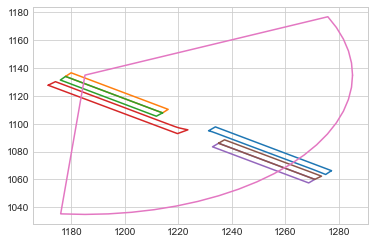

in Options class, polygonalRegions:  [<shapely.geometry.polygon.Polygon object at 0x248f88eb0>, <shapely.geometry.polygon.Polygon object at 0x263654640>, <shapely.geometry.polygon.Polygon object at 0x26365a250>, <shapely.geometry.polygon.Polygon object at 0x2c48e5c40>, <shapely.geometry.polygon.Polygon object at 0x2c5251070>, <shapely.geometry.polygon.Polygon object at 0x2c5251a60>]


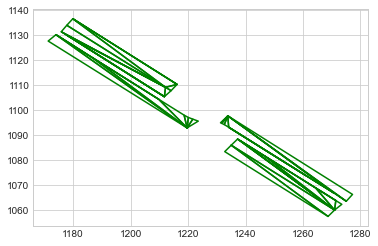

NOT VALID: POSITION
VALID:  False
position:  (1897.4566777956738 @ 1070.817309878778)


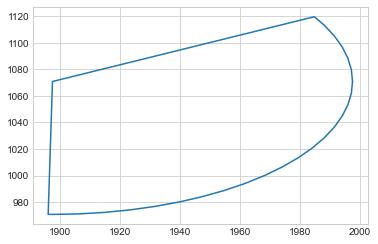

NOT VALID: POSITION
VALID:  False
position:  (1834.702386129547 @ 1238.5921749062356)


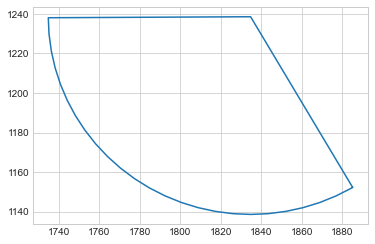

NOT VALID: POSITION
VALID:  False
position:  (759.9245883976064 @ 1515.0300050067874)


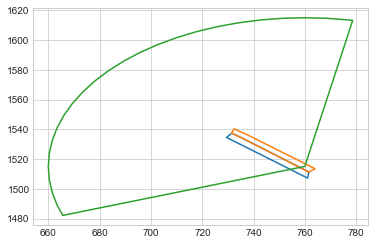

in Options class, polygonalRegions:  [<shapely.geometry.polygon.Polygon object at 0x2454b9a60>, <shapely.geometry.polygon.Polygon object at 0x2454c2670>]


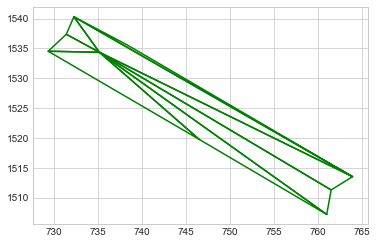

position is valid
heading:  0.8594946826520257
within get_traffic_flow
point:  (759.9245883976064 @ 1515.0300050067874)
heading output =  0.8619605002069616
heading is valid
position:  (761.545 @ 1508.955)
NOT VALID: POSITION
position:  (759.9245883976064 @ 1515.0300050067874)
NOT VALID: POSITION
position:  (793.527 @ 1503.259)
NOT VALID: POSITION
position:  (759.9245883976064 @ 1515.0300050067874)
NOT VALID: POSITION
within get_traffic_flow
point:  (386.25708979999035 @ 1829.0425702075217)
heading output =  3.7955469720182773
within get_traffic_flow
point:  (392.11509676670204 @ 1823.574979058056)
heading output =  3.728345414804293
VALID:  True


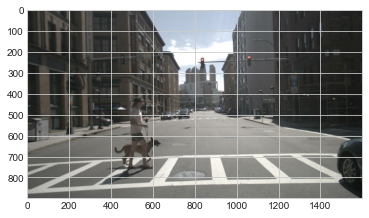

position:  (787.4842217807836 @ 405.87371100063)


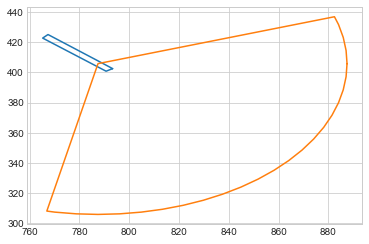

in Options class, polygonalRegions:  [<shapely.geometry.polygon.Polygon object at 0x248241550>]


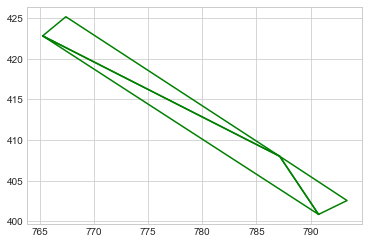

position is valid
heading:  3.9816906634169897
within get_traffic_flow
point:  (787.4842217807836 @ 405.87371100063)
heading output =  3.998104439752686
heading is valid
position:  (735.295 @ 454.117)
NOT VALID: POSITION
position:  (787.4842217807836 @ 405.87371100063)
NOT VALID: POSITION
within get_traffic_flow
point:  (1368.0360188089571 @ 1443.2155083472892)
heading output =  4.209217146672817
within get_traffic_flow
point:  (1358.824077288552 @ 1456.0535965712684)
heading output =  4.21109020664863
VALID:  True


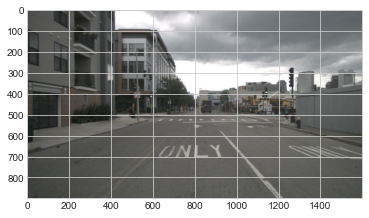

position:  (1929.623813672728 @ 1052.2071190257955)


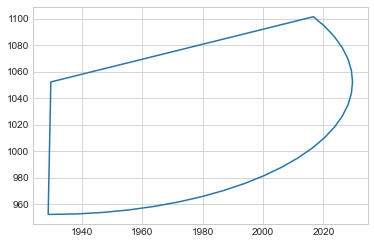

NOT VALID: POSITION
VALID:  False
position:  (1868.4227938114861 @ 1066.253406346063)


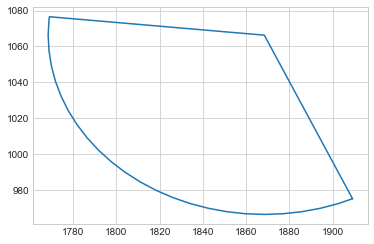

NOT VALID: POSITION
VALID:  False
position:  (1185.1334433059167 @ 1134.8980901836205)


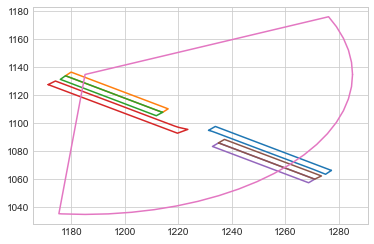

in Options class, polygonalRegions:  [<shapely.geometry.polygon.Polygon object at 0x248f88eb0>, <shapely.geometry.polygon.Polygon object at 0x263654640>, <shapely.geometry.polygon.Polygon object at 0x26365a250>, <shapely.geometry.polygon.Polygon object at 0x2c48e5c40>, <shapely.geometry.polygon.Polygon object at 0x2c5251070>, <shapely.geometry.polygon.Polygon object at 0x2c5251a60>]


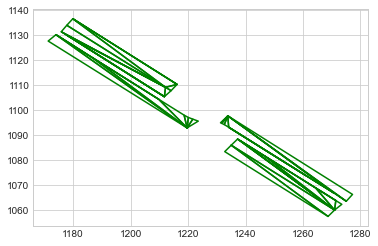

NOT VALID: POSITION
VALID:  False
position:  (1185.1333816760357 @ 1134.8980003517415)


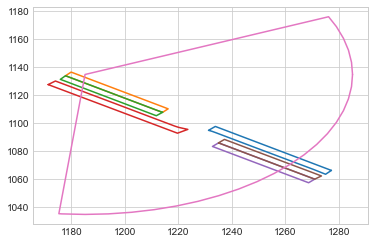

in Options class, polygonalRegions:  [<shapely.geometry.polygon.Polygon object at 0x248f88eb0>, <shapely.geometry.polygon.Polygon object at 0x263654640>, <shapely.geometry.polygon.Polygon object at 0x26365a250>, <shapely.geometry.polygon.Polygon object at 0x2c48e5c40>, <shapely.geometry.polygon.Polygon object at 0x2c5251070>, <shapely.geometry.polygon.Polygon object at 0x2c5251a60>]


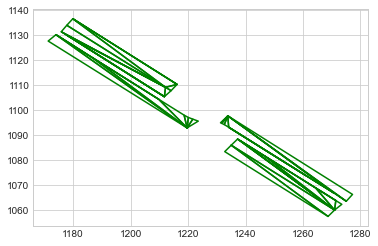

NOT VALID: POSITION
VALID:  False
position:  (770.0659151787863 @ 421.2352682679548)


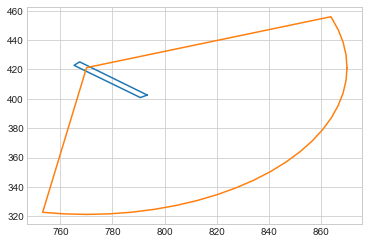

in Options class, polygonalRegions:  [<shapely.geometry.polygon.Polygon object at 0x248241550>]


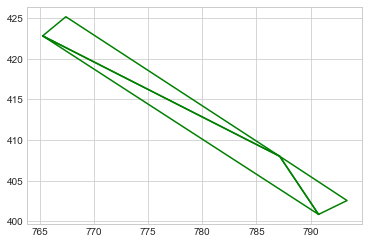

position is valid
heading:  4.0194850388868
within get_traffic_flow
point:  (770.0659151787863 @ 421.2352682679548)
heading output =  3.998104439752686
heading is valid
position:  (764.058 @ 423.333)
NOT VALID: POSITION
position:  (770.0659151787863 @ 421.2352682679548)
NOT VALID: POSITION
position:  (745.002 @ 441.707)
NOT VALID: POSITION
position:  (770.0659151787863 @ 421.2352682679548)
NOT VALID: POSITION
within get_traffic_flow
point:  (887.7524577213923 @ 1441.52380879447)
heading output =  -0.5225618101871468
within get_traffic_flow
point:  (893.1814766878899 @ 1459.2606084480658)
heading output =  -0.5172431142234579
VALID:  True


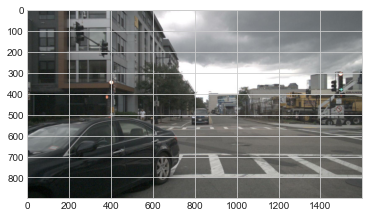

position:  (1185.1335449343437 @ 1134.8982257415194)


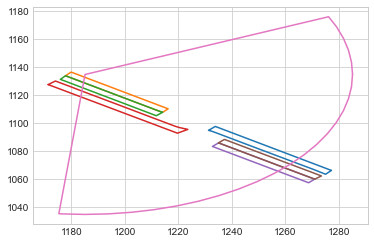

in Options class, polygonalRegions:  [<shapely.geometry.polygon.Polygon object at 0x248f88eb0>, <shapely.geometry.polygon.Polygon object at 0x263654640>, <shapely.geometry.polygon.Polygon object at 0x26365a250>, <shapely.geometry.polygon.Polygon object at 0x2c48e5c40>, <shapely.geometry.polygon.Polygon object at 0x2c5251070>, <shapely.geometry.polygon.Polygon object at 0x2c5251a60>]


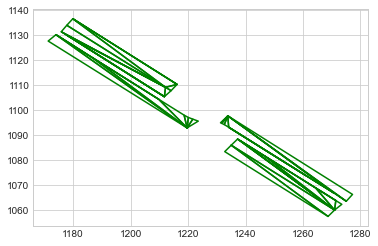

NOT VALID: POSITION
VALID:  False
position:  (1818.243684656277 @ 1216.6378629854808)


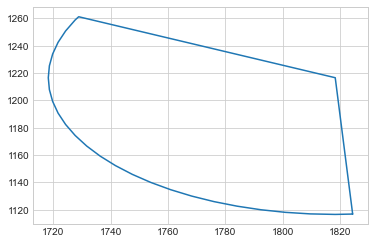

NOT VALID: POSITION
VALID:  False
position:  (2164.081820635511 @ 788.9733057859266)


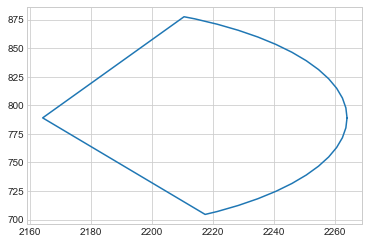

NOT VALID: POSITION
VALID:  False
position:  (1862.171539884276 @ 1056.985713171299)


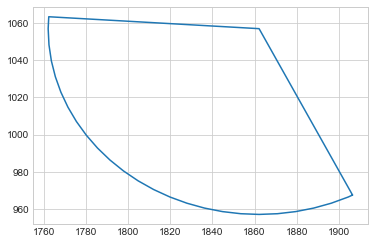

NOT VALID: POSITION
VALID:  False
position:  (2133.231394475883 @ 898.9227121810295)


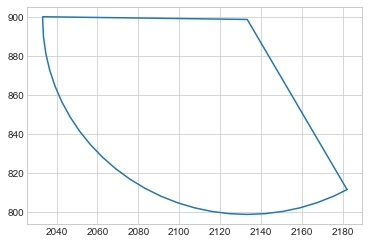

NOT VALID: POSITION
VALID:  False
position:  (1910.3459118806527 @ 1063.4096150916334)


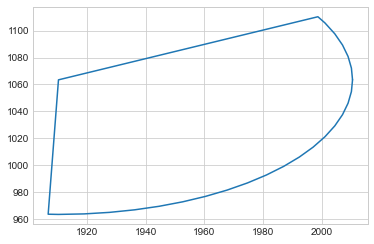

NOT VALID: POSITION
VALID:  False
position:  (309.18607318894055 @ 668.6646195694858)


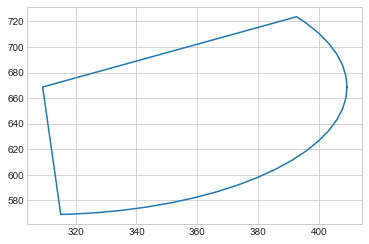

NOT VALID: POSITION
VALID:  False
position:  (451.56706794485126 @ 812.214636970924)


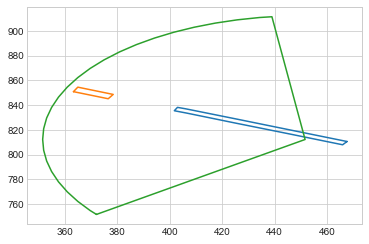

in Options class, polygonalRegions:  [<shapely.geometry.polygon.Polygon object at 0x2495d0400>, <shapely.geometry.polygon.Polygon object at 0x264439d60>]


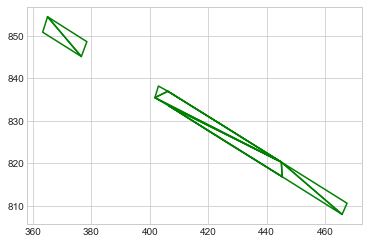

NOT VALID: POSITION
VALID:  False
position:  (803.2265237160318 @ 519.8136174790839)


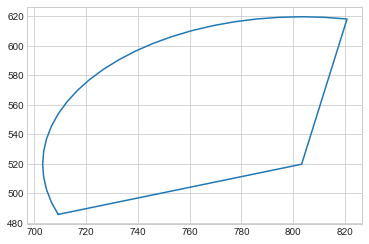

NOT VALID: POSITION
VALID:  False
position:  (1185.1335407910535 @ 1134.8982225684115)


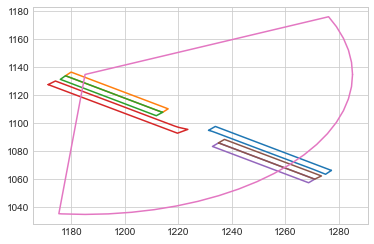

in Options class, polygonalRegions:  [<shapely.geometry.polygon.Polygon object at 0x248f88eb0>, <shapely.geometry.polygon.Polygon object at 0x263654640>, <shapely.geometry.polygon.Polygon object at 0x26365a250>, <shapely.geometry.polygon.Polygon object at 0x2c48e5c40>, <shapely.geometry.polygon.Polygon object at 0x2c5251070>, <shapely.geometry.polygon.Polygon object at 0x2c5251a60>]


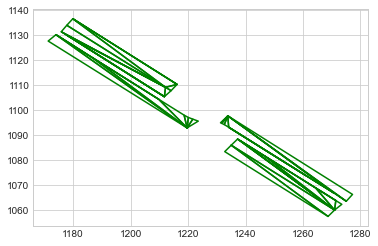

NOT VALID: POSITION
VALID:  False
position:  (2013.030031778193 @ 788.6527183468392)


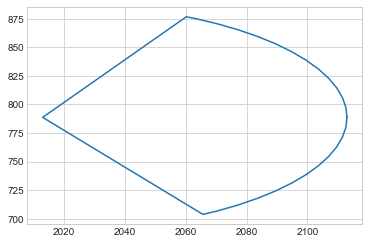

NOT VALID: POSITION
VALID:  False
position:  (2111.603338664474 @ 939.1619884915847)


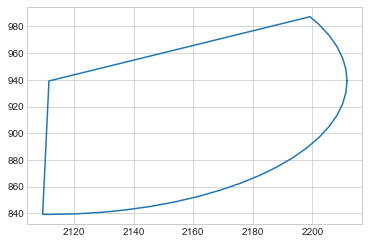

NOT VALID: POSITION
VALID:  False
position:  (1185.1335365388636 @ 1134.8982184691386)


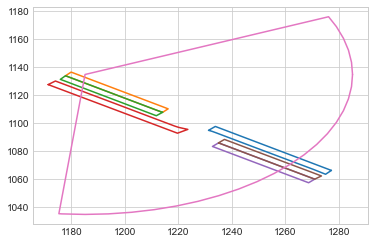

in Options class, polygonalRegions:  [<shapely.geometry.polygon.Polygon object at 0x248f88eb0>, <shapely.geometry.polygon.Polygon object at 0x263654640>, <shapely.geometry.polygon.Polygon object at 0x26365a250>, <shapely.geometry.polygon.Polygon object at 0x2c48e5c40>, <shapely.geometry.polygon.Polygon object at 0x2c5251070>, <shapely.geometry.polygon.Polygon object at 0x2c5251a60>]


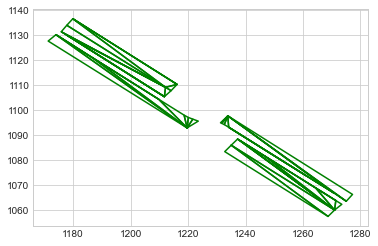

NOT VALID: POSITION
VALID:  False
position:  (1731.2115080549258 @ 1239.5238811798595)


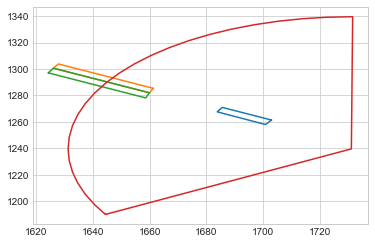

in Options class, polygonalRegions:  [<shapely.geometry.polygon.Polygon object at 0x2454fbcd0>, <shapely.geometry.polygon.Polygon object at 0x2480c9b50>, <shapely.geometry.polygon.Polygon object at 0x2480d2520>]


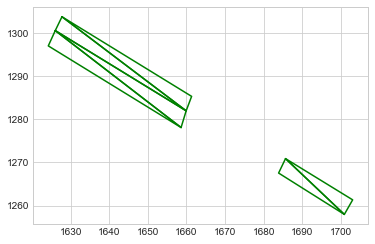

NOT VALID: POSITION
VALID:  False
position:  (423.6572238712224 @ 615.5715157850376)


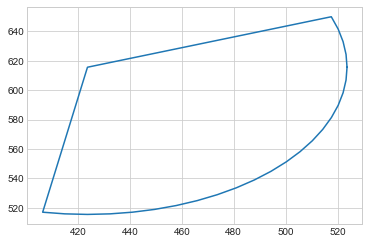

NOT VALID: POSITION
VALID:  False
position:  (1032.9135970407299 @ 494.0730412879435)


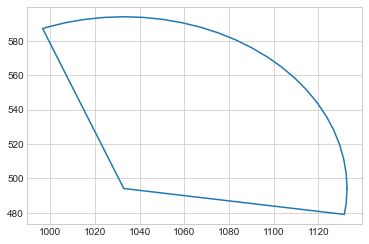

NOT VALID: POSITION
VALID:  False
position:  (2101.9941124685984 @ 937.3554847608432)


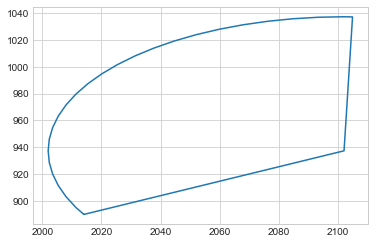

NOT VALID: POSITION
VALID:  False
position:  (584.5952215698567 @ 719.0331350093427)


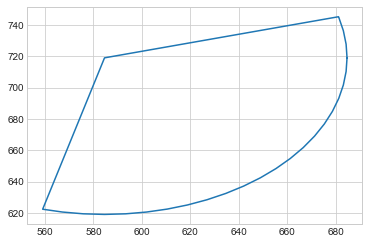

NOT VALID: POSITION
VALID:  False
position:  (2525.904095090724 @ 834.23895086573)


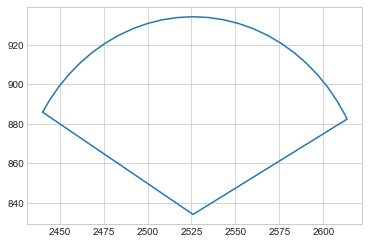

NOT VALID: POSITION
VALID:  False
position:  (1539.383388561357 @ 1318.5724696071525)


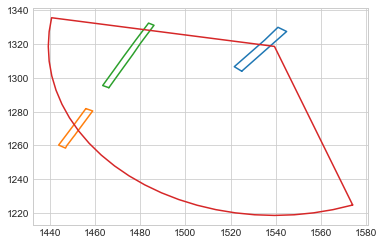

in Options class, polygonalRegions:  [<shapely.geometry.polygon.Polygon object at 0x2c475ae80>, <shapely.geometry.polygon.Polygon object at 0x2c54dabe0>, <shapely.geometry.polygon.Polygon object at 0x2c5b8e700>]


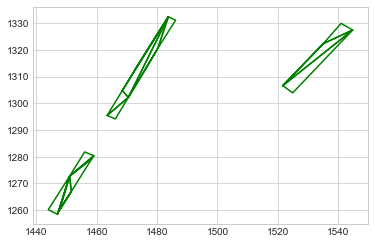

NOT VALID: POSITION
VALID:  False
position:  (2321.9401254886016 @ 1012.512548547352)


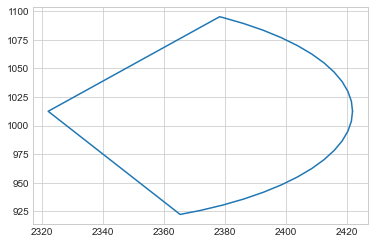

NOT VALID: POSITION
VALID:  False
position:  (1807.585855698392 @ 1176.1344359248342)


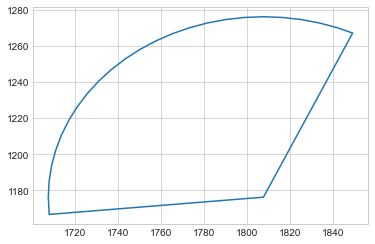

NOT VALID: POSITION
VALID:  False
position:  (1668.876687657889 @ 943.913350094641)


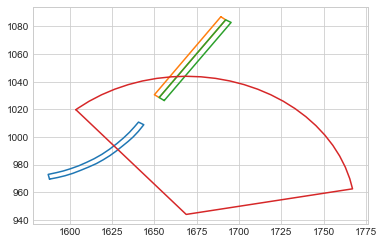

in Options class, polygonalRegions:  [<shapely.geometry.polygon.Polygon object at 0x248064730>, <shapely.geometry.polygon.Polygon object at 0x2494924c0>, <shapely.geometry.polygon.Polygon object at 0x249492e50>]


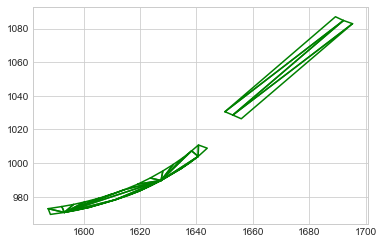

NOT VALID: POSITION
VALID:  False
position:  (549.2377005756398 @ 1675.0052626468348)


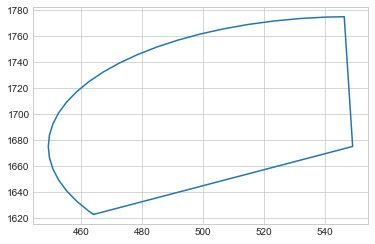

NOT VALID: POSITION
VALID:  False
position:  (1447.9146778894433 @ 1215.8028077095573)


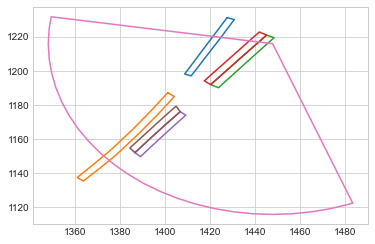

in Options class, polygonalRegions:  [<shapely.geometry.polygon.Polygon object at 0x2499916a0>, <shapely.geometry.polygon.Polygon object at 0x2c5099d90>, <shapely.geometry.polygon.Polygon object at 0x2c50c1cd0>, <shapely.geometry.polygon.Polygon object at 0x2c50c98e0>, <shapely.geometry.polygon.Polygon object at 0x2c59e6d60>, <shapely.geometry.polygon.Polygon object at 0x2c59f1a30>]


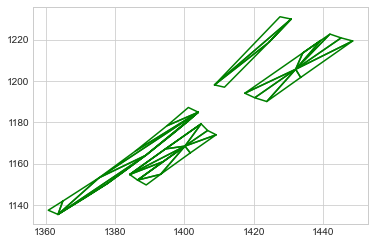

NOT VALID: POSITION
VALID:  False
position:  (309.187757146532 @ 668.6676171170833)


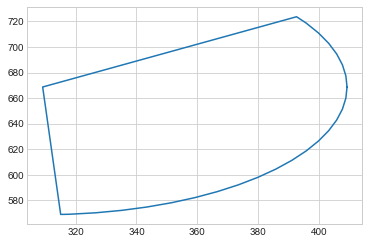

NOT VALID: POSITION
VALID:  False
position:  (744.8218457498724 @ 569.612998389856)


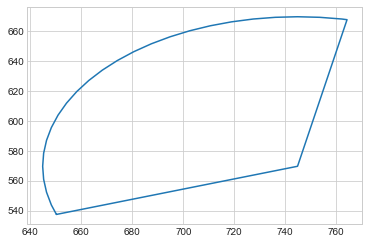

NOT VALID: POSITION
VALID:  False
position:  (2124.073289032744 @ 923.0754055176409)


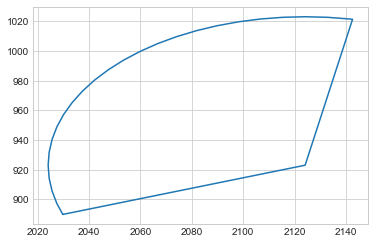

NOT VALID: POSITION
VALID:  False
position:  (755.6420882612019 @ 1518.8670619198924)


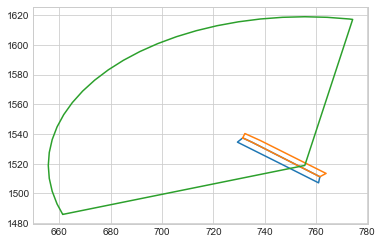

in Options class, polygonalRegions:  [<shapely.geometry.polygon.Polygon object at 0x2454b9a60>, <shapely.geometry.polygon.Polygon object at 0x2454c2670>]


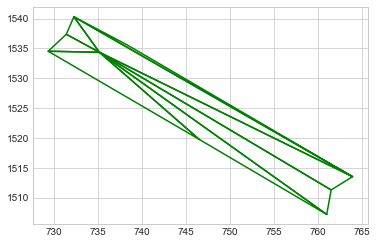

position is valid
heading:  0.8594132486960822
within get_traffic_flow
point:  (755.6420882612019 @ 1518.8670619198924)
heading output =  0.8619605002069616
heading is valid
position:  (761.379 @ 1509.136)
NOT VALID: POSITION
position:  (755.6420882612019 @ 1518.8670619198924)
NOT VALID: POSITION
position:  (764.561 @ 1492.439)
NOT VALID: POSITION
position:  (755.6420882612019 @ 1518.8670619198924)
NOT VALID: POSITION
position:  (793.527 @ 1503.259)
NOT VALID: POSITION
position:  (755.6420882612019 @ 1518.8670619198924)
NOT VALID: POSITION
position:  (793.527 @ 1503.259)
NOT VALID: POSITION
position:  (755.6420882612019 @ 1518.8670619198924)
NOT VALID: POSITION
position:  (761.379 @ 1509.136)
NOT VALID: POSITION
position:  (755.6420882612019 @ 1518.8670619198924)
NOT VALID: POSITION
position:  (764.561 @ 1492.439)
NOT VALID: POSITION
position:  (755.6420882612019 @ 1518.8670619198924)
NOT VALID: POSITION
within get_traffic_flow
point:  (845.2953929974309 @ 1439.1123886254077)
heading o

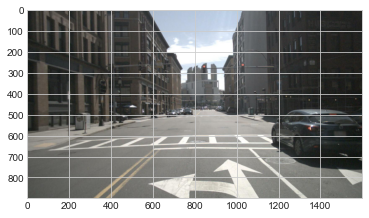

position:  (1903.4253037253604 @ 869.9354477093274)


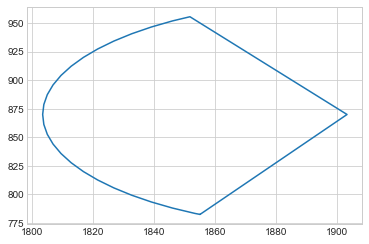

NOT VALID: POSITION
VALID:  False
position:  (1185.1335035323368 @ 1134.8981709754764)


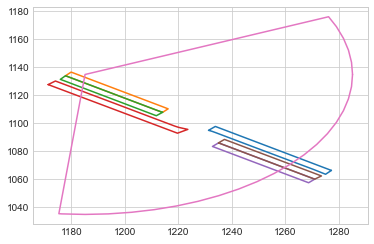

in Options class, polygonalRegions:  [<shapely.geometry.polygon.Polygon object at 0x248f88eb0>, <shapely.geometry.polygon.Polygon object at 0x263654640>, <shapely.geometry.polygon.Polygon object at 0x26365a250>, <shapely.geometry.polygon.Polygon object at 0x2c48e5c40>, <shapely.geometry.polygon.Polygon object at 0x2c5251070>, <shapely.geometry.polygon.Polygon object at 0x2c5251a60>]


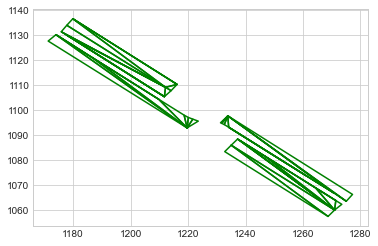

NOT VALID: POSITION
VALID:  False
position:  (1179.0191876391264 @ 1766.9137495896448)


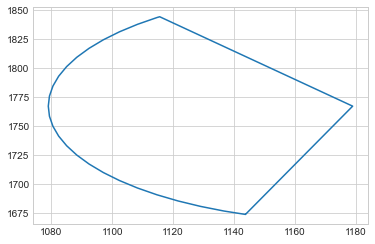

NOT VALID: POSITION
VALID:  False
position:  (1815.8331213109377 @ 1215.164970901138)


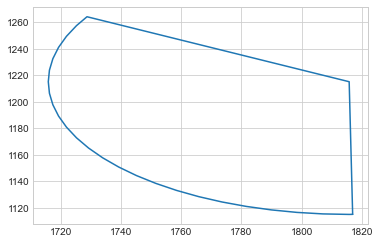

NOT VALID: POSITION
VALID:  False
position:  (1223.718502613068 @ 959.1096509367654)


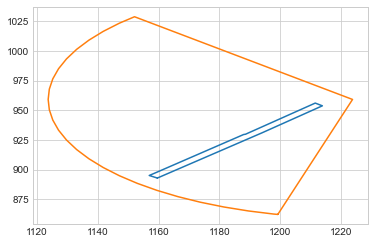

in Options class, polygonalRegions:  [<shapely.geometry.polygon.Polygon object at 0x24566e610>]


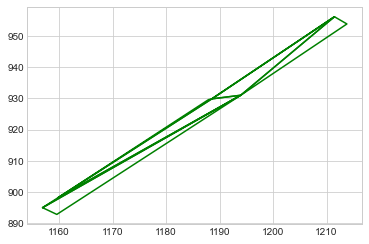

NOT VALID: POSITION
VALID:  False
position:  (670.6497766780822 @ 635.8628250512481)


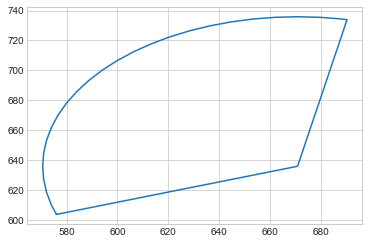

NOT VALID: POSITION
VALID:  False
position:  (1610.577139642835 @ 866.7611321147189)


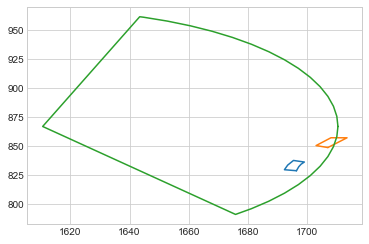

in Options class, polygonalRegions:  [<shapely.geometry.polygon.Polygon object at 0x2494b9a00>, <shapely.geometry.polygon.Polygon object at 0x2c214bdc0>]


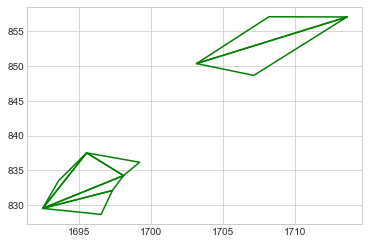

NOT VALID: POSITION
VALID:  False
position:  (2136.5239526197897 @ 904.2883870547195)


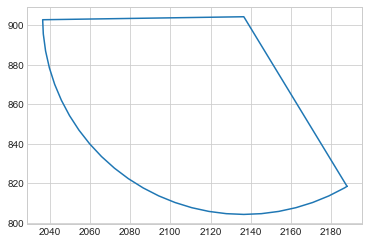

NOT VALID: POSITION
VALID:  False
position:  (873.5872198173172 @ 564.2639563871195)


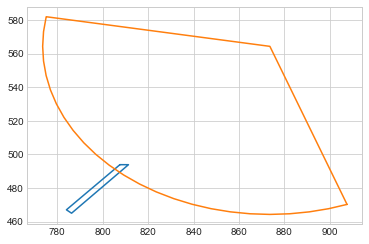

in Options class, polygonalRegions:  [<shapely.geometry.polygon.Polygon object at 0x263dce760>]


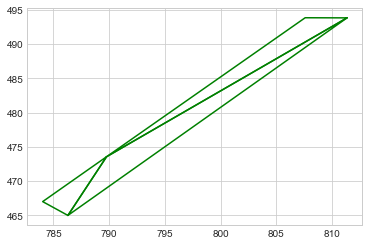

NOT VALID: POSITION
VALID:  False
position:  (2030.483201166272 @ 1221.7623895830989)


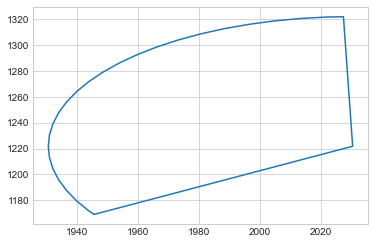

NOT VALID: POSITION
VALID:  False
position:  (794.4533689402374 @ 400.18392558682245)


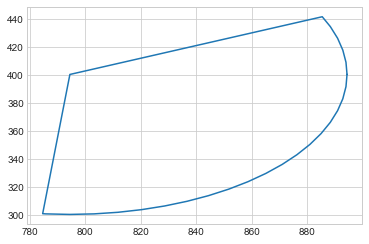

NOT VALID: POSITION
VALID:  False
position:  (2271.5059059791606 @ 868.9919289999534)


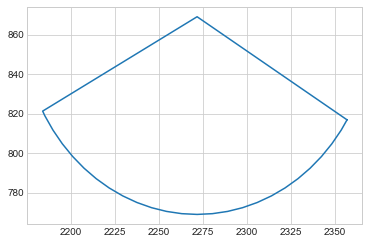

NOT VALID: POSITION
VALID:  False
position:  (611.7091236603317 @ 691.815991884474)


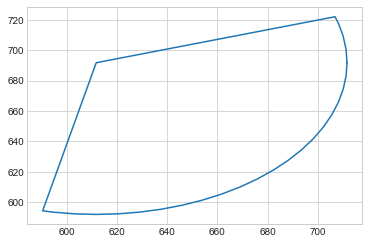

NOT VALID: POSITION
VALID:  False
position:  (516.7917195923883 @ 1692.7505110168072)


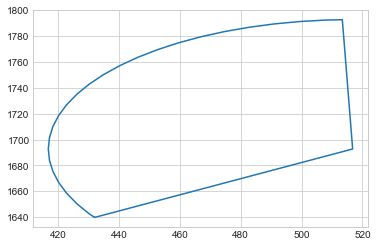

NOT VALID: POSITION
VALID:  False
position:  (639.1191629677992 @ 667.3972631377134)


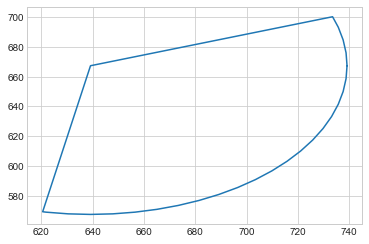

NOT VALID: POSITION
VALID:  False
position:  (1994.992334972899 @ 784.9700888326864)


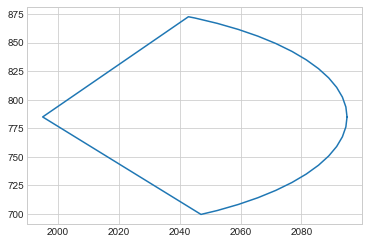

NOT VALID: POSITION
VALID:  False
position:  (1301.2033573062517 @ 896.0731285187064)


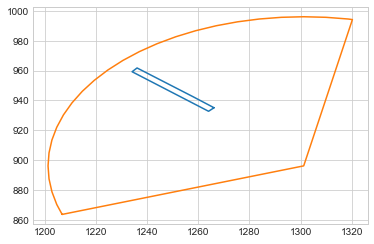

in Options class, polygonalRegions:  [<shapely.geometry.polygon.Polygon object at 0x2c5b37a90>]


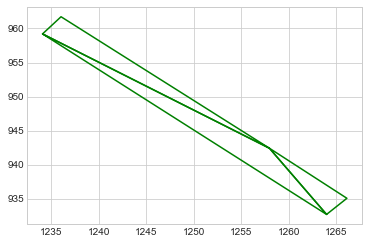

NOT VALID: POSITION
VALID:  False
position:  (1827.0924105726474 @ 1154.2929951258614)


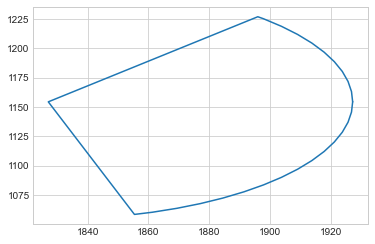

NOT VALID: POSITION
VALID:  False
position:  (1248.3893859608852 @ 947.7008533706982)


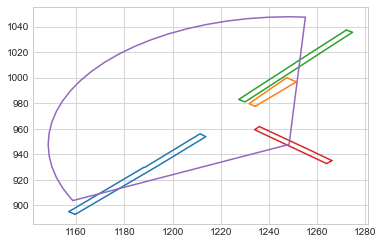

in Options class, polygonalRegions:  [<shapely.geometry.polygon.Polygon object at 0x24566e610>, <shapely.geometry.polygon.Polygon object at 0x263856160>, <shapely.geometry.polygon.Polygon object at 0x2c594c370>, <shapely.geometry.polygon.Polygon object at 0x2c5b37a90>]


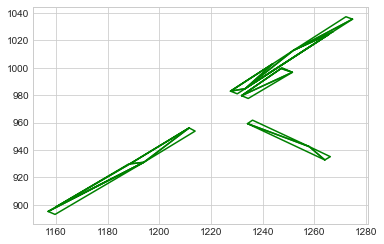

position is valid
heading:  0.979430578189636
within get_traffic_flow
point:  (1248.3893859608852 @ 947.7008533706982)
heading output =  3.987180328799435
NOT VALID: HEADING
VALID:  False
position:  (1539.3833804419053 @ 1318.572475603618)


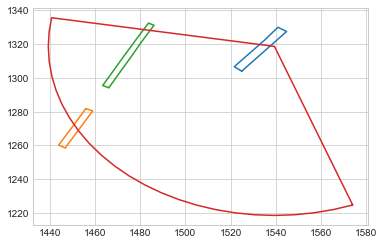

in Options class, polygonalRegions:  [<shapely.geometry.polygon.Polygon object at 0x2c475ae80>, <shapely.geometry.polygon.Polygon object at 0x2c54dabe0>, <shapely.geometry.polygon.Polygon object at 0x2c5b8e700>]


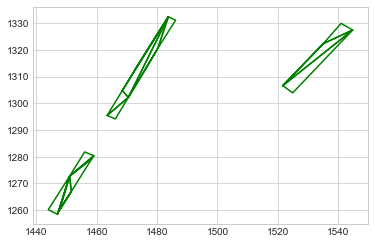

NOT VALID: POSITION
VALID:  False
position:  (770.0659171446196 @ 421.2352666503738)


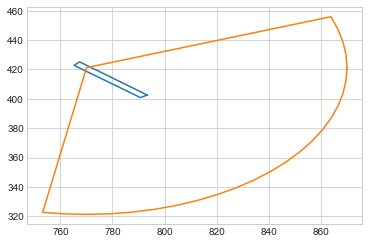

in Options class, polygonalRegions:  [<shapely.geometry.polygon.Polygon object at 0x248241550>]


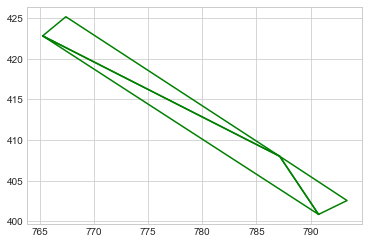

position is valid
heading:  4.019443795007542
within get_traffic_flow
point:  (770.0659171446196 @ 421.2352666503738)
heading output =  3.998104439752686
heading is valid
position:  (762.783 @ 442.077)
NOT VALID: POSITION
position:  (770.0659171446196 @ 421.2352666503738)
NOT VALID: POSITION
position:  (745.044 @ 441.663)
NOT VALID: POSITION
position:  (770.0659171446196 @ 421.2352666503738)
NOT VALID: POSITION
within get_traffic_flow
point:  (843.2501055511226 @ 1762.166978878101)
heading output =  1.0030341822847357
within get_traffic_flow
point:  (818.5457098118711 @ 1776.1327798127877)
heading output =  1.0073470755807856
VALID:  True


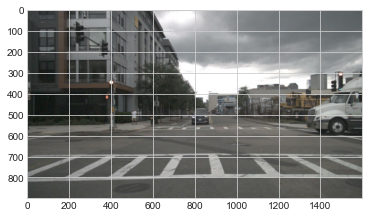

position:  (453.240070264166 @ 1715.6630015212954)


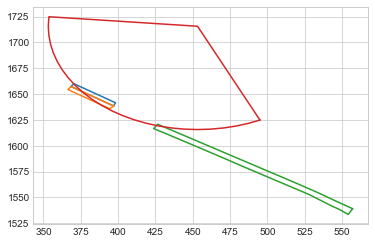

in Options class, polygonalRegions:  [<shapely.geometry.polygon.Polygon object at 0x248d0baf0>, <shapely.geometry.polygon.Polygon object at 0x248d12520>, <shapely.geometry.polygon.Polygon object at 0x24945ae20>]


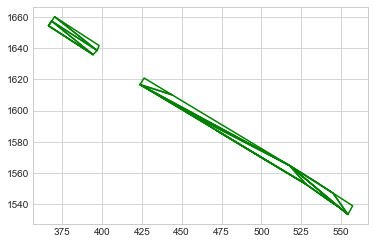

NOT VALID: POSITION
VALID:  False
position:  (449.7021426922404 @ 603.5985453997469)


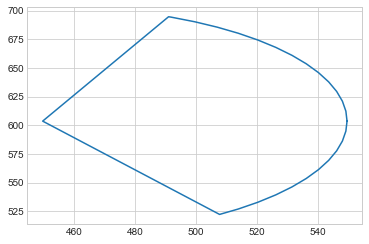

NOT VALID: POSITION
VALID:  False
position:  (593.5040857267863 @ 703.8335004920158)


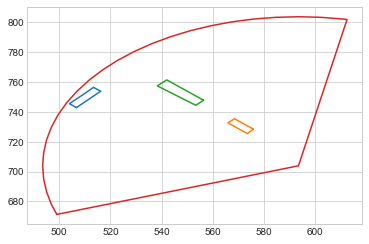

in Options class, polygonalRegions:  [<shapely.geometry.polygon.Polygon object at 0x248b8e610>, <shapely.geometry.polygon.Polygon object at 0x2c40d8400>, <shapely.geometry.polygon.Polygon object at 0x2c47d9370>]


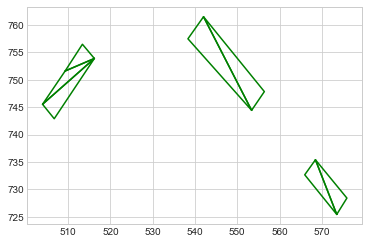

NOT VALID: POSITION
VALID:  False
position:  (1868.4227938114861 @ 1066.253406346063)


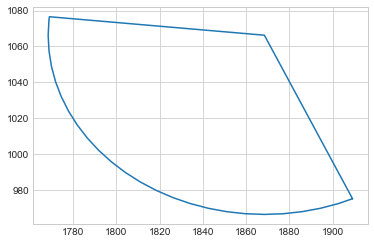

NOT VALID: POSITION
VALID:  False
position:  (2271.4496683075654 @ 868.1841064461997)


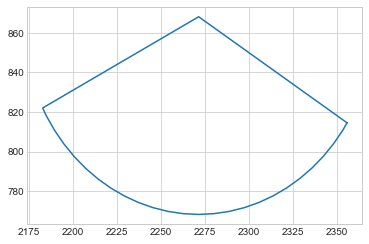

NOT VALID: POSITION
VALID:  False
position:  (2502.842573249423 @ 880.5580050053434)


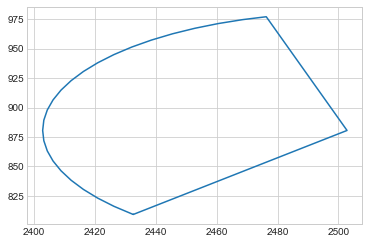

NOT VALID: POSITION
VALID:  False
position:  (2029.8702821546453 @ 789.1441200472246)


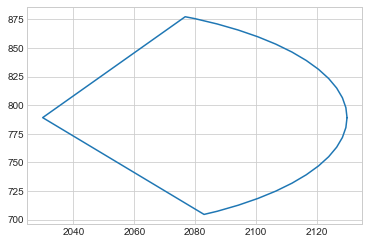

NOT VALID: POSITION
VALID:  False
position:  (1049.4296380892508 @ 1233.01721789555)


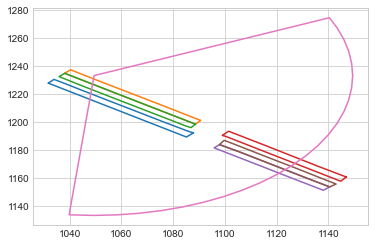

in Options class, polygonalRegions:  [<shapely.geometry.polygon.Polygon object at 0x247e11bb0>, <shapely.geometry.polygon.Polygon object at 0x2c3ccb3a0>, <shapely.geometry.polygon.Polygon object at 0x2c3ccbfd0>, <shapely.geometry.polygon.Polygon object at 0x2c3de77c0>, <shapely.geometry.polygon.Polygon object at 0x2c5bb1460>, <shapely.geometry.polygon.Polygon object at 0x2c5bbb130>]


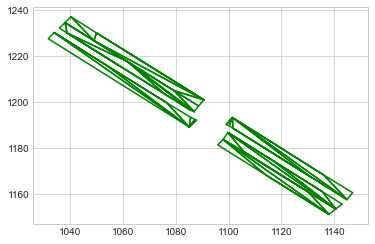

NOT VALID: POSITION
VALID:  False
position:  (1873.412475355371 @ 1072.536615558466)


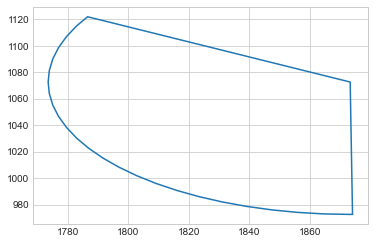

NOT VALID: POSITION
VALID:  False
position:  (1301.2033495391106 @ 896.0731352625814)


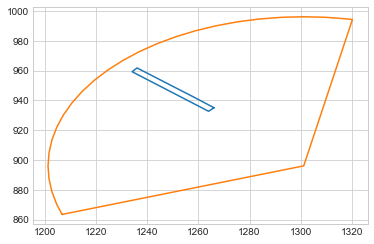

in Options class, polygonalRegions:  [<shapely.geometry.polygon.Polygon object at 0x2c5b37a90>]


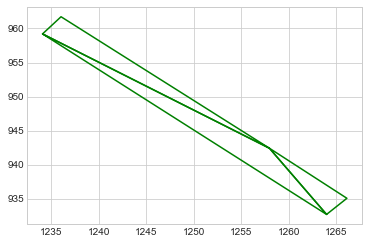

NOT VALID: POSITION
VALID:  False
position:  (1239.4839797048312 @ 960.7181759617334)


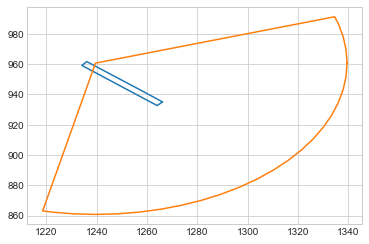

in Options class, polygonalRegions:  [<shapely.geometry.polygon.Polygon object at 0x2c5b37a90>]


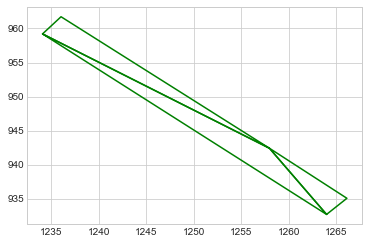

NOT VALID: POSITION
VALID:  False
position:  (696.2098698623242 @ 612.9252146667407)


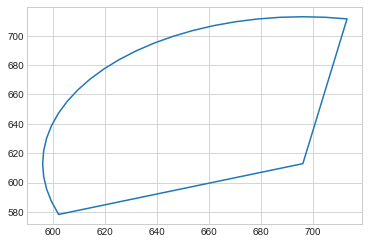

NOT VALID: POSITION
VALID:  False
position:  (2525.02464090824 @ 857.7574467509695)


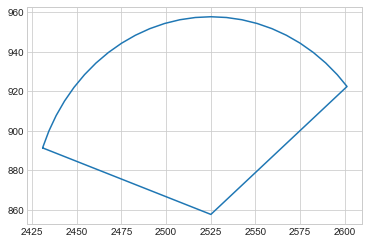

NOT VALID: POSITION
VALID:  False
position:  (803.6698233207196 @ 519.421350223794)


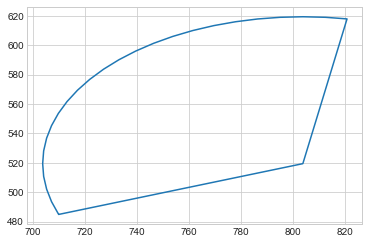

NOT VALID: POSITION
VALID:  False
position:  (740.9650503215685 @ 573.1692107679394)


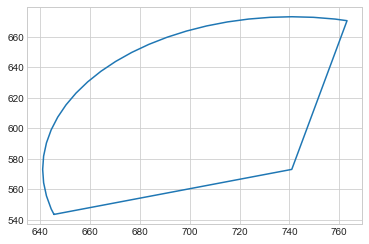

NOT VALID: POSITION
VALID:  False
position:  (775.6012255670755 @ 416.4317378957155)


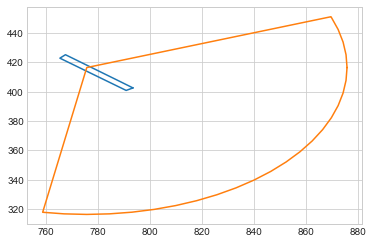

in Options class, polygonalRegions:  [<shapely.geometry.polygon.Polygon object at 0x248241550>]


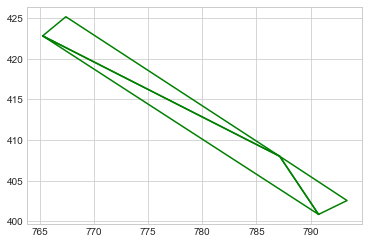

position is valid
heading:  4.018448055885601
within get_traffic_flow
point:  (775.6012255670755 @ 416.4317378957155)
heading output =  3.998104439752686
heading is valid
position:  (745.657 @ 419.384)
NOT VALID: POSITION
position:  (775.6012255670755 @ 416.4317378957155)
NOT VALID: POSITION
position:  (716.321 @ 470.445)
NOT VALID: POSITION
position:  (775.6012255670755 @ 416.4317378957155)
NOT VALID: POSITION
within get_traffic_flow
point:  (161.78375349942124 @ 1810.8094768696023)
heading output =  -0.9417159109206734
within get_traffic_flow
point:  (145.6080118048038 @ 1803.743203321746)
heading output =  -0.9446355916661515
VALID:  True


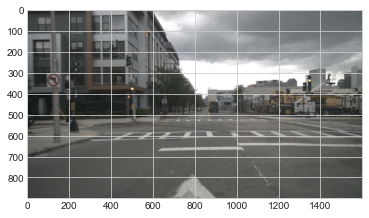

position:  (498.2136409865857 @ 1702.9828389513216)


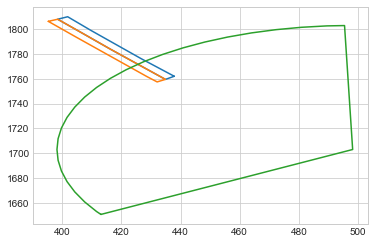

in Options class, polygonalRegions:  [<shapely.geometry.polygon.Polygon object at 0x248102ca0>, <shapely.geometry.polygon.Polygon object at 0x24810f910>]


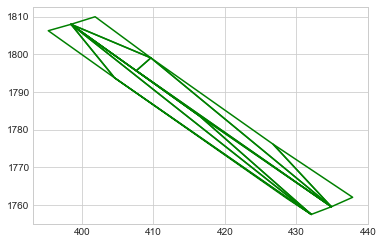

NOT VALID: POSITION
VALID:  False
position:  (309.18575974829173 @ 668.6640174623062)


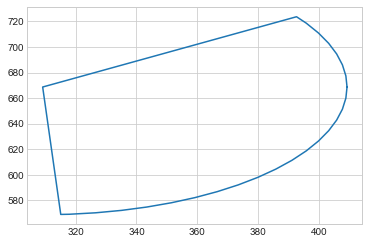

NOT VALID: POSITION
VALID:  False
position:  (1835.4565926005553 @ 1150.5912790273637)


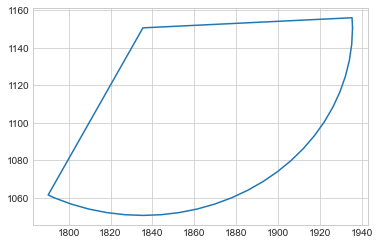

NOT VALID: POSITION
VALID:  False
position:  (896.7142298298616 @ 337.6984163319991)


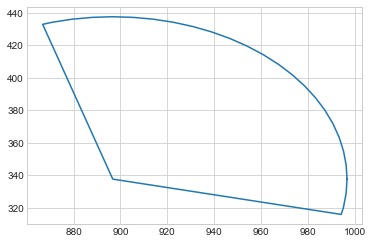

NOT VALID: POSITION
VALID:  False
position:  (1181.1341917520053 @ 1767.0248695687892)


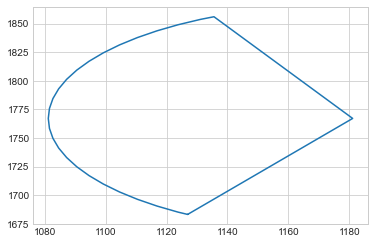

NOT VALID: POSITION
VALID:  False
position:  (2136.633864081504 @ 904.4129519582051)


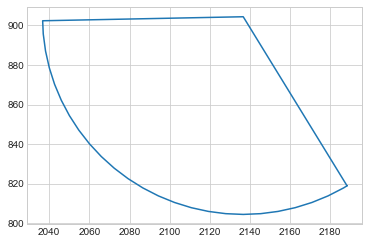

NOT VALID: POSITION
VALID:  False
position:  (451.5680261520631 @ 603.9277042339395)


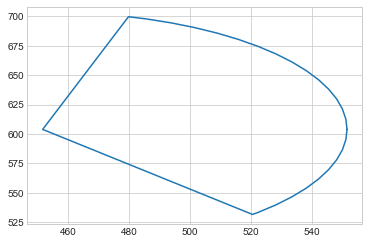

NOT VALID: POSITION
VALID:  False
position:  (886.1827447709945 @ 328.9943984275032)


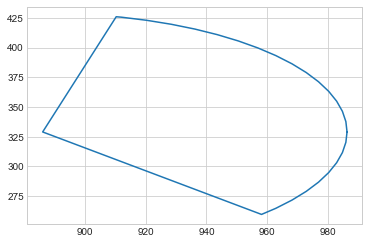

NOT VALID: POSITION
VALID:  False
position:  (757.7471022263253 @ 1516.9971207113203)


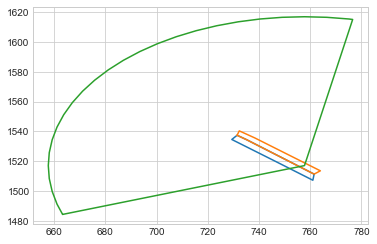

in Options class, polygonalRegions:  [<shapely.geometry.polygon.Polygon object at 0x2454b9a60>, <shapely.geometry.polygon.Polygon object at 0x2454c2670>]


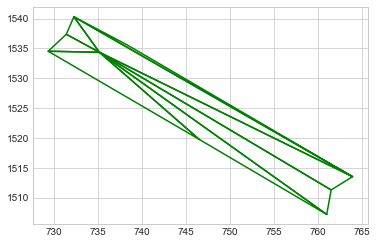

position is valid
heading:  0.8579246938568723
within get_traffic_flow
point:  (757.7471022263253 @ 1516.9971207113203)
heading output =  0.8619605002069616
heading is valid
position:  (761.398 @ 1509.12)
NOT VALID: POSITION
position:  (757.7471022263253 @ 1516.9971207113203)
NOT VALID: POSITION
position:  (764.571 @ 1492.458)
NOT VALID: POSITION
position:  (757.7471022263253 @ 1516.9971207113203)
NOT VALID: POSITION
position:  (793.527 @ 1503.259)
NOT VALID: POSITION
position:  (757.7471022263253 @ 1516.9971207113203)
NOT VALID: POSITION
position:  (793.527 @ 1503.259)
NOT VALID: POSITION
position:  (757.7471022263253 @ 1516.9971207113203)
NOT VALID: POSITION
position:  (761.398 @ 1509.12)
NOT VALID: POSITION
position:  (757.7471022263253 @ 1516.9971207113203)
NOT VALID: POSITION
position:  (764.571 @ 1492.458)
NOT VALID: POSITION
position:  (757.7471022263253 @ 1516.9971207113203)
NOT VALID: POSITION
within get_traffic_flow
point:  (1409.9657149735451 @ 1256.285768074056)
heading out

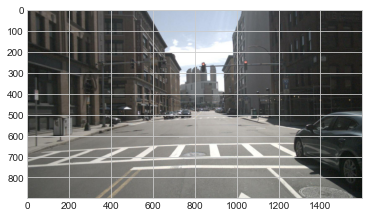

position:  (759.9234370635736 @ 1515.028666886572)


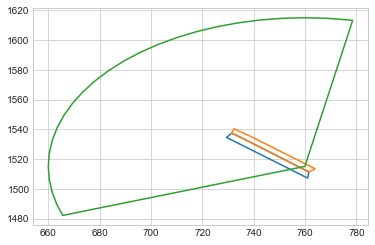

in Options class, polygonalRegions:  [<shapely.geometry.polygon.Polygon object at 0x2454b9a60>, <shapely.geometry.polygon.Polygon object at 0x2454c2670>]


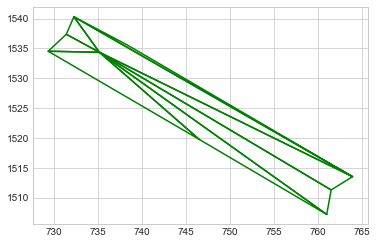

position is valid
heading:  0.859551101006696
within get_traffic_flow
point:  (759.9234370635736 @ 1515.028666886572)
heading output =  0.8619605002069616
heading is valid
position:  (761.545 @ 1508.955)
NOT VALID: POSITION
position:  (759.9234370635736 @ 1515.028666886572)
NOT VALID: POSITION
position:  (793.616 @ 1503.186)
NOT VALID: POSITION
position:  (759.9234370635736 @ 1515.028666886572)
NOT VALID: POSITION
within get_traffic_flow
point:  (1143.611383220043 @ 1087.501987622085)
heading output =  0.08407582252222046
within get_traffic_flow
point:  (1140.9014425786654 @ 1088.814345272287)
heading output =  0.06847044904357547
VALID:  True


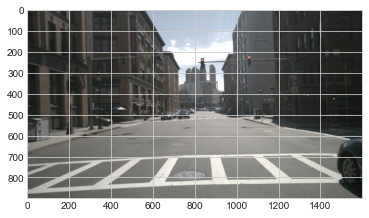

position:  (1543.7477929238435 @ 1329.1842052036657)


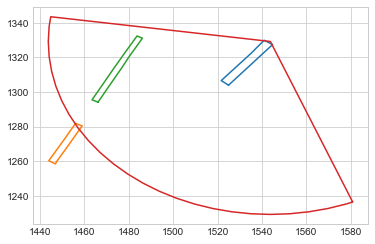

in Options class, polygonalRegions:  [<shapely.geometry.polygon.Polygon object at 0x2c475ae80>, <shapely.geometry.polygon.Polygon object at 0x2c54dabe0>, <shapely.geometry.polygon.Polygon object at 0x2c5b8e700>]


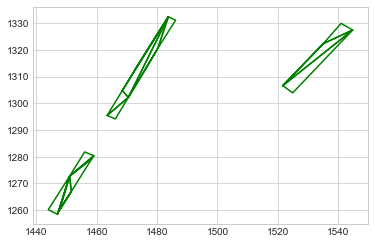

NOT VALID: POSITION
VALID:  False
position:  (534.3458224762014 @ 1555.4631216952937)


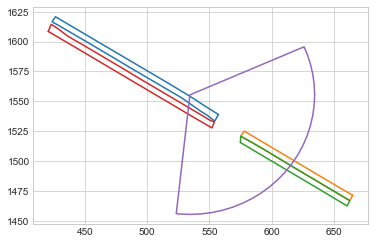

in Options class, polygonalRegions:  [<shapely.geometry.polygon.Polygon object at 0x24945ae20>, <shapely.geometry.polygon.Polygon object at 0x2c4f71be0>, <shapely.geometry.polygon.Polygon object at 0x2c4f7d910>, <shapely.geometry.polygon.Polygon object at 0x2c5cff4c0>]


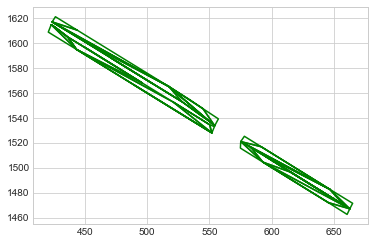

NOT VALID: POSITION
VALID:  False
position:  (1913.8080613990796 @ 870.0563469507065)


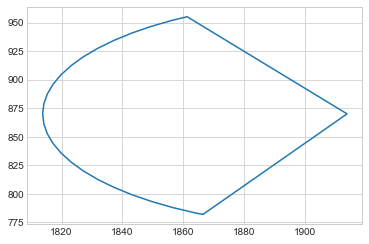

NOT VALID: POSITION
VALID:  False
position:  (1016.4117839887563 @ 1255.297750700658)


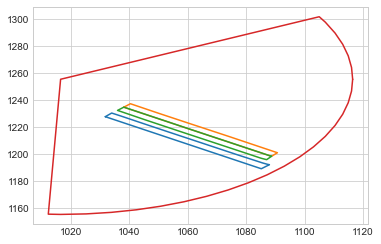

in Options class, polygonalRegions:  [<shapely.geometry.polygon.Polygon object at 0x247e11bb0>, <shapely.geometry.polygon.Polygon object at 0x2c3ccb3a0>, <shapely.geometry.polygon.Polygon object at 0x2c3ccbfd0>]


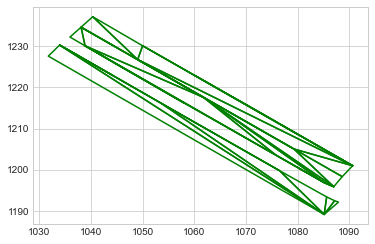

NOT VALID: POSITION
VALID:  False
position:  (1185.1319457627178 @ 1134.8960040299626)


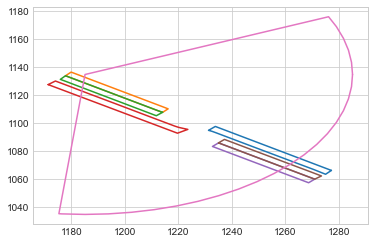

in Options class, polygonalRegions:  [<shapely.geometry.polygon.Polygon object at 0x248f88eb0>, <shapely.geometry.polygon.Polygon object at 0x263654640>, <shapely.geometry.polygon.Polygon object at 0x26365a250>, <shapely.geometry.polygon.Polygon object at 0x2c48e5c40>, <shapely.geometry.polygon.Polygon object at 0x2c5251070>, <shapely.geometry.polygon.Polygon object at 0x2c5251a60>]


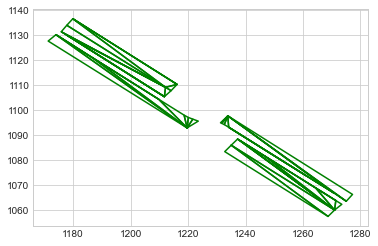

NOT VALID: POSITION
VALID:  False
position:  (472.5803685091005 @ 1716.7239425724042)


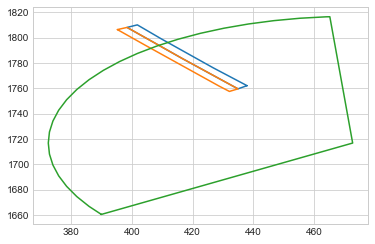

in Options class, polygonalRegions:  [<shapely.geometry.polygon.Polygon object at 0x248102ca0>, <shapely.geometry.polygon.Polygon object at 0x24810f910>]


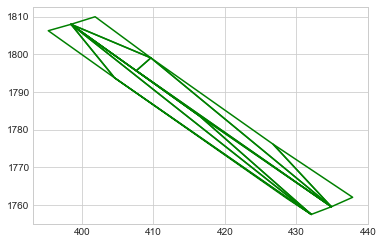

NOT VALID: POSITION
VALID:  False
position:  (645.4298491781951 @ 662.3469813009381)


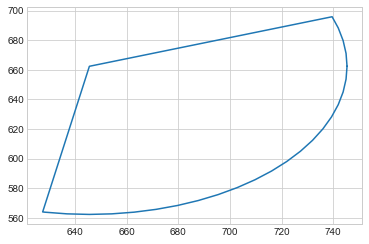

NOT VALID: POSITION
VALID:  False
position:  (1178.2865204979544 @ 1139.9960842540208)


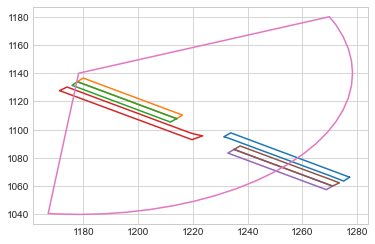

in Options class, polygonalRegions:  [<shapely.geometry.polygon.Polygon object at 0x248f88eb0>, <shapely.geometry.polygon.Polygon object at 0x263654640>, <shapely.geometry.polygon.Polygon object at 0x26365a250>, <shapely.geometry.polygon.Polygon object at 0x2c48e5c40>, <shapely.geometry.polygon.Polygon object at 0x2c5251070>, <shapely.geometry.polygon.Polygon object at 0x2c5251a60>]


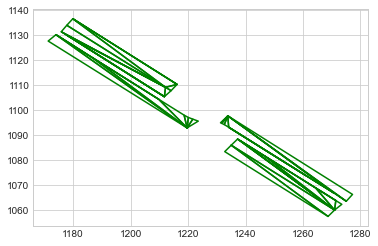

NOT VALID: POSITION
VALID:  False
position:  (1362.460023922167 @ 1136.795285913749)


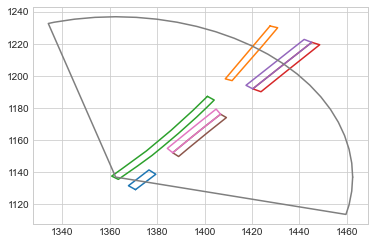

in Options class, polygonalRegions:  [<shapely.geometry.polygon.Polygon object at 0x24510fb80>, <shapely.geometry.polygon.Polygon object at 0x2499916a0>, <shapely.geometry.polygon.Polygon object at 0x2c5099d90>, <shapely.geometry.polygon.Polygon object at 0x2c50c1cd0>, <shapely.geometry.polygon.Polygon object at 0x2c50c98e0>, <shapely.geometry.polygon.Polygon object at 0x2c59e6d60>, <shapely.geometry.polygon.Polygon object at 0x2c59f1a30>]


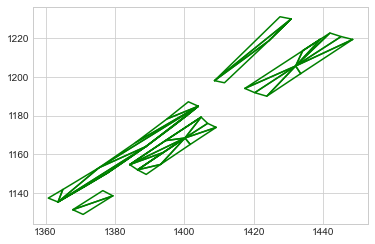

position is valid
heading:  -0.7587654650447093
within get_traffic_flow
point:  (1362.460023922167 @ 1136.795285913749)
heading output =  -0.6836340425536629
heading is valid
position:  (1328.738 @ 1101.131)
NOT VALID: POSITION
position:  (1362.460023922167 @ 1136.795285913749)
NOT VALID: POSITION
position:  (1321.352 @ 1093.599)
NOT VALID: POSITION
position:  (1362.460023922167 @ 1136.795285913749)
NOT VALID: POSITION
position:  (1311.193 @ 1076.011)
NOT VALID: POSITION
position:  (1362.460023922167 @ 1136.795285913749)
NOT VALID: POSITION
position:  (1311.193 @ 1076.011)
NOT VALID: POSITION
position:  (1362.460023922167 @ 1136.795285913749)
NOT VALID: POSITION
position:  (1328.738 @ 1101.131)
NOT VALID: POSITION
position:  (1362.460023922167 @ 1136.795285913749)
NOT VALID: POSITION
position:  (1321.352 @ 1093.599)
NOT VALID: POSITION
position:  (1362.460023922167 @ 1136.795285913749)
NOT VALID: POSITION
within get_traffic_flow
point:  (1541.8627988653816 @ 1204.6547521073614)
heading

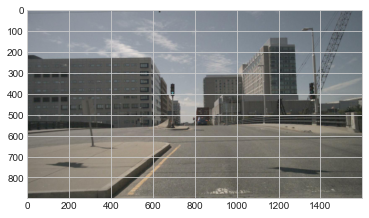

position:  (1460.9288067968528 @ 912.5241279230252)


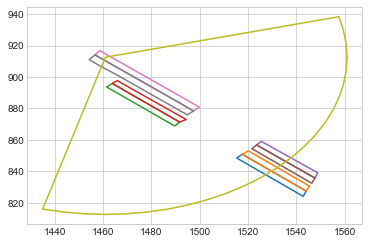

in Options class, polygonalRegions:  [<shapely.geometry.polygon.Polygon object at 0x248cee370>, <shapely.geometry.polygon.Polygon object at 0x248ceee80>, <shapely.geometry.polygon.Polygon object at 0x2c48543d0>, <shapely.geometry.polygon.Polygon object at 0x2c4854ee0>, <shapely.geometry.polygon.Polygon object at 0x2c51927c0>, <shapely.geometry.polygon.Polygon object at 0x2c519b1f0>, <shapely.geometry.polygon.Polygon object at 0x2c5c55970>, <shapely.geometry.polygon.Polygon object at 0x2c5c5d580>]


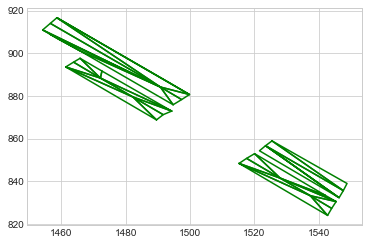

position is valid
heading:  3.926140937292418
within get_traffic_flow
point:  (1460.9288067968528 @ 912.5241279230252)
heading output =  3.993938954957558
heading is valid
position:  (1421.339 @ 932.794)
NOT VALID: POSITION
position:  (1460.9288067968528 @ 912.5241279230252)
NOT VALID: POSITION
position:  (1393.676 @ 975.566)
NOT VALID: POSITION
position:  (1460.9288067968528 @ 912.5241279230252)
NOT VALID: POSITION
position:  (1351.984 @ 988.531)
NOT VALID: POSITION
position:  (1460.9288067968528 @ 912.5241279230252)
NOT VALID: POSITION
position:  (1351.984 @ 988.531)
NOT VALID: POSITION
position:  (1460.9288067968528 @ 912.5241279230252)
NOT VALID: POSITION
position:  (1421.339 @ 932.794)
NOT VALID: POSITION
position:  (1460.9288067968528 @ 912.5241279230252)
NOT VALID: POSITION
position:  (1393.676 @ 975.566)
NOT VALID: POSITION
position:  (1460.9288067968528 @ 912.5241279230252)
NOT VALID: POSITION
within get_traffic_flow
point:  (1411.3732619450038 @ 954.9834437333769)
heading out

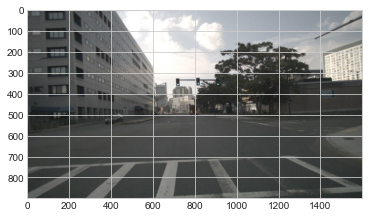

position:  (439.151691376542 @ 821.3329400150953)


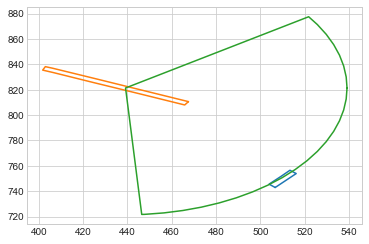

in Options class, polygonalRegions:  [<shapely.geometry.polygon.Polygon object at 0x248b8e610>, <shapely.geometry.polygon.Polygon object at 0x2495d0400>]


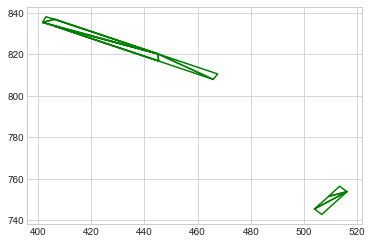

position is valid
heading:  4.261932233354237
within get_traffic_flow
point:  (439.151691376542 @ 821.3329400150953)
heading output =  4.308298932715173
heading is valid
position:  (418.383 @ 822.625)
NOT VALID: POSITION
position:  (439.151691376542 @ 821.3329400150953)
NOT VALID: POSITION
position:  (416.034 @ 831.079)
NOT VALID: POSITION
position:  (439.151691376542 @ 821.3329400150953)
NOT VALID: POSITION
within get_traffic_flow
point:  (1537.472089289441 @ 1319.576312281279)
heading output =  2.4448857728713973
within get_traffic_flow
point:  (1527.3182431538737 @ 1302.1588131037042)
heading output =  2.4337893083366997
VALID:  True


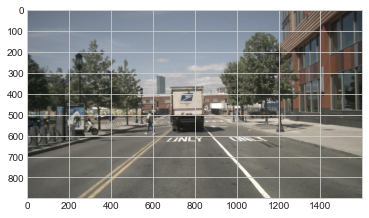

position:  (521.7589030308945 @ 640.5372178760781)


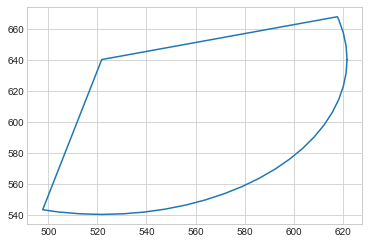

NOT VALID: POSITION
VALID:  False
position:  (1858.1273942503178 @ 785.1784091876641)


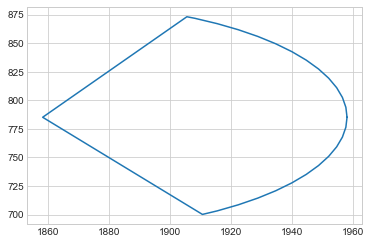

NOT VALID: POSITION
VALID:  False
position:  (1315.9182315128012 @ 1038.8511322241782)


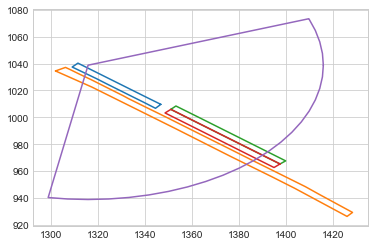

in Options class, polygonalRegions:  [<shapely.geometry.polygon.Polygon object at 0x2c4a4ceb0>, <shapely.geometry.polygon.Polygon object at 0x2c506e2b0>, <shapely.geometry.polygon.Polygon object at 0x2c5a697f0>, <shapely.geometry.polygon.Polygon object at 0x2c5a744c0>]


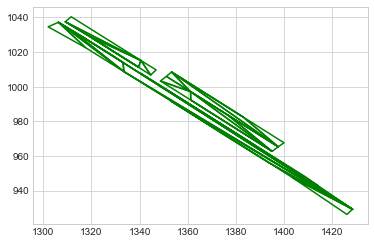

NOT VALID: POSITION
VALID:  False
position:  (2018.6485955520575 @ 785.4581022955552)


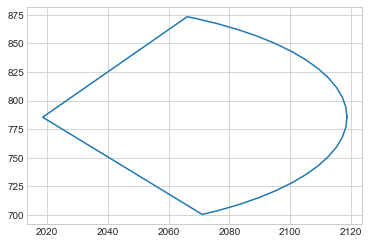

NOT VALID: POSITION
VALID:  False
position:  (1239.4895751279573 @ 960.7243586349111)


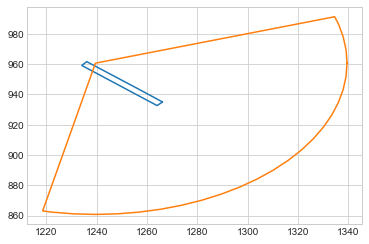

in Options class, polygonalRegions:  [<shapely.geometry.polygon.Polygon object at 0x2c5b37a90>]


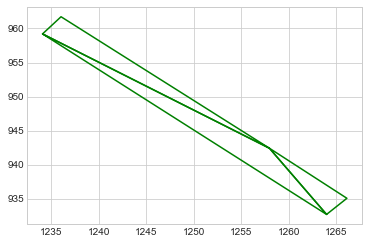

NOT VALID: POSITION
VALID:  False
position:  (511.6201227540737 @ 1694.9422568677114)


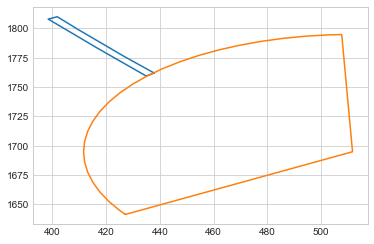

in Options class, polygonalRegions:  [<shapely.geometry.polygon.Polygon object at 0x248102ca0>]


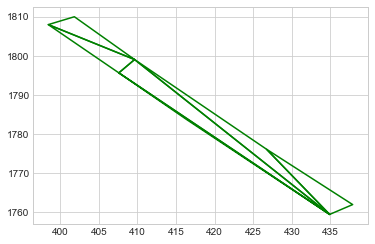

NOT VALID: POSITION
VALID:  False
position:  (512.8666130923475 @ 1694.8143820699283)


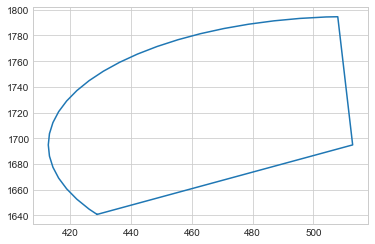

NOT VALID: POSITION
VALID:  False
position:  (472.43313949447315 @ 802.5713924808712)


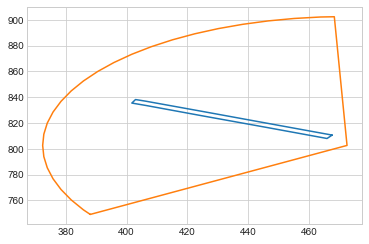

in Options class, polygonalRegions:  [<shapely.geometry.polygon.Polygon object at 0x2495d0400>]


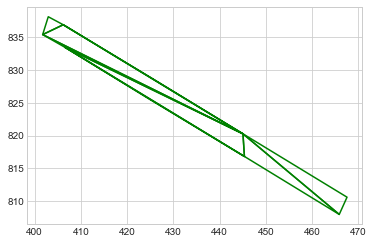

NOT VALID: POSITION
VALID:  False
position:  (1764.7269000702272 @ 1212.670070712766)


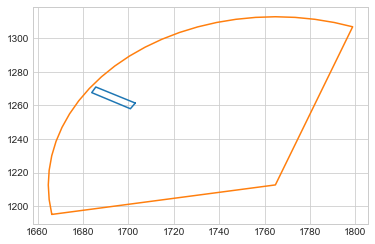

in Options class, polygonalRegions:  [<shapely.geometry.polygon.Polygon object at 0x2454fbcd0>]


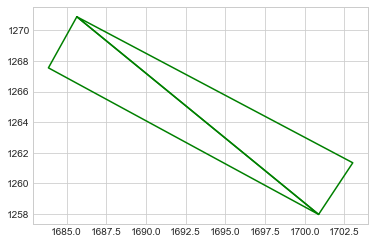

NOT VALID: POSITION
VALID:  False
position:  (674.5941826190397 @ 1336.603777033995)


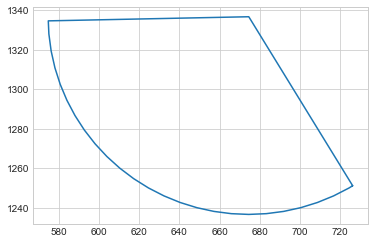

NOT VALID: POSITION
VALID:  False
position:  (450.35040172451886 @ 1709.8412622999767)


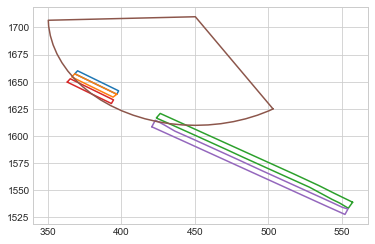

in Options class, polygonalRegions:  [<shapely.geometry.polygon.Polygon object at 0x248d0baf0>, <shapely.geometry.polygon.Polygon object at 0x248d12520>, <shapely.geometry.polygon.Polygon object at 0x24945ae20>, <shapely.geometry.polygon.Polygon object at 0x2c50ed880>, <shapely.geometry.polygon.Polygon object at 0x2c5cff4c0>]


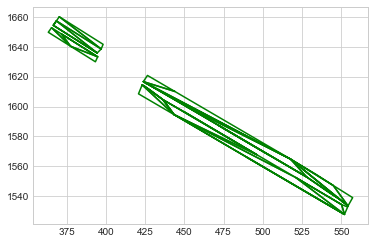

NOT VALID: POSITION
VALID:  False
position:  (2328.85615471565 @ 1012.6041025701561)


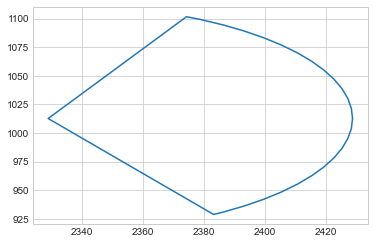

NOT VALID: POSITION
VALID:  False
position:  (2526.5717582457896 @ 815.0929172241176)


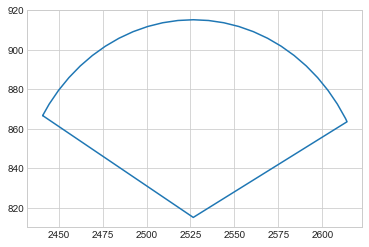

NOT VALID: POSITION
VALID:  False
position:  (802.4016554233976 @ 520.5497652639302)


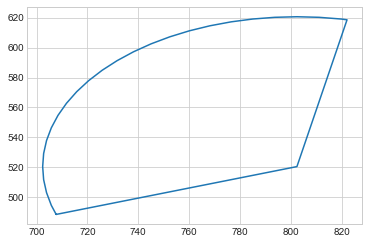

NOT VALID: POSITION
VALID:  False
position:  (1447.9146768107607 @ 1215.8028063816682)


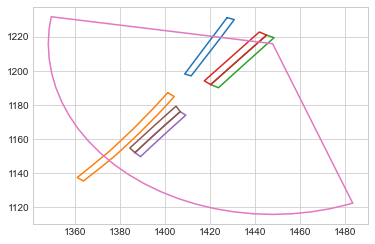

in Options class, polygonalRegions:  [<shapely.geometry.polygon.Polygon object at 0x2499916a0>, <shapely.geometry.polygon.Polygon object at 0x2c5099d90>, <shapely.geometry.polygon.Polygon object at 0x2c50c1cd0>, <shapely.geometry.polygon.Polygon object at 0x2c50c98e0>, <shapely.geometry.polygon.Polygon object at 0x2c59e6d60>, <shapely.geometry.polygon.Polygon object at 0x2c59f1a30>]


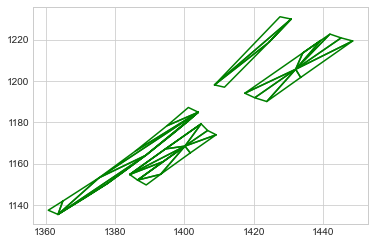

NOT VALID: POSITION
VALID:  False
position:  (1668.3851794030095 @ 942.1807773206357)


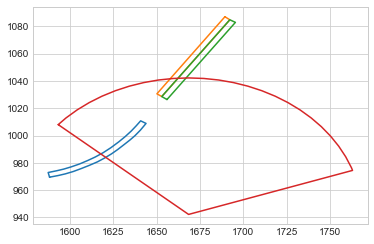

in Options class, polygonalRegions:  [<shapely.geometry.polygon.Polygon object at 0x248064730>, <shapely.geometry.polygon.Polygon object at 0x2494924c0>, <shapely.geometry.polygon.Polygon object at 0x249492e50>]


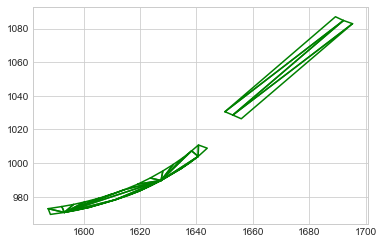

NOT VALID: POSITION
VALID:  False
position:  (2104.496748246731 @ 935.8118416293204)


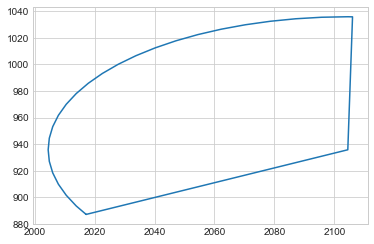

NOT VALID: POSITION
VALID:  False
position:  (456.8320756708317 @ 1719.1411122120367)


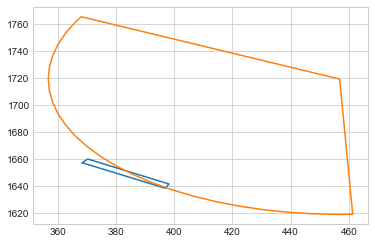

in Options class, polygonalRegions:  [<shapely.geometry.polygon.Polygon object at 0x248d0baf0>]


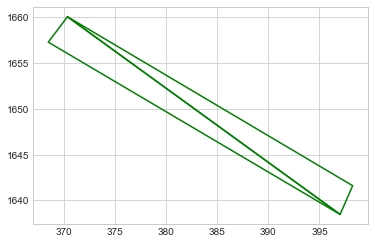

NOT VALID: POSITION
VALID:  False
position:  (587.3759206756665 @ 716.2275107831882)


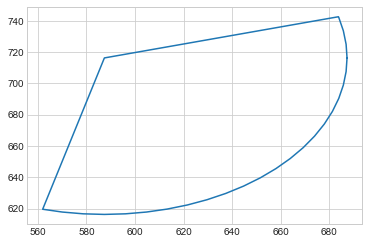

NOT VALID: POSITION
VALID:  False
position:  (2001.8496156248088 @ 784.4706318764072)


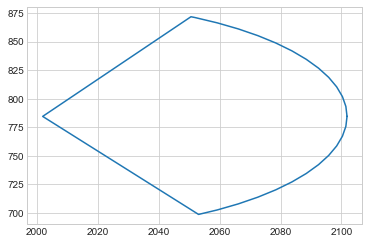

NOT VALID: POSITION
VALID:  False
position:  (755.9212639045745 @ 565.9652642399496)


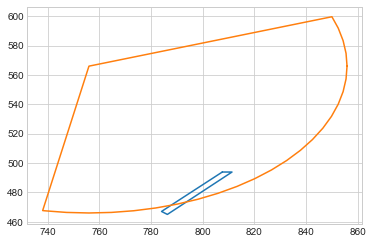

in Options class, polygonalRegions:  [<shapely.geometry.polygon.Polygon object at 0x263dce760>]


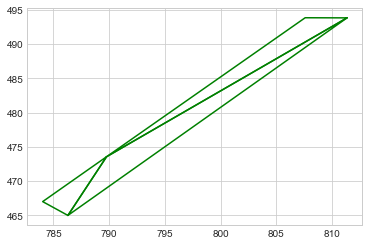

NOT VALID: POSITION
VALID:  False
position:  (2135.3211546907164 @ 902.2924044556637)


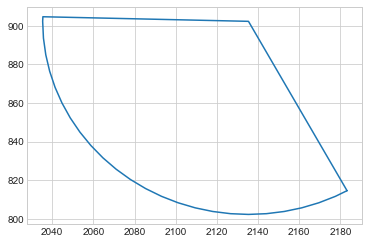

NOT VALID: POSITION
VALID:  False
position:  (805.916714882723 @ 517.5585506683847)


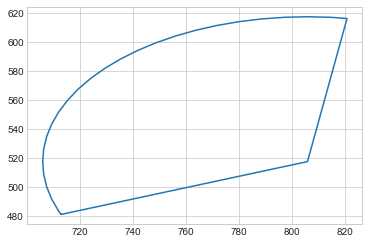

NOT VALID: POSITION
VALID:  False
position:  (2414.5563893779645 @ 797.1733578476536)


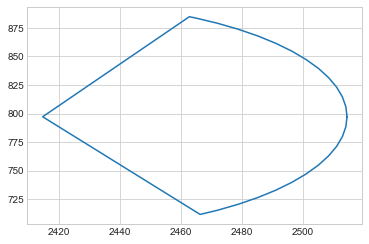

NOT VALID: POSITION
VALID:  False
position:  (1539.3833778037078 @ 1318.572479288598)


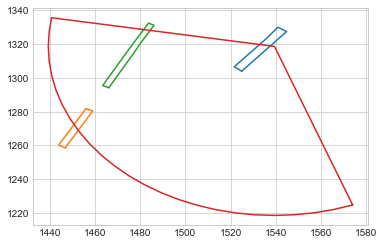

in Options class, polygonalRegions:  [<shapely.geometry.polygon.Polygon object at 0x2c475ae80>, <shapely.geometry.polygon.Polygon object at 0x2c54dabe0>, <shapely.geometry.polygon.Polygon object at 0x2c5b8e700>]


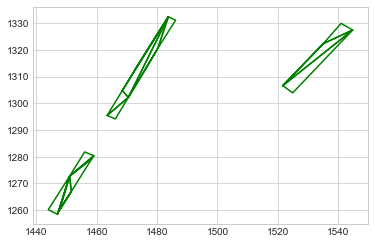

NOT VALID: POSITION
VALID:  False
position:  (1301.2033570793756 @ 896.0731287165142)


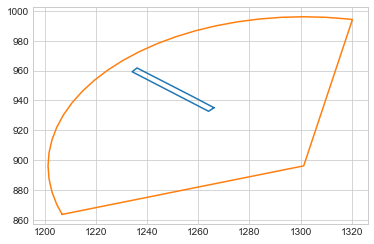

in Options class, polygonalRegions:  [<shapely.geometry.polygon.Polygon object at 0x2c5b37a90>]


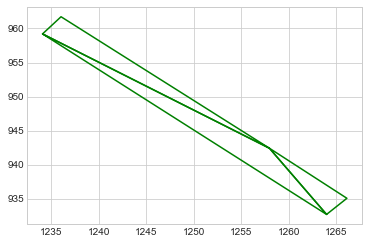

NOT VALID: POSITION
VALID:  False
position:  (406.6285755736353 @ 873.4892998928372)


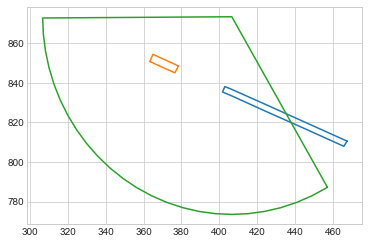

in Options class, polygonalRegions:  [<shapely.geometry.polygon.Polygon object at 0x2495d0400>, <shapely.geometry.polygon.Polygon object at 0x264439d60>]


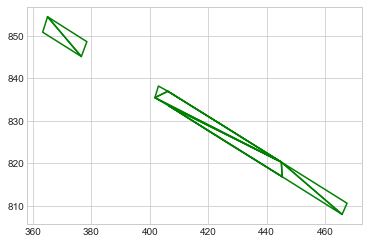

NOT VALID: POSITION
VALID:  False
position:  (1868.2141263749306 @ 1065.9503061301853)


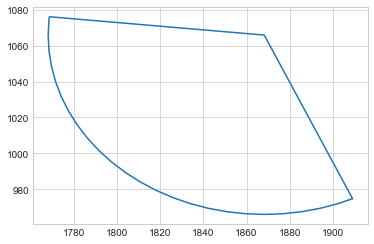

NOT VALID: POSITION
VALID:  False
position:  (1050.9687608172112 @ 1231.8974230673357)


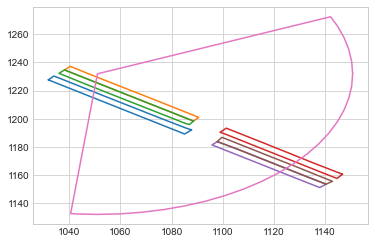

in Options class, polygonalRegions:  [<shapely.geometry.polygon.Polygon object at 0x247e11bb0>, <shapely.geometry.polygon.Polygon object at 0x2c3ccb3a0>, <shapely.geometry.polygon.Polygon object at 0x2c3ccbfd0>, <shapely.geometry.polygon.Polygon object at 0x2c3de77c0>, <shapely.geometry.polygon.Polygon object at 0x2c5bb1460>, <shapely.geometry.polygon.Polygon object at 0x2c5bbb130>]


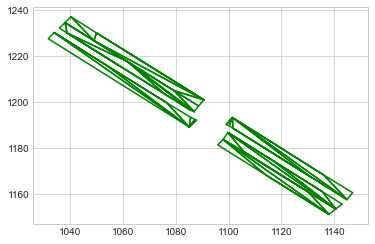

NOT VALID: POSITION
VALID:  False
position:  (2526.109209666555 @ 841.6489090955469)


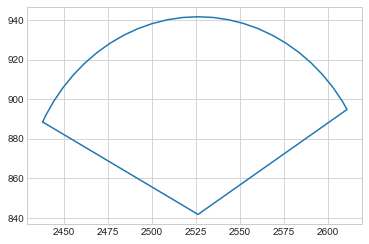

NOT VALID: POSITION
VALID:  False
position:  (1304.8000285889038 @ 1047.9492474411077)


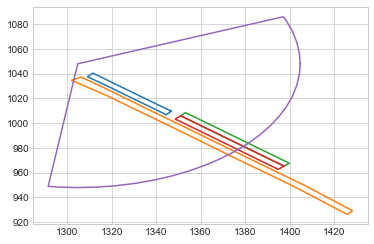

in Options class, polygonalRegions:  [<shapely.geometry.polygon.Polygon object at 0x2c4a4ceb0>, <shapely.geometry.polygon.Polygon object at 0x2c506e2b0>, <shapely.geometry.polygon.Polygon object at 0x2c5a697f0>, <shapely.geometry.polygon.Polygon object at 0x2c5a744c0>]


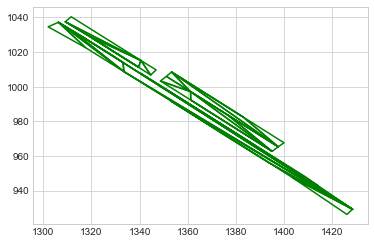

NOT VALID: POSITION
VALID:  False
position:  (2136.3655813835426 @ 904.0099458882027)


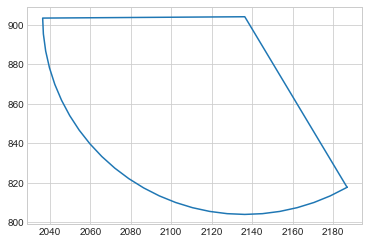

NOT VALID: POSITION
VALID:  False
position:  (1542.3837708655233 @ 1327.5382383228523)


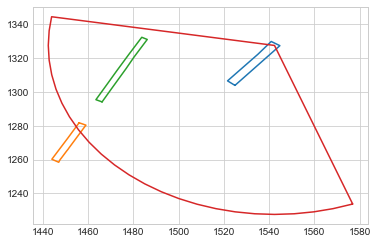

in Options class, polygonalRegions:  [<shapely.geometry.polygon.Polygon object at 0x2c475ae80>, <shapely.geometry.polygon.Polygon object at 0x2c54dabe0>, <shapely.geometry.polygon.Polygon object at 0x2c5b8e700>]


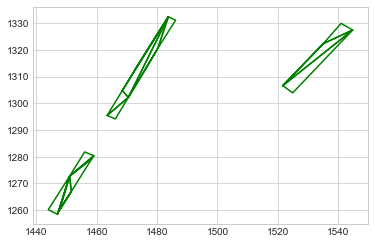

position is valid
heading:  2.4473150268158568
within get_traffic_flow
point:  (1542.3837708655233 @ 1327.5382383228523)
heading output =  2.4448857728713973
heading is valid
position:  (1545.428 @ 1364.136)
NOT VALID: POSITION
position:  (1542.3837708655233 @ 1327.5382383228523)
NOT VALID: POSITION
position:  (1549.992 @ 1386.357)
NOT VALID: POSITION
position:  (1542.3837708655233 @ 1327.5382383228523)
NOT VALID: POSITION
within get_traffic_flow
point:  (1468.2057843221746 @ 908.006091125719)
heading output =  3.993938954957558
within get_traffic_flow
point:  (1465.070390343907 @ 912.8471506768742)
heading output =  3.9947045957251133
VALID:  True


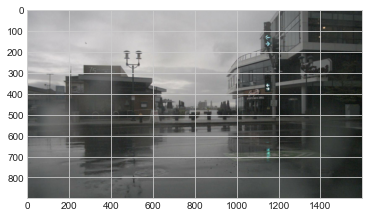

position:  (1185.1334306260615 @ 1134.8980653578938)


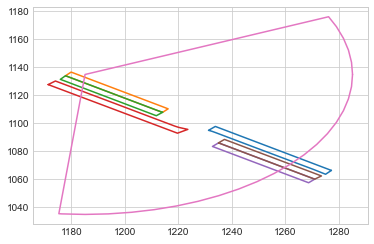

in Options class, polygonalRegions:  [<shapely.geometry.polygon.Polygon object at 0x248f88eb0>, <shapely.geometry.polygon.Polygon object at 0x263654640>, <shapely.geometry.polygon.Polygon object at 0x26365a250>, <shapely.geometry.polygon.Polygon object at 0x2c48e5c40>, <shapely.geometry.polygon.Polygon object at 0x2c5251070>, <shapely.geometry.polygon.Polygon object at 0x2c5251a60>]


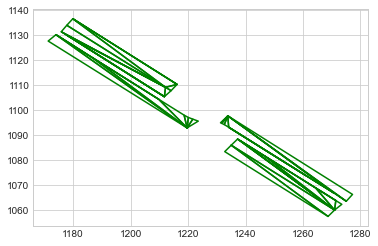

NOT VALID: POSITION
VALID:  False
position:  (884.37155528323 @ 328.68961357670787)


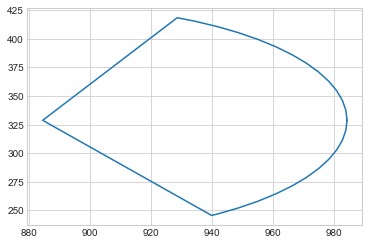

NOT VALID: POSITION
VALID:  False
position:  (1667.7744811967432 @ 1261.282342905728)


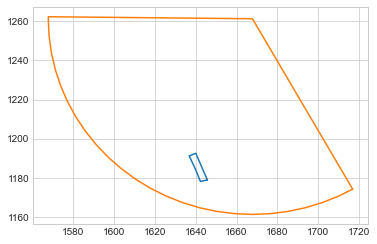

in Options class, polygonalRegions:  [<shapely.geometry.polygon.Polygon object at 0x2c437ccd0>]


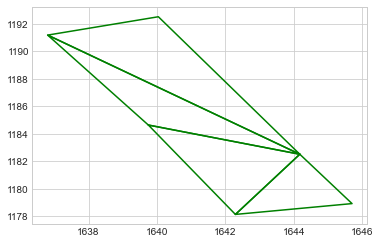

NOT VALID: POSITION
VALID:  False
position:  (770.0659163786258 @ 421.2352672541333)


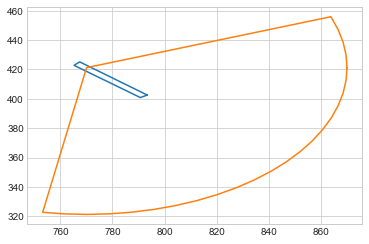

in Options class, polygonalRegions:  [<shapely.geometry.polygon.Polygon object at 0x248241550>]


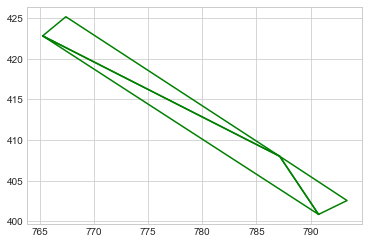

position is valid
heading:  4.019465468849564
within get_traffic_flow
point:  (770.0659163786258 @ 421.2352672541333)
heading output =  3.998104439752686
heading is valid
position:  (765.858 @ 420.879)
NOT VALID: POSITION
position:  (770.0659163786258 @ 421.2352672541333)
NOT VALID: POSITION
position:  (745.011 @ 441.698)
NOT VALID: POSITION
position:  (770.0659163786258 @ 421.2352672541333)
NOT VALID: POSITION
within get_traffic_flow
point:  (1202.3236931505237 @ 1116.3982665435524)
heading output =  4.086811619462665
within get_traffic_flow
point:  (1191.7929260298902 @ 1129.0181506092908)
heading output =  4.088358969129785
VALID:  True


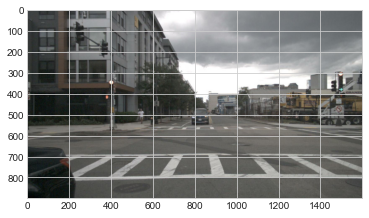

position:  (304.53692076957486 @ 671.3059324336757)


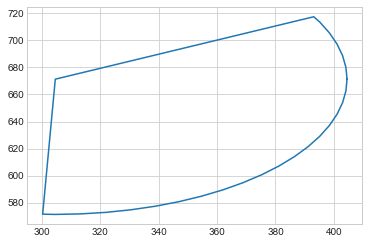

NOT VALID: POSITION
VALID:  False
position:  (759.9233662895945 @ 1515.0285858087518)


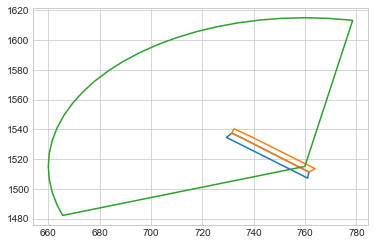

in Options class, polygonalRegions:  [<shapely.geometry.polygon.Polygon object at 0x2454b9a60>, <shapely.geometry.polygon.Polygon object at 0x2454c2670>]


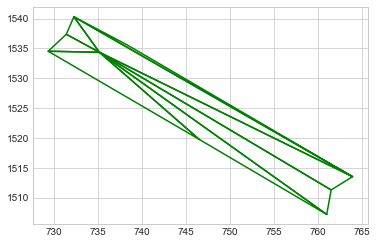

position is valid
heading:  0.8595565097008764
within get_traffic_flow
point:  (759.9233662895945 @ 1515.0285858087518)
heading output =  0.8619605002069616
heading is valid
position:  (761.545 @ 1508.955)
NOT VALID: POSITION
position:  (759.9233662895945 @ 1515.0285858087518)
NOT VALID: POSITION
position:  (793.572 @ 1503.222)
NOT VALID: POSITION
position:  (759.9233662895945 @ 1515.0285858087518)
NOT VALID: POSITION
within get_traffic_flow
point:  (152.83219247996362 @ 1798.7318616778437)
heading output =  -0.9500571983811015
within get_traffic_flow
point:  (155.22850179455588 @ 1806.6665052149037)
heading output =  -0.9417159109206734
VALID:  True


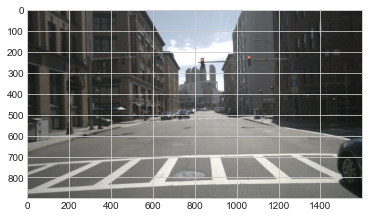

position:  (1185.1335438222195 @ 1134.8982263965122)


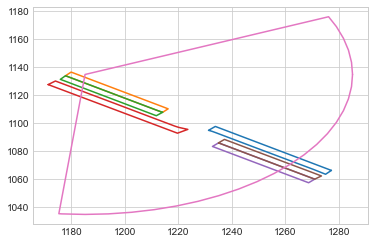

in Options class, polygonalRegions:  [<shapely.geometry.polygon.Polygon object at 0x248f88eb0>, <shapely.geometry.polygon.Polygon object at 0x263654640>, <shapely.geometry.polygon.Polygon object at 0x26365a250>, <shapely.geometry.polygon.Polygon object at 0x2c48e5c40>, <shapely.geometry.polygon.Polygon object at 0x2c5251070>, <shapely.geometry.polygon.Polygon object at 0x2c5251a60>]


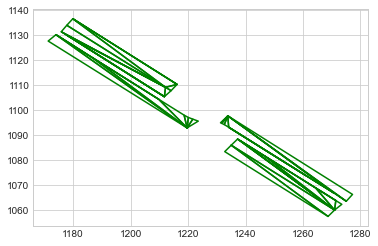

NOT VALID: POSITION
VALID:  False
position:  (673.0313324558715 @ 633.7105707293722)


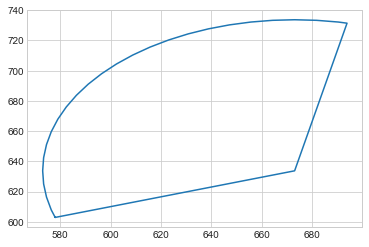

NOT VALID: POSITION
VALID:  False
position:  (1612.4682792197996 @ 867.0924678156523)


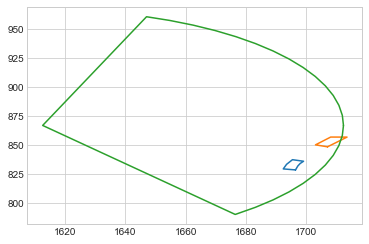

in Options class, polygonalRegions:  [<shapely.geometry.polygon.Polygon object at 0x2494b9a00>, <shapely.geometry.polygon.Polygon object at 0x2c214bdc0>]


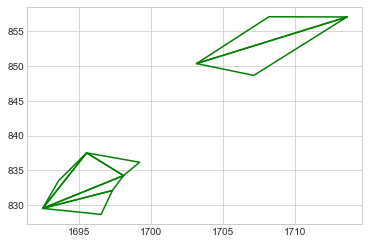

NOT VALID: POSITION
VALID:  False
position:  (620.6429459866663 @ 683.6970308100175)


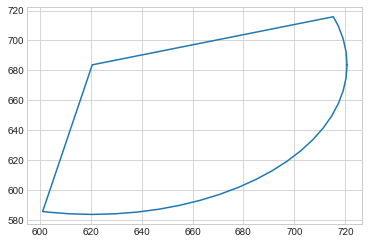

NOT VALID: POSITION
VALID:  False
position:  (421.7300035118442 @ 1625.9768277333096)


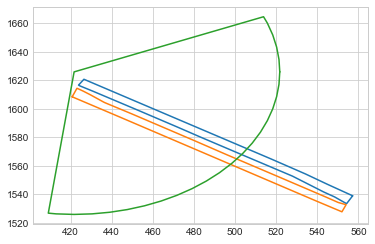

in Options class, polygonalRegions:  [<shapely.geometry.polygon.Polygon object at 0x24945ae20>, <shapely.geometry.polygon.Polygon object at 0x2c5cff4c0>]


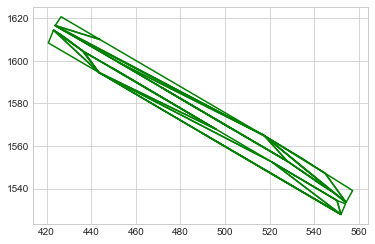

NOT VALID: POSITION
VALID:  False
position:  (309.1877937680997 @ 668.6676592014397)


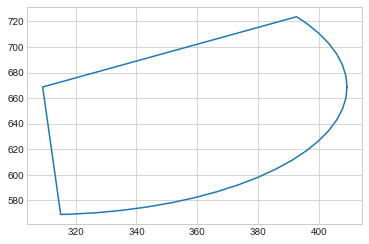

NOT VALID: POSITION
VALID:  False
position:  (2124.0102832512316 @ 923.1427505499746)


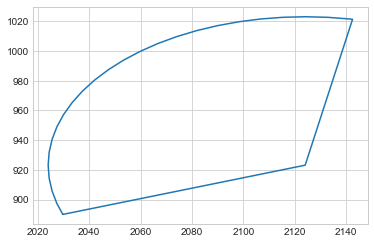

NOT VALID: POSITION
VALID:  False


In [5]:
import os
import shutil
import matplotlib.pyplot as plt
import matplotlib.image as mpimg

directory = '/Users/edwardkim/Desktop/Scenic_Query/nuscenes_data/experiment_results'
subject1 = 'experiment_result_JayShenoy'
subject2 = 'experiment_result_TaeSung'
subject3 = 'experiment_result_Xiangyu'
scenario_list = ['scenario1','scenario2','scenario3','scenario4','scenario5']

dir3 = os.path.join(directory, 'data')
# dir3 = os.path.join(directory, subject3, 'scenario3')
filenames = [file for file in os.listdir(dir3) if file.endswith('.jpg')]
print(len(filenames))

query_directory = os.path.join(directory, 'scenario5_queried')
if not os.path.isdir(query_directory):
    os.mkdir(query_directory)

for file in filenames:
    valid = validateLabel(scenario, file, debug=False, falseTesting=False, scenic_testing=False)
    print("VALID: ", valid)
    if valid:  
        shutil.copy(os.path.join(dir3, file), query_directory)
        img = mpimg.imread(os.path.join(dir3, file))
        imgplot = plt.imshow(img)
        plt.show()
    